<a href="https://colab.research.google.com/github/ksBrose/3DSGroup_BootcampDataScience/blob/main/Atividade_entrega2_mod_A%2B2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Projeto Data Science - Grupo 3DS

Foram baixados primeiramente os arquivos de dados telemétricos das cidades de Encantado, Muçum e Santa Tereza, no período de 01/08/2023 a 31/10/2023.
Para o município de Santa Tereza, foram baixados dados de 2 estações: Santa Tereza e Linha José Julio.

Após a primeira reunião com os instrutores, alteramos a coleta de dados para um período de 2 anos.

**Sites Referencia**
- https://www.snirh.gov.br/hidroweb/mapa
- https://www.snirh.gov.br/hidrotelemetria/serieHistorica.aspx

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
from datetime import datetime

# Funçoes

In [2]:
def plotar_matplot4(titulo, labelx, labely, x, y, dataset1, dataset2, dataset3, dataset4, label1, label2, label3, label4, intervalo_data=None):

  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]
      dataset2 = dataset2[(dataset2[x] >= data_inicio) & (dataset2[x] <= data_fim)]
      dataset3 = dataset3[(dataset3[x] >= data_inicio) & (dataset3[x] <= data_fim)]
      dataset4 = dataset4[(dataset4[x] >= data_inicio) & (dataset4[x] <= data_fim)]

  # Plotar os dados com os labels fornecidos
  eixo.plot(x, y, data=dataset1, label=label1, linestyle='-')
  eixo.plot(x, y, data=dataset2, label=label2, linestyle='-')
  eixo.plot(x, y, data=dataset3, label=label3, linestyle='-')
  eixo.plot(x, y, data=dataset4, label=label4, linestyle='-')

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo

In [3]:
def plotar_1_intervalo(titulo, labelx, labely, x, y, dataset1, label1, intervalo_data=None):

  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]

  # Plotar os dados com os labels fornecidos
  eixo.plot(x, y, data=dataset1, label=label1, linestyle='-')

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo

In [4]:
def plotar_boxplot(titulo, labelx, labely, x, y, dataset, tipo='linha'):
    # Verificar se o dataset não está vazio
    if dataset.empty:
        print("O dataset está vazio.")
        return

    # Verificar se as colunas especificadas existem no dataset
    if x not in dataset.columns or y not in dataset.columns:
        print(f"As colunas '{x}' e '{y}' devem existir no dataset.")
        return

    fig = plt.figure(figsize=(15, 8))
    eixo = fig.add_axes([0, 0, 1, 1])

    if tipo == 'linha':
        eixo.plot(dataset[x], dataset[y], marker='o', linestyle='-')  # Gráfico de linha com pontos
    elif tipo == 'boxplot':
        # Remover nulos apenas da coluna y
        dataset_cleaned = dataset.dropna(subset=[y])
        eixo.boxplot(dataset_cleaned[y], vert=True)
        eixo.set_xticklabels([labelx])  # Rótulo do eixo x

    # Configurar título e rótulos dos eixos
    eixo.set_title(titulo, fontsize=25, pad=15)
    eixo.set_xlabel(labelx, fontsize=15)
    eixo.set_ylabel(labely, fontsize=15)

    plt.show()

In [5]:
def plotar_boxplot4(titulo, labelx, labely, x, y, dataset1, dataset2, dataset3, dataset4, label1, label2, label3, label4, intervalo_data=None):
  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]
      dataset2 = dataset2[(dataset2[x] >= data_inicio) & (dataset2[x] <= data_fim)]
      dataset3 = dataset3[(dataset3[x] >= data_inicio) & (dataset3[x] <= data_fim)]
      dataset4 = dataset4[(dataset4[x] >= data_inicio) & (dataset4[x] <= data_fim)]

  # Criar uma lista com os dados para o boxplot, ignorando dados nulos
  dados_boxplot = [
      dataset1[y].dropna().values,
      dataset2[y].dropna().values,
      dataset3[y].dropna().values,
      dataset4[y].dropna().values
  ]

  # Plotar o boxplot
  eixo.boxplot(dados_boxplot, labels=[label1, label2, label3, label4])

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo


In [6]:
import matplotlib.pyplot as plt

def plotar_chuva_nivel(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dataset[coluna_data], dataset[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)  # Removi o parâmetro `pad`
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()



In [7]:
import matplotlib.pyplot as plt
import pandas as pd

def plotar_chuva_nivel_agrupa_ambos(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None, frequencia='D'):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Converter a coluna de data para datetime, caso ainda não esteja
    dataset[coluna_data] = pd.to_datetime(dataset[coluna_data])

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar por frequência especificada (D - dia, W - semana, M - mês, H - hora)
    dados_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum', coluna_nivel: 'mean'}).reset_index()

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dados_agrupados[coluna_data], dados_agrupados[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_agrupados[coluna_data], dados_agrupados[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

In [8]:
import matplotlib.pyplot as plt
import pandas as pd

def plotar_chuva_nivel_agrupa_chuva(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None, frequencia='D'):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Converter a coluna de data para datetime, caso ainda não esteja
    dataset[coluna_data] = pd.to_datetime(dataset[coluna_data])

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar os dados de chuva pela frequência especificada (D - dia, W - semana, M - mês, H - hora)
    dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_chuva_agrupados[coluna_data], dados_chuva_agrupados[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()


In [9]:
df_Encantado = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/86720000-ENCANTADO.csv', encoding='ISO-8859-1', delimiter=';')
df_Mucum = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/86510000-MUCUM.csv', encoding='ISO-8859-1', delimiter=';')
df_Sta_Tereza = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/86472600-SANTA%20TEREZA.csv', encoding='ISO-8859-1', delimiter=';')
df_Lin_JJ = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/86472000-LINHA%20JOSE%20JULIO.csv', encoding='ISO-8859-1', delimiter=';')

In [10]:
df_Encantado['Data_Hora'] = pd.to_datetime(df_Encantado['Data'] + ' ' + df_Encantado['Hora'], format='%d/%m/%Y %H:%M:%S')
df_Encantado.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6071 entries, 0 to 6070
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Data          6071 non-null   object        
 1   Hora          6071 non-null   object        
 2   Chuva (mm)    6071 non-null   object        
 3   Nível (cm)    6071 non-null   object        
 4   Vazão (m3/s)  3709 non-null   object        
 5   Unnamed: 5    0 non-null      float64       
 6   Data_Hora     6071 non-null   datetime64[ns]
dtypes: datetime64[ns](1), float64(1), object(5)
memory usage: 332.1+ KB


In [11]:
df_Encantado.head()

,Data,Hora,Chuva (mm),Nível (cm),Vazão (m3/s),Unnamed: 5,Data_Hora
0,01/08/2023,02:30:00,0,228,251.8,NaN,2023-08-01 02:30:00
1,01/08/2023,02:45:00,0,228,251.8,NaN,2023-08-01 02:45:00
2,01/08/2023,03:00:00,0,228,251.8,NaN,2023-08-01 03:00:00
3,01/08/2023,03:15:00,0,227,248.1,NaN,2023-08-01 03:15:00
4,01/08/2023,03:30:00,0,227,248.1,NaN,2023-08-01 03:30:00


In [12]:
df_Encantado.tail()

,Data,Hora,Chuva (mm),Nível (cm),Vazão (m3/s),Unnamed: 5,Data_Hora
6066,30/10/2023,23:00:00,0,197,146.1,NaN,2023-10-30 23:00:00
6067,30/10/2023,23:15:00,0,197,146.1,NaN,2023-10-30 23:15:00
6068,30/10/2023,23:30:00,0,197,146.1,NaN,2023-10-30 23:30:00
6069,30/10/2023,23:45:00,0,197,146.1,NaN,2023-10-30 23:45:00
6070,31/10/2023,00:00:00,0,197,146.1,NaN,2023-10-31 00:00:00


In [13]:
'''
#fig = plt.figure(figsize=(15,8))
eixo = fig.add_axes([0,0,1,1])

#eixo.scatter(df_Encantado['Data_Hora'], df_Encantado['Nível (cm)'])
eixo.plot(df_Encantado['Data_Hora'], df_Encantado['Nível (cm)'], marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações
eixo.set_title('Encantado Nivel', fontsize=25, pad=15)
eixo.set_xlabel('Data', fontsize=15)
eixo.set_ylabel('Nivel', fontsize=15)
'''

"\n#fig = plt.figure(figsize=(15,8))\neixo = fig.add_axes([0,0,1,1])\n\n#eixo.scatter(df_Encantado['Data_Hora'], df_Encantado['Nível (cm)'])\neixo.plot(df_Encantado['Data_Hora'], df_Encantado['Nível (cm)'], marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações\neixo.set_title('Encantado Nivel', fontsize=25, pad=15)\neixo.set_xlabel('Data', fontsize=15)\neixo.set_ylabel('Nivel', fontsize=15)\n"

# Base de dados de 1 ano

## Carregando base de dados

In [14]:
df_Encantado24 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86720000-ENCANTADO-2024-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Encantado23 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86720000-ENCANTADO-2023-2022.csv', encoding='ISO-8859-1', delimiter=';')
df_Mucum24 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86510000-MUCUM-2024-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Mucum23 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86510000-MUCUM-2023-2022.csv', encoding='ISO-8859-1', delimiter=';')
df_Sta_Tereza24 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86472600-SANTA-TEREZA-2024-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Sta_Tereza23 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86472600-SANTA-TEREZA-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Jose_Julio24 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86472000-LINHA-JOSE-JULIO-2024-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Jose_Julio23 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86472000-LINHA-JOSE-JULIO-2023-2022.csv', encoding='ISO-8859-1', delimiter=';')

In [15]:
df_Encantado24 = df_Encantado24.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Encantado23 = df_Encantado23.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Mucum24 = df_Mucum24.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Mucum23 = df_Mucum23.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Sta_Tereza24 = df_Sta_Tereza24.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Sta_Tereza23 = df_Sta_Tereza23.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Jose_Julio24 = df_Jose_Julio24.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Jose_Julio23 = df_Jose_Julio23.drop(['Bateria(V)', 'TempInt(C)'], axis=1)

In [16]:
df_Encantado24.head()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,23/10/2024 15:00,0.0,100.0,0.11
1,23/10/2024 14:45,0.0,100.0,0.11
2,23/10/2024 14:30,0.0,100.0,0.11
3,23/10/2024 14:15,0.0,99.0,NaN
4,23/10/2024 14:00,0.0,99.0,NaN


In [17]:
df_Encantado24.tail()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
35119,22/10/2023 16:15,NaN,NaN,NaN
35120,22/10/2023 16:00,NaN,NaN,NaN
35121,22/10/2023 15:45,NaN,NaN,NaN
35122,22/10/2023 15:30,NaN,NaN,NaN
35123,22/10/2023 15:15,NaN,NaN,NaN


In [18]:
df_Encantado24.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35124 entries, 0 to 35123
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Data/Hora    35124 non-null  object 
 1   Chuva(mm)    34991 non-null  float64
 2   Nivel(cm)    25415 non-null  float64
 3   Vazao(m3/s)  26309 non-null  float64
dtypes: float64(3), object(1)
memory usage: 1.1+ MB


In [19]:
print('Quantidade de linhas e colunas:', df_Encantado24.shape)
print('Quantidade de dados nulos:', df_Encantado24.isna().sum().sum())

Quantidade de linhas e colunas: (35124, 4)
Quantidade de dados nulos: 18657


## - Alterar Dtype Data/Hora para variavel datetime

In [20]:
df_Encantado24['Data/Hora'] = pd.to_datetime(df_Encantado24['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Encantado23['Data/Hora'] = pd.to_datetime(df_Encantado23['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Mucum24['Data/Hora'] = pd.to_datetime(df_Mucum24['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Mucum23['Data/Hora'] = pd.to_datetime(df_Mucum23['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Sta_Tereza24['Data/Hora'] = pd.to_datetime(df_Sta_Tereza24['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Sta_Tereza23['Data/Hora'] = pd.to_datetime(df_Sta_Tereza23['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Jose_Julio24['Data/Hora'] = pd.to_datetime(df_Jose_Julio24['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Jose_Julio23['Data/Hora'] = pd.to_datetime(df_Jose_Julio23['Data/Hora'], format='%d/%m/%Y %H:%M')

In [21]:
df_Encantado24.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35124 entries, 0 to 35123
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    35124 non-null  datetime64[ns]
 1   Chuva(mm)    34991 non-null  float64       
 2   Nivel(cm)    25415 non-null  float64       
 3   Vazao(m3/s)  26309 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 1.1 MB


## - Unindo as bases de dados de 2 anos separados em uma unica base

In [22]:
df_Encantado_unico = pd.concat([df_Encantado24, df_Encantado23]).drop_duplicates().reset_index(drop=True)
df_Encantado_unico['Data/Hora'] = pd.to_datetime(df_Encantado_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Mucum_unico = pd.concat([df_Mucum24, df_Mucum23]).drop_duplicates().reset_index(drop=True)
df_Mucum_unico['Data/Hora'] = pd.to_datetime(df_Mucum_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Sta_Tereza_unico = pd.concat([df_Sta_Tereza24, df_Sta_Tereza23]).drop_duplicates().reset_index(drop=True)
df_Sta_Tereza_unico['Data/Hora'] = pd.to_datetime(df_Sta_Tereza_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Jose_Julio_unico = pd.concat([df_Jose_Julio24, df_Jose_Julio23]).drop_duplicates().reset_index(drop=True)
df_Jose_Julio_unico['Data/Hora'] = pd.to_datetime(df_Jose_Julio_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    62248 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


In [23]:
df_Encantado_sem_trat = pd.concat([df_Encantado24, df_Encantado23]).drop_duplicates().reset_index(drop=True)
df_Encantado_sem_trat['Data/Hora'] = pd.to_datetime(df_Encantado_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Mucum_sem_trat = pd.concat([df_Mucum24, df_Mucum23]).drop_duplicates().reset_index(drop=True)
df_Mucum_sem_trat['Data/Hora'] = pd.to_datetime(df_Mucum_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Sta_Tereza_sem_trat = pd.concat([df_Sta_Tereza24, df_Sta_Tereza23]).drop_duplicates().reset_index(drop=True)
df_Sta_Tereza_sem_trat['Data/Hora'] = pd.to_datetime(df_Sta_Tereza_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Jose_Julio_sem_trat = pd.concat([df_Jose_Julio24, df_Jose_Julio23]).drop_duplicates().reset_index(drop=True)
df_Jose_Julio_sem_trat['Data/Hora'] = pd.to_datetime(df_Jose_Julio_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Encantado_sem_trat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    62248 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


In [24]:
df_Mucum_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69397 entries, 0 to 69396
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69397 non-null  datetime64[ns]
 1   Chuva(mm)    69201 non-null  float64       
 2   Nivel(cm)    68913 non-null  float64       
 3   Vazao(m3/s)  68913 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [25]:
df_Mucum_sem_trat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69397 entries, 0 to 69396
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69397 non-null  datetime64[ns]
 1   Chuva(mm)    69201 non-null  float64       
 2   Nivel(cm)    68913 non-null  float64       
 3   Vazao(m3/s)  68913 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [26]:
df_Sta_Tereza_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37003 entries, 0 to 37002
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    37003 non-null  datetime64[ns]
 1   Chuva(mm)    36961 non-null  float64       
 2   Nivel(cm)    36870 non-null  float64       
 3   Vazao(m3/s)  0 non-null      float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 1.1 MB


In [27]:
df_Jose_Julio_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67289 entries, 0 to 67288
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    67289 non-null  datetime64[ns]
 1   Chuva(mm)    66981 non-null  float64       
 2   Nivel(cm)    55443 non-null  float64       
 3   Vazao(m3/s)  55443 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [28]:
df_Encantado_unico.head()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,2024-10-23 15:00:00,0.0,100.0,0.11
1,2024-10-23 14:45:00,0.0,100.0,0.11
2,2024-10-23 14:30:00,0.0,100.0,0.11
3,2024-10-23 14:15:00,0.0,99.0,NaN
4,2024-10-23 14:00:00,0.0,99.0,NaN


In [29]:
df_Encantado_unico.tail()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
64809,2022-10-22 16:15:00,0.0,223.0,233.2
64810,2022-10-22 16:00:00,0.0,224.0,236.9
64811,2022-10-22 15:45:00,0.0,226.0,244.3
64812,2022-10-22 15:30:00,0.0,226.0,244.3
64813,2022-10-22 15:15:00,0.0,227.0,248.1


# Vasão

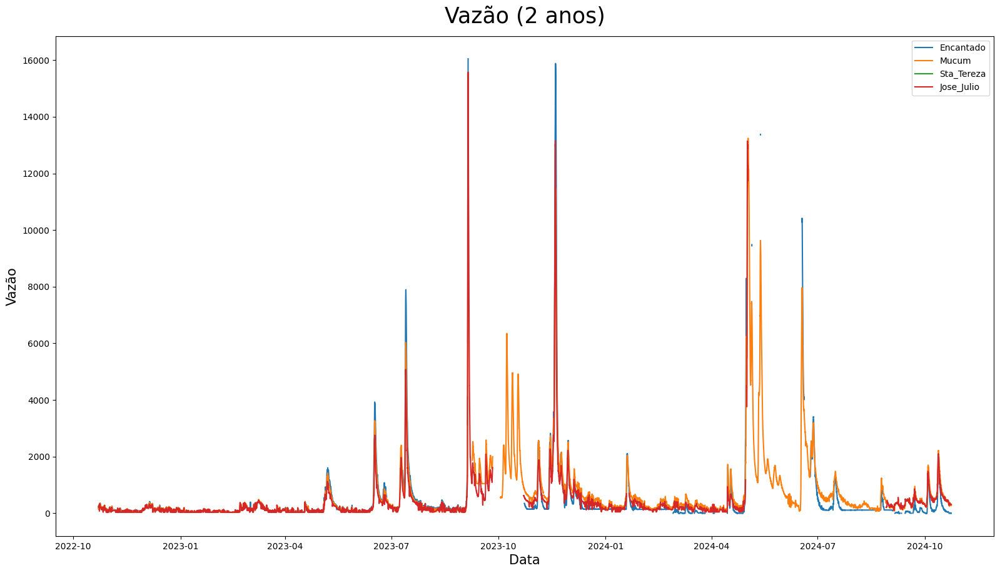

In [30]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-10-17')
data_fim = pd.to_datetime('2024-12-21')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão (2 anos)', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

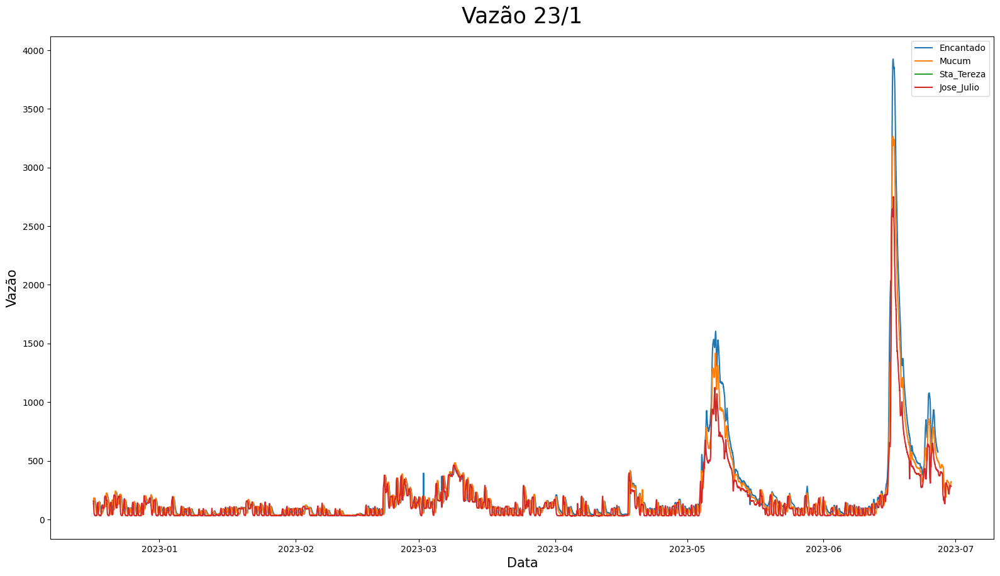

In [31]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-12-17')
data_fim = pd.to_datetime('2023-06-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 23/1', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

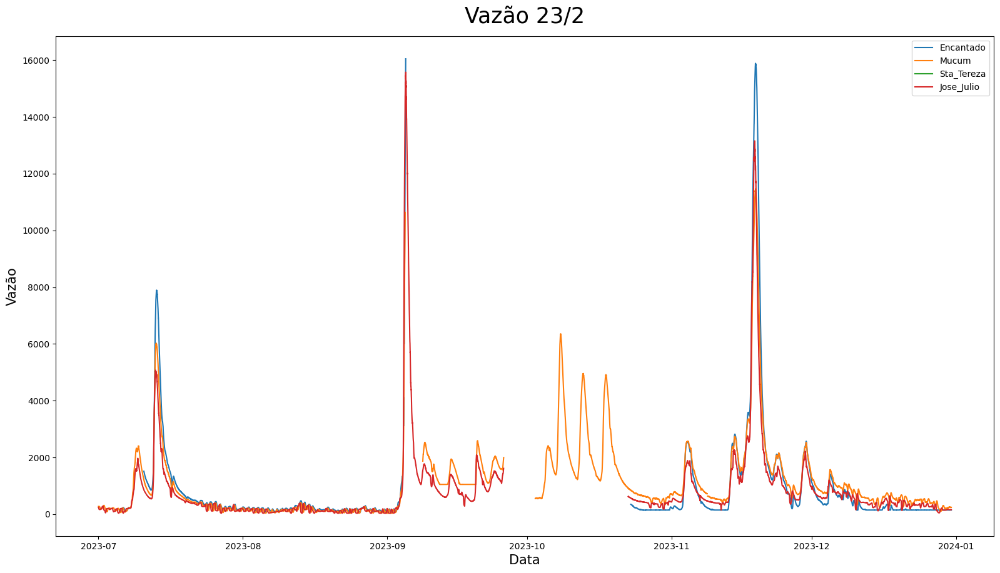

In [32]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-7-01')
data_fim = pd.to_datetime('2023-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 23/2', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

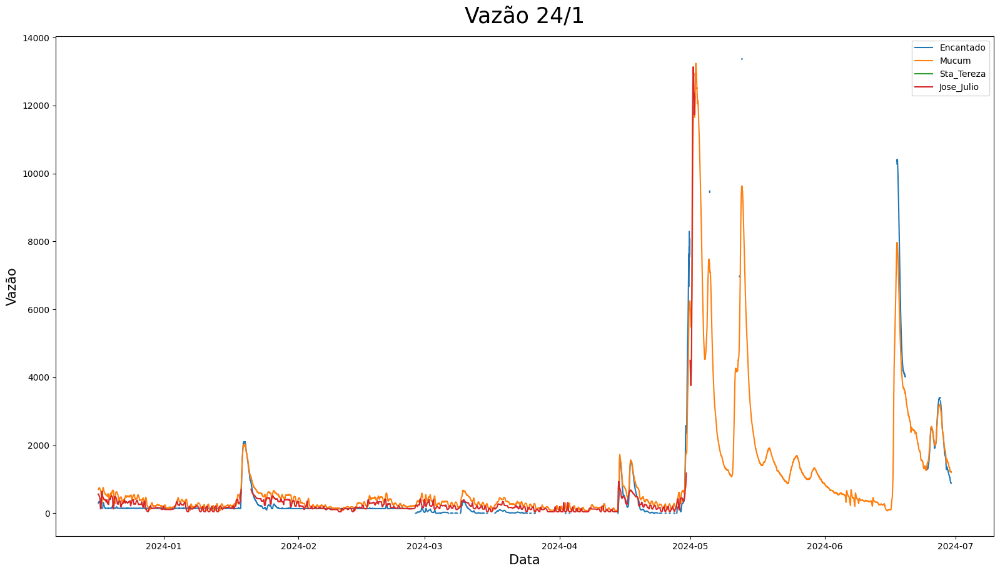

In [33]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-06-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 24/1', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

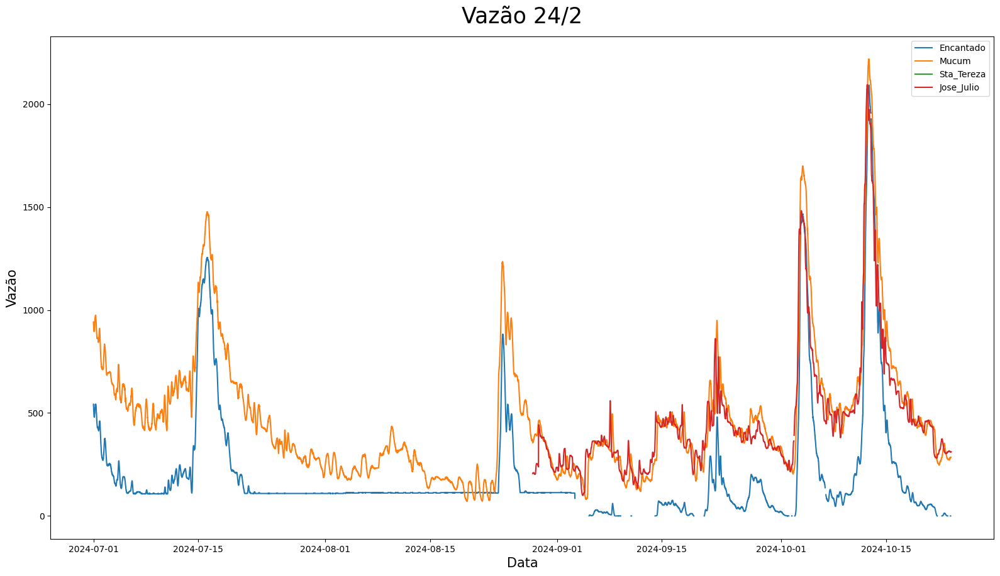

In [34]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-7-01')
data_fim = pd.to_datetime('2024-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 24/2', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

# Tratamento de dados chuva

In [35]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    62248 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


Para chuva vamos substituir valores nulos por zeros

In [36]:
'''
df_Encantado_unico['Chuva(mm)'] = df_Encantado_unico['Chuva(mm)'].fillna(0)
df_Mucum_unico['Chuva(mm)'] = df_Mucum_unico['Chuva(mm)'].fillna(0)
df_Sta_Tereza_unico['Chuva(mm)'] = df_Sta_Tereza_unico['Chuva(mm)'].fillna(0)
df_Jose_Julio_unico['Chuva(mm)'] = df_Jose_Julio_unico['Chuva(mm)'].fillna(0)
'''

"\ndf_Encantado_unico['Chuva(mm)'] = df_Encantado_unico['Chuva(mm)'].fillna(0)\ndf_Mucum_unico['Chuva(mm)'] = df_Mucum_unico['Chuva(mm)'].fillna(0)\ndf_Sta_Tereza_unico['Chuva(mm)'] = df_Sta_Tereza_unico['Chuva(mm)'].fillna(0)\ndf_Jose_Julio_unico['Chuva(mm)'] = df_Jose_Julio_unico['Chuva(mm)'].fillna(0)\n"

para vazão vamos interpolar os valores nulos (descontinuado)



In [37]:
df_Encantado_unico['Chuva(mm)'] = df_Encantado_unico['Chuva(mm)'].interpolate(method='linear')
df_Mucum_unico['Chuva(mm)'] = df_Mucum_unico['Chuva(mm)'].interpolate(method='linear')
df_Sta_Tereza_unico['Chuva(mm)'] = df_Sta_Tereza_unico['Chuva(mm)'].interpolate(method='linear')
df_Jose_Julio_unico['Chuva(mm)'] = df_Jose_Julio_unico['Chuva(mm)'].interpolate(method='linear')

In [38]:
'''
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Sta_Tereza_unico['Vazao(m3/s)'] = df_Sta_Tereza_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'].interpolate(method='linear')
'''

"\ndf_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'].interpolate(method='linear')\ndf_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'].interpolate(method='linear')\ndf_Sta_Tereza_unico['Vazao(m3/s)'] = df_Sta_Tereza_unico['Vazao(m3/s)'].interpolate(method='linear')\ndf_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'].interpolate(method='linear')\n"

conferir se sobrou algum valor nulo para chuva e vazão

In [39]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    64814 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


# SHIFT

Para remover os valores nulos do Nivel da agua nos 4 pontos de coleta de dados será necessario fazer uma combinação dos valores faltantes de cada cidade com os valores existentes das outras.

Mas para isto é necessario fazer os valores não ter difereça de data pois cada cidade atinge o maximo em tempos diferentes e cada medidor possui um ponto de referencia diferente.

*   Deslocar a data
*   Fazer que tenha niveis semelhantes



In [40]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    64814 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


## Pré deslocamento

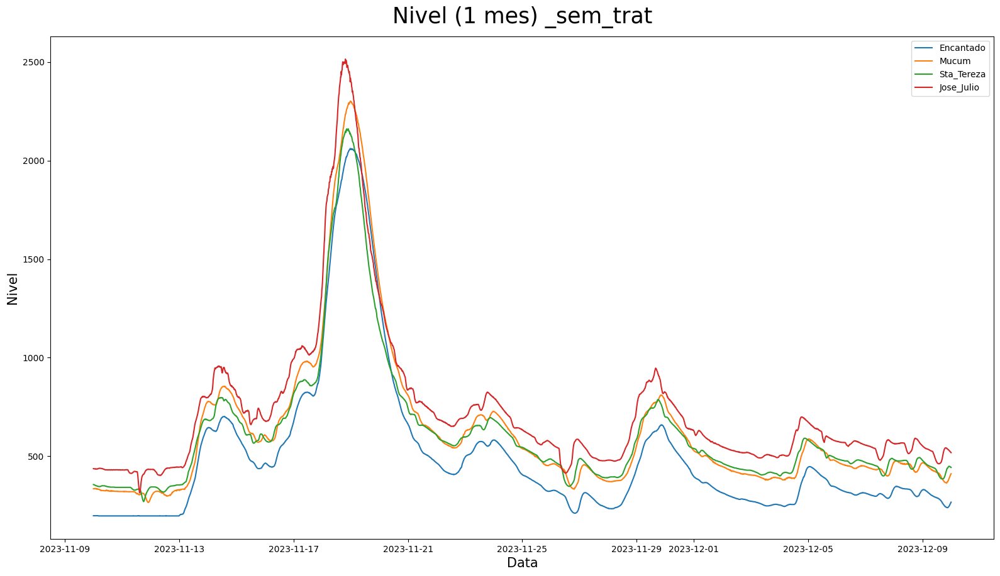

In [41]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (1 mes) _sem_trat', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_sem_trat, df_Mucum_sem_trat, df_Sta_Tereza_sem_trat, df_Jose_Julio_sem_trat,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

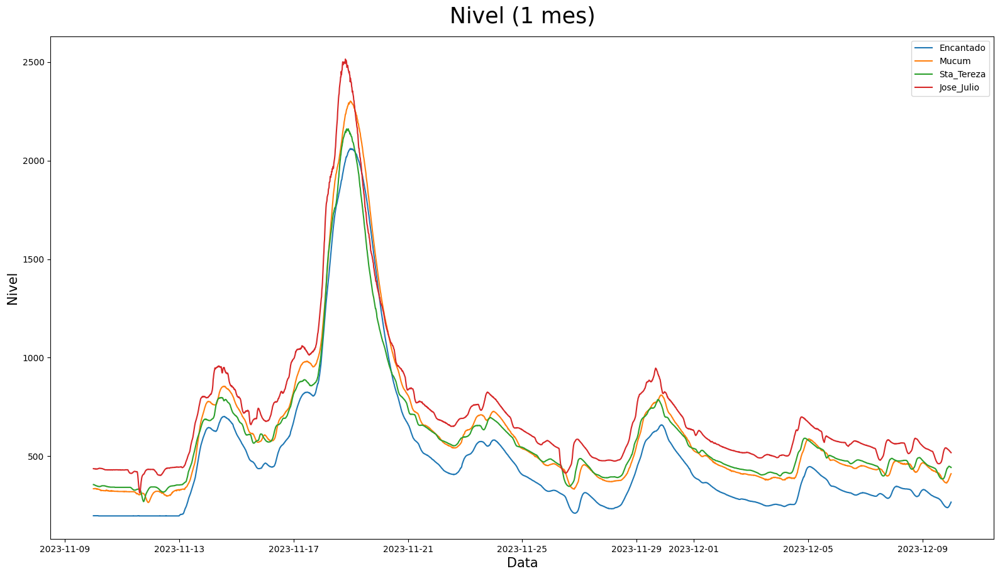

In [42]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (1 mes)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

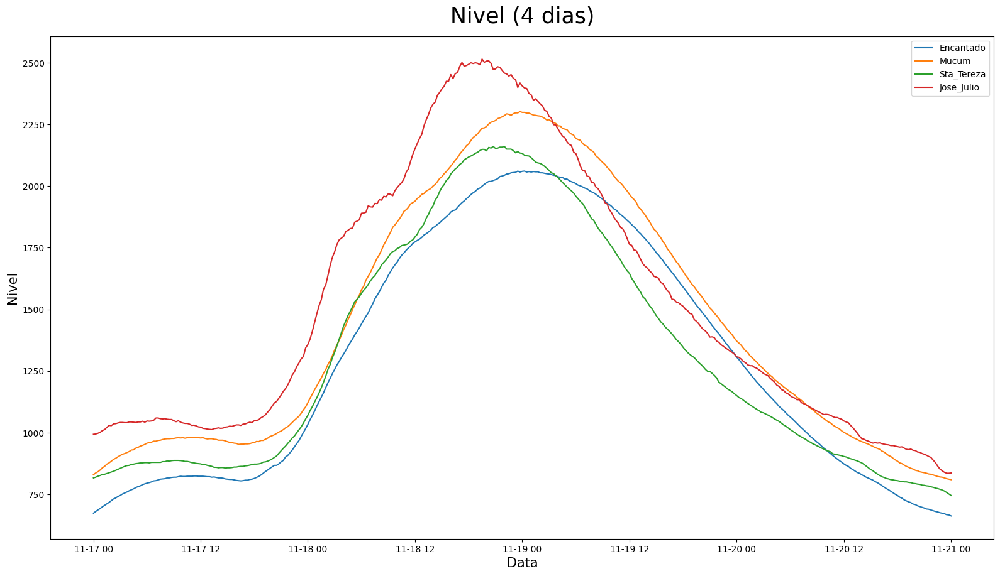

In [43]:
39# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (4 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Deslocamento a partir da data

ao deslocar as datas temos que remover as extremidades pois ficaremos com valores das datas nulos

In [44]:
import pandas as pd

def deslocar_data_series(tabela1, tabela2, tabela3, tabela4, coluna_data, shift1=0, shift2=0, shift3=0, shift4=0):
    """
    Desloca a coluna de data em cada tabela de acordo com os valores de shift fornecidos
    e remove valores nulos nas extremidades para manter todas as tabelas alinhadas.

    Parâmetros:
    - tabela1, tabela2, tabela3, tabela4: tabelas de dados pandas DataFrame.
    - coluna_data: nome da coluna de data.
    - shift1, shift2, shift3, shift4: valores de deslocamento para cada tabela (em unidades de linha).

    Retorna:
    - Quatro tabelas alinhadas e sem valores nulos nas extremidades.
    """

    # Aplicar os deslocamentos na coluna de data em cada tabela
    tabela1[coluna_data] = tabela1[coluna_data].shift(shift1)
    tabela2[coluna_data] = tabela2[coluna_data].shift(shift2)
    tabela3[coluna_data] = tabela3[coluna_data].shift(shift3)
    tabela4[coluna_data] = tabela4[coluna_data].shift(shift4)

    # Sincronizar os índices removendo valores nulos das extremidades, com base no maior deslocamento
    max_shift = max(shift1, shift2, shift3, shift4)
    min_shift = min(shift1, shift2, shift3, shift4)

    # Recortar todas as tabelas para o mesmo intervalo de dados, removendo extremidades com nulos
    tabela1 = tabela1.iloc[max_shift:min_shift].reset_index(drop=True)
    tabela2 = tabela2.iloc[max_shift:min_shift].reset_index(drop=True)
    tabela3 = tabela3.iloc[max_shift:min_shift].reset_index(drop=True)
    tabela4 = tabela4.iloc[max_shift:min_shift].reset_index(drop=True)

    return tabela1, tabela2, tabela3, tabela4

In [45]:
# Definir os deslocamentos específicos para cada tabela
# shift1, shift2, shift3, shift4 = -12, -12, 7, 15
shift1, shift2, shift3, shift4 = -1, -1, 7, 15

# Alinhar as tabelas
df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico = deslocar_data_series(
    df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
    coluna_data='Data/Hora',
    shift1=shift1, shift2=shift2, shift3=shift3, shift4=shift4
)

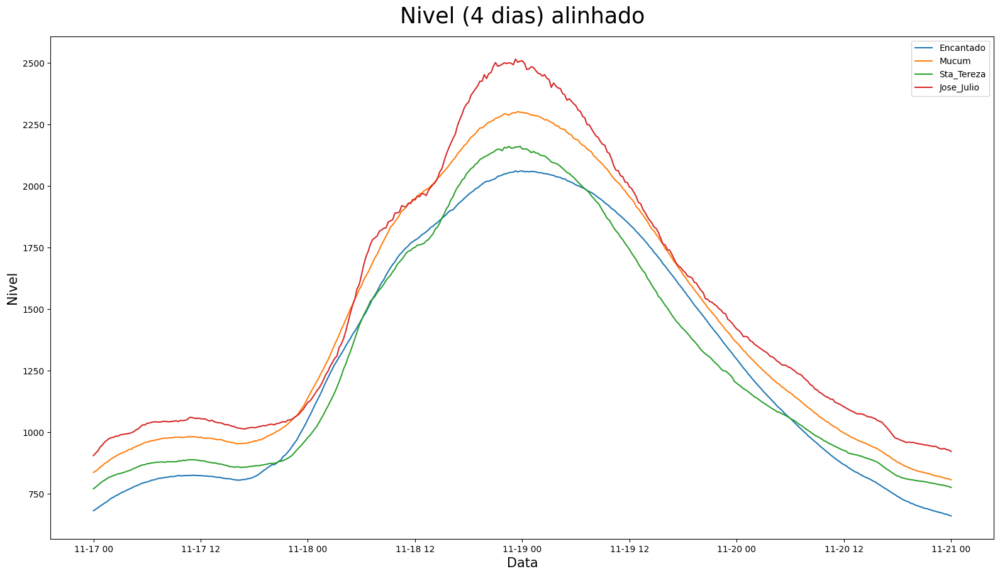

In [46]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (4 dias) alinhado', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [47]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64798 entries, 0 to 64797
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64798 non-null  datetime64[ns]
 1   Chuva(mm)    64798 non-null  float64       
 2   Nivel(cm)    52702 non-null  float64       
 3   Vazao(m3/s)  53608 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


- Confirmando se os dados das extremidades foram removidos

In [48]:
df_Jose_Julio_unico.head(21)

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,2024-10-23 16:30:00,0.0,397.0,312.04
1,2024-10-23 16:15:00,0.0,397.0,312.04
2,2024-10-23 16:00:00,0.0,397.0,312.04
3,2024-10-23 15:45:00,0.0,398.0,314.34
4,2024-10-23 15:30:00,0.0,398.0,314.34
5,2024-10-23 15:15:00,0.0,398.0,314.34
6,2024-10-23 15:00:00,0.0,398.0,314.34
7,2024-10-23 14:45:00,0.0,398.0,314.34
8,2024-10-23 14:30:00,0.0,398.0,314.34
9,2024-10-23 14:15:00,0.0,398.0,314.34


In [49]:
df_Sta_Tereza_unico.head(21)

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,2024-10-23 13:30:00,0.0,258.0,NaN
1,2024-10-23 13:15:00,0.0,258.0,NaN
2,2024-10-23 13:00:00,0.0,258.0,NaN
3,2024-10-23 12:45:00,0.0,258.0,NaN
4,2024-10-23 12:30:00,0.0,258.0,NaN
5,2024-10-23 12:15:00,0.0,257.0,NaN
6,2024-10-23 12:00:00,0.0,257.0,NaN
7,2024-10-23 11:45:00,0.0,257.0,NaN
8,2024-10-23 11:30:00,0.0,257.0,NaN
9,2024-10-23 11:15:00,0.0,257.0,NaN


In [50]:
df_Mucum_unico.tail(21)

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
69360,2022-10-22 20:30:00,0.0,182.0,164.5
69361,2022-10-22 20:15:00,0.0,177.0,154.8
69362,2022-10-22 20:00:00,0.0,172.0,145.5
69363,2022-10-22 19:45:00,0.0,169.0,140.0
69364,2022-10-22 19:30:00,0.0,166.0,134.6
69365,2022-10-22 19:15:00,0.0,165.0,132.9
69366,2022-10-22 19:00:00,0.0,164.0,131.1
69367,2022-10-22 18:45:00,0.0,165.0,132.9
69368,2022-10-22 18:30:00,0.0,166.0,134.6
69369,2022-10-22 18:15:00,0.0,167.0,136.4


In [51]:
df_Encantado_unico.tail(21)

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
64777,2022-10-22 20:15:00,0.0,201.0,158.4
64778,2022-10-22 20:00:00,0.0,202.0,161.5
64779,2022-10-22 19:45:00,0.0,203.0,164.6
64780,2022-10-22 19:30:00,0.0,204.0,167.8
64781,2022-10-22 19:15:00,0.0,206.0,174.3
64782,2022-10-22 19:00:00,0.0,207.0,177.5
64783,2022-10-22 18:45:00,0.0,208.0,180.8
64784,2022-10-22 18:30:00,0.0,210.0,187.5
64785,2022-10-22 18:15:00,0.0,211.0,190.8
64786,2022-10-22 18:00:00,0.0,213.0,197.6


## Deslocamento dos dados em relação do nivel

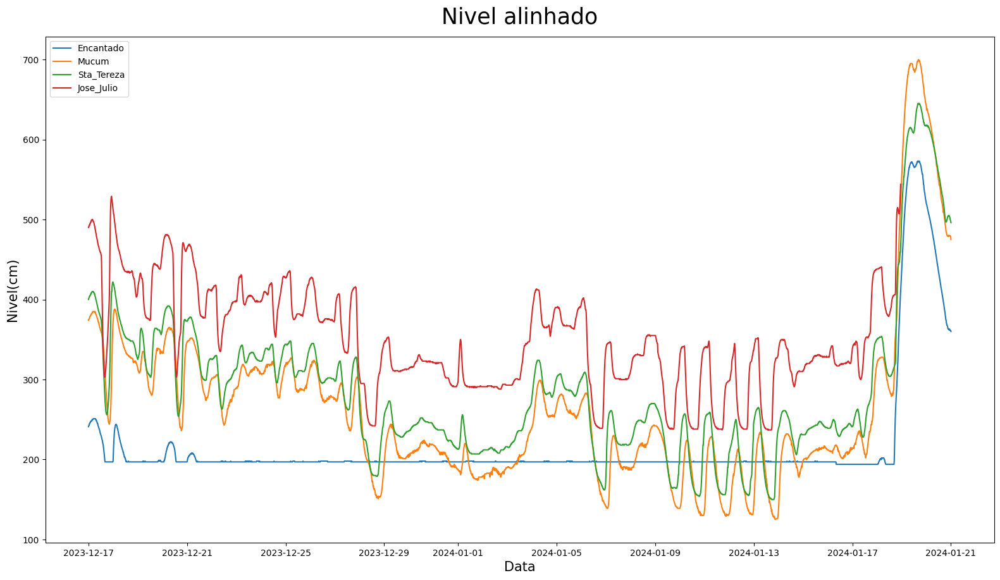

In [52]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-01-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel alinhado', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

no grafico aciima notamos que os valores não tem diferença em questão temporal mas vemoz que possuem niveis diferentes

- Os Valores abaixo são para eles terem uma diferença geral semelhante

In [53]:
df_Encantado_unico['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'] + 180
df_Mucum_unico['Nivel(cm)'] = df_Mucum_unico['Nivel(cm)'] + 70
df_Sta_Tereza_unico['Nivel(cm)'] = df_Sta_Tereza_unico['Nivel(cm)'] + 50
df_Jose_Julio_unico['Nivel(cm)'] = df_Jose_Julio_unico['Nivel(cm)'] - 40

- Os graficos abaixo foram separados em faixa de 6 meses para facilitar a visualização

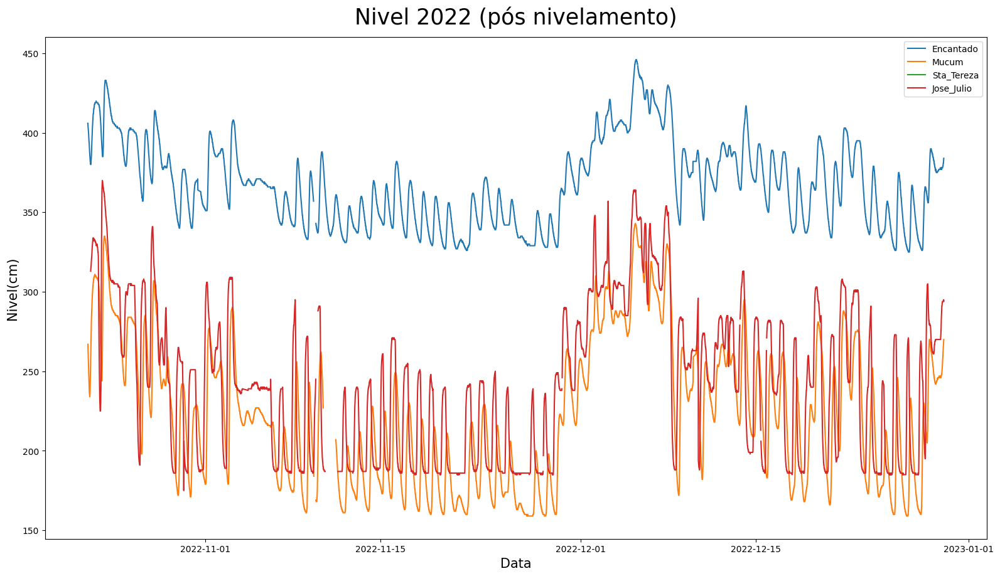

In [54]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2022 (pós nivelamento)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

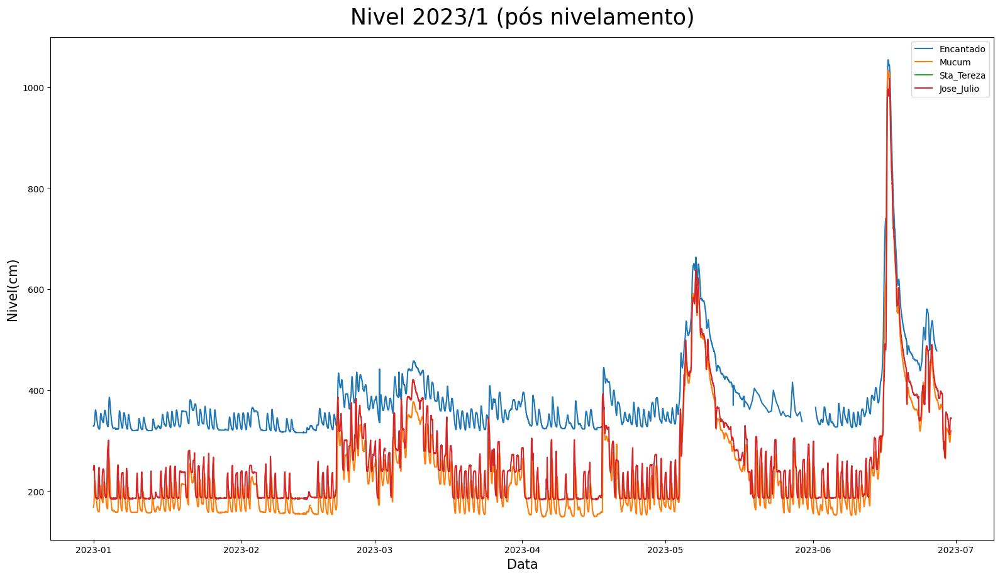

In [55]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2023/1 (pós nivelamento)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

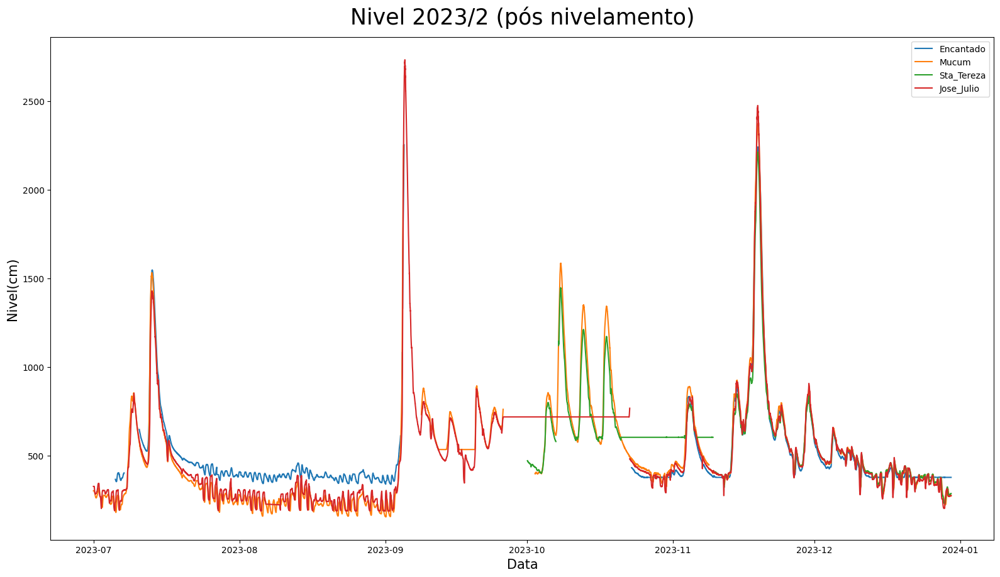

In [56]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2023/2 (pós nivelamento)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

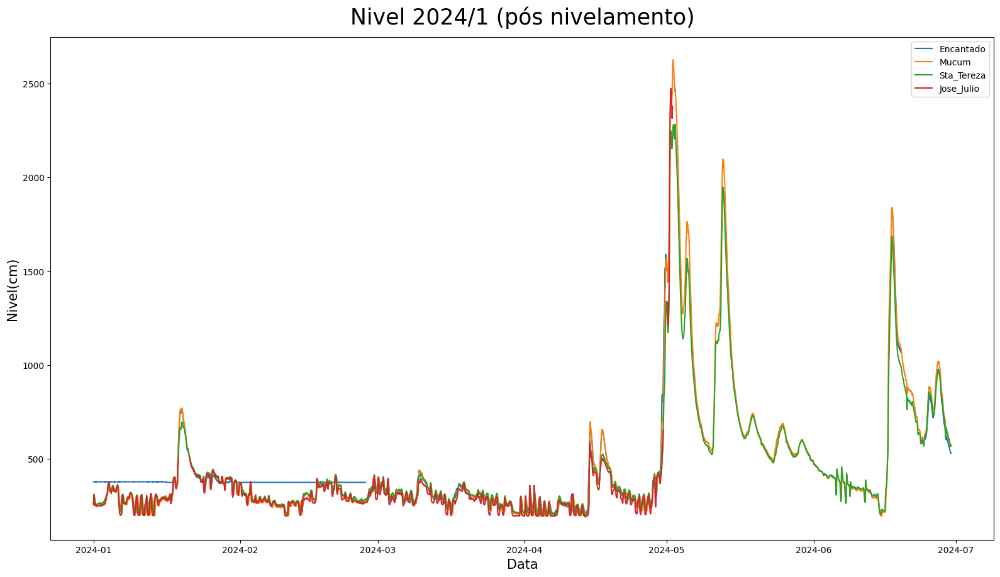

In [57]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2024/1 (pós nivelamento)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

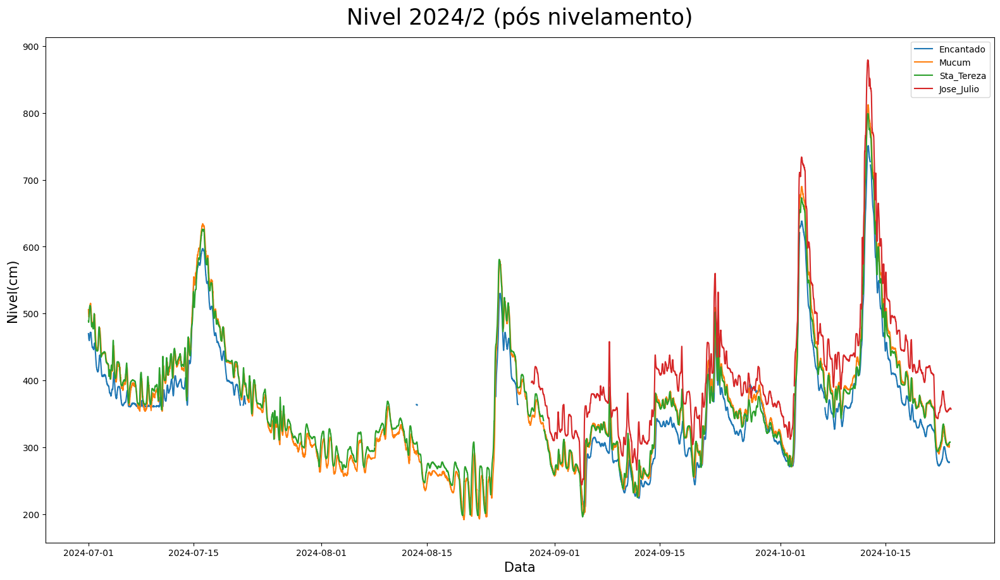

In [58]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2024/2 (pós nivelamento)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

Foi possivel notar que em faixas temporais há diferença de altura pois o medidor deve ter sido realocado do ponto original

*   Será necessario fazer ajustes em faixas temporais especifica



In [59]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] -= 100

In [60]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                        (df_Mucum_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] += 20

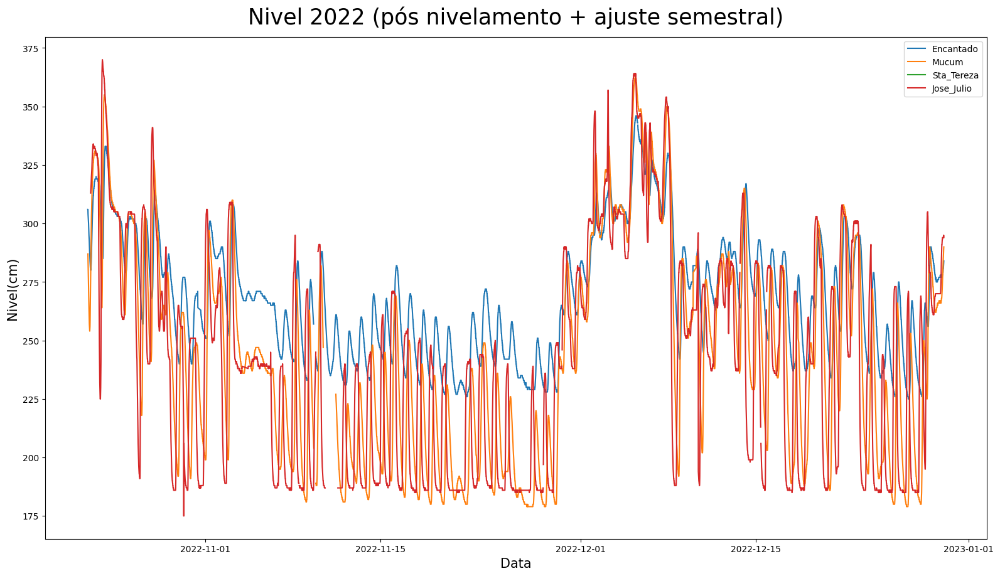

In [61]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2022 (pós nivelamento + ajuste semestral)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [62]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] -= 100

In [63]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                        (df_Mucum_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] += 20

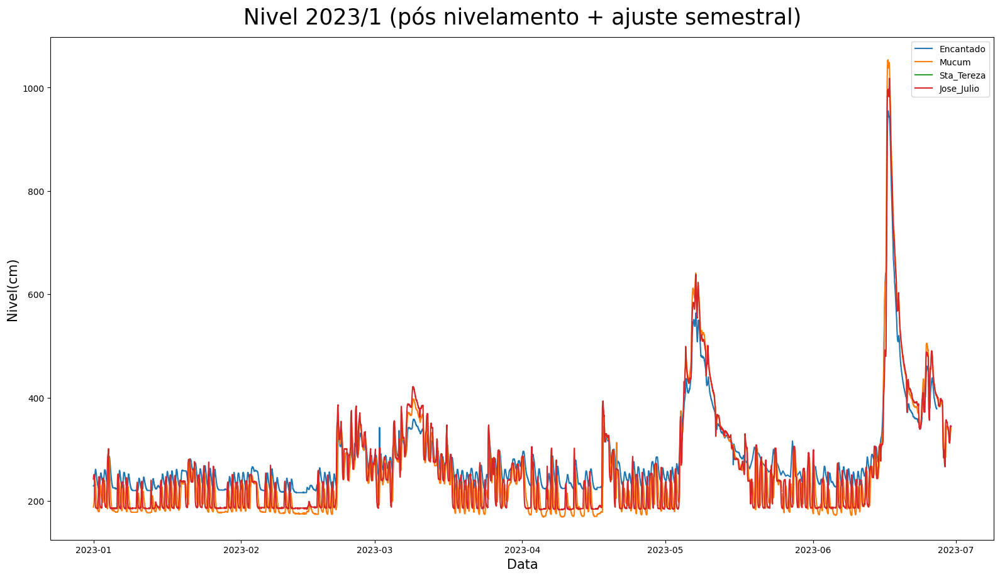

In [64]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2023/1 (pós nivelamento + ajuste semestral)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [65]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-10-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] -= 100

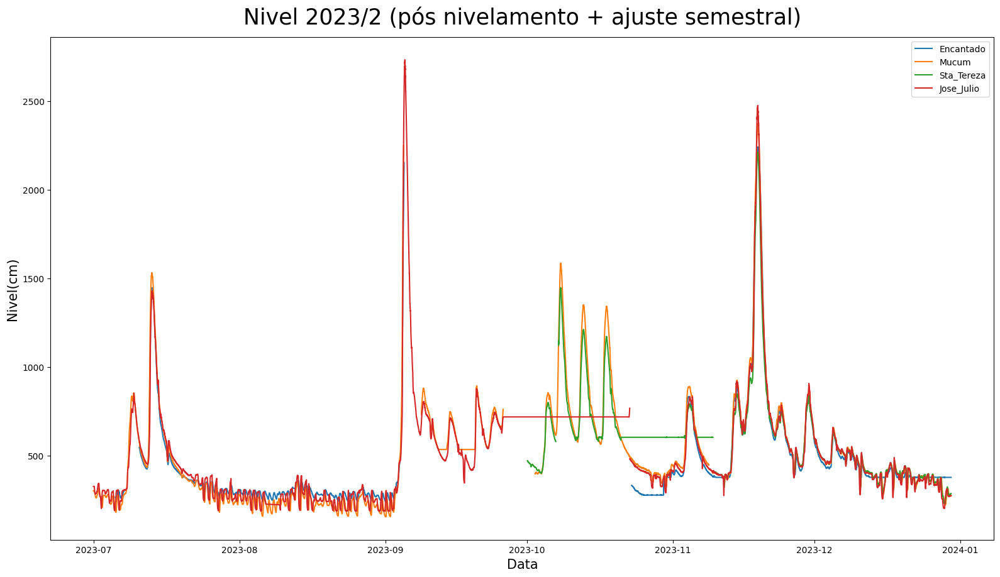

In [66]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2023/2 (pós nivelamento + ajuste semestral)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [67]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-06-20')
data_fim = pd.to_datetime('2024-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Jose_Julio_unico.loc[(df_Jose_Julio_unico['Data/Hora'] >= data_inicio) &
                        (df_Jose_Julio_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] -= 40

In [68]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-8-1')
data_final = pd.to_datetime('2024-8-15')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

In [69]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-06-20')
data_fim = pd.to_datetime('2024-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] += 20

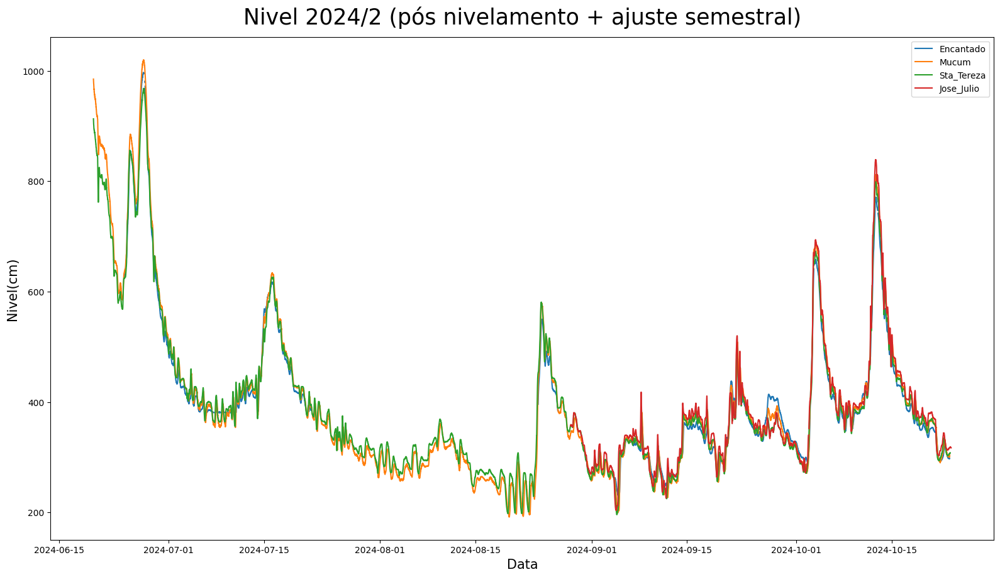

In [70]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-06-20')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2024/2 (pós nivelamento + ajuste semestral)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Fazendo correção nos graficos de Nivel

Nos graficos há medidas constantes não refletindo na realidade, provavelmente falha no medidor
- Vamos remover estes valores

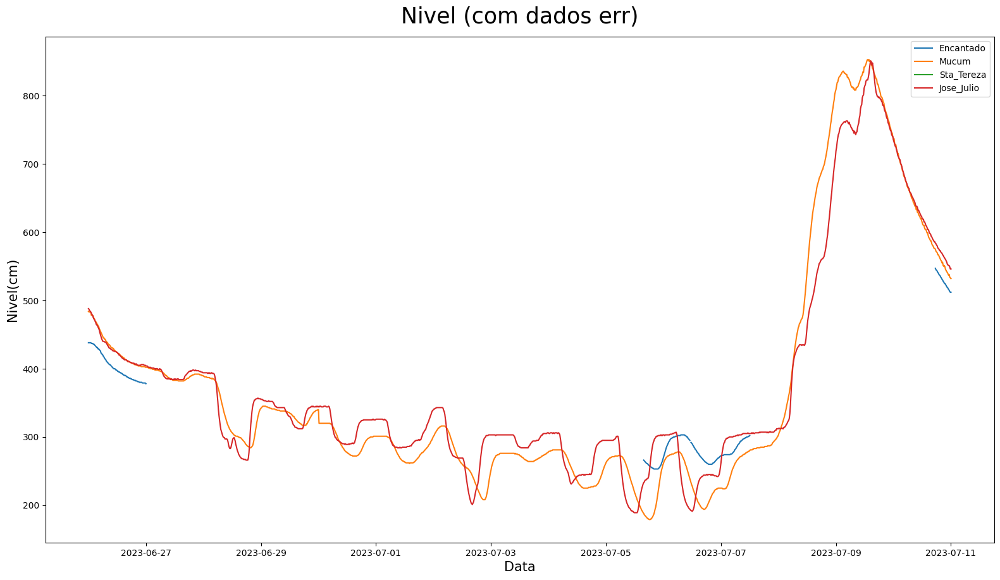

In [71]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-06-26')
data_fim = pd.to_datetime('2023-7-11')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [72]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-06-26')
data_final = pd.to_datetime('2023-7-11')
# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

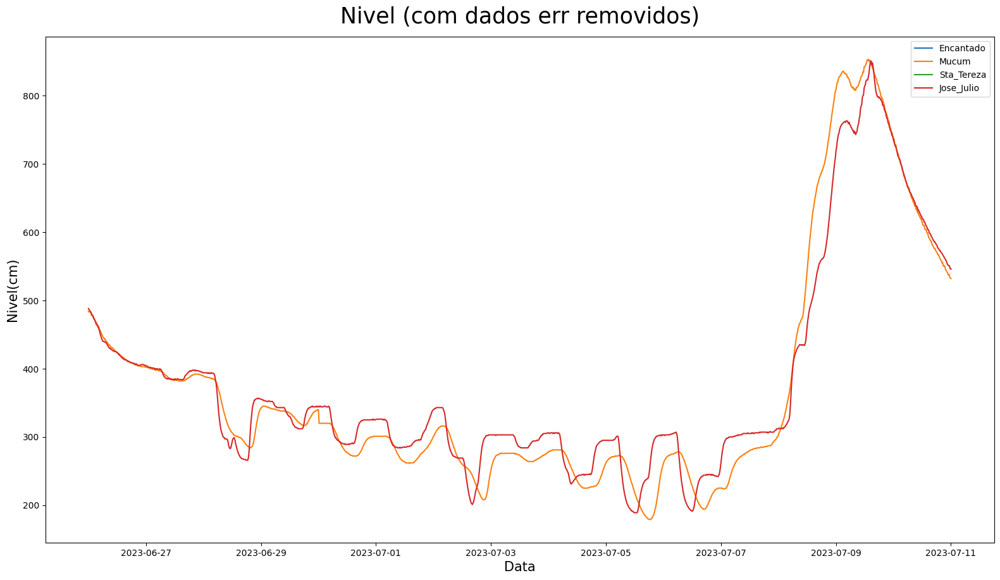

In [73]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-06-26')
data_fim = pd.to_datetime('2023-7-11')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err removidos)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

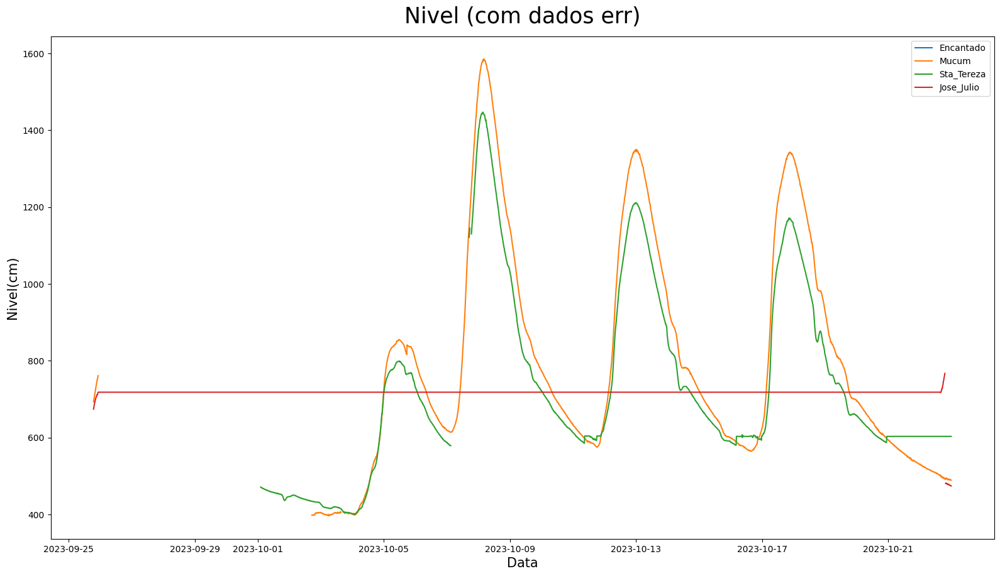

In [74]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-23')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [75]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-09-25 19:00')
data_final = pd.to_datetime('2023-10-23')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Jose_Julio_unico.loc[(df_Jose_Julio_unico['Data/Hora'] >= data_inicial) &
                        (df_Jose_Julio_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

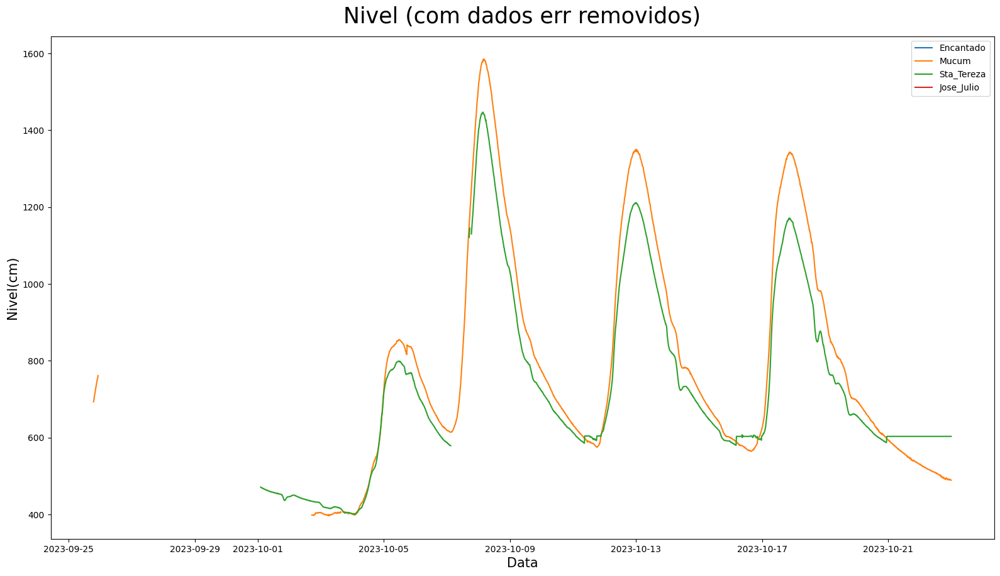

In [76]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-23')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err removidos)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

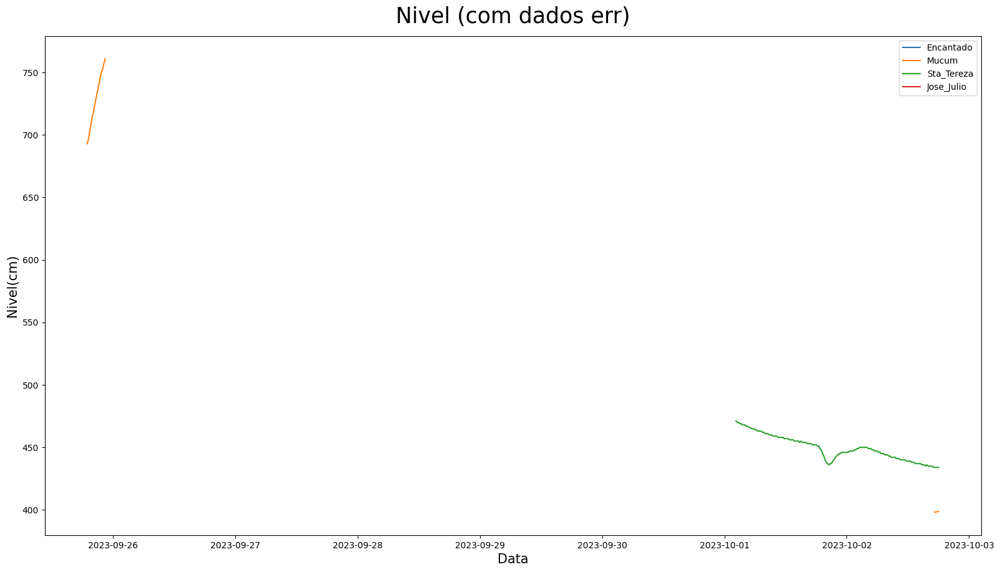

In [77]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-2 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [78]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-09-25 19:00')
data_final = pd.to_datetime('2023-10-2 18:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicial) &
                        (df_Mucum_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

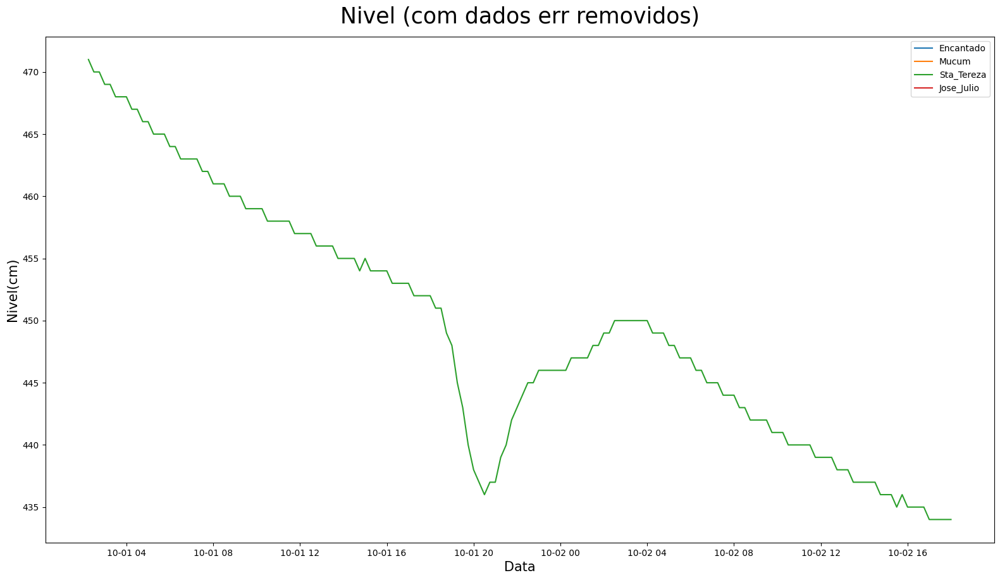

In [79]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-2 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err removidos)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

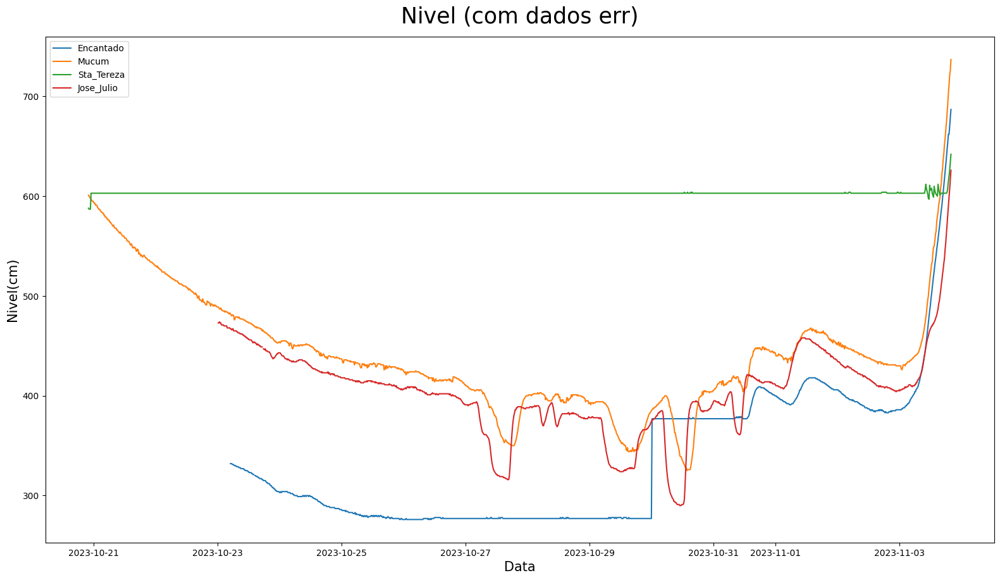

In [80]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-10-20 22:00')
data_fim = pd.to_datetime('2023-11-3 20:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [81]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-10-20 22:00')
data_final = pd.to_datetime('2023-11-3 20:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Sta_Tereza_unico.loc[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicial) &
                        (df_Sta_Tereza_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

In [82]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-10-20 22:00')
data_final = pd.to_datetime('2023-10-31 16:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

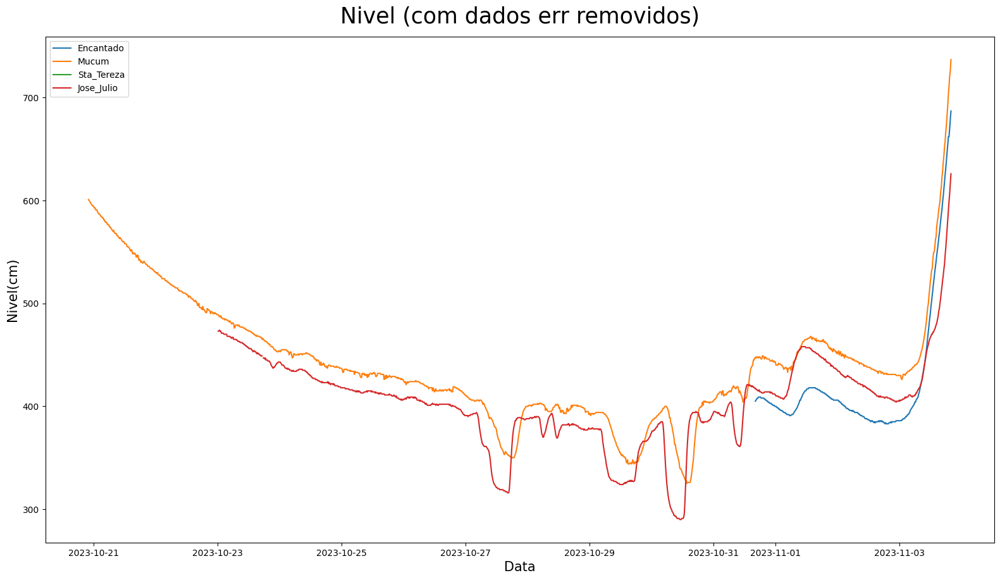

In [83]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-10-20 22:00')
data_fim = pd.to_datetime('2023-11-3 20:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err removidos)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

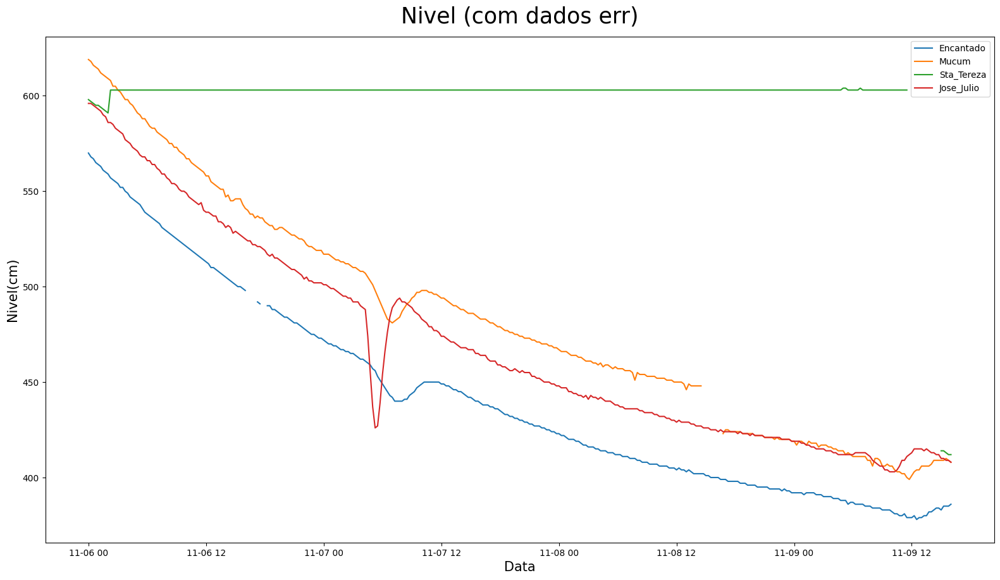

In [84]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-6')
data_fim = pd.to_datetime('2023-11-9 16:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [85]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-11-6')
data_final = pd.to_datetime('2023-11-9 16:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Sta_Tereza_unico.loc[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicial) &
                        (df_Sta_Tereza_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

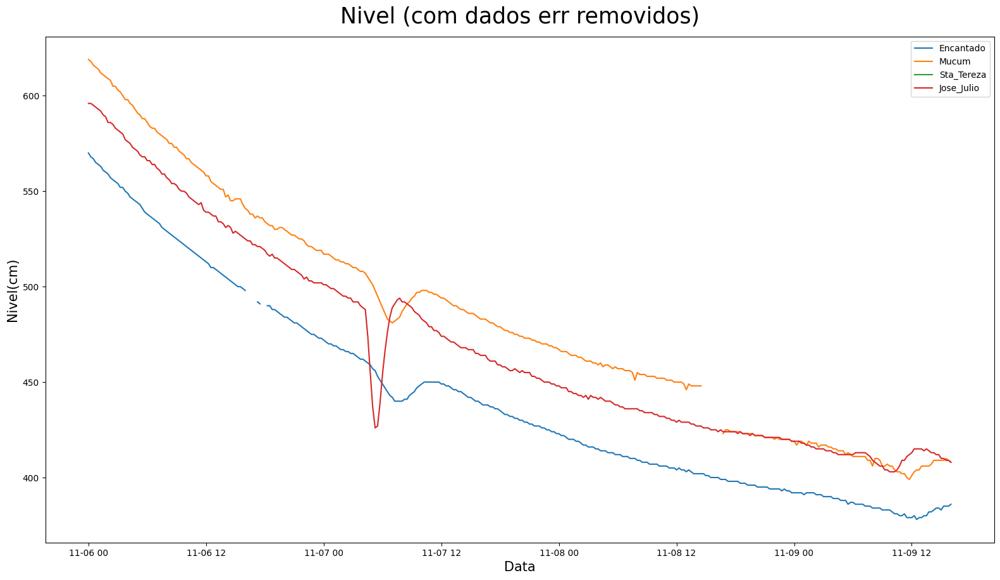

In [86]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-6')
data_fim = pd.to_datetime('2023-11-9 16:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err removidos)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

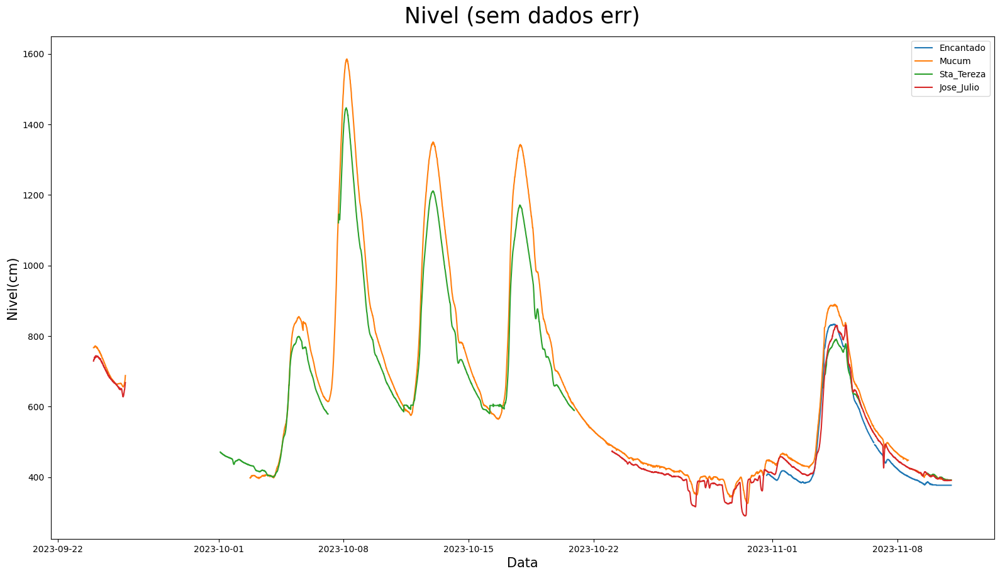

In [87]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-24')
data_fim = pd.to_datetime('2023-11-11')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (sem dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

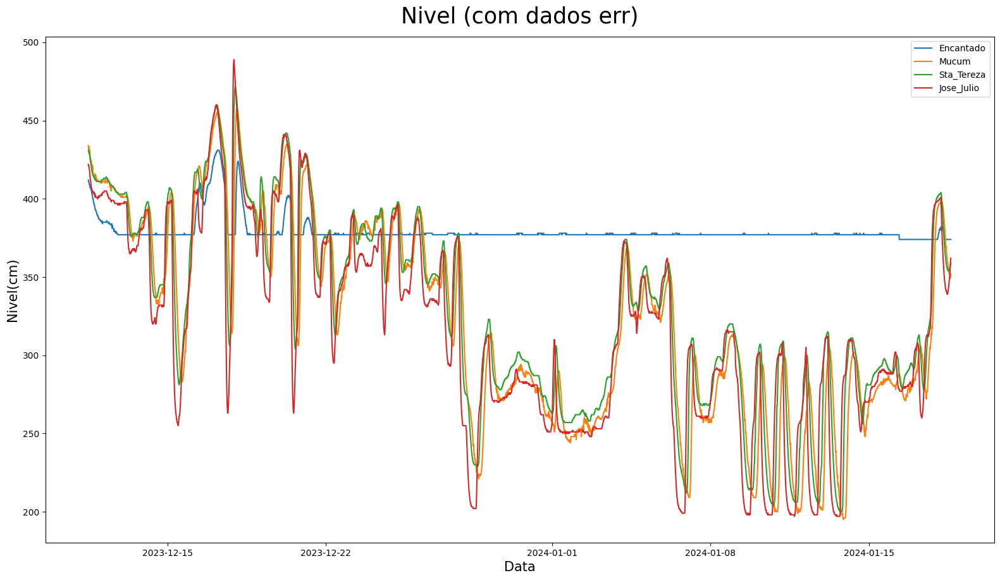

In [88]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-1-18 15:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [89]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-12-11 12:00')
data_final = pd.to_datetime('2024-1-18 15:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

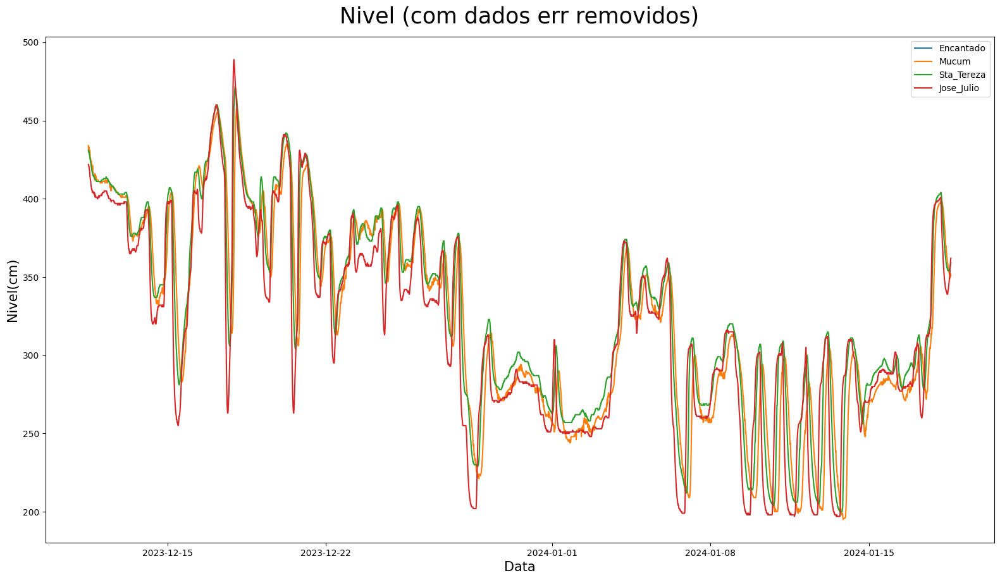

In [90]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-1-18 15:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err removidos)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

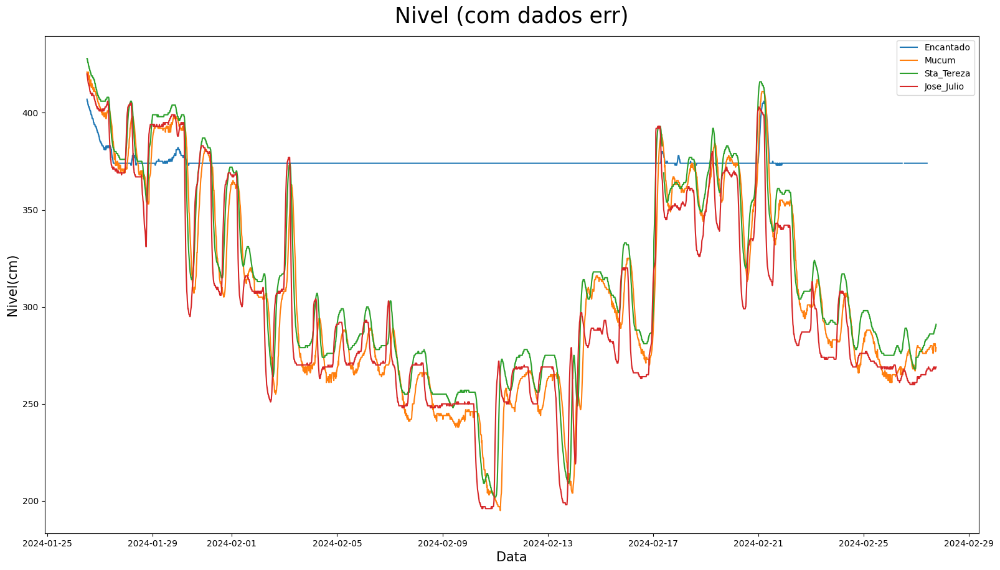

In [91]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-1-26 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [92]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-1-26 12:00')
data_final = pd.to_datetime('2024-2-27 18:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

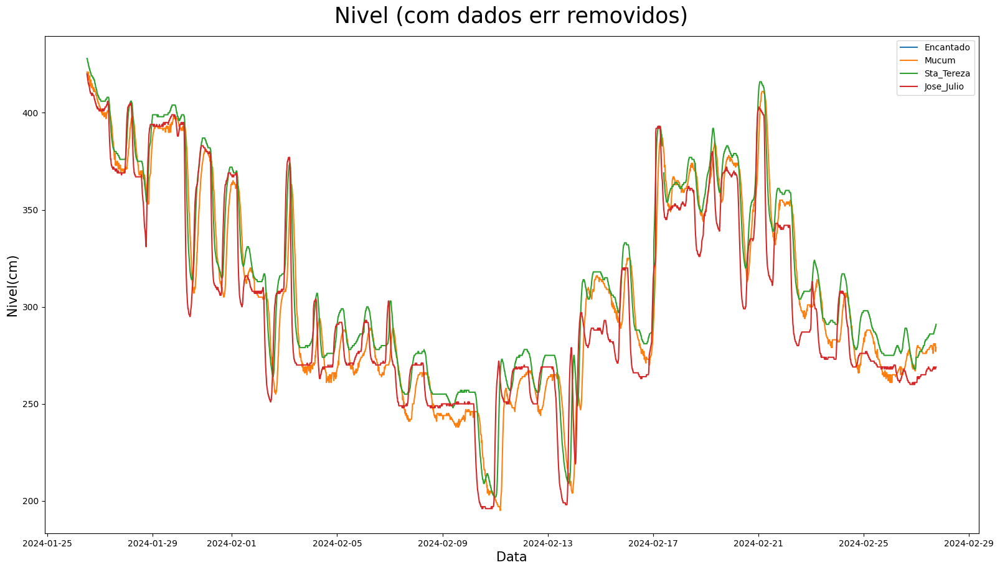

In [93]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-1-26 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (com dados err removidos)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

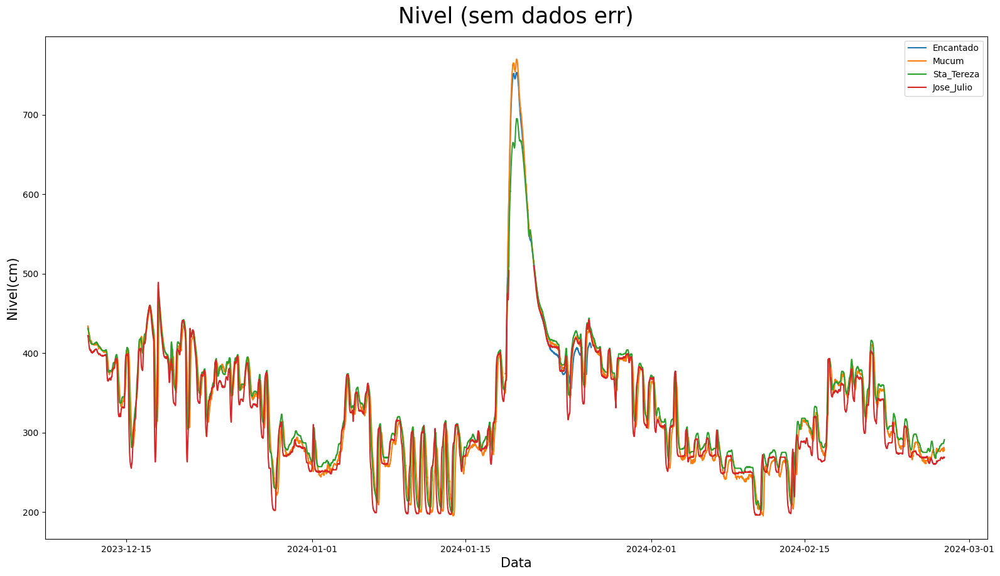

In [94]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (sem dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

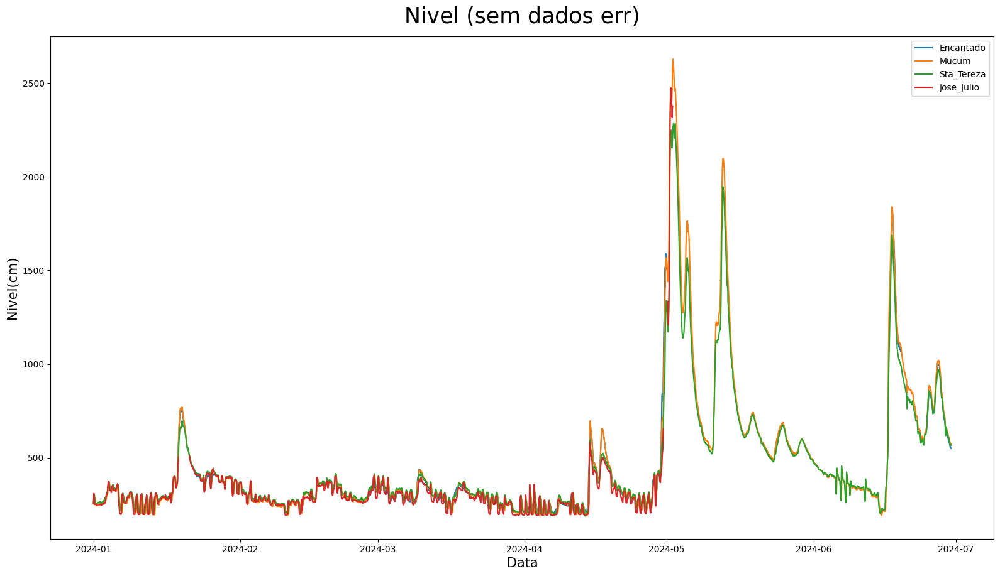

In [95]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (sem dados err)', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Grafico pós tratamento de valores do nivel fora do padrão

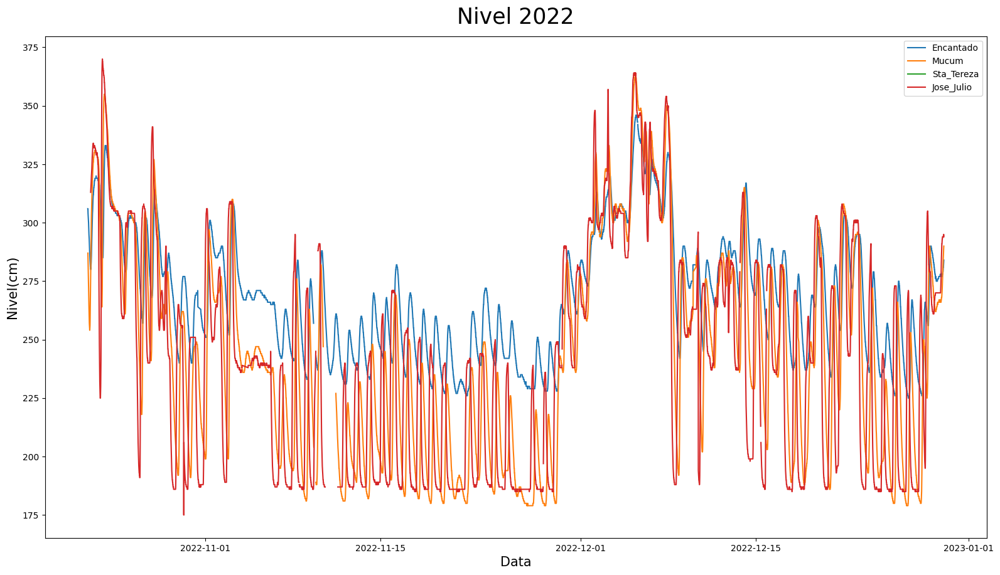

In [96]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2022', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

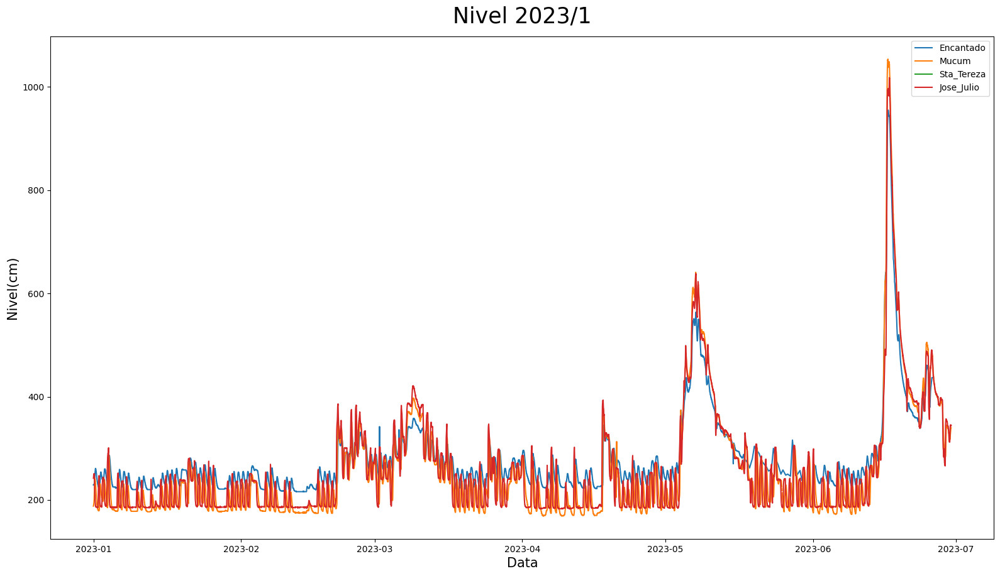

In [97]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2023/1', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

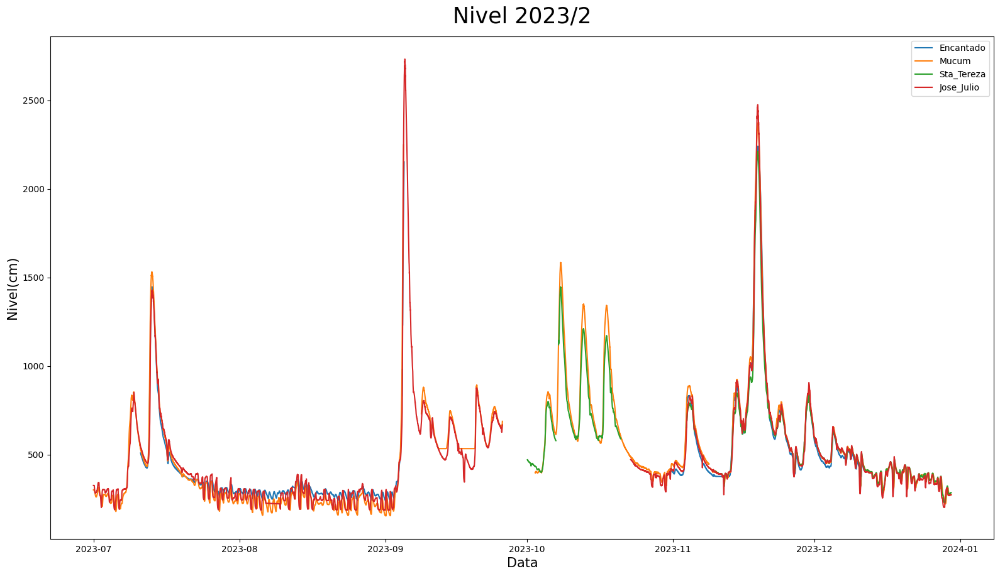

In [98]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2023/2', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

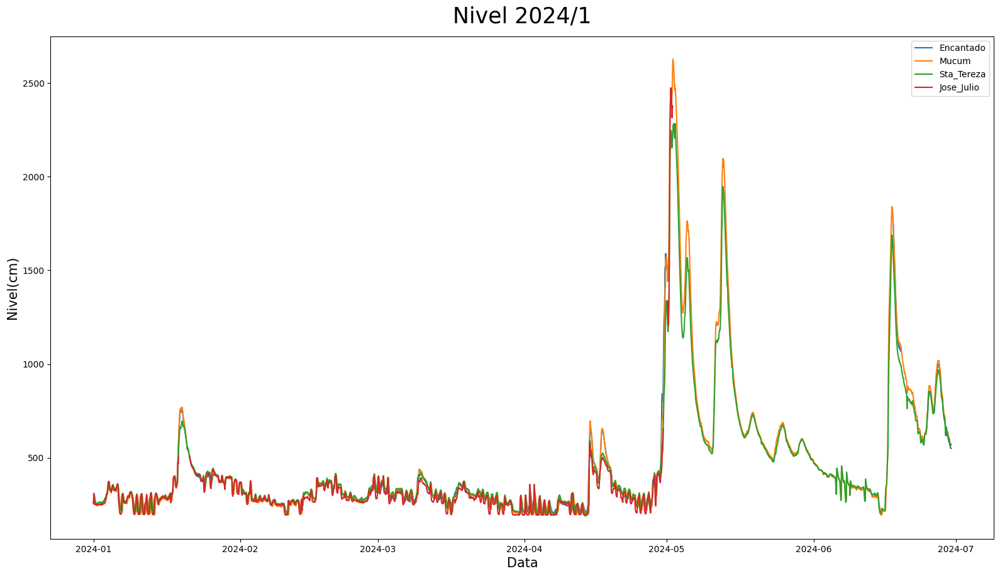

In [99]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2024/1', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

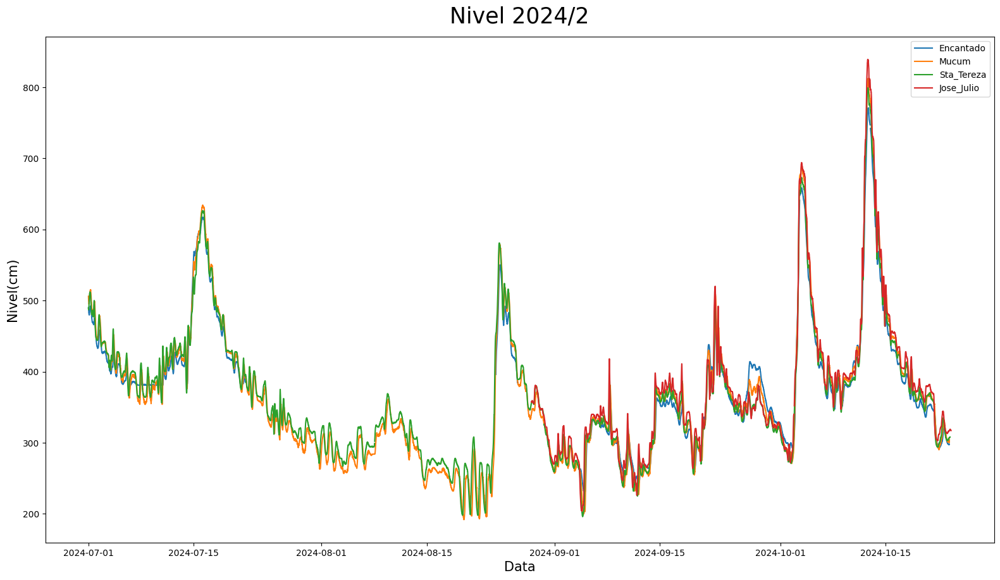

In [100]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 2024/2', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [101]:
df_Encantado_unico.tail()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
64793,2022-10-22 16:15:00,0.0,302.0,229.5
64794,2022-10-22 16:00:00,0.0,303.0,233.2
64795,2022-10-22 15:45:00,0.0,304.0,236.9
64796,2022-10-22 15:30:00,0.0,306.0,244.3
64797,2022-10-22 15:15:00,0.0,306.0,244.3


In [102]:
df_Mucum_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69381 entries, 0 to 69380
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69381 non-null  datetime64[ns]
 1   Chuva(mm)    69381 non-null  float64       
 2   Nivel(cm)    68877 non-null  float64       
 3   Vazao(m3/s)  68897 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


## Deslocamento dos dados em relação a vasão (geral)

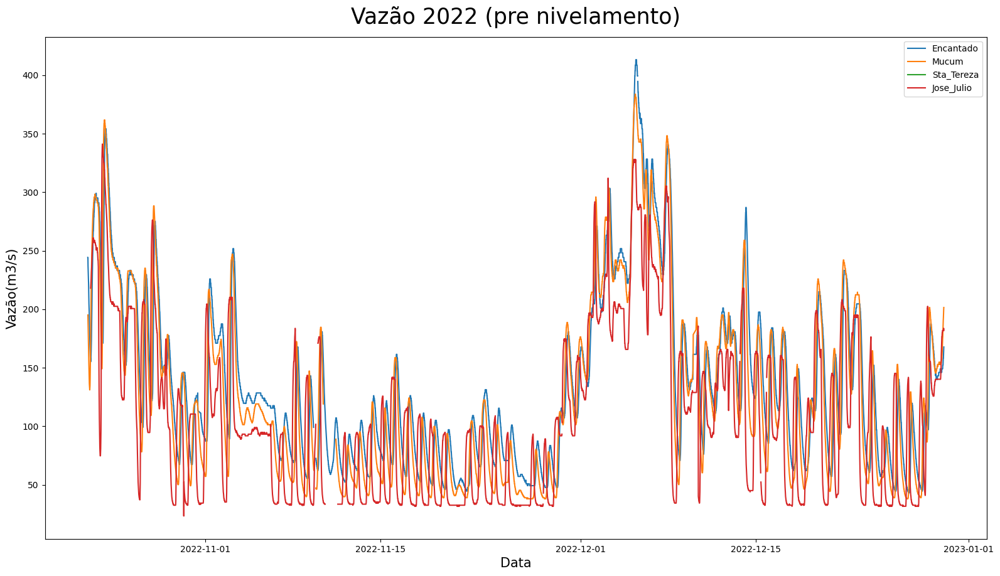

In [103]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-8-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 2022 (pre nivelamento)', 'Data', 'Vazão(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [104]:
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'] - 35
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'] - 0
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'] + 5

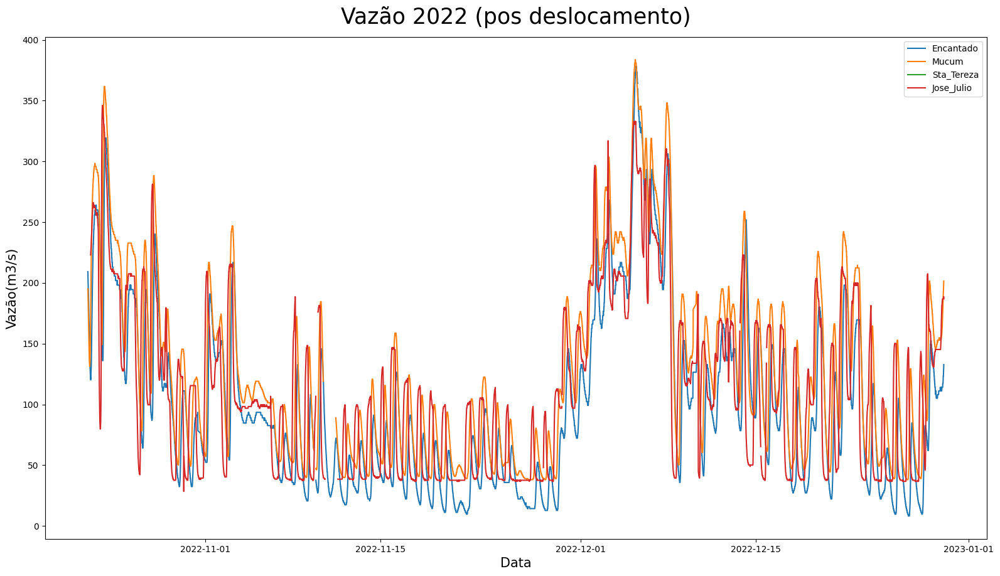

In [105]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-8-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 2022 (pos deslocamento)', 'Data', 'Vazão(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Deslocamento dos dados em relação da vazao (por partes)

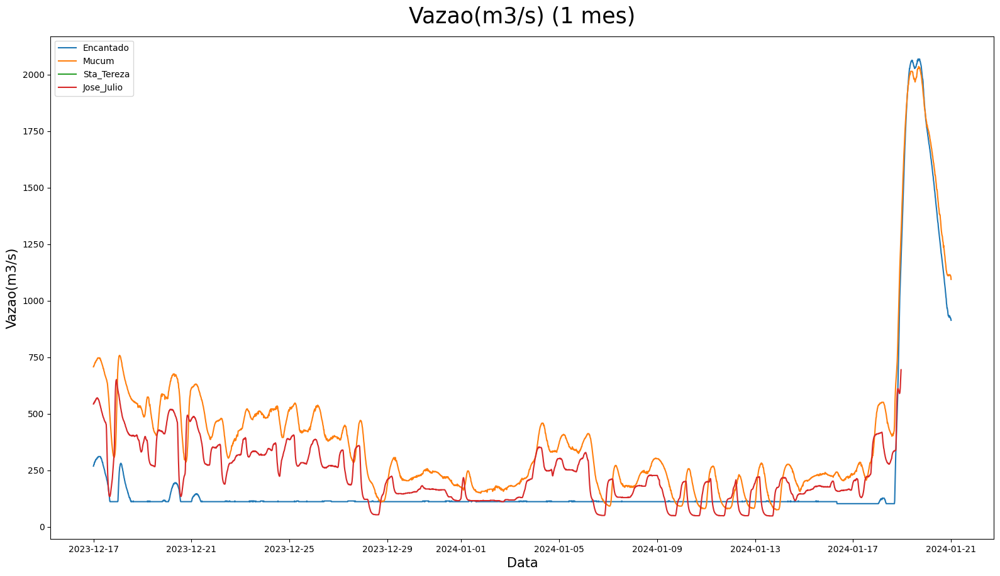

In [106]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-01-21')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) (1 mes)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

no grafico aciima notamos que os valores não tem diferença em questão temporal mas vemoz que possuem niveis diferentes

- Os Valores abaixo são para eles terem uma diferença geral semelhante

In [107]:
df_Encantado_unico['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'] + 180
df_Mucum_unico['Nivel(cm)'] = df_Mucum_unico['Nivel(cm)'] + 70
df_Sta_Tereza_unico['Nivel(cm)'] = df_Sta_Tereza_unico['Nivel(cm)'] + 50
df_Jose_Julio_unico['Nivel(cm)'] = df_Jose_Julio_unico['Nivel(cm)'] - 40

- Os graficos abaixo foram separados em faixa de 6 meses para facilitar a visualização

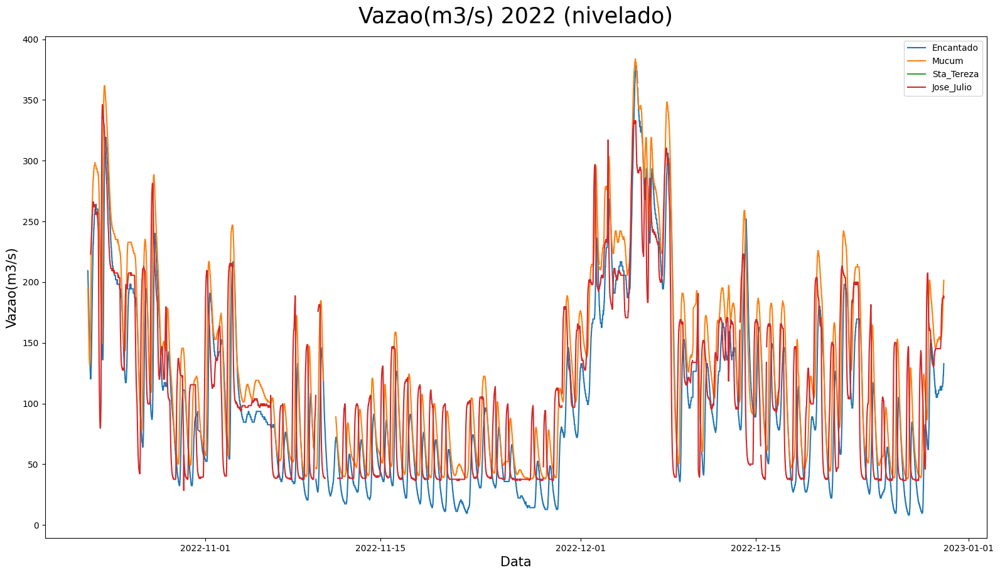

In [108]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2022 (nivelado)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

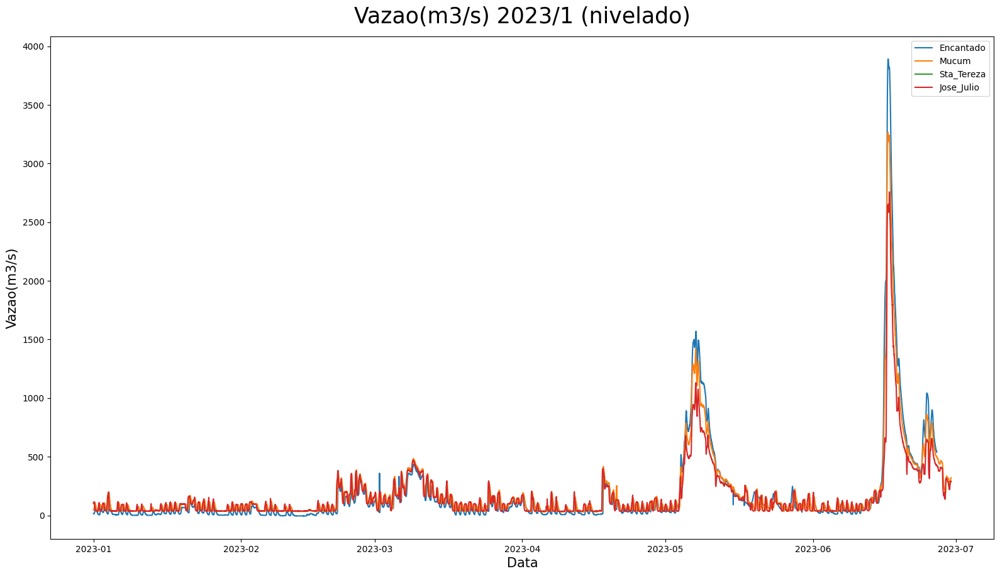

In [109]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2023/1 (nivelado)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

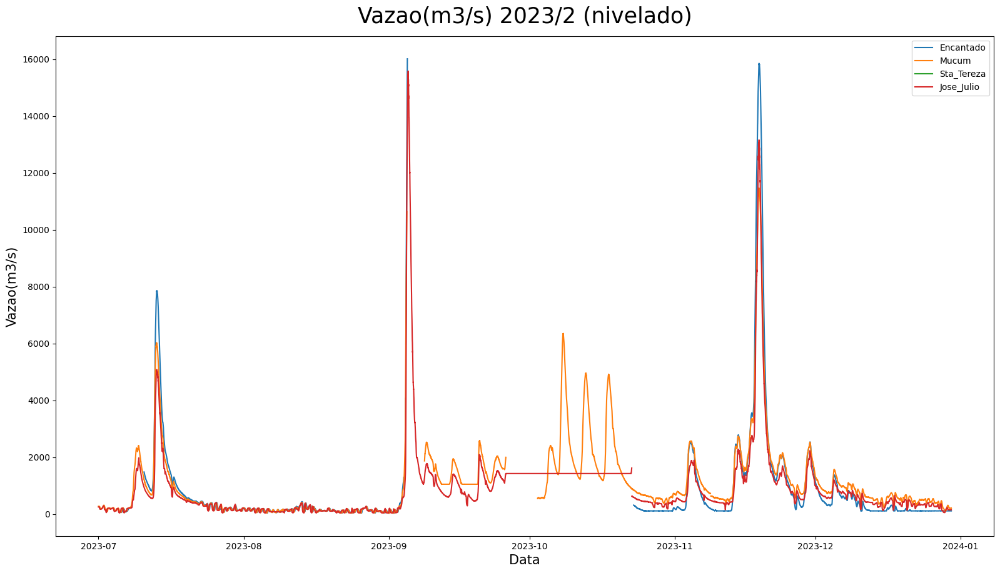

In [110]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2023/2 (nivelado)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

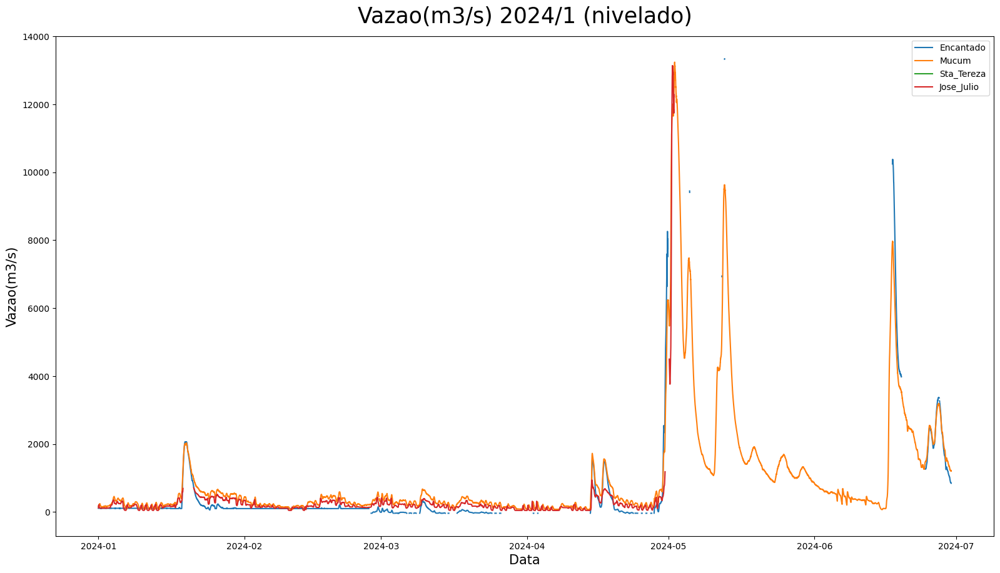

In [111]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2024/1 (nivelado)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

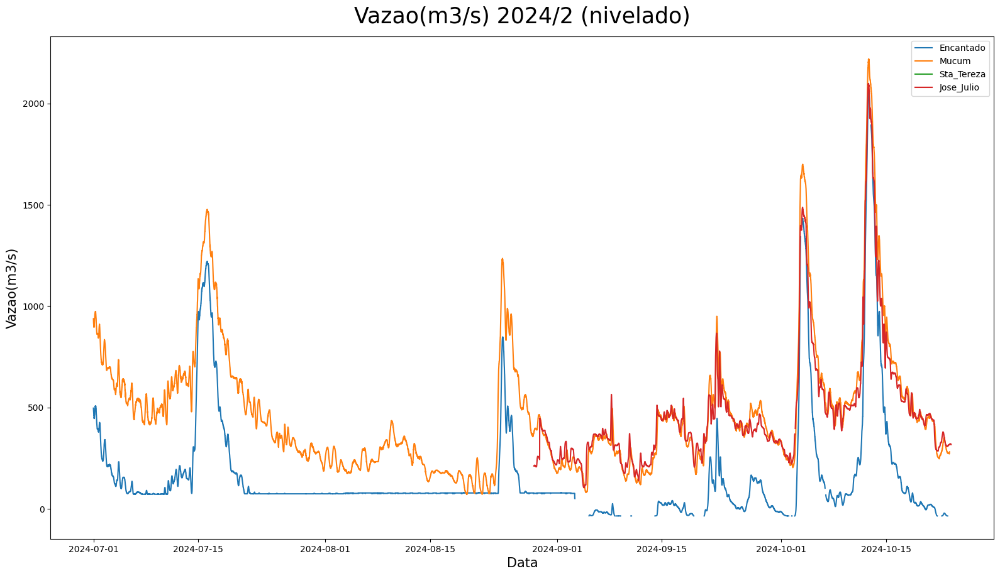

In [112]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2024/2 (nivelado)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

Foi possivel notar que em faixas temporais há diferença de altura pois o medidor deve ter sido realocado do ponto original

*   Será necessario fazer ajustes em faixas temporais especifica



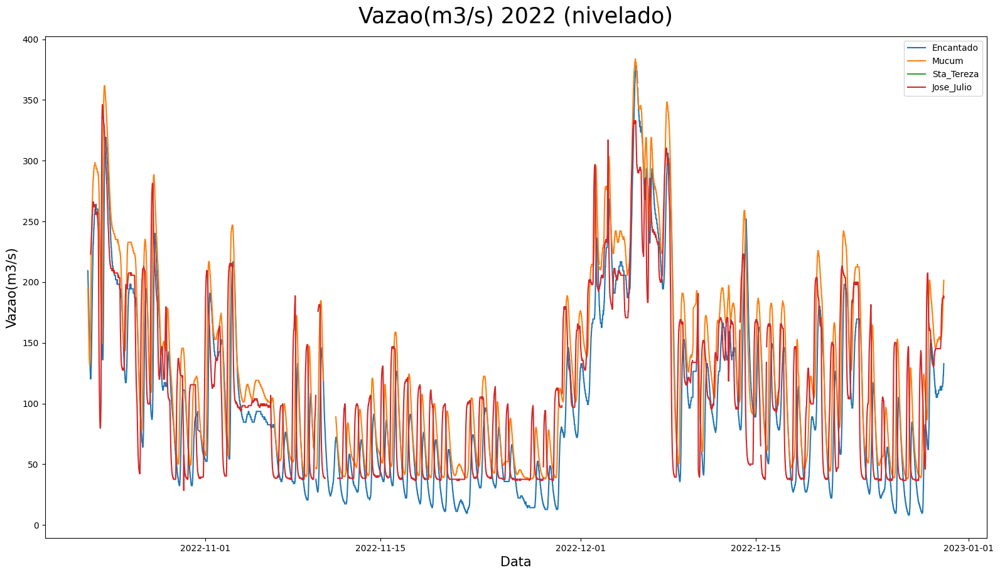

In [113]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2022 (nivelado)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

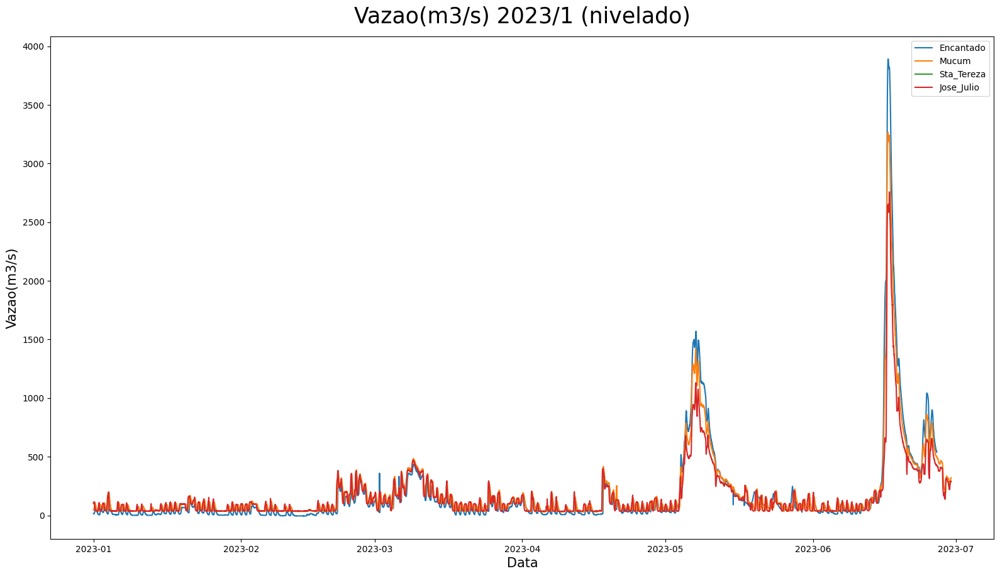

In [114]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2023/1 (nivelado)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [115]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-6')
data_fim = pd.to_datetime('2023-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                        (df_Mucum_unico['Data/Hora'] <= data_fim),
                        'Vazao(m3/s)'] -= 250

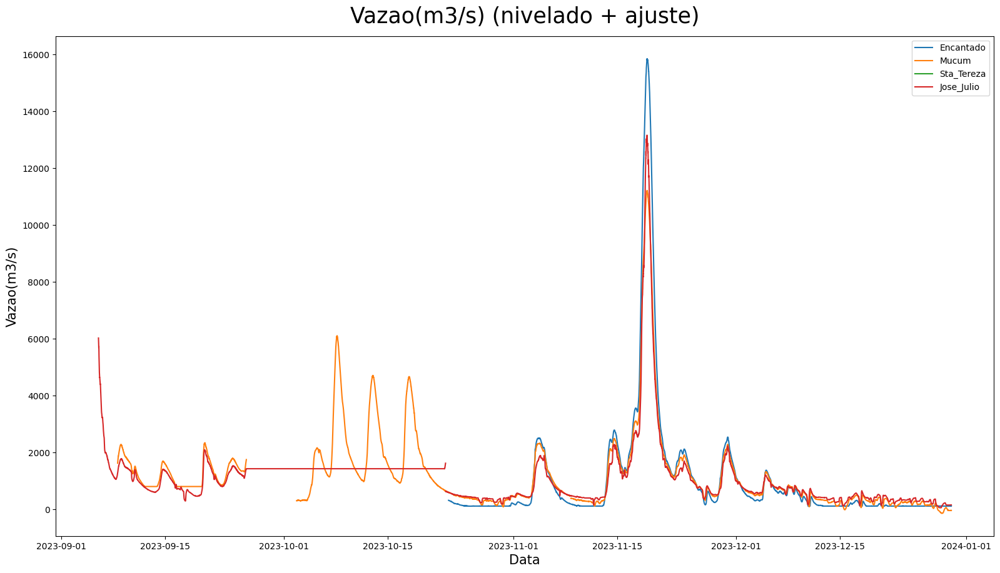

In [116]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-6')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) (nivelado + ajuste)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

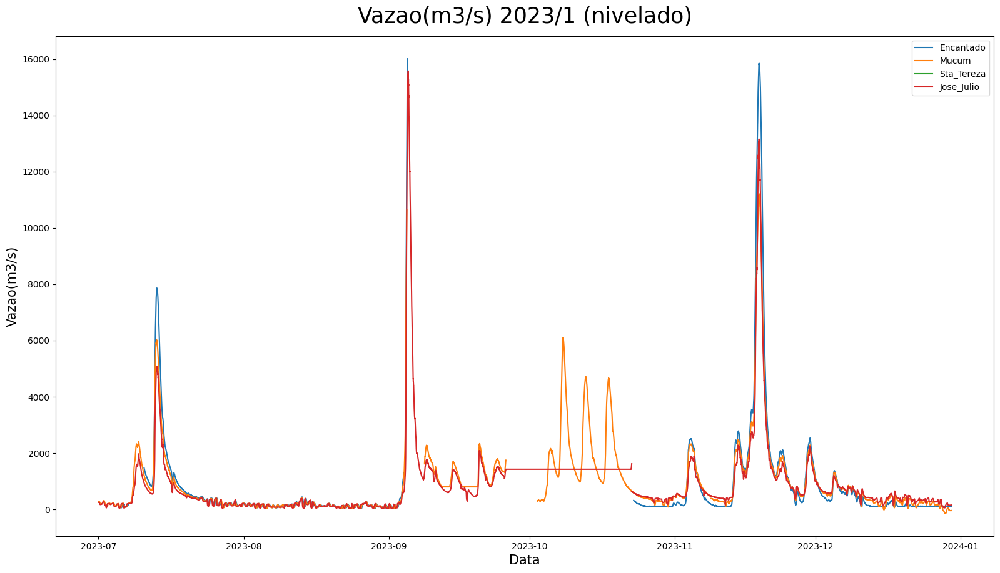

In [117]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2023/1 (nivelado)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [118]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                        (df_Mucum_unico['Data/Hora'] <= data_fim),
                        'Vazao(m3/s)'] -= 100

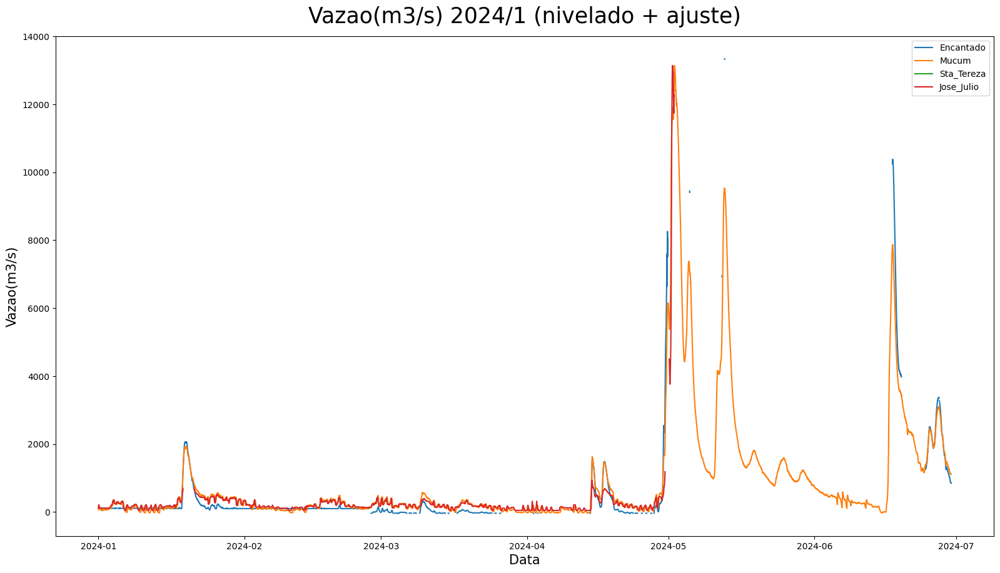

In [119]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2024/1 (nivelado + ajuste)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [120]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Vazao(m3/s)'] += 390

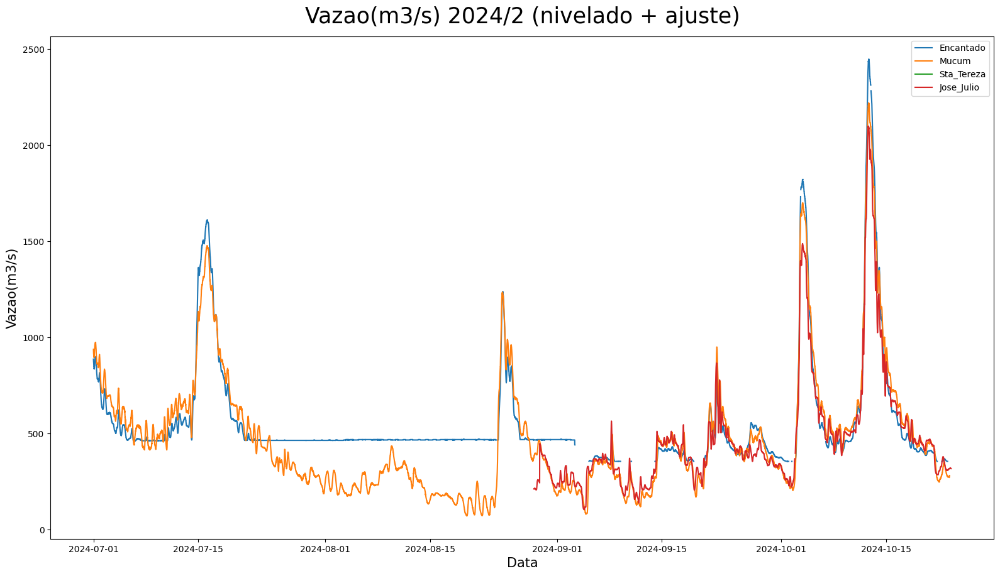

In [121]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2024/2 (nivelado + ajuste)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Fazendo correção nos graficos da vazao

Nos graficos há medidas constantes não refletindo na realidade, provavelmente falha no medidor
- Vamos remover estes valores

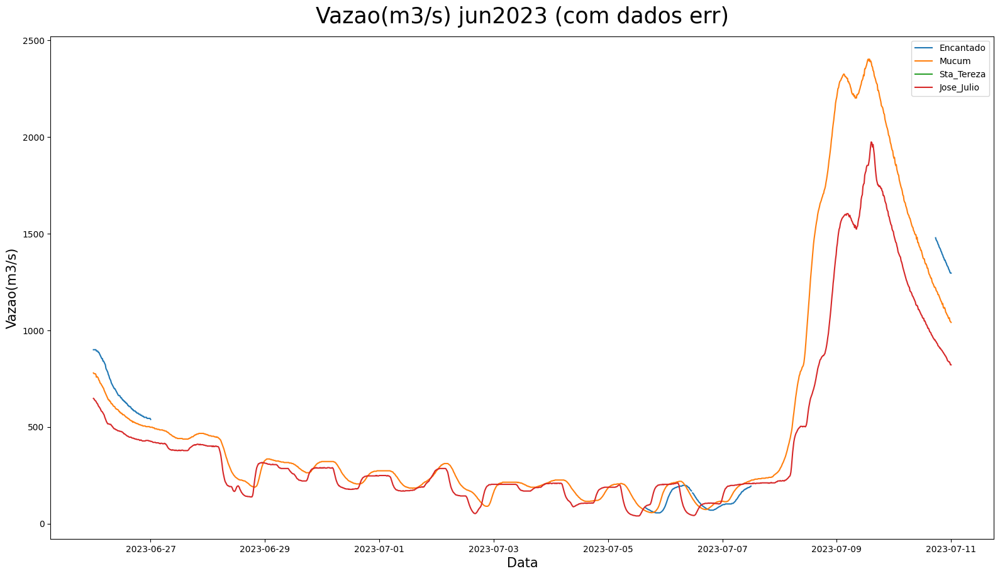

In [122]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-06-26')
data_fim = pd.to_datetime('2023-7-11')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) jun2023 (com dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [123]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-06-26')
data_final = pd.to_datetime('2023-7-11')
# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

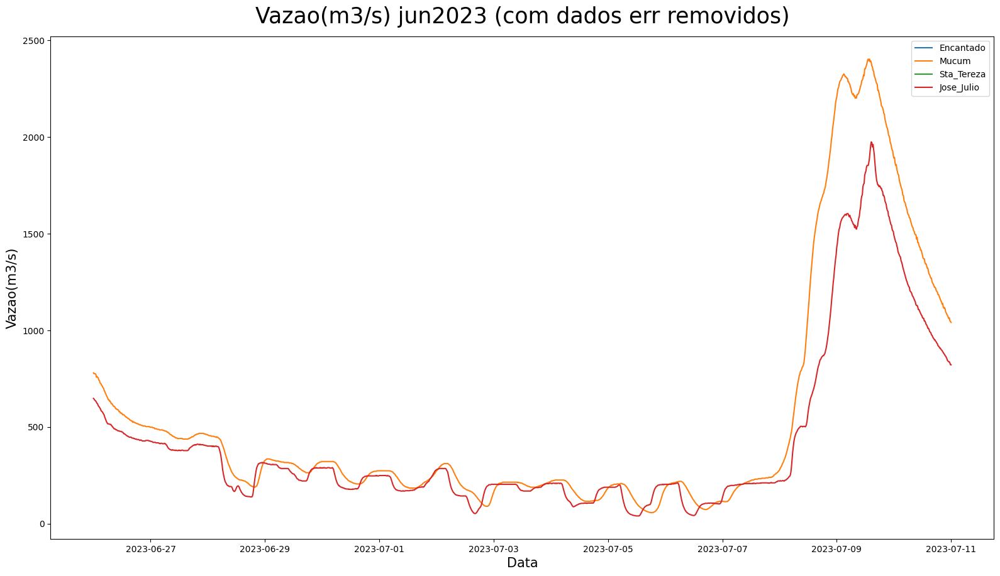

In [124]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-06-26')
data_fim = pd.to_datetime('2023-7-11')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) jun2023 (com dados err removidos)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

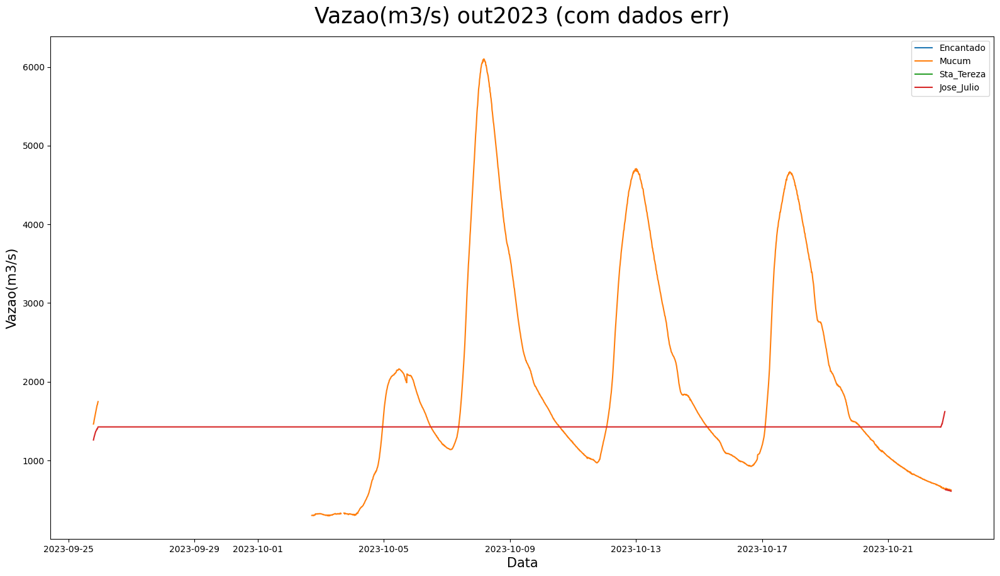

In [125]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-23')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) out2023 (com dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [126]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-09-25 19:00')
data_final = pd.to_datetime('2023-10-23')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Jose_Julio_unico.loc[(df_Jose_Julio_unico['Data/Hora'] >= data_inicial) &
                        (df_Jose_Julio_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

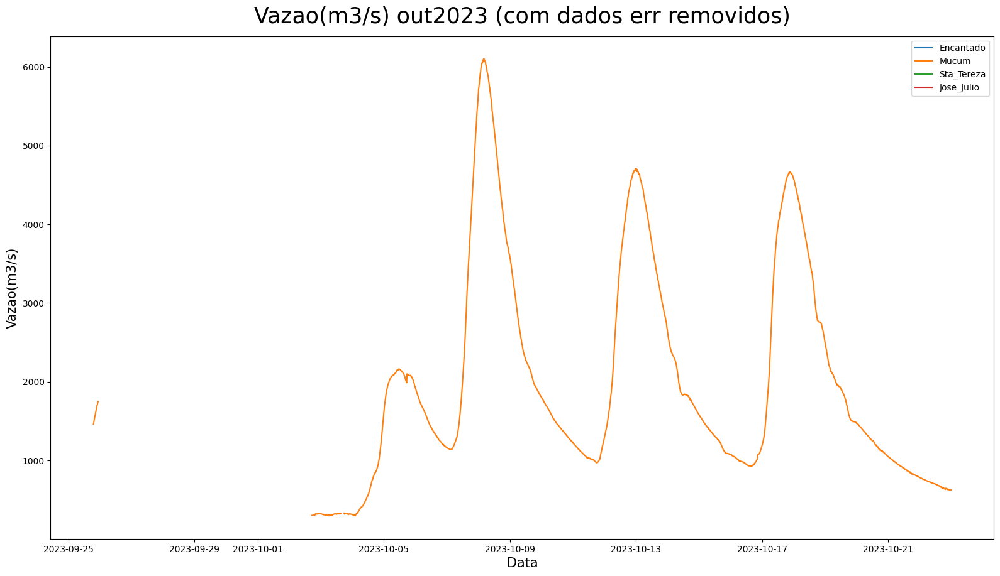

In [127]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-23')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) out2023 (com dados err removidos)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

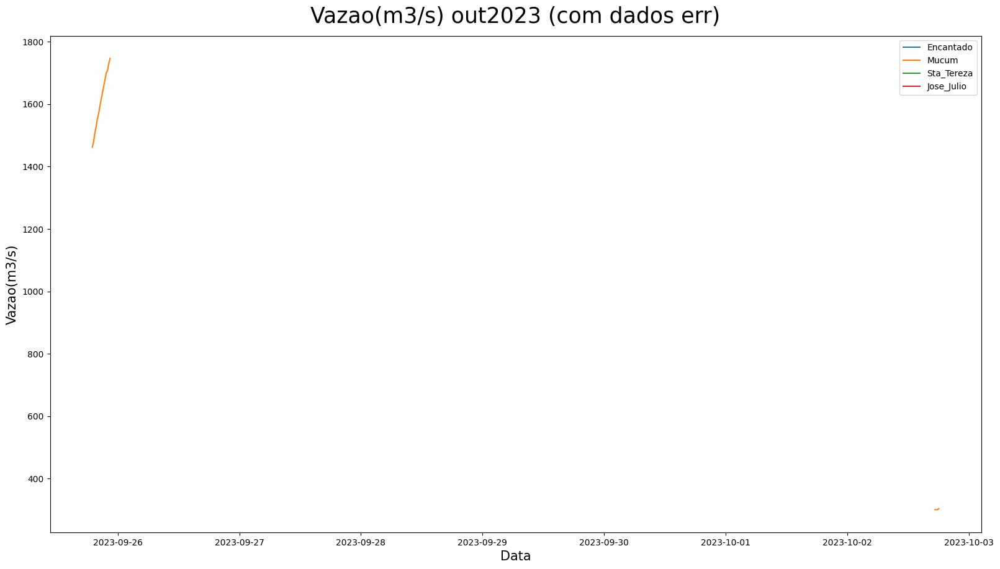

In [128]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-2 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) out2023 (com dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [129]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-09-25 19:00')
data_final = pd.to_datetime('2023-10-2 18:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicial) &
                        (df_Mucum_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

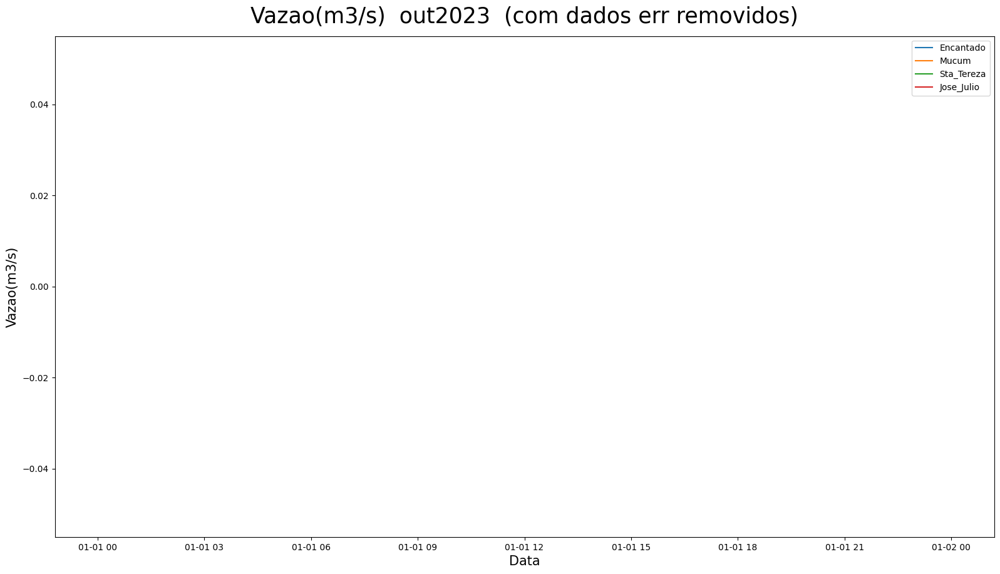

In [130]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-2 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)  out2023  (com dados err removidos)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

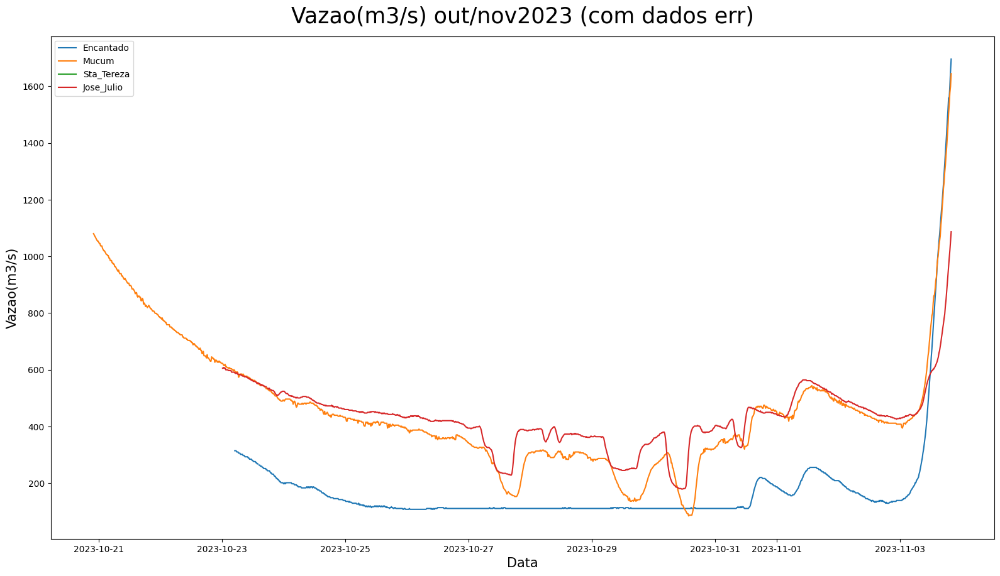

In [131]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-10-20 22:00')
data_fim = pd.to_datetime('2023-11-3 20:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) out/nov2023 (com dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [132]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-10-20 22:00')
data_final = pd.to_datetime('2023-11-3 20:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Sta_Tereza_unico.loc[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicial) &
                        (df_Sta_Tereza_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

In [133]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-10-20 22:00')
data_final = pd.to_datetime('2023-10-31 16:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

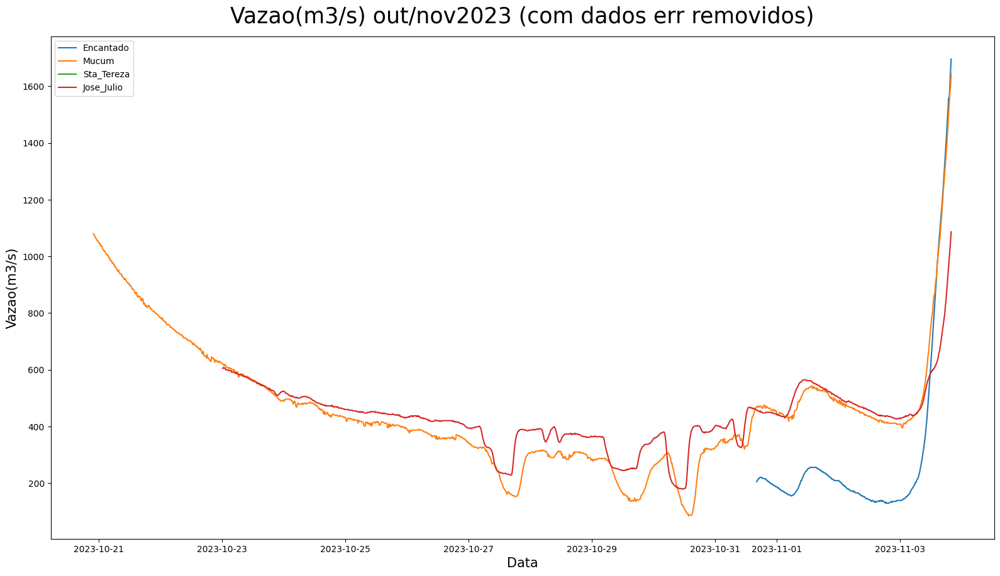

In [134]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-10-20 22:00')
data_fim = pd.to_datetime('2023-11-3 20:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) out/nov2023 (com dados err removidos)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

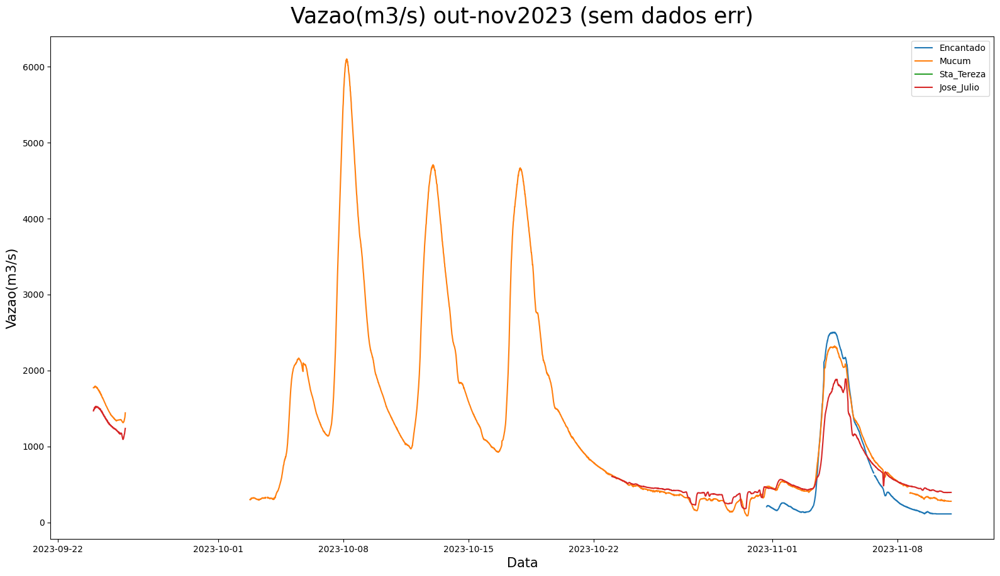

In [135]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-24')
data_fim = pd.to_datetime('2023-11-11')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) out-nov2023 (sem dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

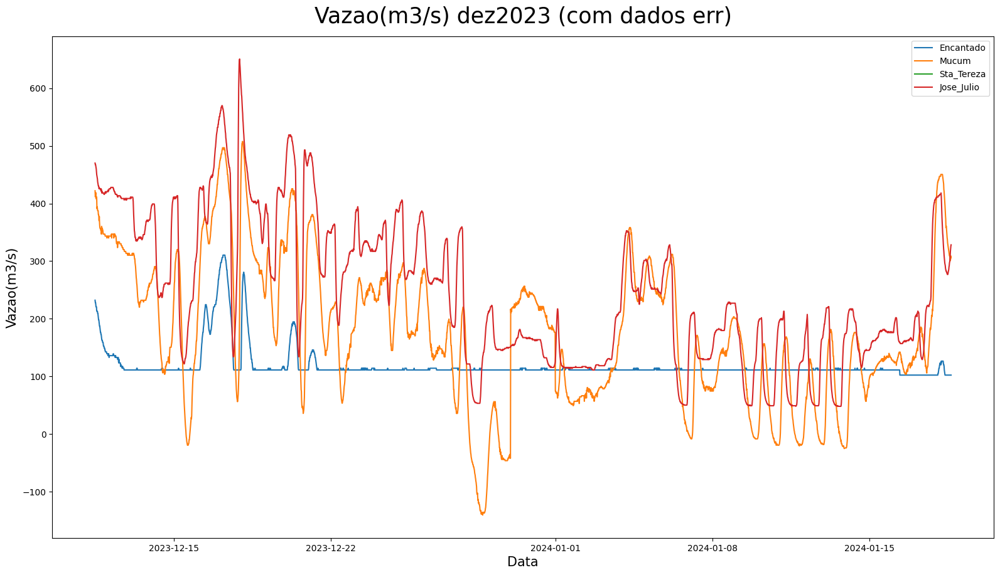

In [136]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-1-18 15:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) dez2023 (com dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [137]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-12-11 12:00')
data_final = pd.to_datetime('2024-1-18 15:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

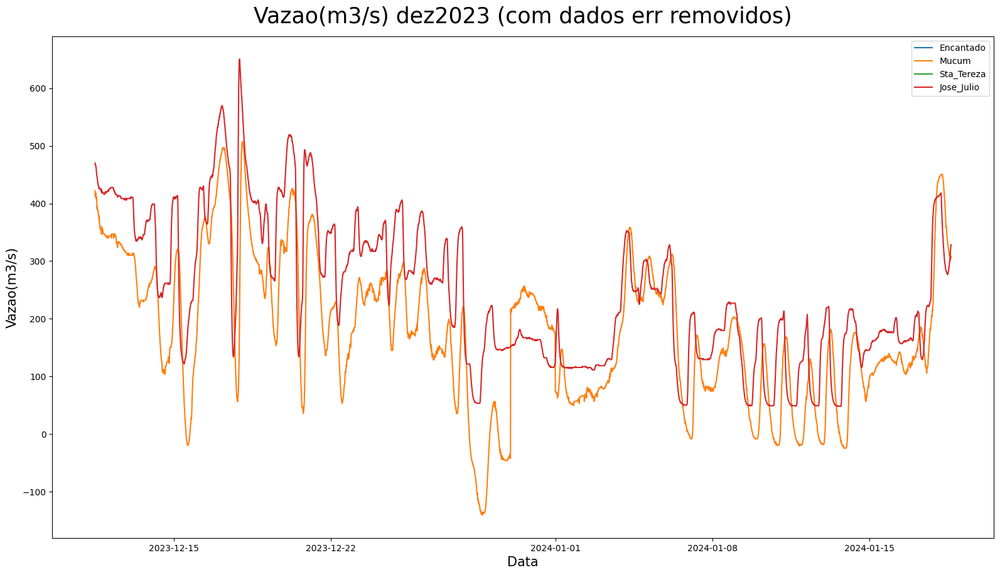

In [138]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-1-18 15:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) dez2023 (com dados err removidos)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

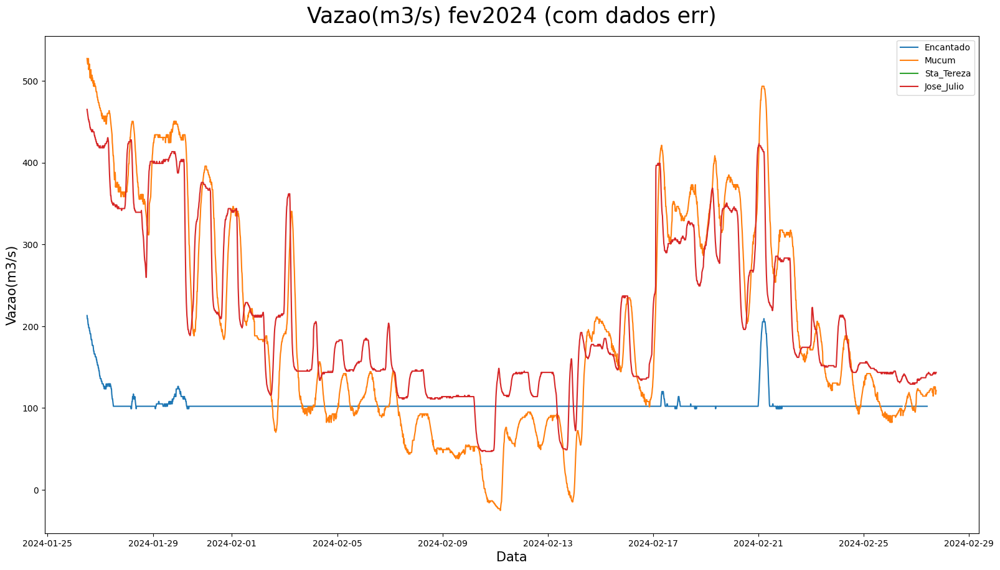

In [139]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-1-26 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) fev2024 (com dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [140]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-1-26 12:00')
data_final = pd.to_datetime('2024-2-27 18:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

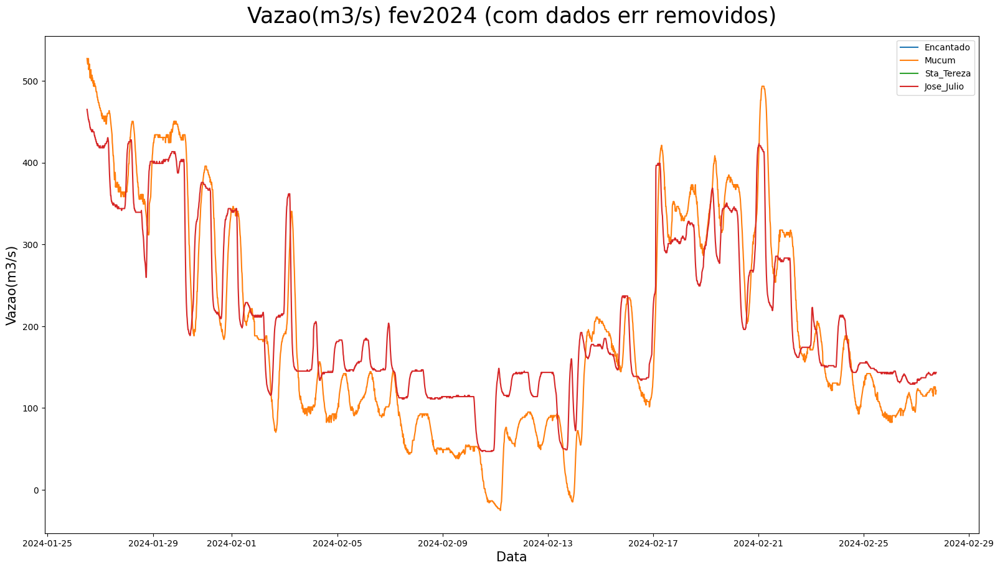

In [141]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-1-26 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) fev2024 (com dados err removidos)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

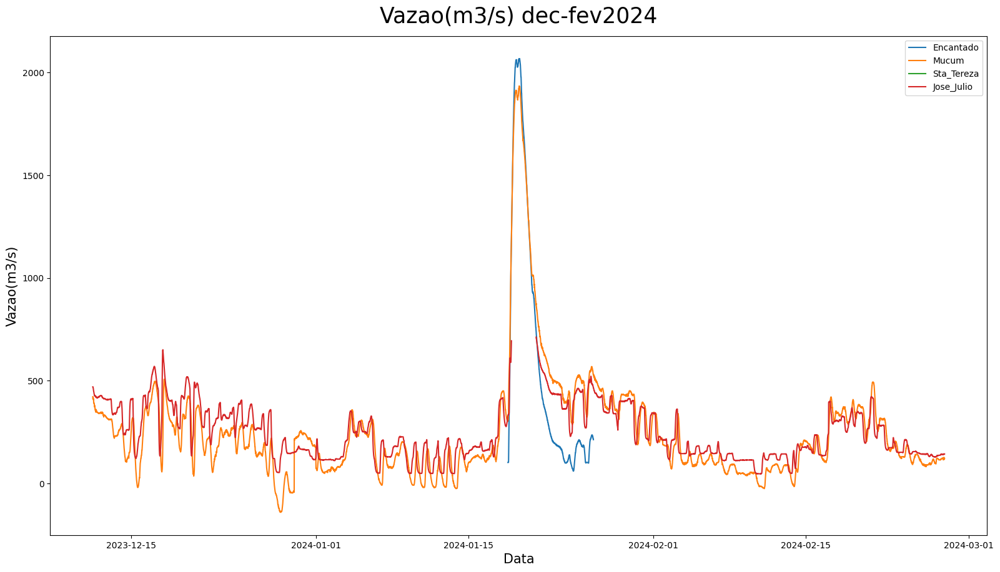

In [142]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) dec-fev2024', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

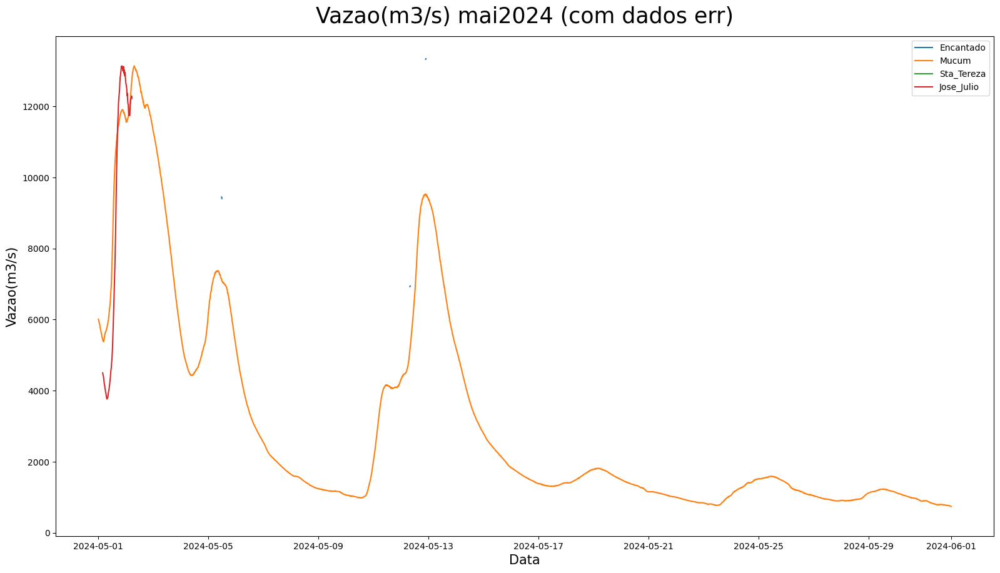

In [143]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-05-1')
data_fim = pd.to_datetime('2024-6-1')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) mai2024 (com dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [144]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-05-1')
data_final = pd.to_datetime('2024-6-1')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

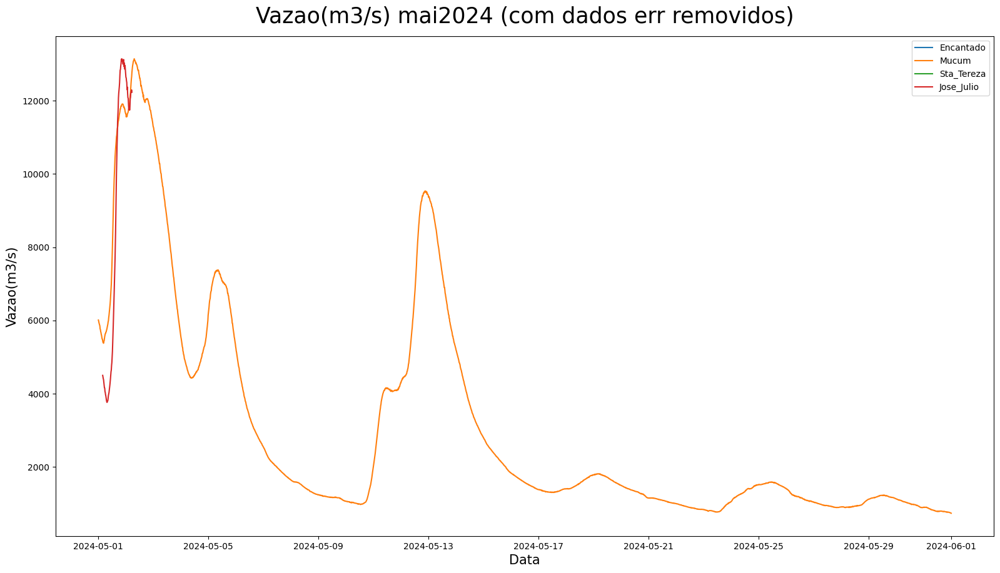

In [145]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-05-1')
data_fim = pd.to_datetime('2024-6-1')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) mai2024 (com dados err removidos)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

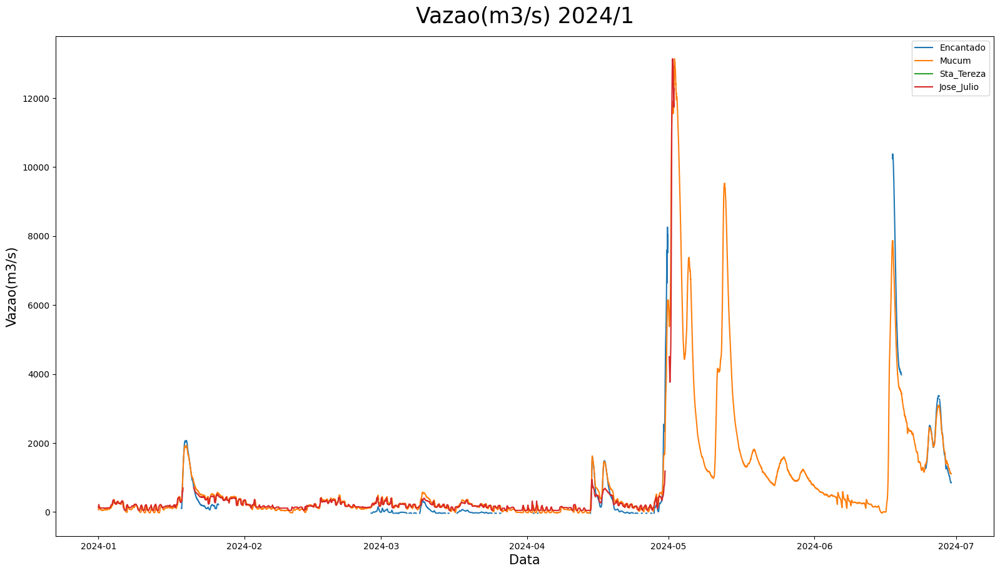

In [146]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2024/1', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

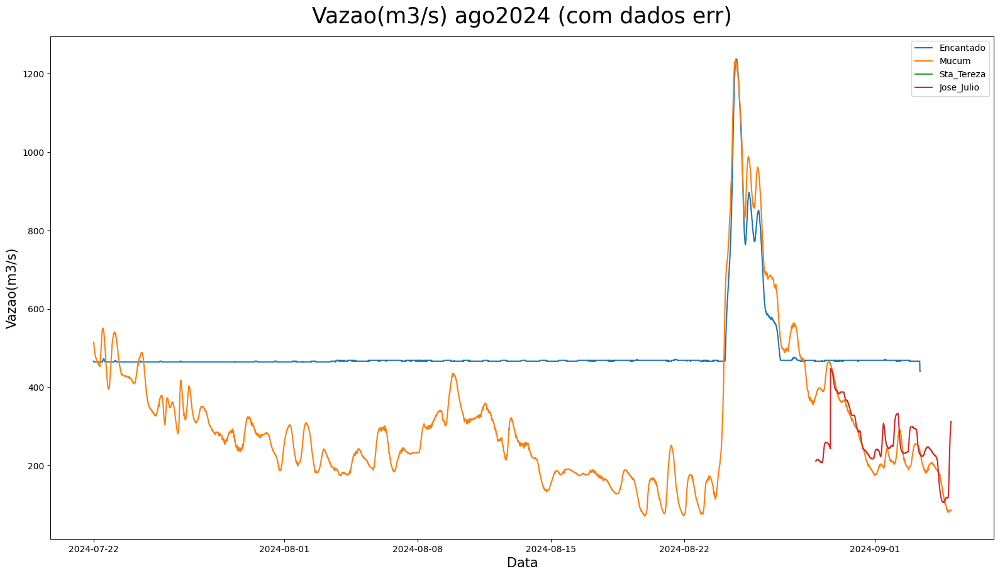

In [147]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-22')
data_fim = pd.to_datetime('2024-9-5')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) ago2024 (com dados err)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [148]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-07-22')
data_final = pd.to_datetime('2024-08-23 23:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

In [149]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-8-27')
data_final = pd.to_datetime('2024-9-5')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

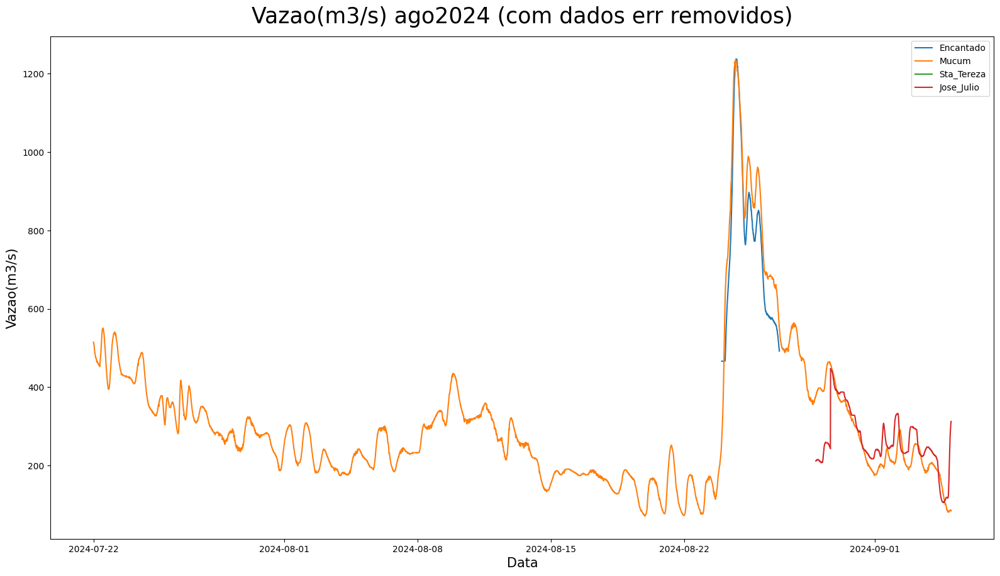

In [150]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-22')
data_fim = pd.to_datetime('2024-9-5')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) ago2024 (com dados err removidos)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

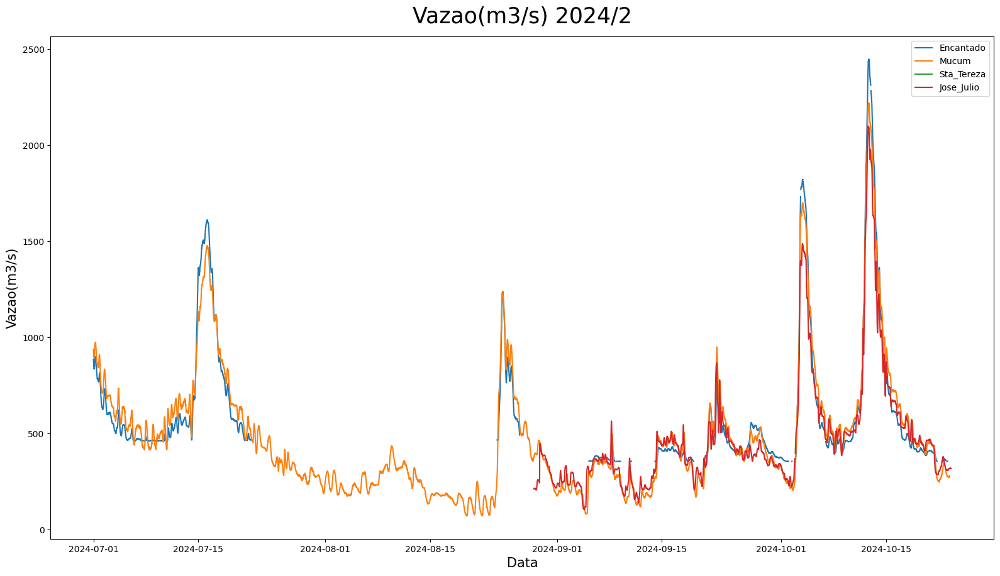

In [151]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2024/2', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Grafico pós tratamento de Vasão

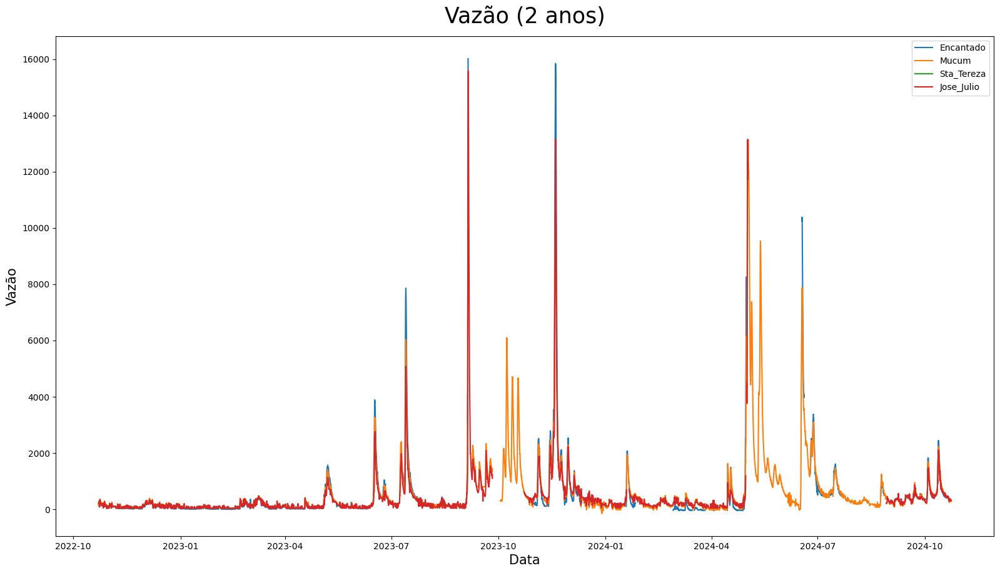

In [152]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-10-17')
data_fim = pd.to_datetime('2024-12-21')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão (2 anos)', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

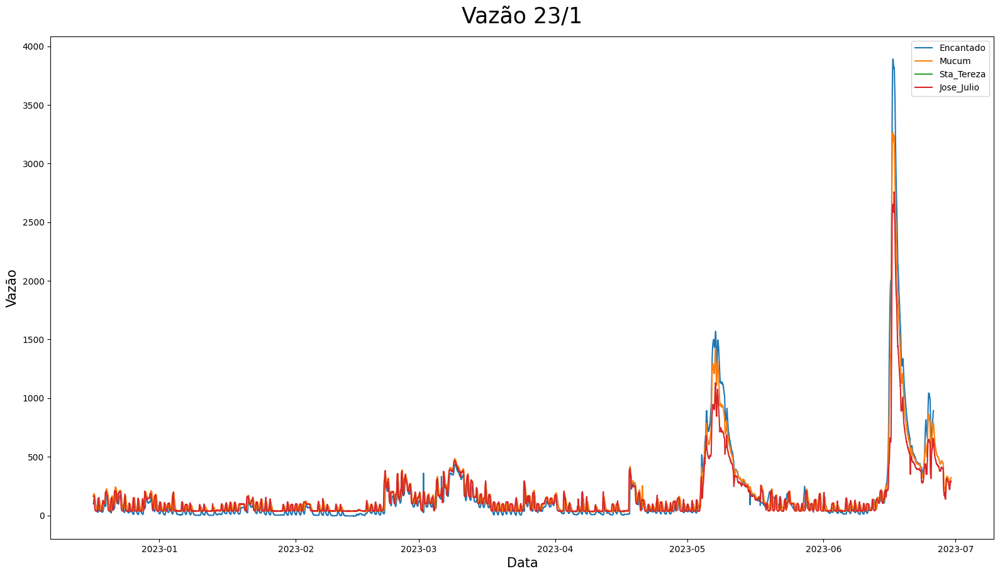

In [153]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-12-17')
data_fim = pd.to_datetime('2023-06-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 23/1', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

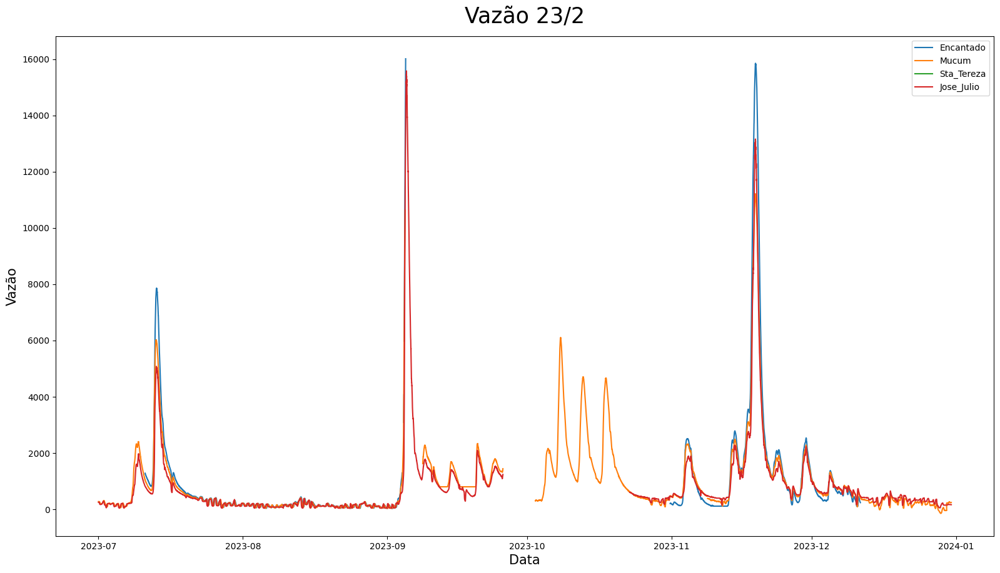

In [154]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-7-01')
data_fim = pd.to_datetime('2023-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 23/2', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

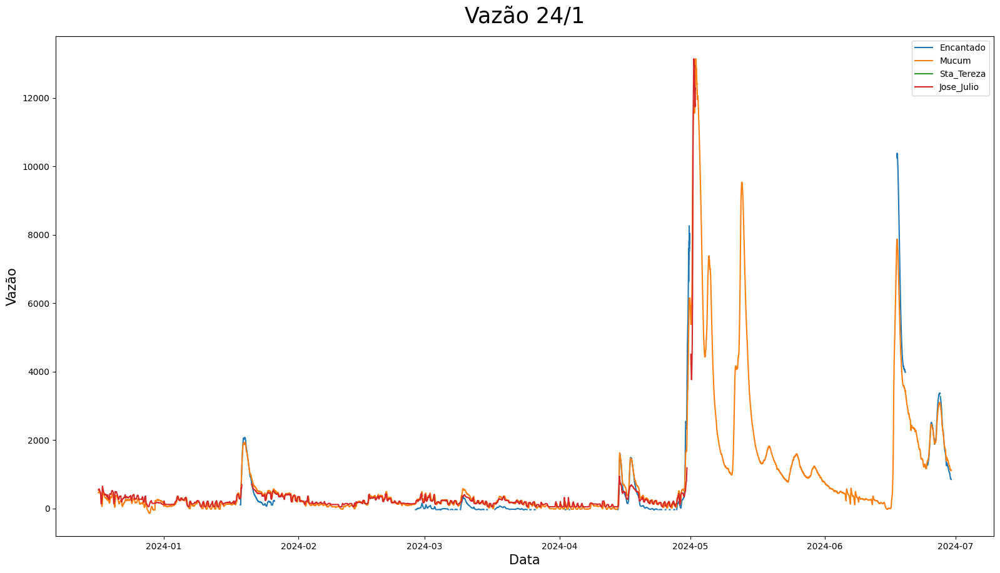

In [155]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-06-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 24/1', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

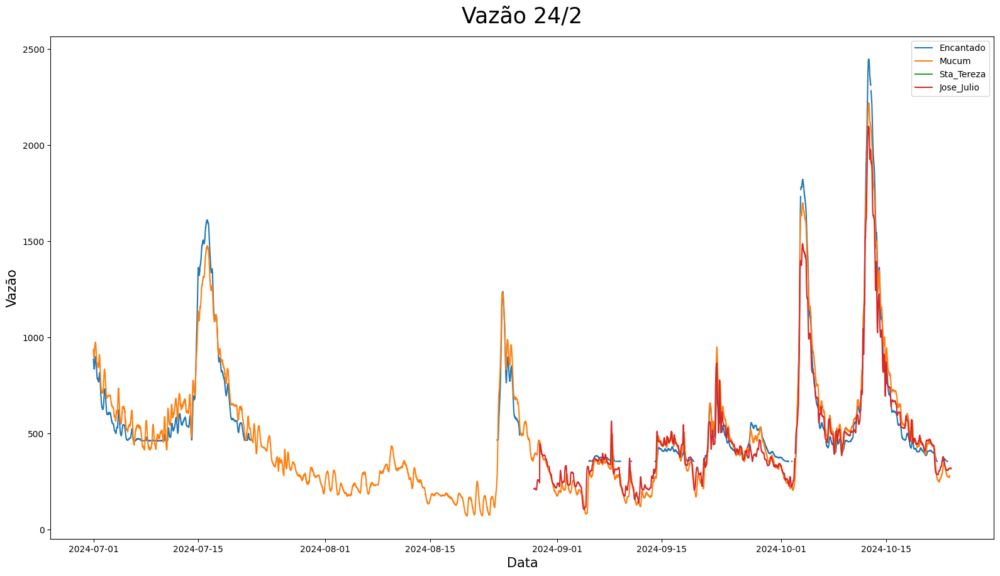

In [156]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-7-01')
data_fim = pd.to_datetime('2024-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 24/2', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Media do Vazao

- Pegando os quatro graficos famos fazer uma media dos valores do nivel da agua
- Utulizaremos esta media para preencher os valores nulos dos do nivel da agua

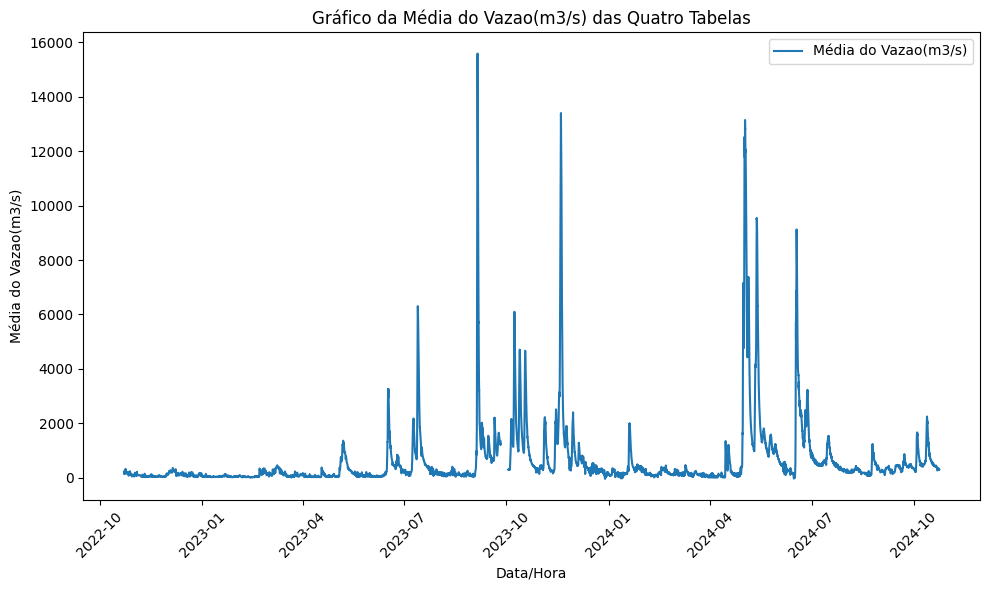

In [157]:
# Selecione apenas as colunas 'Data/Hora' e 'Vazao(m3/s)' de cada tabela
df1 = df_Encantado_unico[['Data/Hora', 'Vazao(m3/s)']]
df2 = df_Mucum_unico[['Data/Hora', 'Vazao(m3/s)']]
df3 = df_Sta_Tereza_unico[['Data/Hora', 'Vazao(m3/s)']]
df4 = df_Jose_Julio_unico[['Data/Hora', 'Vazao(m3/s)']]

# Renomeie a coluna 'Vazao(m3/s)' em cada DataFrame para identificá-los após o merge
df1 = df1.rename(columns={'Vazao(m3/s)': 'Vazao_1'})
df2 = df2.rename(columns={'Vazao(m3/s)': 'Vazao_2'})
df3 = df3.rename(columns={'Vazao(m3/s)': 'Vazao_3'})
df4 = df4.rename(columns={'Vazao(m3/s)': 'Vazao_4'})

# Combine as tabelas com base na coluna 'Data/Hora'
df_merged = pd.merge(df1, df2, on='Data/Hora', how='outer')
df_merged = pd.merge(df_merged, df3, on='Data/Hora', how='outer')
df_merged = pd.merge(df_merged, df4, on='Data/Hora', how='outer')

# Calcule a média dos valores de 'Vazao(m3/s)' ignorando valores nulos
df_merged['Vazao(m3/s)'] = df_merged[['Vazao_1', 'Vazao_2', 'Vazao_3', 'Vazao_4']].mean(axis=1)

# Plote o gráfico da média
plt.figure(figsize=(10, 6))
plt.plot(df_merged['Data/Hora'], df_merged['Vazao(m3/s)'], label='Média do Vazao(m3/s)')
plt.xlabel('Data/Hora')
plt.ylabel('Média do Vazao(m3/s)')
plt.title('Gráfico da Média do Vazao(m3/s) das Quatro Tabelas')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [158]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Vazao_1      41891 non-null  float64       
 2   Vazao_2      68877 non-null  float64       
 3   Vazao_3      0 non-null      float64       
 4   Vazao_4      55379 non-null  float64       
 5   Vazao(m3/s)  69547 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 3.2 MB


In [159]:
df_merged.head()

,Data/Hora,Vazao_1,Vazao_2,Vazao_3,Vazao_4,Vazao(m3/s)
0,2022-10-22 15:15:00,209.3,NaN,NaN,NaN,209.30
1,2022-10-22 15:30:00,209.3,195.1,NaN,NaN,202.20
2,2022-10-22 15:45:00,201.9,188.7,NaN,NaN,195.30
3,2022-10-22 16:00:00,198.2,182.5,NaN,NaN,190.35
4,2022-10-22 16:15:00,194.5,176.4,NaN,NaN,185.45


In [160]:
df_merged.tail()

,Data/Hora,Vazao_1,Vazao_2,Vazao_3,Vazao_4,Vazao(m3/s)
69989,2024-10-23 15:30:00,NaN,NaN,NaN,319.34,319.34
69990,2024-10-23 15:45:00,NaN,NaN,NaN,319.34,319.34
69991,2024-10-23 16:00:00,NaN,NaN,NaN,317.04,317.04
69992,2024-10-23 16:15:00,NaN,NaN,NaN,317.04,317.04
69993,2024-10-23 16:30:00,NaN,NaN,NaN,317.04,317.04


Grafico da 4 cidades com valores nulos

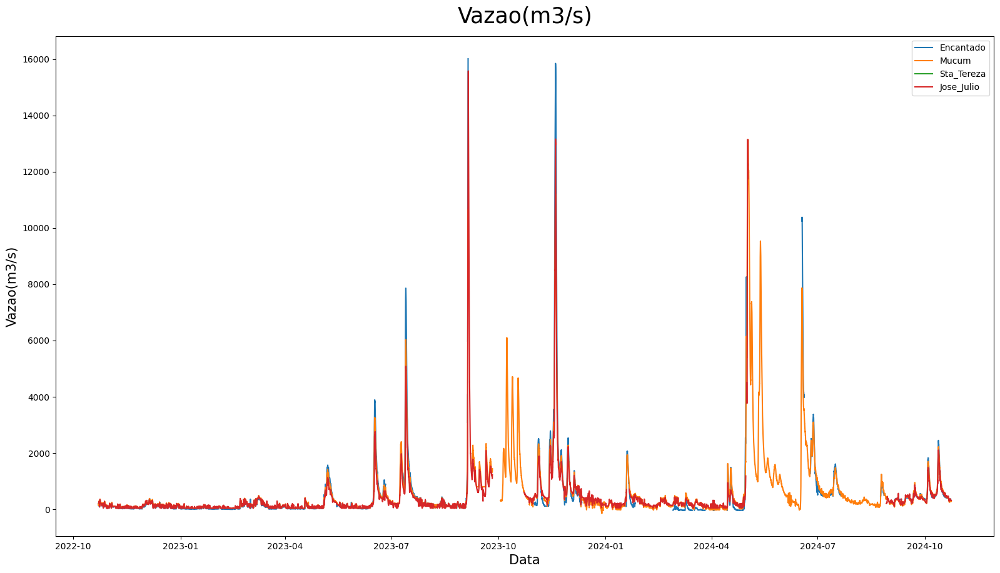

In [161]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

Remover valores que usamos para media deixando apenas o que iremos utilizar

In [162]:
# Excluir as colunas Vazao_1, Vazao_2, Vazao_3 e Vazao_4
df_merged = df_merged.drop(columns=['Vazao_1', 'Vazao_2', 'Vazao_3', 'Vazao_4'])

# Exibir informações do DataFrame após a exclusão
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Vazao(m3/s)  69547 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 1.1 MB


Interpolar os valores que faltaram pois em um pequeno intervalo de tempo as 4 estaçoes estavam inoperantes

In [163]:
# Interpolar os valores nulos na coluna 'Vazao(m3/s)'
df_merged['Vazao(m3/s)'] = df_merged['Vazao(m3/s)'].interpolate()

# Remover todas as linhas que contenham valores nulos
#df_merged = df_merged.dropna()

# Exibir informações do DataFrame após a interpolação e remoção
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 1.1 MB


Grafico da média do Nivel da agua das 4 estaçoes

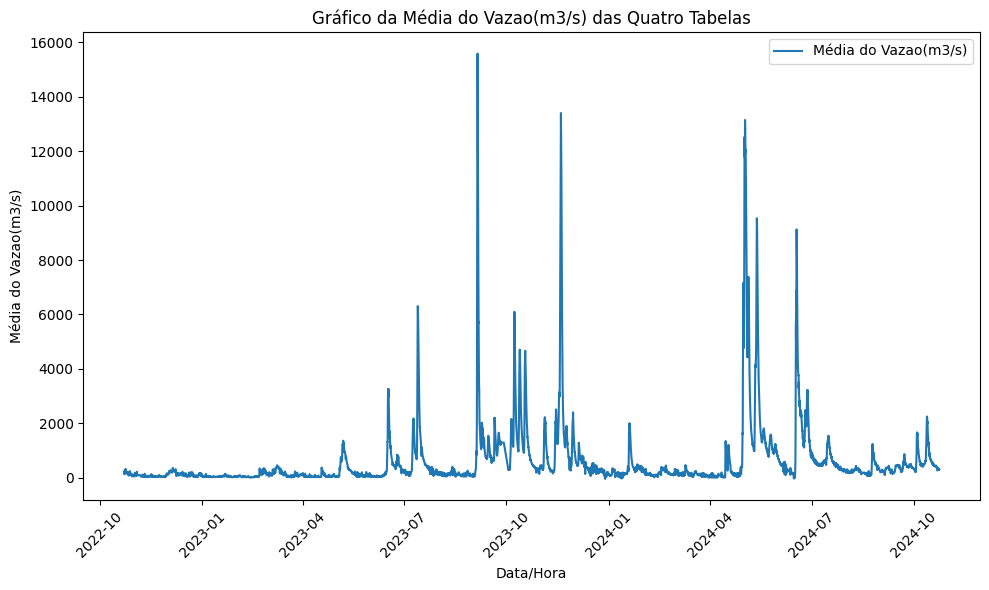

In [164]:
# Plote o gráfico da média
plt.figure(figsize=(10, 6))
plt.plot(df_merged['Data/Hora'], df_merged['Vazao(m3/s)'], label='Média do Vazao(m3/s)')
plt.xlabel('Data/Hora')
plt.ylabel('Média do Vazao(m3/s)')
plt.title('Gráfico da Média do Vazao(m3/s) das Quatro Tabelas')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [165]:
def plotar_matplot(titulo, labelx, labely, x, y, dataset):
  fig = plt.figure(figsize=(15,8))
  eixo = fig.add_axes([0,0,1,1])
  eixo.plot(x, y, data = dataset, marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)
  eixo = eixo

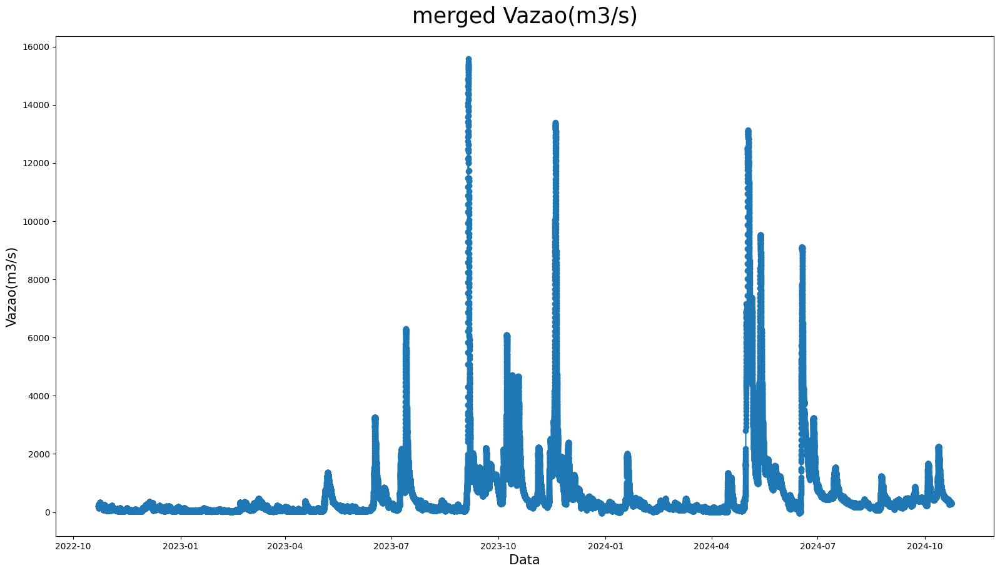

In [166]:
plotar_matplot('merged Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)', df_merged)

Grafico de uma das estaçoes para comparação posterior

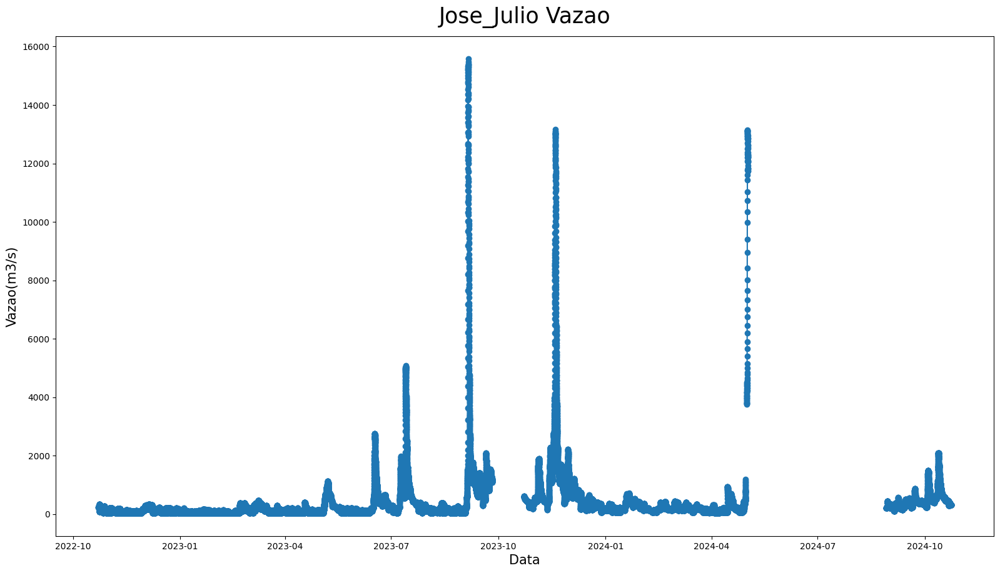

In [167]:
plotar_matplot('Jose_Julio Vazao', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)', df_Jose_Julio_unico)

Foi notado que alem de valores nulos há datas faltantes no intervalo de tempo de 2 anos
- Necessario criar linhas de datas faltantes

In [168]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Encantado_unico
df_Encantado_unico = pd.merge(df_todas_as_datas, df_Encantado_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Vazao(m3/s)' com base em df_merged
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'].fillna(
    df_merged.set_index('Data/Hora')['Vazao(m3/s)']
)


In [169]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Mucum_unico
df_Mucum_unico = pd.merge(df_todas_as_datas, df_Mucum_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Vazao(m3/s)' com base em df_merged
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'].fillna(
    df_merged.set_index('Data/Hora')['Vazao(m3/s)']
)


In [170]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Sta_Tereza_unico
df_Sta_Tereza_unico = pd.merge(df_todas_as_datas, df_Sta_Tereza_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Vazao(m3/s)' com base em df_merged
df_Sta_Tereza_unico['Vazao(m3/s)'] = df_Sta_Tereza_unico['Vazao(m3/s)'].fillna(
    df_merged.set_index('Data/Hora')['Vazao(m3/s)']
)



In [171]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Jose_Julio_unico
df_Jose_Julio_unico = pd.merge(df_todas_as_datas, df_Jose_Julio_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Vazao(m3/s)' com base em df_merged
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'].fillna(
    df_merged.set_index('Data/Hora')['Vazao(m3/s)']
)



Para os valores de Nivel faltantes (Nulos), foram preenchidos com o valor medio do nivel da agua das estaçoes restantes

In [172]:
# Para cada tabela, preencha os valores nulos em 'Vazao(m3/s)' com base na tabela df_merged
for tabela in [df_Encantado_unico,df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico]:
    # Realizar o merge com base na coluna 'Data/Hora'
    tabela_merged = pd.merge(tabela, df_merged[['Data/Hora', 'Vazao(m3/s)']], on='Data/Hora', how='left', suffixes=('', '_from_merged'))

    # Preencher os valores nulos na coluna 'Vazao(m3/s)' com os valores da coluna 'Vazao(m3/s)' da tabela df_merged
    tabela['Vazao(m3/s)'] = tabela_merged['Vazao(m3/s)'].fillna(tabela_merged['Vazao(m3/s)_from_merged'])

In [173]:
# Verificar quais linhas têm valores nulos na coluna 'Vazao(m3/s)' de df_Jose_Julio_unico
mask_nulos = df_Jose_Julio_unico['Vazao(m3/s)'].isnull()

# Para cada data onde 'Vazao(m3/s)' é nulo, buscar o valor correspondente em df_merged
for index, row in df_Jose_Julio_unico[mask_nulos].iterrows():
    data = row['Data/Hora']
    # Verificar se a data existe em df_merged
    valor_novo = df_merged.loc[df_merged['Data/Hora'] == data, 'Vazao(m3/s)']

    if not valor_novo.empty:
        # Substituir o valor nulo pela nova informação
        df_Jose_Julio_unico.at[index, 'Vazao(m3/s)'] = valor_novo.values[0]

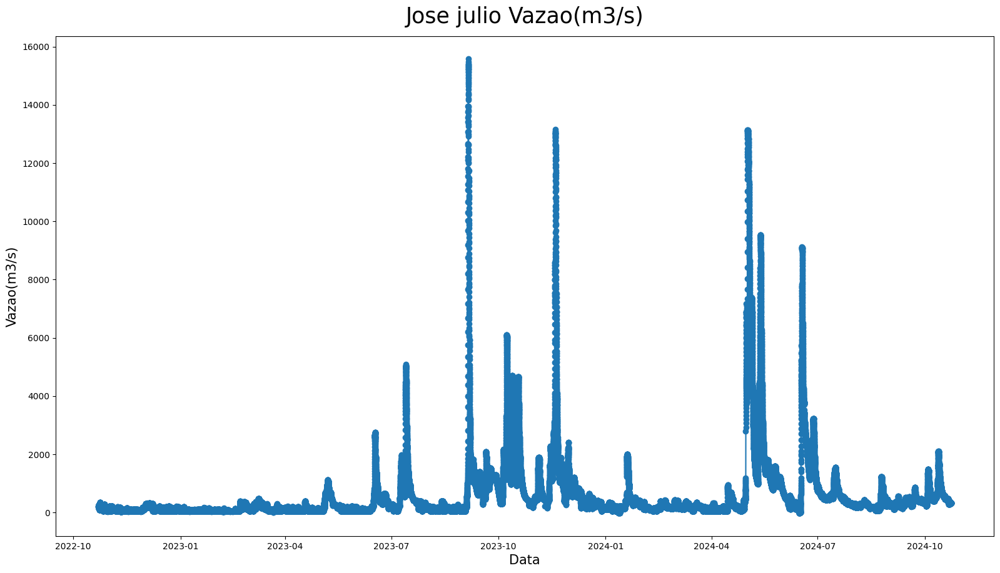

In [174]:
plotar_matplot('Jose julio Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)', df_Jose_Julio_unico)

Grafico das 4 estaçoes com o nivel da agua sem nenhum valor nulo

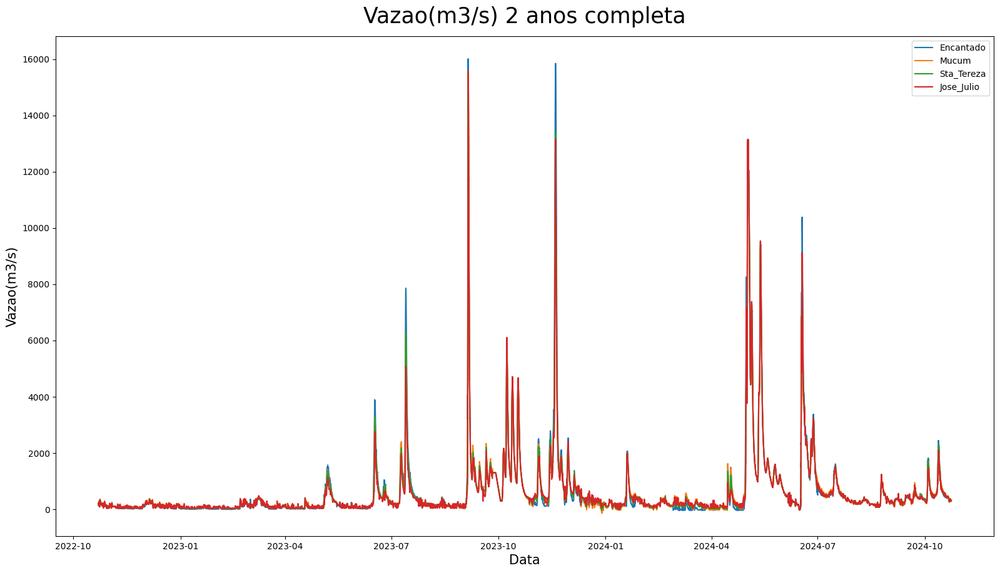

In [175]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s) 2 anos completa', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

As datas faltantes nos intervalos possuem os Niveis preenchidos pela media mas os valores da chuva e vazão são nulos pois não tinha dados neste intervalo

In [176]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    64798 non-null  float64       
 2   Nivel(cm)    44904 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [177]:
df_Mucum_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    69381 non-null  float64       
 2   Nivel(cm)    68877 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [178]:
df_Sta_Tereza_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    36987 non-null  float64       
 2   Nivel(cm)    35182 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [179]:
df_Jose_Julio_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    67273 non-null  float64       
 2   Nivel(cm)    55379 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


* deslocamento original de vazao

In [180]:
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'] + 35
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'] - 0
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'] - 5

## Media do Nivel da agua

- Pegando os quatro graficos famos fazer uma media dos valores do nivel da agua
- Utulizaremos esta media para preencher os valores nulos dos do nivel da agua

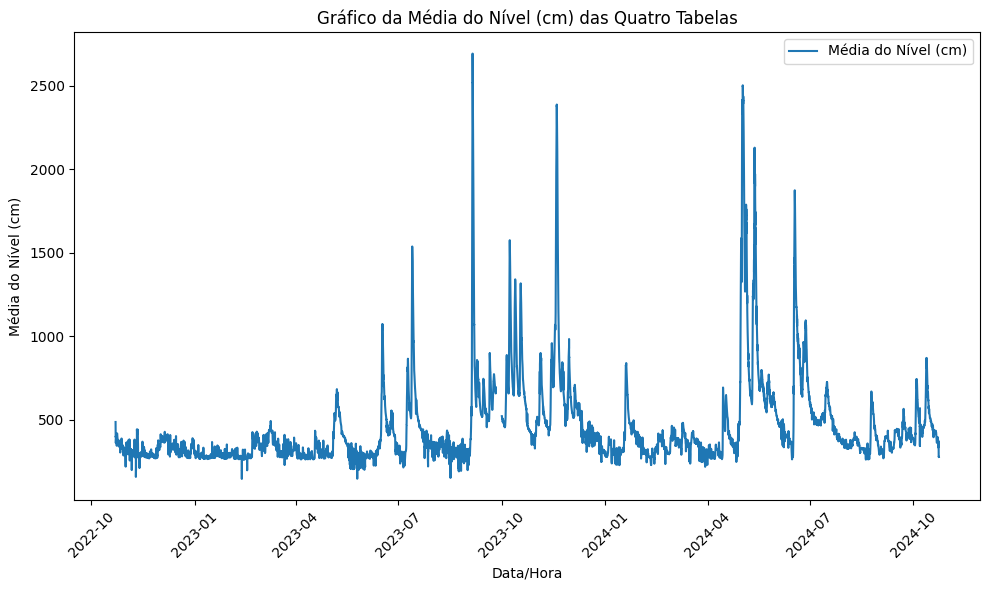

In [181]:
# Selecione apenas as colunas 'Data/Hora' e 'Nivel(cm)' de cada tabela
df1 = df_Encantado_unico[['Data/Hora', 'Nivel(cm)']]
df2 = df_Mucum_unico[['Data/Hora', 'Nivel(cm)']]
df3 = df_Sta_Tereza_unico[['Data/Hora', 'Nivel(cm)']]
df4 = df_Jose_Julio_unico[['Data/Hora', 'Nivel(cm)']]

# Renomeie a coluna 'Nivel(cm)' em cada DataFrame para identificá-los após o merge
df1 = df1.rename(columns={'Nivel(cm)': 'Nivel_1'})
df2 = df2.rename(columns={'Nivel(cm)': 'Nivel_2'})
df3 = df3.rename(columns={'Nivel(cm)': 'Nivel_3'})
df4 = df4.rename(columns={'Nivel(cm)': 'Nivel_4'})

# Combine as tabelas com base na coluna 'Data/Hora'
df_merged = pd.merge(df1, df2, on='Data/Hora', how='outer')
df_merged = pd.merge(df_merged, df3, on='Data/Hora', how='outer')
df_merged = pd.merge(df_merged, df4, on='Data/Hora', how='outer')

# Calcule a média dos valores de 'Nivel(cm)' ignorando valores nulos
df_merged['Nivel(cm)'] = df_merged[['Nivel_1', 'Nivel_2', 'Nivel_3', 'Nivel_4']].mean(axis=1)

# Plote o gráfico da média
plt.figure(figsize=(10, 6))
plt.plot(df_merged['Data/Hora'], df_merged['Nivel(cm)'], label='Média do Nível (cm)')
plt.xlabel('Data/Hora')
plt.ylabel('Média do Nível (cm)')
plt.title('Gráfico da Média do Nível (cm) das Quatro Tabelas')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [182]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Data/Hora  69994 non-null  datetime64[ns]
 1   Nivel_1    44904 non-null  float64       
 2   Nivel_2    68877 non-null  float64       
 3   Nivel_3    35182 non-null  float64       
 4   Nivel_4    55379 non-null  float64       
 5   Nivel(cm)  69723 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 3.2 MB


In [183]:
df_merged.head()

,Data/Hora,Nivel_1,Nivel_2,Nivel_3,Nivel_4,Nivel(cm)
0,2022-10-22 15:15:00,486.0,NaN,NaN,NaN,486.0
1,2022-10-22 15:30:00,486.0,357.0,NaN,NaN,421.5
2,2022-10-22 15:45:00,484.0,354.0,NaN,NaN,419.0
3,2022-10-22 16:00:00,483.0,351.0,NaN,NaN,417.0
4,2022-10-22 16:15:00,482.0,348.0,NaN,NaN,415.0


In [184]:
df_merged.tail()

,Data/Hora,Nivel_1,Nivel_2,Nivel_3,Nivel_4,Nivel(cm)
69989,2024-10-23 15:30:00,NaN,NaN,NaN,278.0,278.0
69990,2024-10-23 15:45:00,NaN,NaN,NaN,278.0,278.0
69991,2024-10-23 16:00:00,NaN,NaN,NaN,277.0,277.0
69992,2024-10-23 16:15:00,NaN,NaN,NaN,277.0,277.0
69993,2024-10-23 16:30:00,NaN,NaN,NaN,277.0,277.0


Grafico da 4 cidades com valores nulos

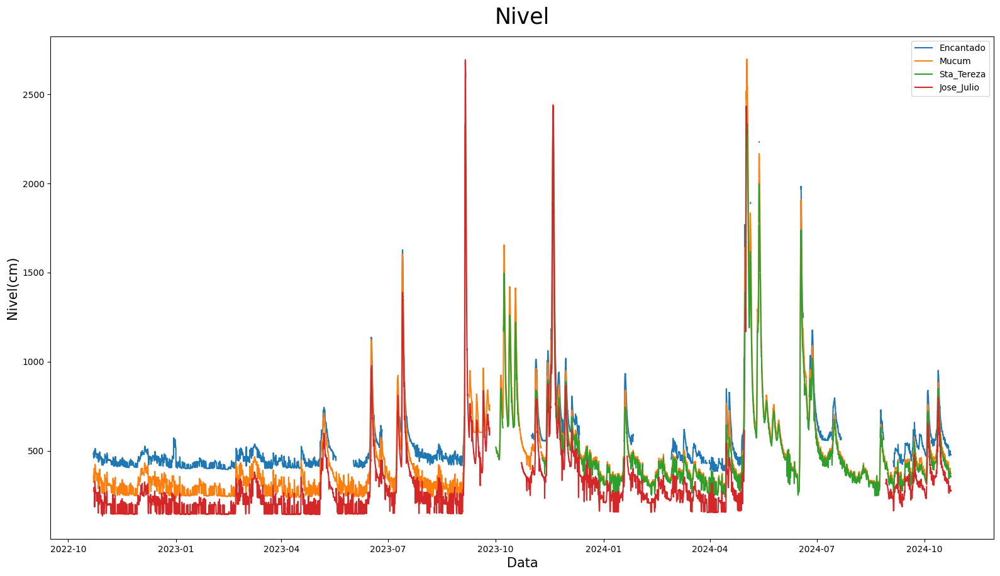

In [185]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [186]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Data/Hora  69994 non-null  datetime64[ns]
 1   Nivel_1    44904 non-null  float64       
 2   Nivel_2    68877 non-null  float64       
 3   Nivel_3    35182 non-null  float64       
 4   Nivel_4    55379 non-null  float64       
 5   Nivel(cm)  69723 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 3.2 MB


Remover valores que usamos para media deixando apenas o que iremos utilizar

In [187]:
# Excluir as colunas Nivel_1, Nivel_2, Nivel_3 e Nivel_4
df_merged = df_merged.drop(columns=['Nivel_1', 'Nivel_2', 'Nivel_3', 'Nivel_4'])

# Exibir informações do DataFrame após a exclusão
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Data/Hora  69994 non-null  datetime64[ns]
 1   Nivel(cm)  69723 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 1.1 MB


Interpolar os valores que faltaram pois em um pequeno intervalo de tempo as 4 estaçoes estavam inoperantes

In [188]:
# Interpolar os valores nulos na coluna 'Nivel(cm)'
df_merged['Nivel(cm)'] = df_merged['Nivel(cm)'].interpolate()

# Remover todas as linhas que contenham valores nulos
df_merged = df_merged.dropna()

# Exibir informações do DataFrame após a interpolação e remoção
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Data/Hora  69994 non-null  datetime64[ns]
 1   Nivel(cm)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 1.1 MB


Grafico da média do Nivel da agua das 4 estaçoes

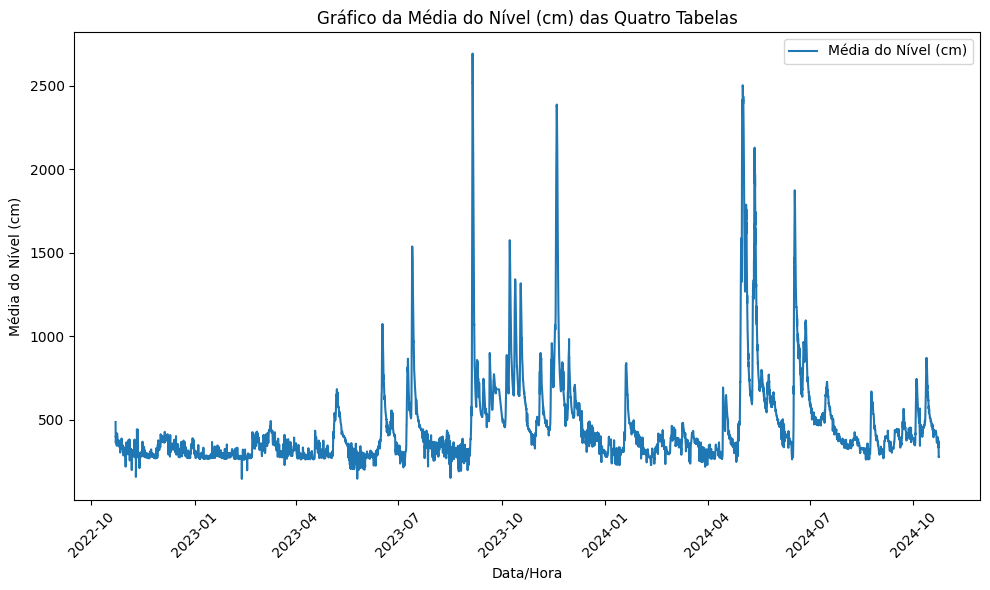

In [189]:
# Plote o gráfico da média
plt.figure(figsize=(10, 6))
plt.plot(df_merged['Data/Hora'], df_merged['Nivel(cm)'], label='Média do Nível (cm)')
plt.xlabel('Data/Hora')
plt.ylabel('Média do Nível (cm)')
plt.title('Gráfico da Média do Nível (cm) das Quatro Tabelas')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [190]:
def plotar_matplot(titulo, labelx, labely, x, y, dataset):
  fig = plt.figure(figsize=(15,8))
  eixo = fig.add_axes([0,0,1,1])
  eixo.plot(x, y, data = dataset, marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)
  eixo = eixo

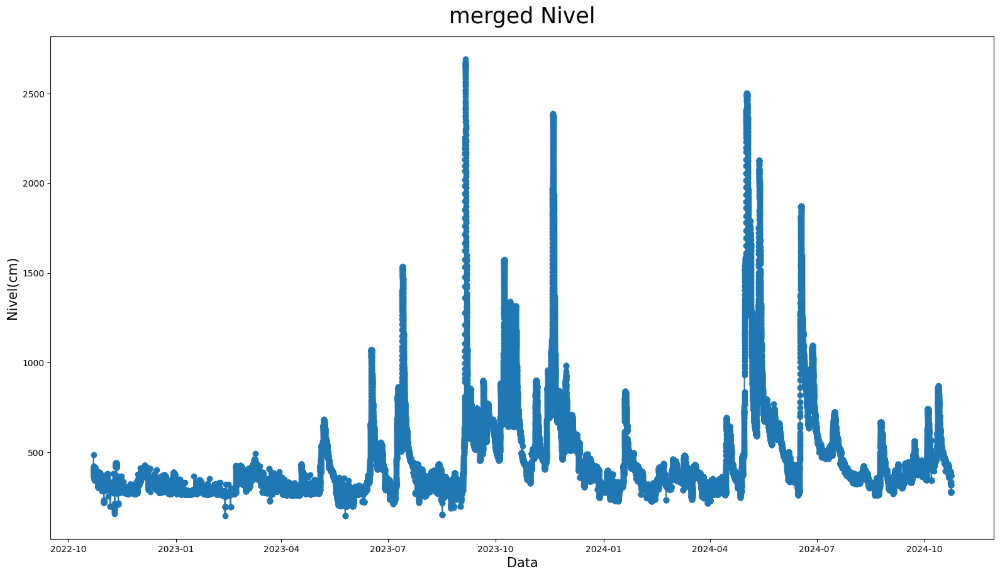

In [191]:
plotar_matplot('merged Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_merged)

Grafico de uma das estaçoes para comparação posterior

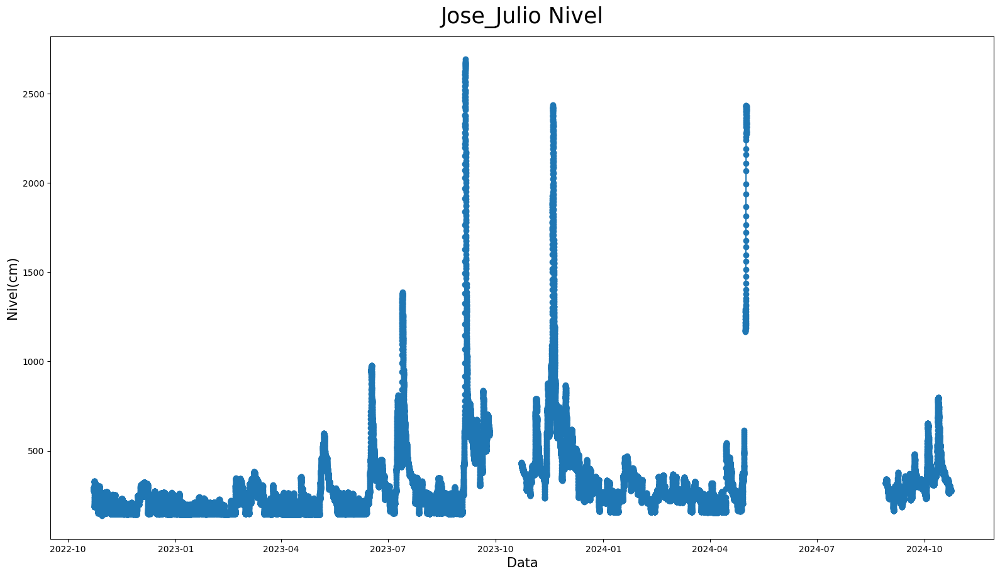

In [192]:
plotar_matplot('Jose_Julio Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio_unico)

Foi notado que alem de valores nulos há datas faltantes no intervalo de tempo de 2 anos
- Necessario criar linhas de datas faltantes

In [193]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Encantado_unico
df_Encantado_unico = pd.merge(df_todas_as_datas, df_Encantado_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Nivel(cm)' com base em df_merged
df_Encantado_unico['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'].fillna(
    df_merged.set_index('Data/Hora')['Nivel(cm)']
)


In [194]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Mucum_unico
df_Mucum_unico = pd.merge(df_todas_as_datas, df_Mucum_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Nivel(cm)' com base em df_merged
df_Mucum_unico['Nivel(cm)'] = df_Mucum_unico['Nivel(cm)'].fillna(
    df_merged.set_index('Data/Hora')['Nivel(cm)']
)


In [195]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Sta_Tereza_unico
df_Sta_Tereza_unico = pd.merge(df_todas_as_datas, df_Sta_Tereza_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Nivel(cm)' com base em df_merged
df_Sta_Tereza_unico['Nivel(cm)'] = df_Sta_Tereza_unico['Nivel(cm)'].fillna(
    df_merged.set_index('Data/Hora')['Nivel(cm)']
)



In [196]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Jose_Julio_unico
df_Jose_Julio_unico = pd.merge(df_todas_as_datas, df_Jose_Julio_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Nivel(cm)' com base em df_merged
df_Jose_Julio_unico['Nivel(cm)'] = df_Jose_Julio_unico['Nivel(cm)'].fillna(
    df_merged.set_index('Data/Hora')['Nivel(cm)']
)



Para os valores de Nivel faltantes (Nulos), foram preenchidos com o valor medio do nivel da agua das estaçoes restantes

In [197]:
# Para cada tabela, preencha os valores nulos em 'Nivel(cm)' com base na tabela df_merged
for tabela in [df_Encantado_unico,df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico]:
    # Realizar o merge com base na coluna 'Data/Hora'
    tabela_merged = pd.merge(tabela, df_merged[['Data/Hora', 'Nivel(cm)']], on='Data/Hora', how='left', suffixes=('', '_from_merged'))

    # Preencher os valores nulos na coluna 'Nivel(cm)' com os valores da coluna 'Nivel(cm)' da tabela df_merged
    tabela['Nivel(cm)'] = tabela_merged['Nivel(cm)'].fillna(tabela_merged['Nivel(cm)_from_merged'])

In [198]:
# Verificar quais linhas têm valores nulos na coluna 'Nivel(cm)' de df_Jose_Julio_unico
mask_nulos = df_Jose_Julio_unico['Nivel(cm)'].isnull()

# Para cada data onde 'Nivel(cm)' é nulo, buscar o valor correspondente em df_merged
for index, row in df_Jose_Julio_unico[mask_nulos].iterrows():
    data = row['Data/Hora']
    # Verificar se a data existe em df_merged
    valor_novo = df_merged.loc[df_merged['Data/Hora'] == data, 'Nivel(cm)']

    if not valor_novo.empty:
        # Substituir o valor nulo pela nova informação
        df_Jose_Julio_unico.at[index, 'Nivel(cm)'] = valor_novo.values[0]

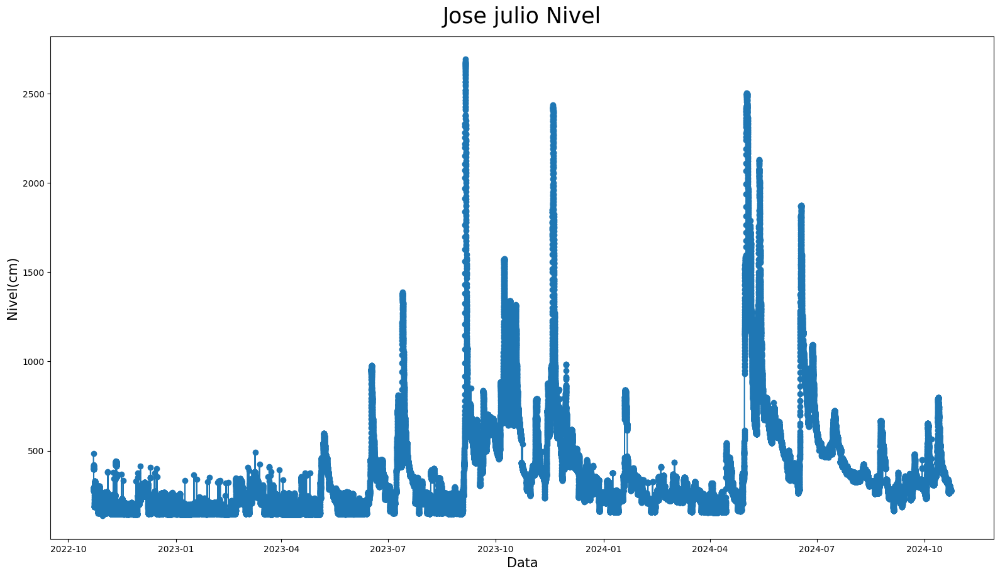

In [199]:
plotar_matplot('Jose julio Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio_unico)

Grafico das 4 estaçoes com o nivel da agua sem nenhum valor nulo

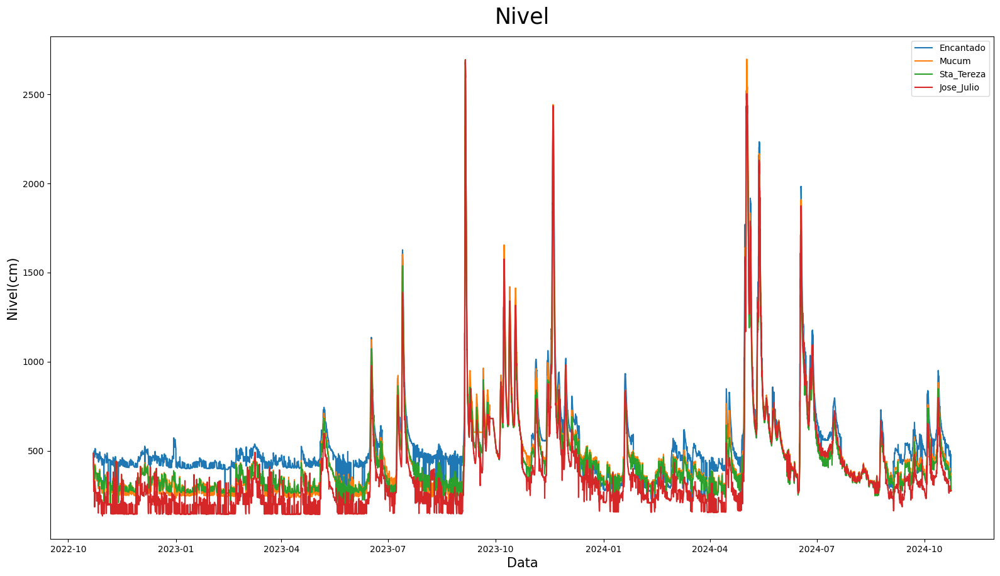

In [200]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

As datas faltantes nos intervalos possuem os Niveis preenchidos pela media mas os valores da chuva e vazão são nulos pois não tinha dados neste intervalo

In [201]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    64798 non-null  float64       
 2   Nivel(cm)    69994 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [202]:
df_Mucum_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    69381 non-null  float64       
 2   Nivel(cm)    69994 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [203]:
df_Sta_Tereza_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    36987 non-null  float64       
 2   Nivel(cm)    69994 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [204]:
df_Jose_Julio_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    67273 non-null  float64       
 2   Nivel(cm)    69994 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


foi necessario fazer mesma interpolação feita anteriormente para os valores da chuva e vazão para as novas linhas criadas

In [205]:
df_Encantado_unico['Chuva(mm)'] = df_Encantado_unico['Chuva(mm)'].fillna(0)
df_Mucum_unico['Chuva(mm)'] = df_Mucum_unico['Chuva(mm)'].fillna(0)
df_Sta_Tereza_unico['Chuva(mm)'] = df_Sta_Tereza_unico['Chuva(mm)'].fillna(0)
df_Jose_Julio_unico['Chuva(mm)'] = df_Jose_Julio_unico['Chuva(mm)'].fillna(0)
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Sta_Tereza_unico['Vazao(m3/s)'] = df_Sta_Tereza_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'].interpolate(method='linear')

## SHIFT BACK

- para os dados Voltarem em suas posiçoes originais é necessario fazer o deslocamento feito anteriormente com os valores opostos pondo os valores no seu ponto original

In [206]:
# Definir os deslocamentos específicos para cada tabela
#shift1, shift2, shift3, shift4 = -12, -12, 7, 20
shift1, shift2, shift3, shift4 = -1, -1, 7, 15
# Alinhar as tabelas
df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico = deslocar_data_series(
    df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
    coluna_data='Data/Hora',
    shift1=shift1, shift2=shift2, shift3=shift3, shift4=shift4
)

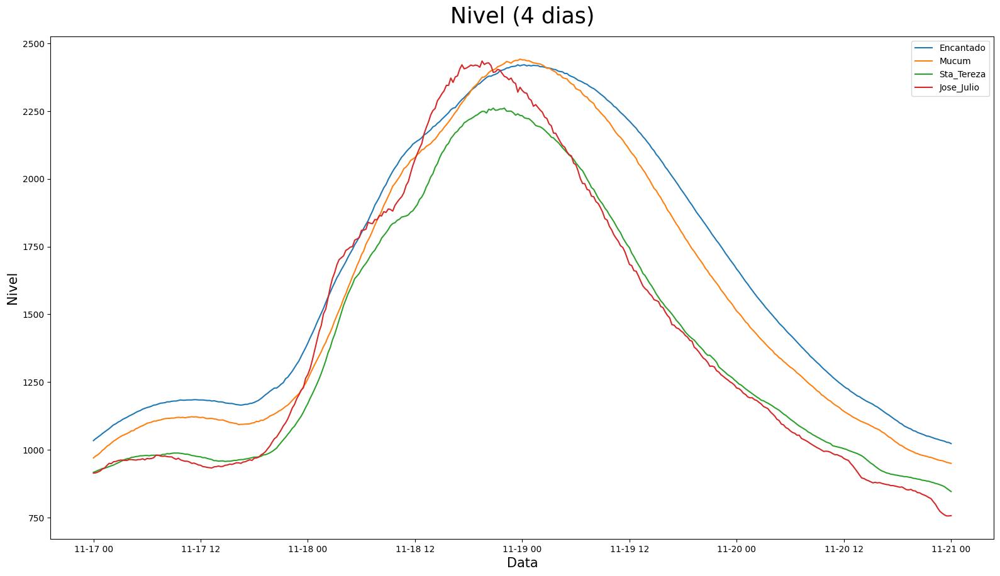

In [207]:
39# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (4 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

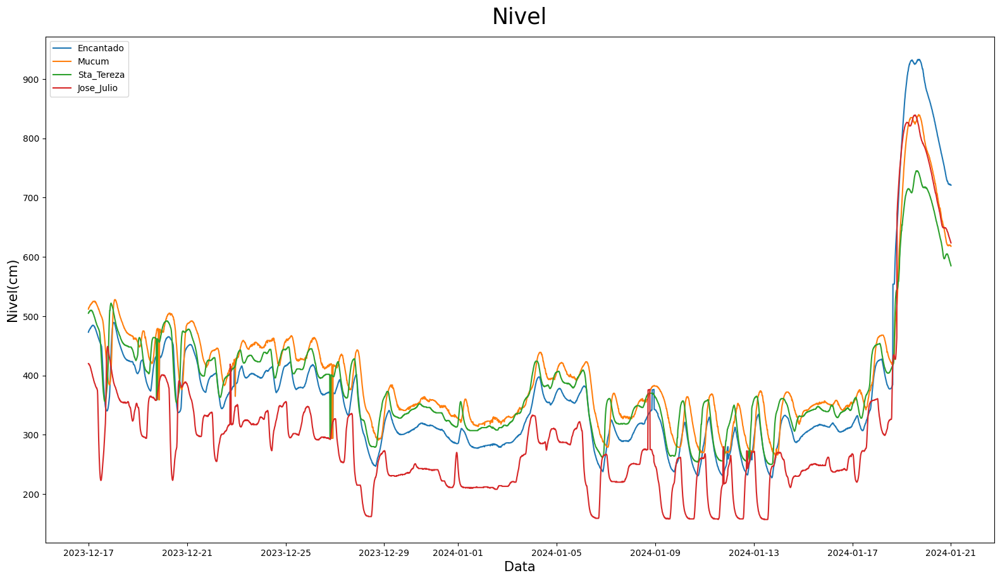

In [208]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-01-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [209]:
df_Encantado_unico['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'] - 180
df_Mucum_unico['Nivel(cm)'] = df_Mucum_unico['Nivel(cm)'] - 70
df_Sta_Tereza_unico['Nivel(cm)'] = df_Sta_Tereza_unico['Nivel(cm)'] - 50
df_Jose_Julio_unico['Nivel(cm)'] = df_Jose_Julio_unico['Nivel(cm)'] + 40

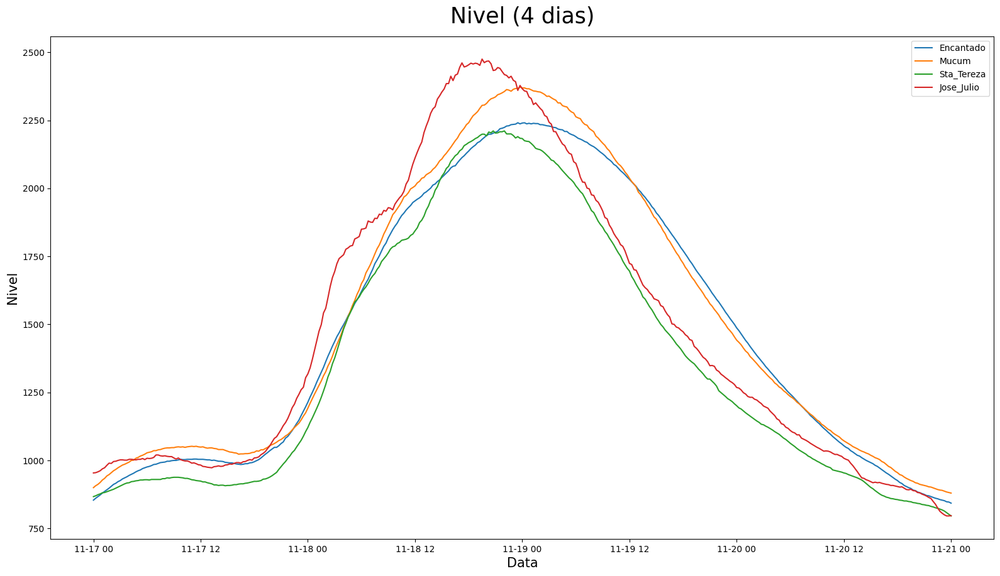

In [210]:
39# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (4 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

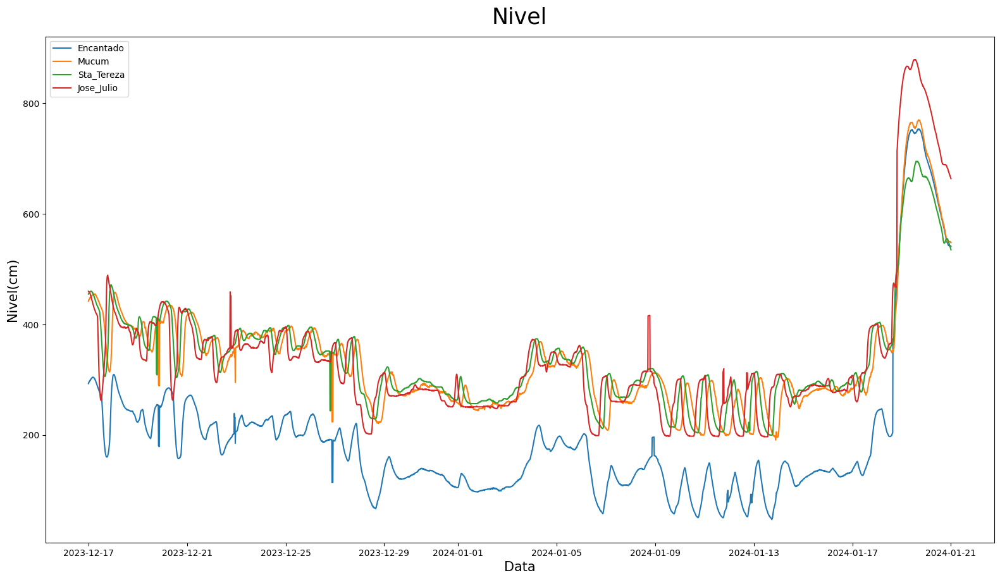

In [211]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-01-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

# Boxplot

In [212]:
def plotar_boxplot(titulo, labelx, labely, x, y, dataset, tipo='linha'):
    # Verificar se o dataset não está vazio
    if dataset.empty:
        print("O dataset está vazio.")
        return

    # Verificar se as colunas especificadas existem no dataset
    if x not in dataset.columns or y not in dataset.columns:
        print(f"As colunas '{x}' e '{y}' devem existir no dataset.")
        return

    fig = plt.figure(figsize=(15, 8))
    eixo = fig.add_axes([0, 0, 1, 1])

    if tipo == 'linha':
        eixo.plot(dataset[x], dataset[y], marker='o', linestyle='-')  # Gráfico de linha com pontos
    elif tipo == 'boxplot':
        # Remover nulos apenas da coluna y
        dataset_cleaned = dataset.dropna(subset=[y])
        eixo.boxplot(dataset_cleaned[y], vert=True)
        eixo.set_xticklabels([labelx])  # Rótulo do eixo x

    # Configurar título e rótulos dos eixos
    eixo.set_title(titulo, fontsize=25, pad=15)
    eixo.set_xlabel(labelx, fontsize=15)
    eixo.set_ylabel(labely, fontsize=15)

    plt.show()


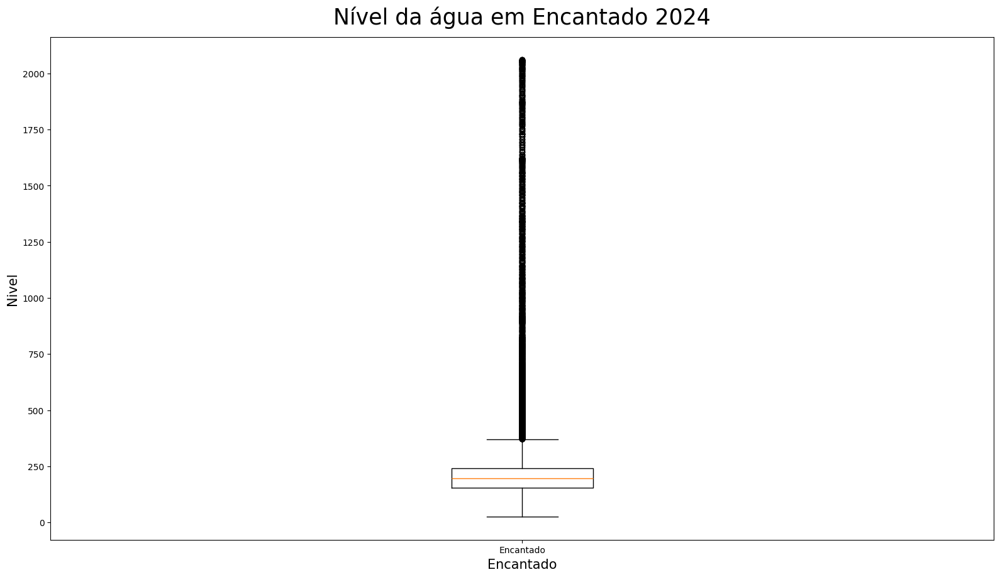

In [213]:
plotar_boxplot('Nível da água em Encantado 2024', 'Encantado', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Encantado24, tipo='boxplot')

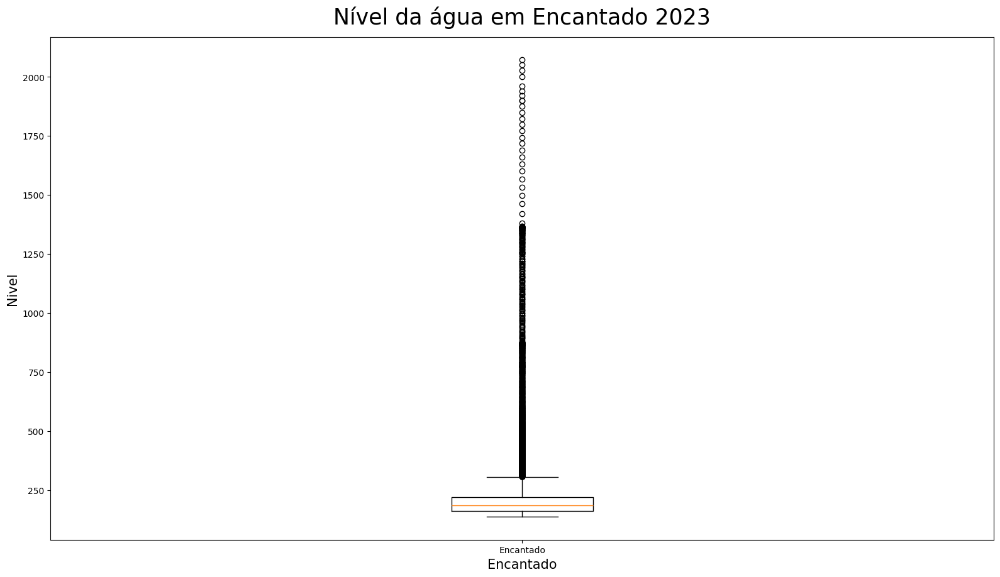

In [214]:
plotar_boxplot('Nível da água em Encantado 2023', 'Encantado', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Encantado23, tipo='boxplot')

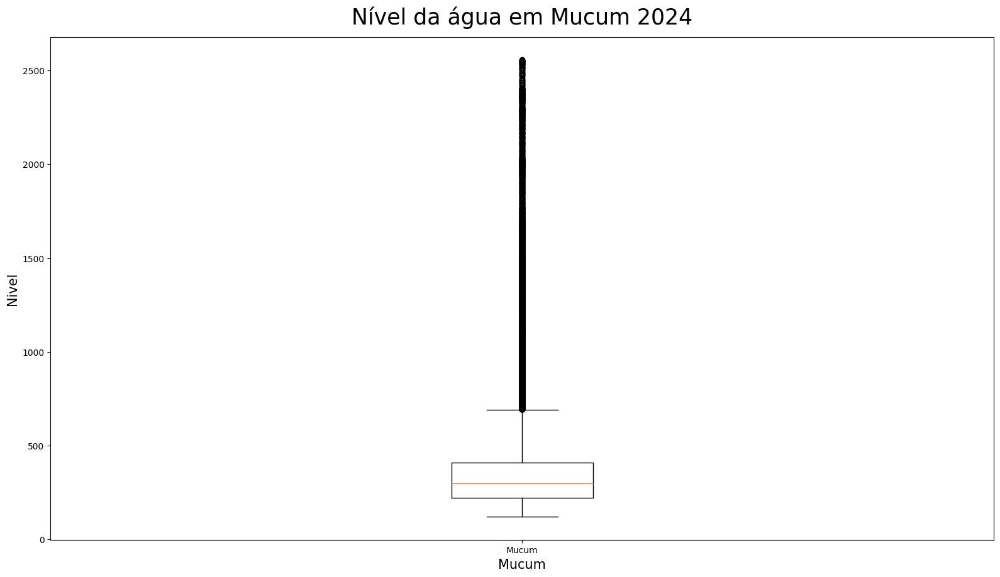

In [215]:
plotar_boxplot('Nível da água em Mucum 2024', 'Mucum', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Mucum24, tipo='boxplot')

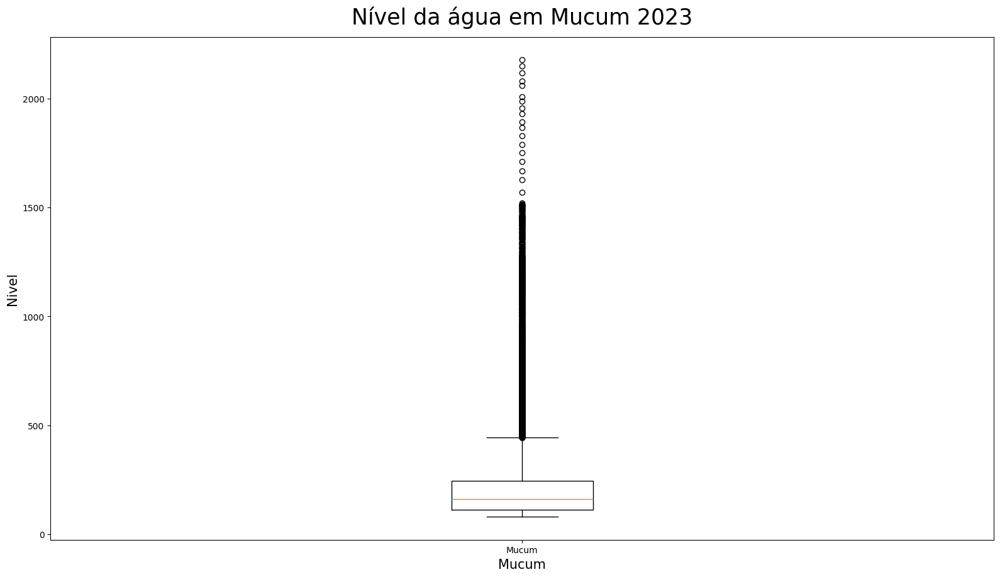

In [216]:
plotar_boxplot('Nível da água em Mucum 2023', 'Mucum', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Mucum23, tipo='boxplot')

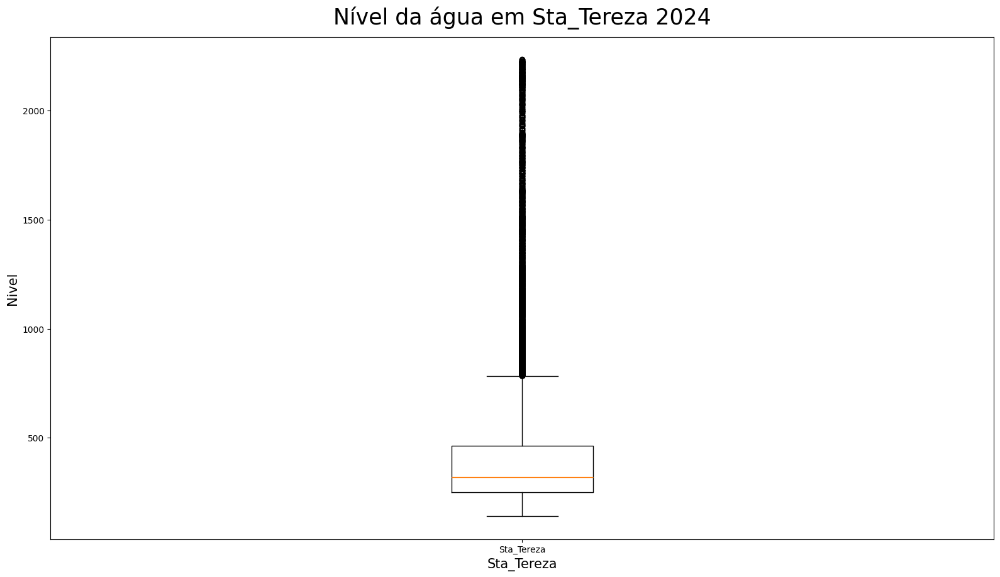

In [217]:
plotar_boxplot('Nível da água em Sta_Tereza 2024', 'Sta_Tereza', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Sta_Tereza24, tipo='boxplot')

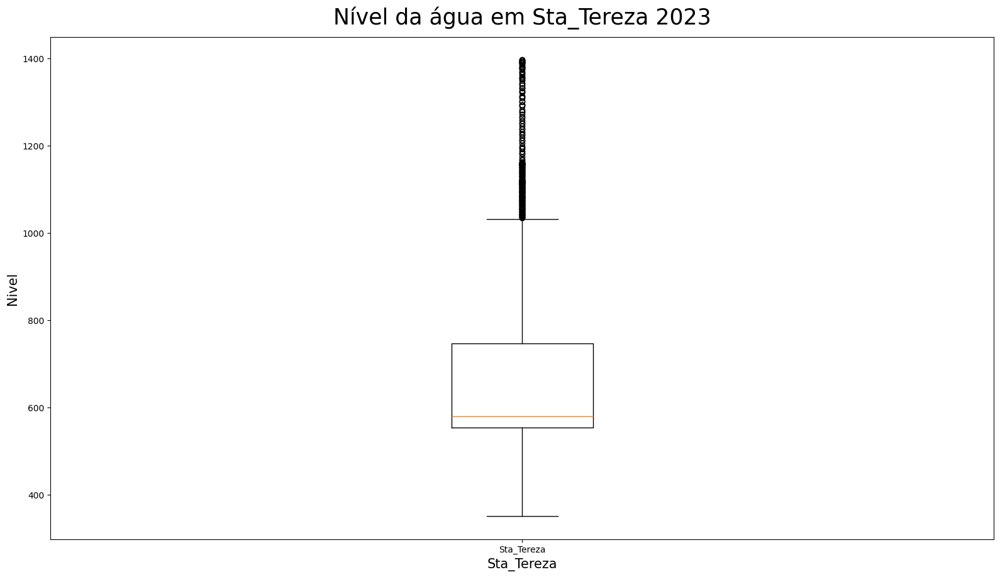

In [218]:
plotar_boxplot('Nível da água em Sta_Tereza 2023', 'Sta_Tereza', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Sta_Tereza23, tipo='boxplot')

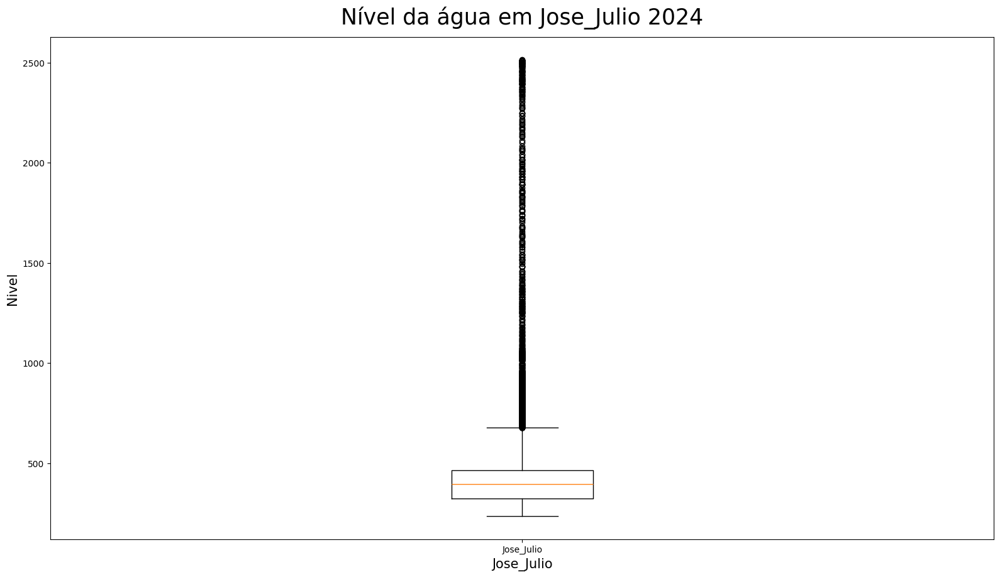

In [219]:
plotar_boxplot('Nível da água em Jose_Julio 2024', 'Jose_Julio', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio24, tipo='boxplot')

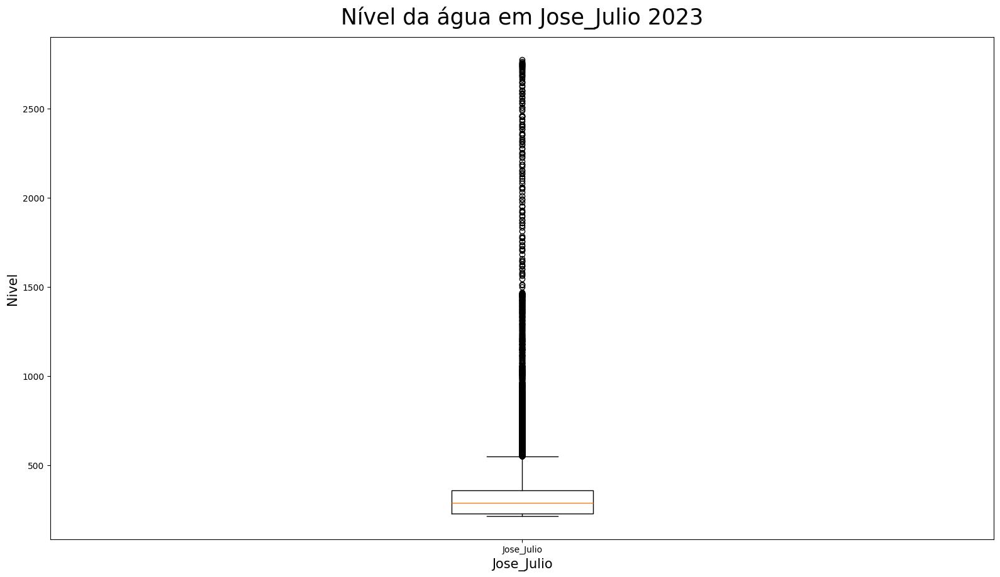

In [220]:
plotar_boxplot('Nível da água em Jose_Julio 2023', 'Jose_Julio', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio23, tipo='boxplot')

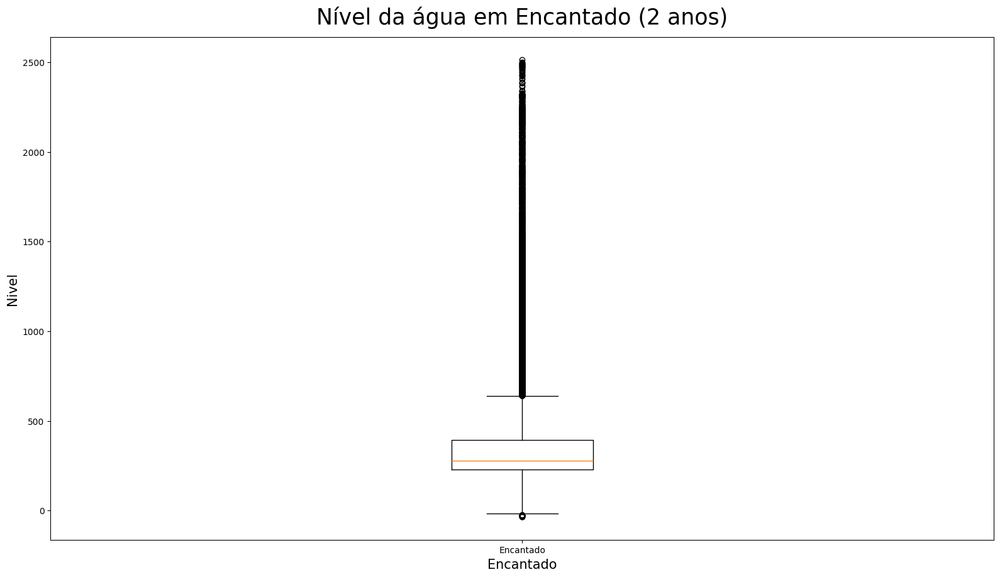

In [221]:
plotar_boxplot('Nível da água em Encantado (2 anos)', 'Encantado', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Encantado_unico, tipo='boxplot')

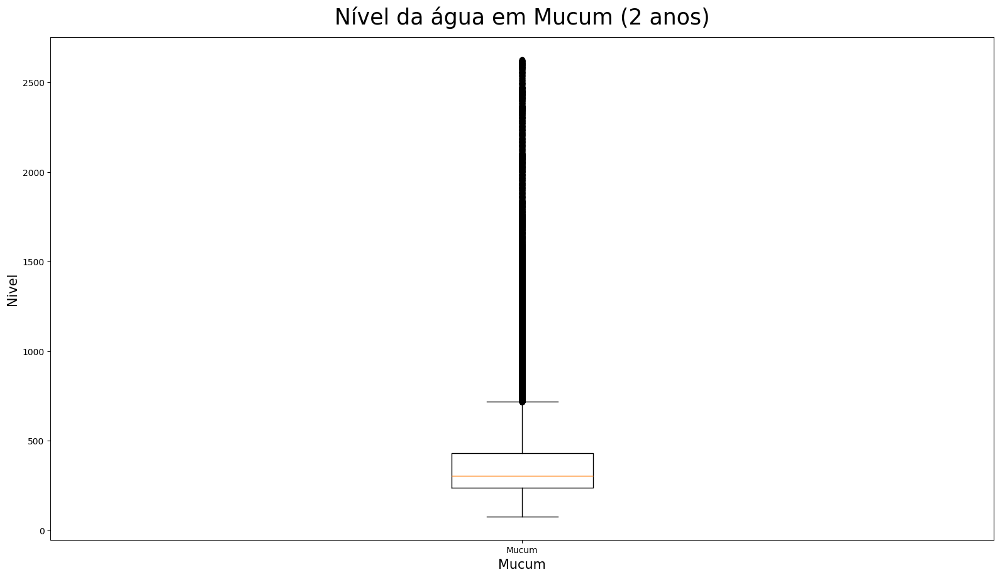

In [222]:
plotar_boxplot('Nível da água em Mucum (2 anos)', 'Mucum', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Mucum_unico, tipo='boxplot')

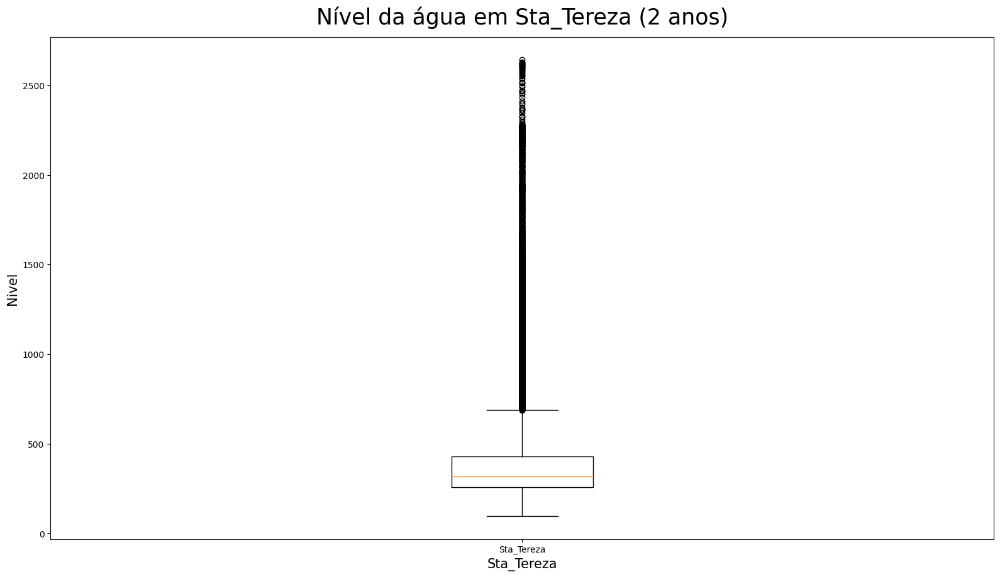

In [223]:
plotar_boxplot('Nível da água em Sta_Tereza (2 anos)', 'Sta_Tereza', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Sta_Tereza_unico, tipo='boxplot')

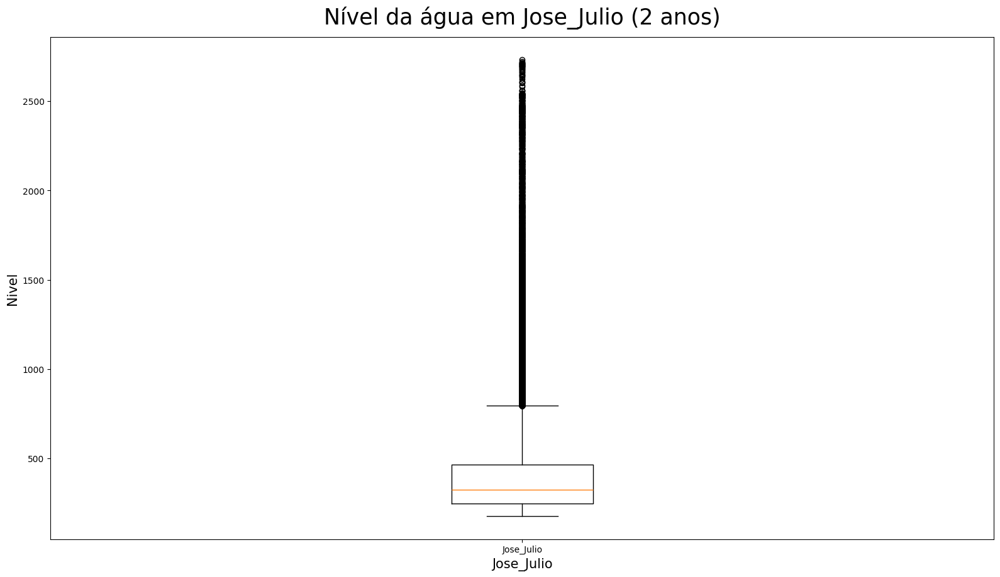

In [224]:
plotar_boxplot('Nível da água em Jose_Julio (2 anos)', 'Jose_Julio', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio_unico, tipo='boxplot')

# Plot com seleção de intervalo (1 cidade)

In [225]:
def plotar_1_intervalo(titulo, labelx, labely, x, y, dataset1, label1, intervalo_data=None):

  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]

  # Plotar os dados com os labels fornecidos
  eixo.plot(x, y, data=dataset1, label=label1, linestyle='-')

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo

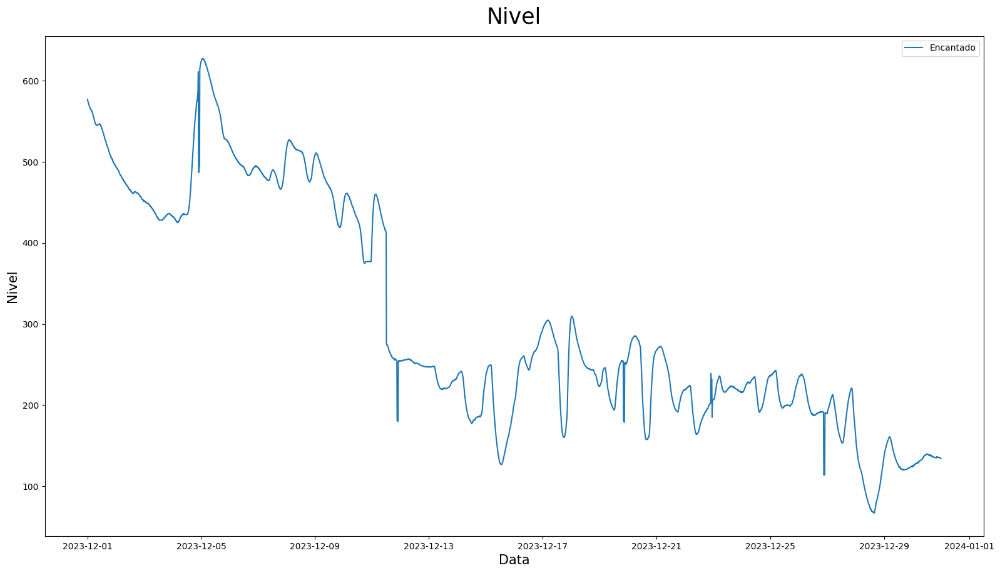

In [226]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-01')
data_fim = pd.to_datetime('2023-12-31')

# Chamando a função com intervalo de data
plotar_1_intervalo('Nivel', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico,
                'Encantado',
                intervalo_data=(data_inicio, data_fim))

# 4 Graficos em um plot com seleção de intervalo

### grafico nivel da agua 3 meses descartado

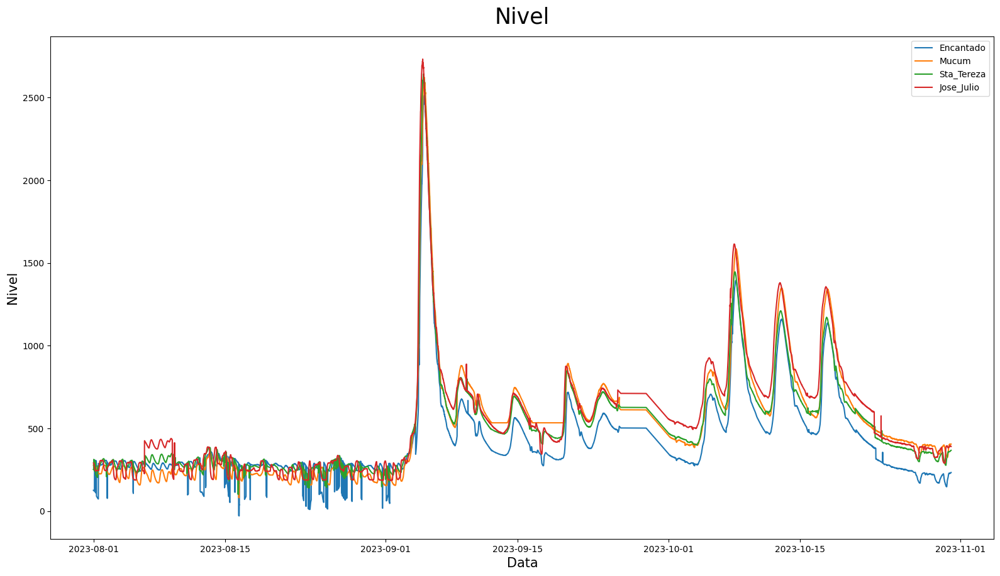

In [227]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-8-01')
data_fim = pd.to_datetime('2023-10-31')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

### grafico nivel da agua relevantes

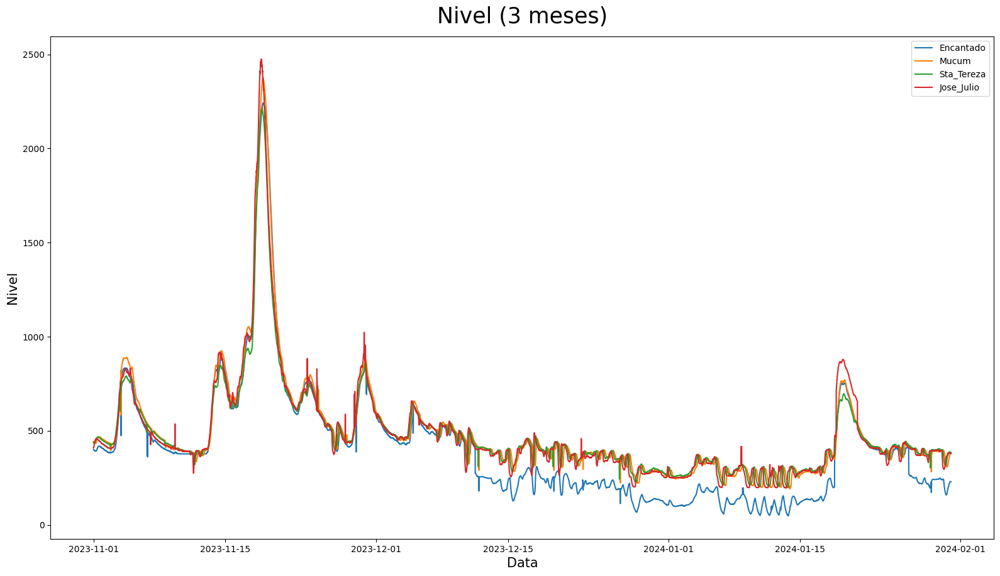

In [228]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (3 meses)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

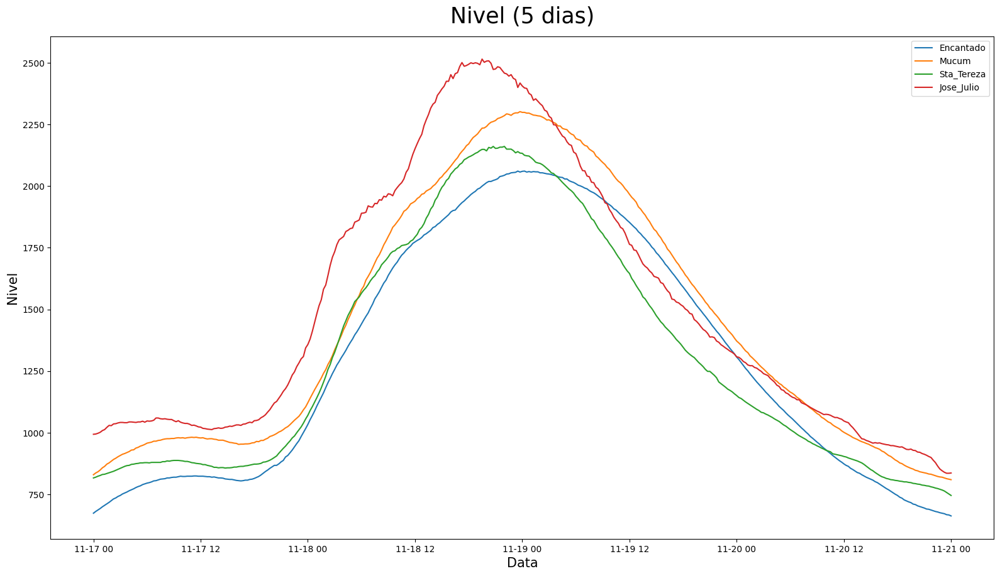

In [229]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (5 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado24, df_Mucum24, df_Sta_Tereza24, df_Jose_Julio24,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

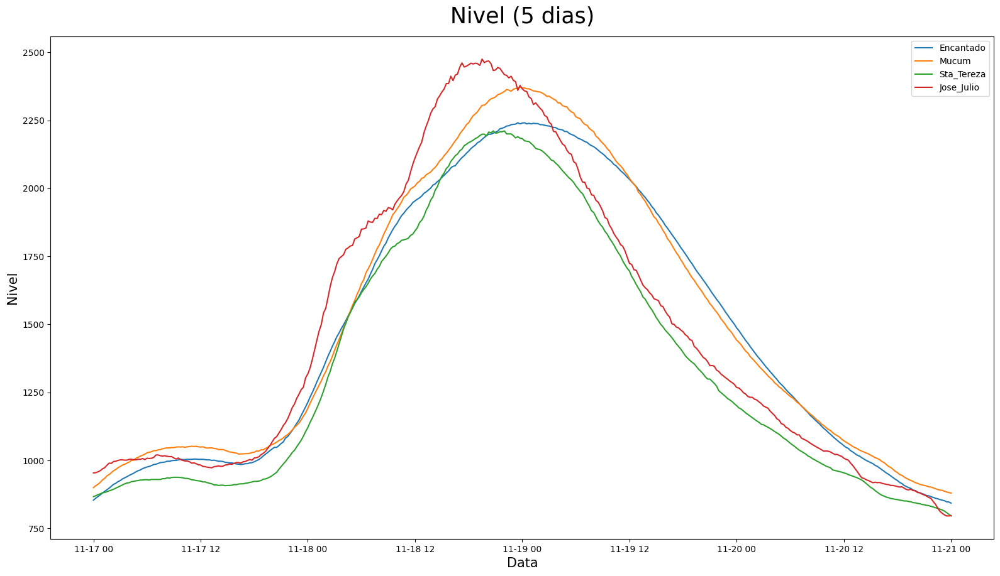

In [230]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (5 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

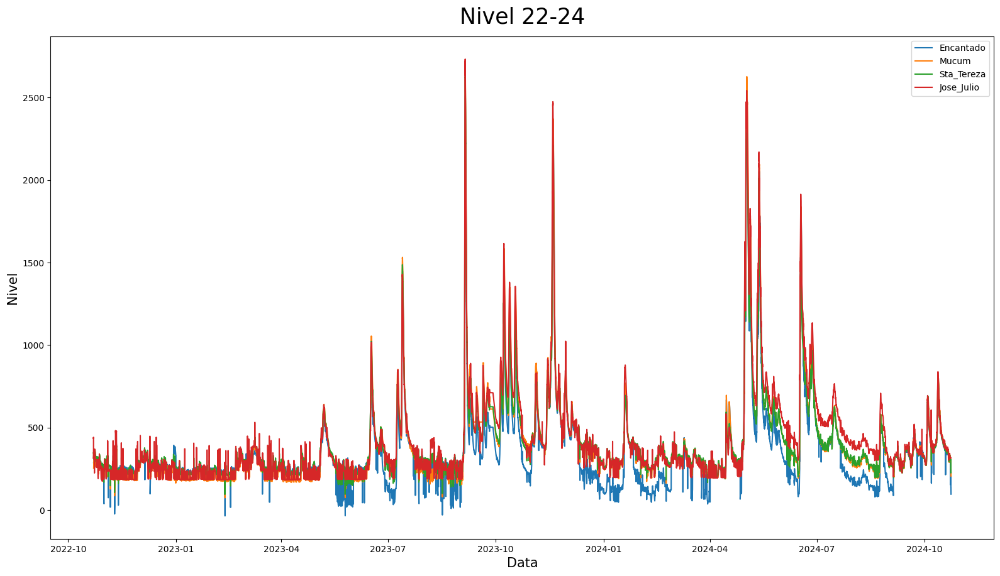

In [231]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-7-01')
data_fim = pd.to_datetime('2024-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 22-24', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

### Grafico Chuva 4 cidades

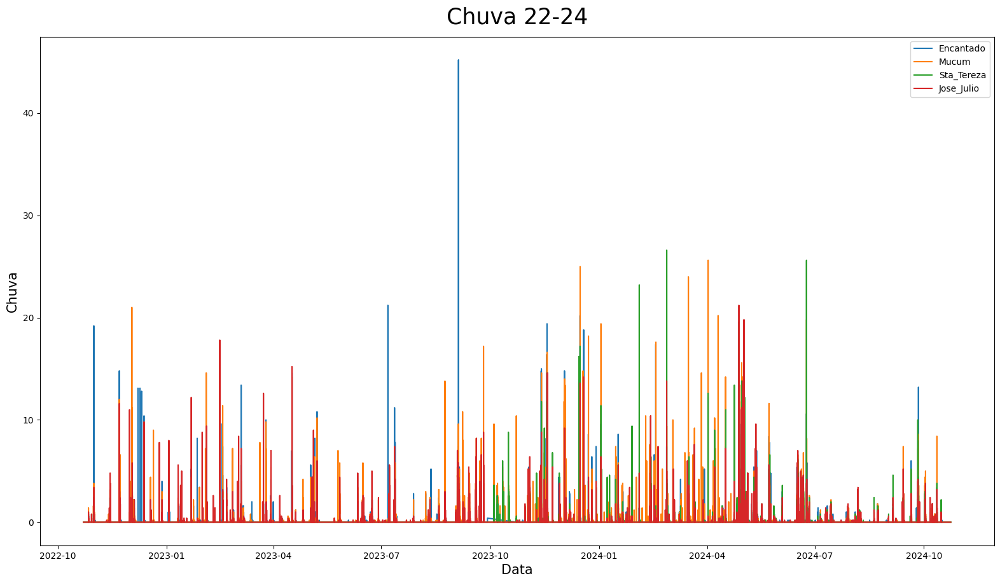

In [232]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-7-01')
data_fim = pd.to_datetime('2024-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Chuva 22-24', 'Data', 'Chuva', 'Data/Hora', 'Chuva(mm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

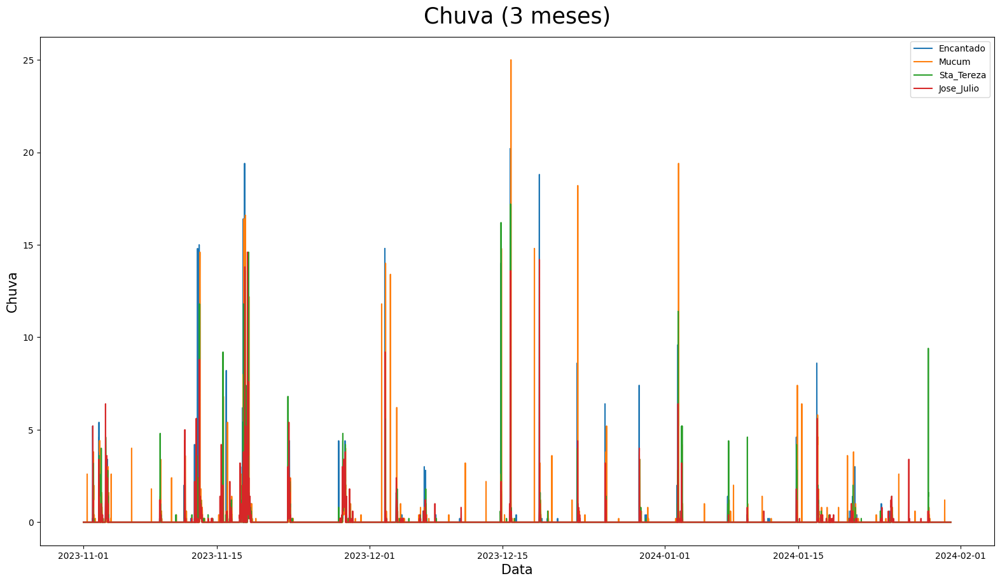

In [233]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

# Chamando a função com intervalo de data
plotar_matplot4('Chuva (3 meses)', 'Data', 'Chuva', 'Data/Hora', 'Chuva(mm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

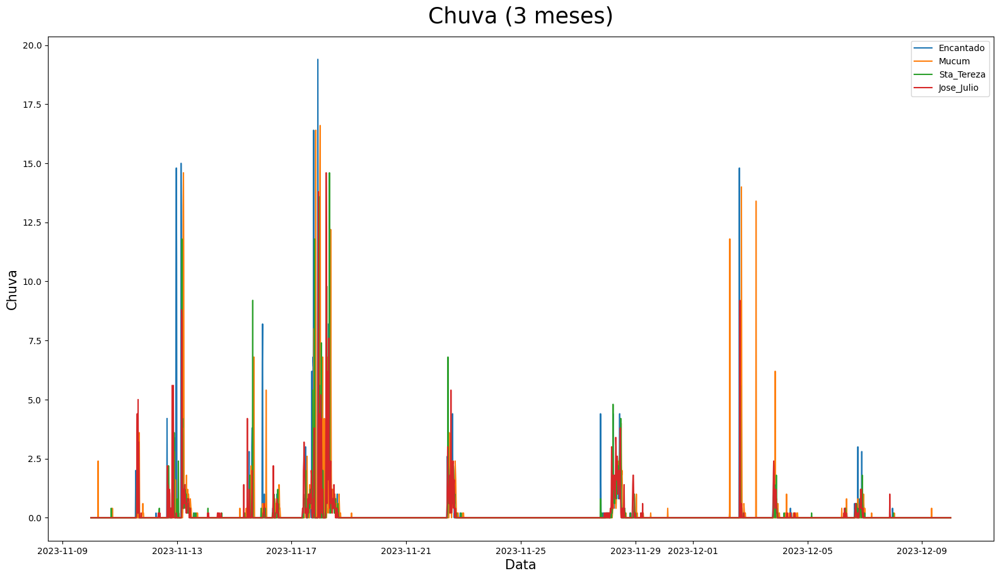

In [234]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Chuva (3 meses)', 'Data', 'Chuva', 'Data/Hora', 'Chuva(mm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

# Boxplot 4 em 1

In [235]:
def plotar_boxplot4(titulo, labelx, labely, x, y, dataset1, dataset2, dataset3, dataset4, label1, label2, label3, label4, intervalo_data=None):
  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]
      dataset2 = dataset2[(dataset2[x] >= data_inicio) & (dataset2[x] <= data_fim)]
      dataset3 = dataset3[(dataset3[x] >= data_inicio) & (dataset3[x] <= data_fim)]
      dataset4 = dataset4[(dataset4[x] >= data_inicio) & (dataset4[x] <= data_fim)]

  # Criar uma lista com os dados para o boxplot, ignorando dados nulos
  dados_boxplot = [
      dataset1[y].dropna().values,
      dataset2[y].dropna().values,
      dataset3[y].dropna().values,
      dataset4[y].dropna().values
  ]

  # Plotar o boxplot
  eixo.boxplot(dados_boxplot, labels=[label1, label2, label3, label4])

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo


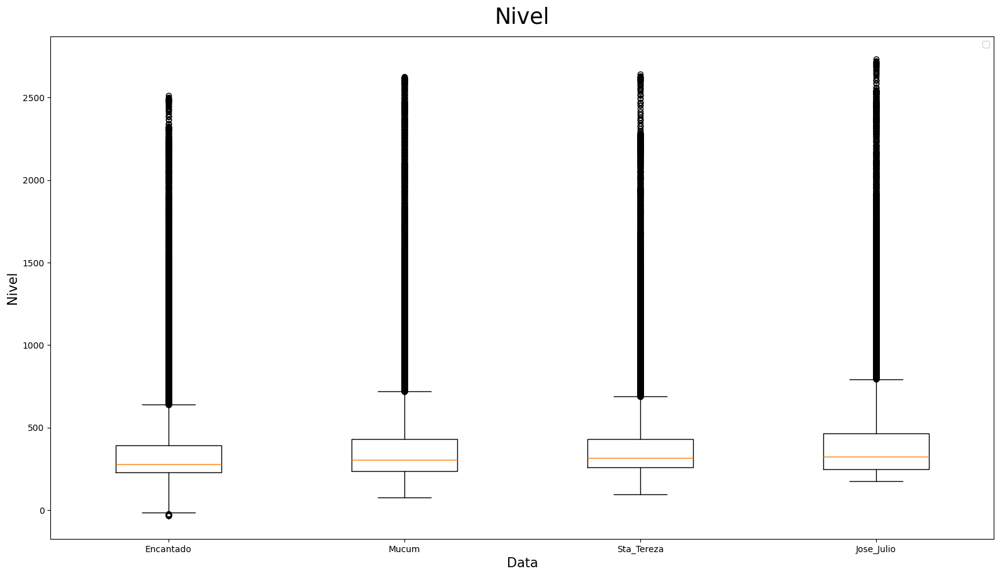

In [236]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-8-01')
data_fim = pd.to_datetime('2024-10-31')

# Chamando a função com intervalo de data
plotar_boxplot4('Nivel', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio', intervalo_data=(data_inicio, data_fim))

# Nivel e chuva

### Nivel em linha / chuva em barra sobreposta

In [237]:
import matplotlib.pyplot as plt

def plotar_chuva_nivel(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dataset[coluna_data], dataset[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)  # Removi o parâmetro `pad`
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()



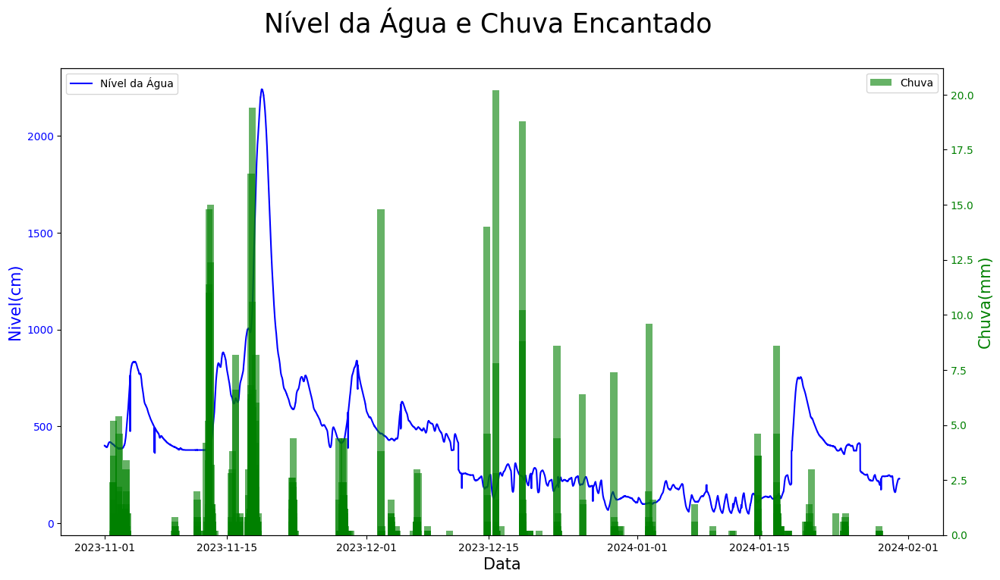

In [238]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim))

### Nivel em linha / chuva em barra sobreposta (Granulando ambos)
possivel selecionar agrupamento por dia, semana, mes ou hora

In [239]:
import matplotlib.pyplot as plt
import pandas as pd

def plotar_chuva_nivel_agrupa_ambos(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None, frequencia='D'):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Converter a coluna de data para datetime, caso ainda não esteja
    dataset[coluna_data] = pd.to_datetime(dataset[coluna_data])

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar por frequência especificada (D - dia, W - semana, M - mês, H - hora)
    dados_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum', coluna_nivel: 'mean'}).reset_index()

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dados_agrupados[coluna_data], dados_agrupados[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_agrupados[coluna_data], dados_agrupados[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')



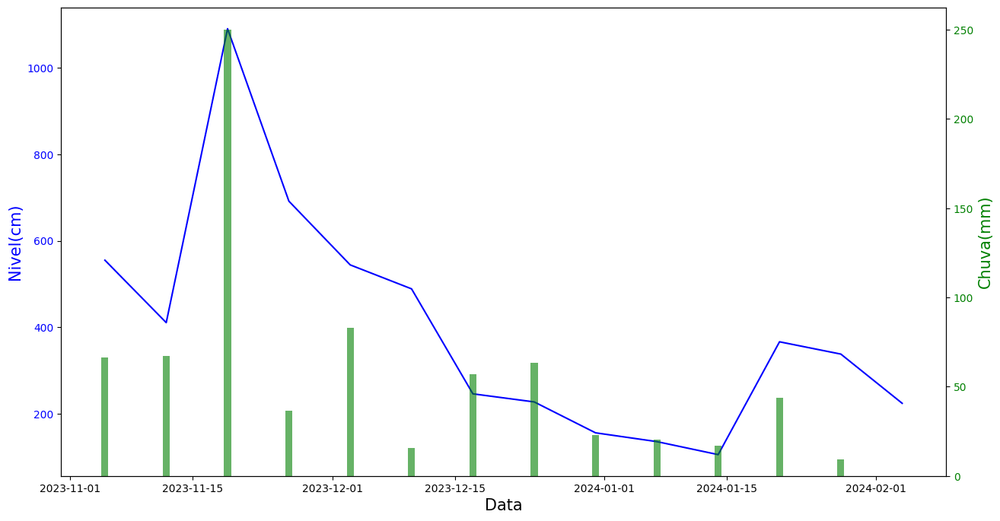

In [240]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_ambos(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='W' )

### Nivel em linha / chuva em barra sobreposta (Granulando chuva)
possivel selecionar agrupamento por dia, semana, mes ou hora

In [241]:
import matplotlib.pyplot as plt
import pandas as pd

def plotar_chuva_nivel_agrupa_chuva(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None, frequencia='D'):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Converter a coluna de data para datetime, caso ainda não esteja
    dataset[coluna_data] = pd.to_datetime(dataset[coluna_data])

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar os dados de chuva pela frequência especificada (D - dia, W - semana, M - mês, H - hora)
    dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_chuva_agrupados[coluna_data], dados_chuva_agrupados[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()


#### cidades intervalo 23-11-01 ate 24-1-31 (3 meses)

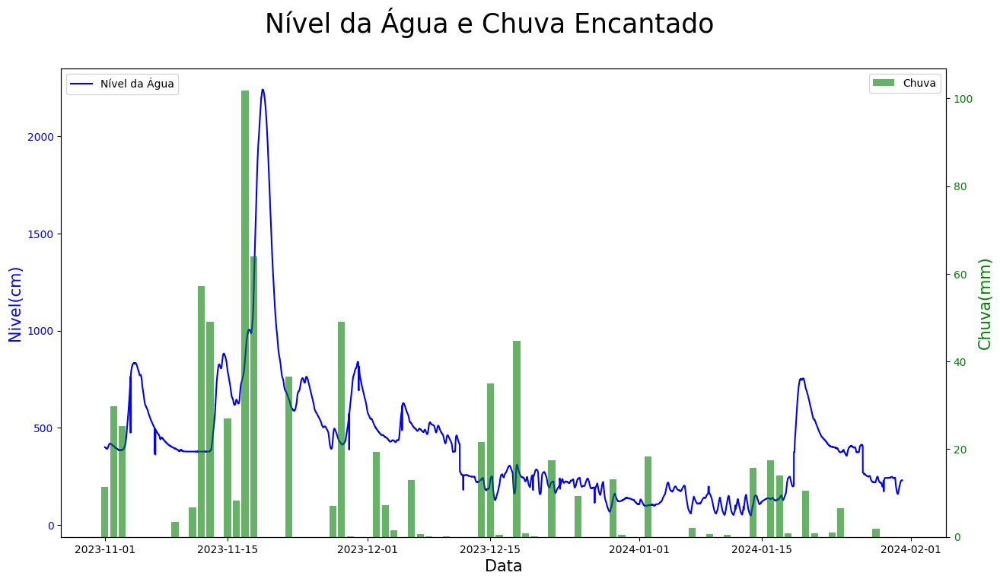

In [242]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_chuva(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

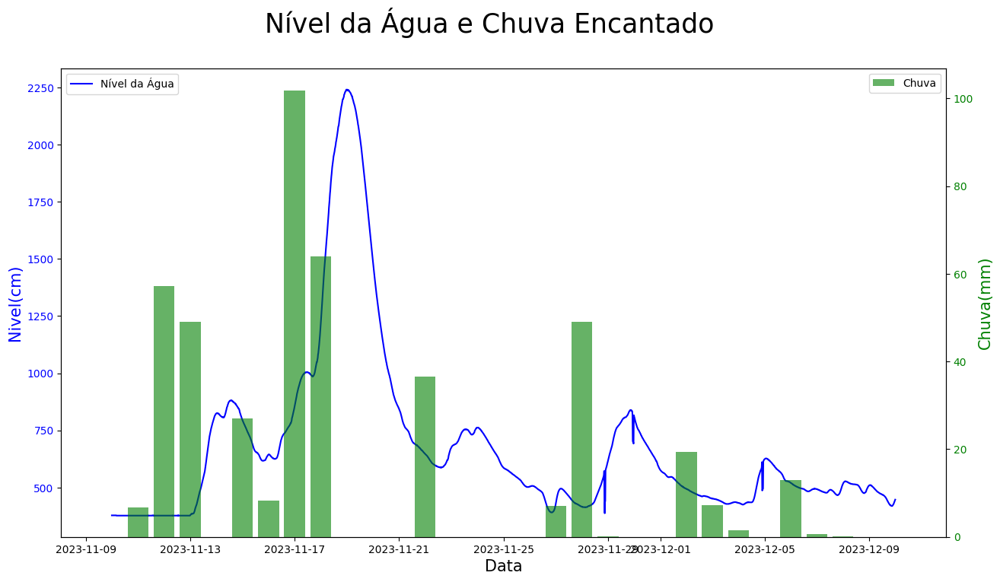

In [243]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_agrupa_chuva(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

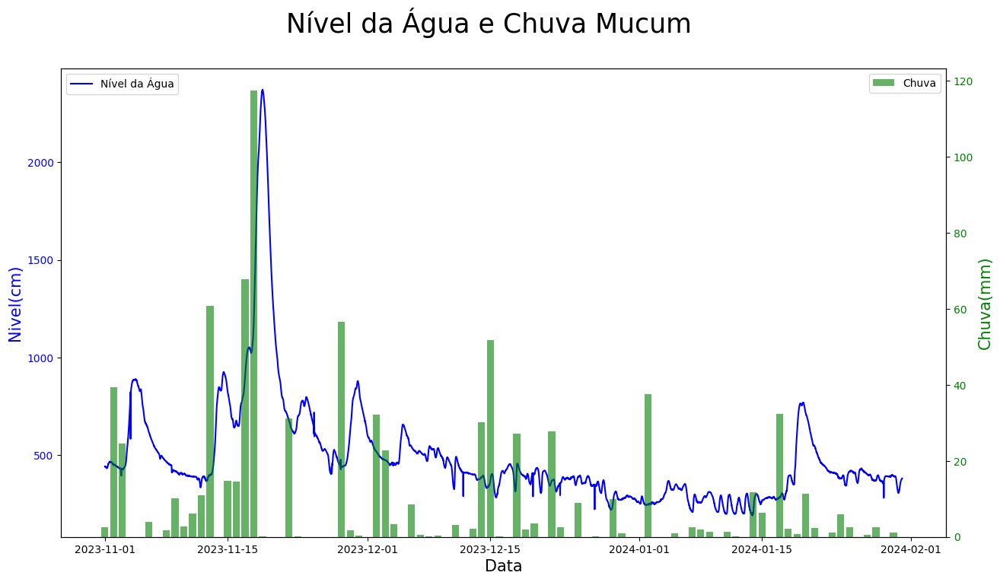

In [244]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_chuva(df_Mucum_unico,
                   "Nível da Água e Chuva Mucum",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

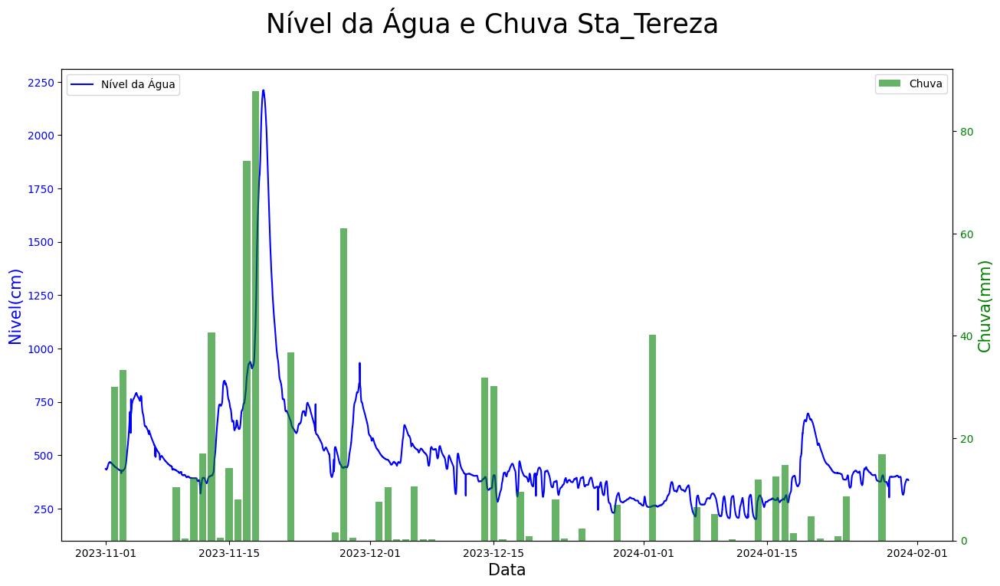

In [245]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_chuva(df_Sta_Tereza_unico,
                   "Nível da Água e Chuva Sta_Tereza",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

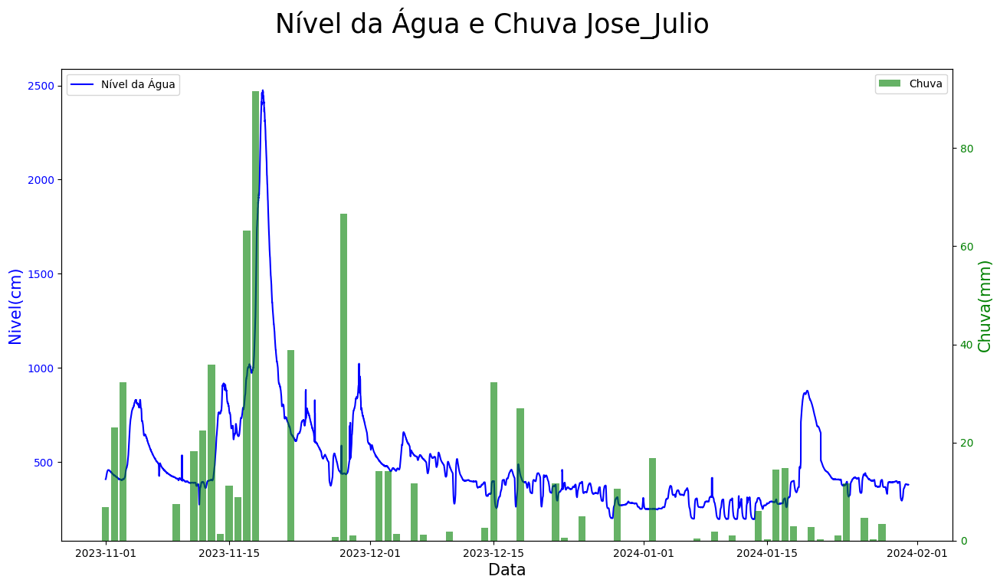

In [246]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_chuva(df_Jose_Julio_unico,
                   "Nível da Água e Chuva Jose_Julio",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

#### cidades intervalo 22-11-01 ate 24-10-31 (2anos separado por ano)

---




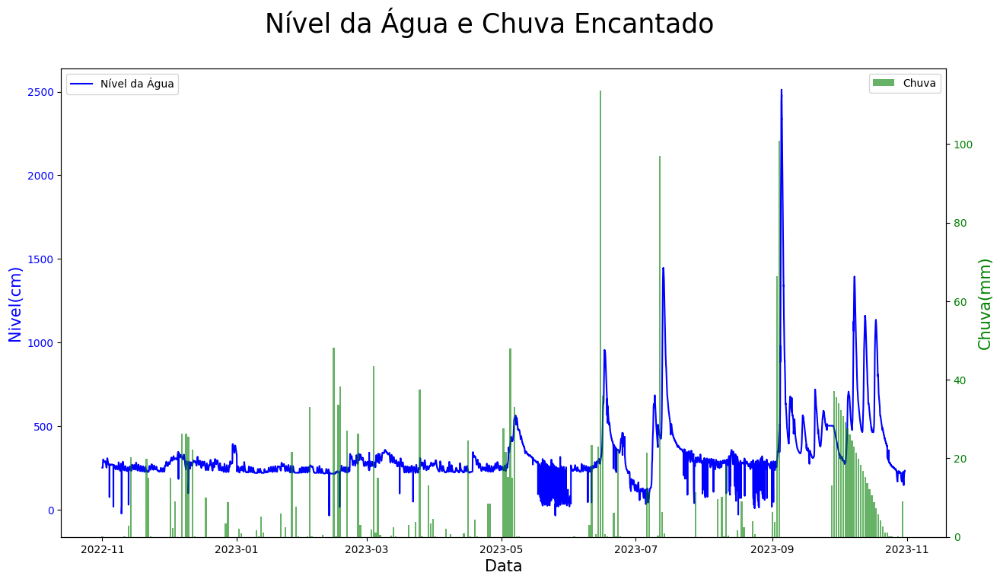

In [247]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-11-01')
data_fim = pd.to_datetime('2023-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

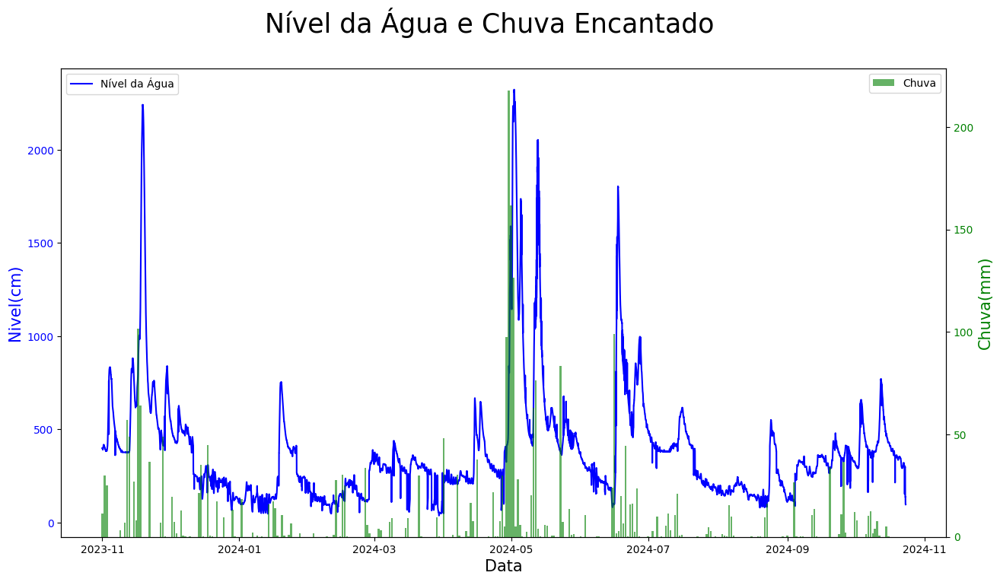

In [248]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

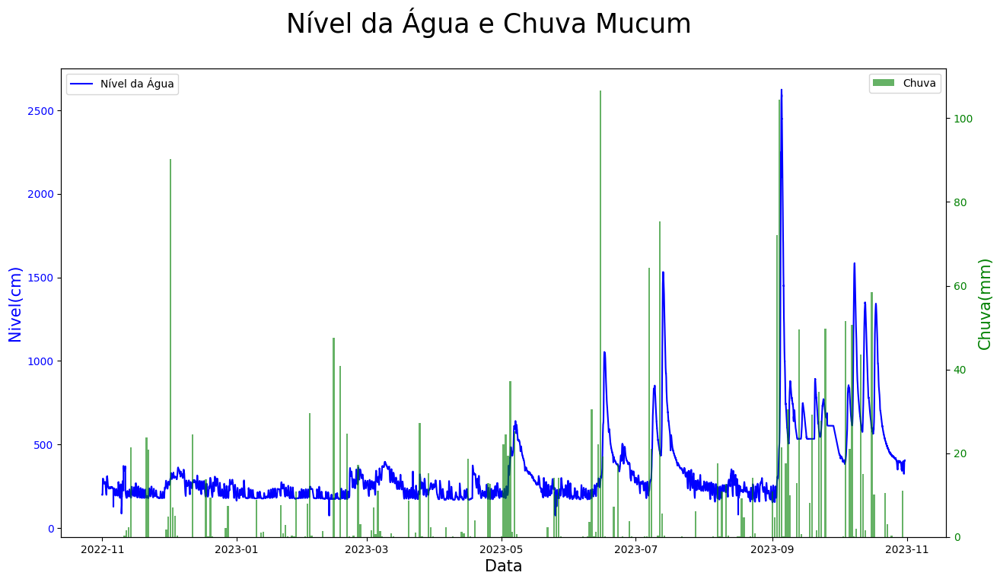

In [249]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-11-01')
data_fim = pd.to_datetime('2023-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Mucum_unico,
                   "Nível da Água e Chuva Mucum",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

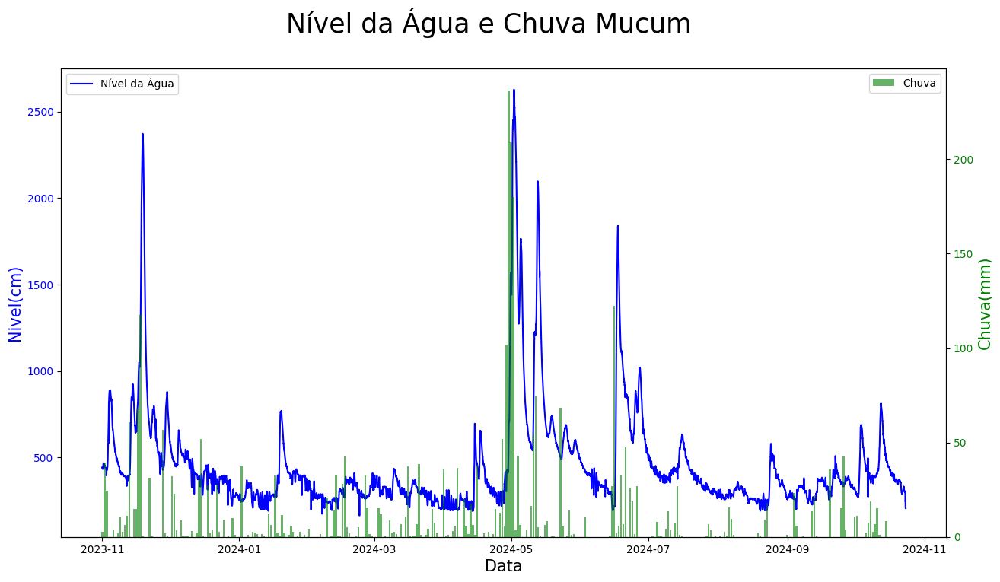

In [250]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Mucum_unico,
                   "Nível da Água e Chuva Mucum",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

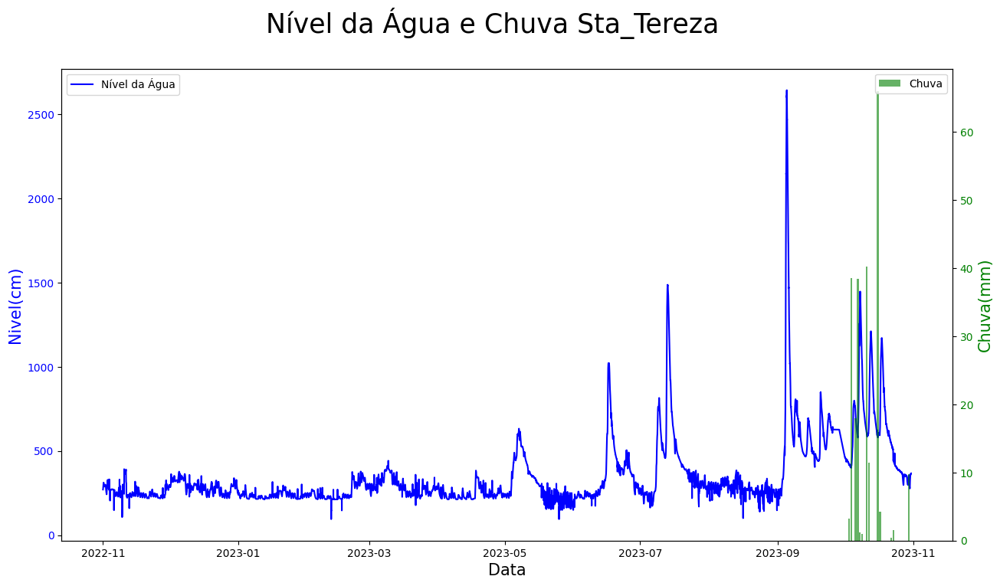

In [251]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-11-01')
data_fim = pd.to_datetime('2023-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Sta_Tereza_unico,
                   "Nível da Água e Chuva Sta_Tereza",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

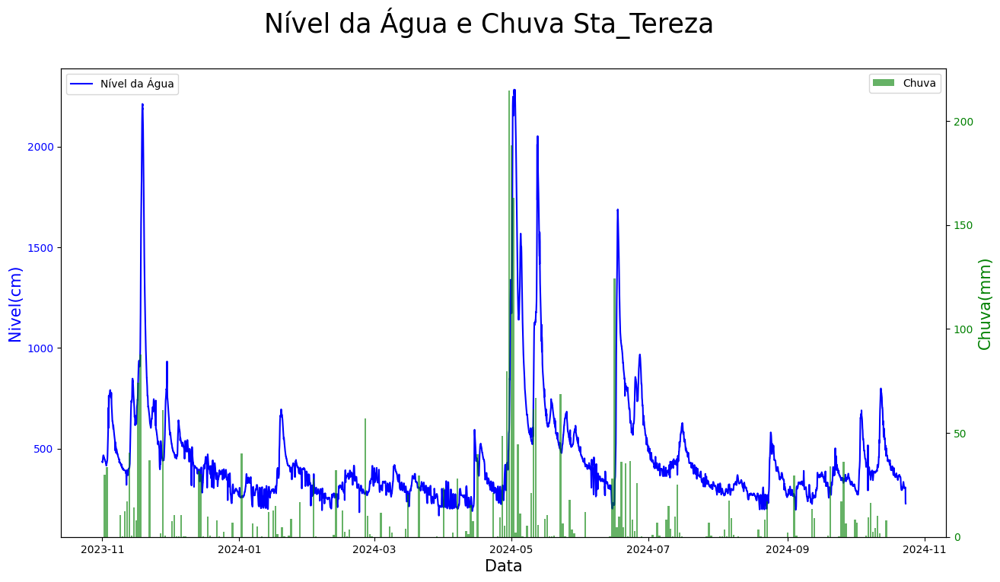

In [252]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Sta_Tereza_unico,
                   "Nível da Água e Chuva Sta_Tereza",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

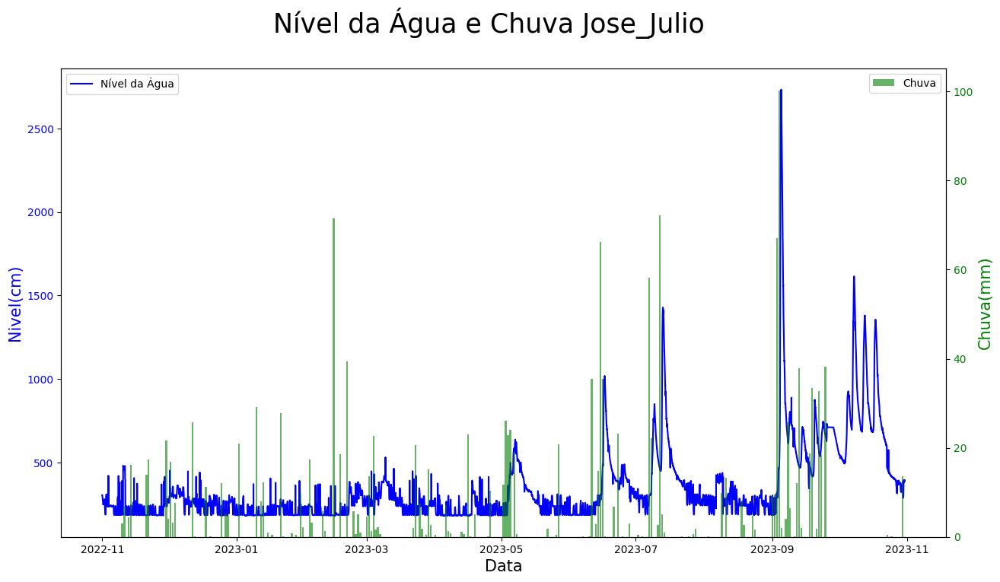

In [253]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-11-01')
data_fim = pd.to_datetime('2023-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Jose_Julio_unico,
                   "Nível da Água e Chuva Jose_Julio",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

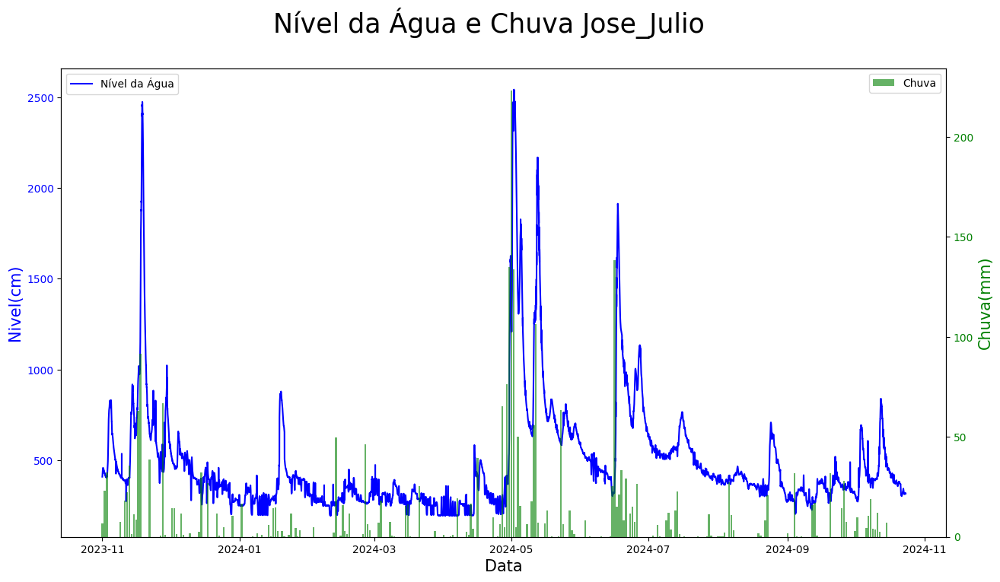

In [254]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Jose_Julio_unico,
                   "Nível da Água e Chuva Jose_Julio",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

# Calcular correlação

Criamos um dataframe que junta as variáveis de todas as estações, não levando em consideração a coluna Data/Hora

Também calculamos a correlação de cada subgrupo de variáveis e a correlação geral de todas as variáveis do data frame

In [255]:
niveis = [df_Encantado_unico['Nivel(cm)'],df_Mucum_unico['Nivel(cm)'],df_Sta_Tereza_unico['Nivel(cm)'],df_Jose_Julio_unico['Nivel(cm)']]
niveis = pd.concat(niveis, axis=1)
niveis.columns = ['Nivel_Encantado', 'Nivel_Mucum', 'Nivel_Sta_Tereza', 'Nivel_Jose_Julio']


correlacao_niveis = niveis.corr()


chuvas = [df_Encantado_unico['Chuva(mm)'],df_Mucum_unico['Chuva(mm)'],df_Sta_Tereza_unico['Chuva(mm)'],df_Jose_Julio_unico['Chuva(mm)']]
chuvas = pd.concat(chuvas, axis=1)
chuvas.columns = ['chuva_Encantado', 'chuva_Mucum', 'chuva_Sta_Tereza', 'chuva_Jose_Julio']

correlacao_chuvas= chuvas.corr()

vazoes = [df_Encantado_unico['Vazao(m3/s)'],df_Mucum_unico['Vazao(m3/s)'],df_Jose_Julio_unico['Vazao(m3/s)']]
vazoes = pd.concat(vazoes, axis=1)
vazoes.columns = ['Vazao_Encantado', 'Vazao_Mucum', 'Vazao_Jose_Julio']

correlacao_vazoes = vazoes.corr()

correlacoes = [correlacao_niveis, correlacao_chuvas, correlacao_vazoes]
correlacoes = pd.concat(correlacoes, axis=1)

df_geral = [niveis, chuvas, vazoes]
df_geral = pd.concat(df_geral, axis=1)
df_geral

correlacao_geral = df_geral.corr()
correlacao_geral

,Nivel_Encantado,Nivel_Mucum,Nivel_Sta_Tereza,Nivel_Jose_Julio,chuva_Encantado,chuva_Mucum,chuva_Sta_Tereza,chuva_Jose_Julio,Vazao_Encantado,Vazao_Mucum,Vazao_Jose_Julio
Nivel_Encantado,1.000000,0.955603,0.963815,0.934676,0.104490,0.110907,0.148559,0.150046,0.939215,0.947643,0.934926
Nivel_Mucum,0.955603,1.000000,0.993816,0.980387,0.102176,0.113513,0.152548,0.153170,0.951849,0.968184,0.953961
Nivel_Sta_Tereza,0.963815,0.993816,1.000000,0.983951,0.095359,0.104430,0.139215,0.139742,0.953242,0.968911,0.957567
Nivel_Jose_Julio,0.934676,0.980387,0.983951,1.000000,0.094070,0.101713,0.143213,0.133252,0.933062,0.948694,0.945601
chuva_Encantado,0.104490,0.102176,0.095359,0.094070,1.000000,0.245354,0.141974,0.104758,0.100909,0.101359,0.096703
chuva_Mucum,0.110907,0.113513,0.104430,0.101713,0.245354,1.000000,0.202627,0.159277,0.115177,0.116979,0.110730
chuva_Sta_Tereza,0.148559,0.152548,0.139215,0.143213,0.141974,0.202627,1.000000,0.172239,0.152876,0.154918,0.151625
chuva_Jose_Julio,0.150046,0.153170,0.139742,0.133252,0.104758,0.159277,0.172239,1.000000,0.158284,0.163720,0.151849
Vazao_Encantado,0.939215,0.951849,0.953242,0.933062,0.100909,0.115177,0.152876,0.158284,1.000000,0.986925,0.984770
Vazao_Mucum,0.947643,0.968184,0.968911,0.948694,0.101359,0.116979,0.154918,0.163720,0.986925,1.000000,0.992457


Criamos um gráfico que compara a correlação das vaiáveis Nível em relação ao Nível de Encantado.

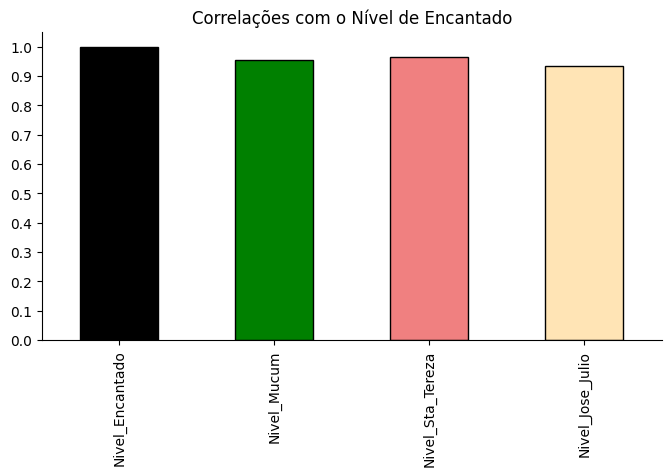

In [256]:
from matplotlib import pyplot as plt
correlacao_niveis['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = ['black','g','lightcoral','moccasin'], edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Criamos o heatmap, o gráfico da Matriz das Correlações, a fim de mais fácilmente visualizar a correlação entre variávies.

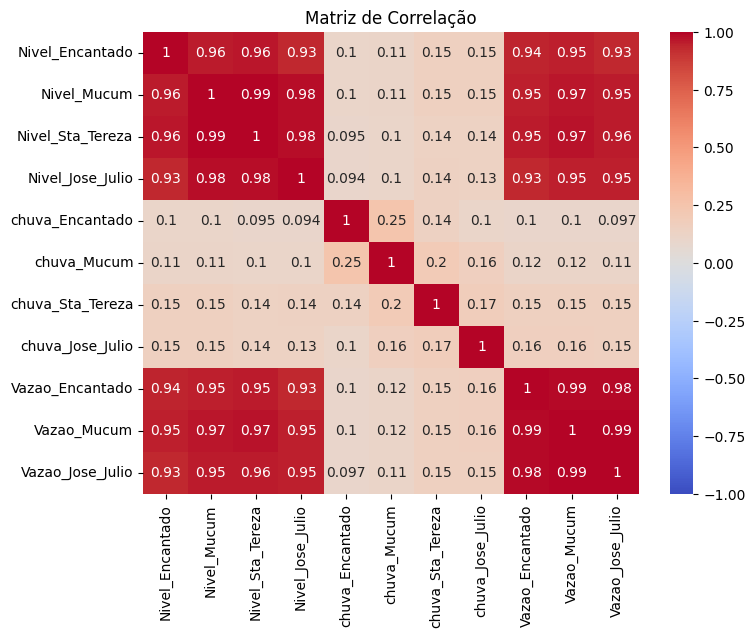

In [257]:
plt.figure(figsize=(8, 6))
sns.heatmap(correlacao_geral, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlação')
plt.show()

Mudamos a visualização dos dados para dar mais destaque da relação das variáveis com o Nível de Encantado, a cidade que buscamos prever o nível no projeto final. Escolhemos um formato de gráfico de barras para facilitar a visualização da correlação, com linhas que indicam a força da correlação.

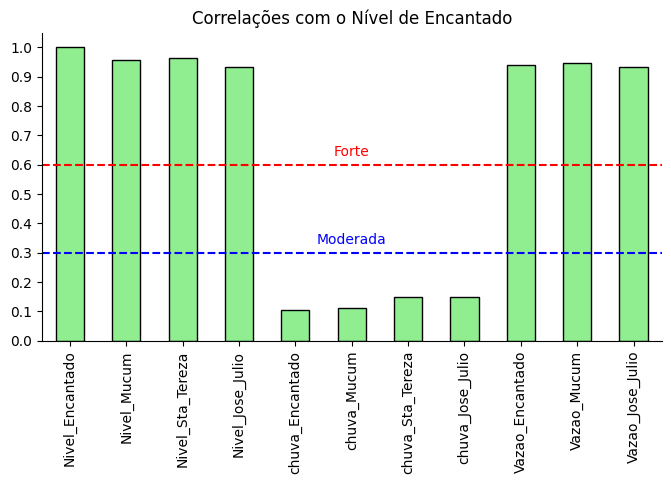

In [258]:
correlacao_geral['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = 'lightgreen', edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
# Adicionar linha horizontal
plt.axhline(y=0.6, color='r', linestyle='--')
plt.axhline(y=0.3, color='b', linestyle='--')
# Adicionar texto acima da linha
plt.text(5, 0.62, 'Forte', color='r', ha='center', va='bottom')
plt.text(5, 0.32, 'Moderada', color='b', ha='center', va='bottom')
plt.show()

# Média, Mediana e Desvio Padrão

In [259]:
# Calcula a média, mediana e desvio padrão
estatisticas_descritivas = df_geral.agg(['mean', 'median', 'std'])


# Combina as estatísticas em um único DataFrame
tabela_estatisticas = pd.DataFrame({'Média': estatisticas_descritivas.loc['mean'],
                                 'Mediana': estatisticas_descritivas.loc['median'],
                                 'Desvio Padrão': estatisticas_descritivas.loc['std']})
tabela_estatisticas

,Média,Mediana,Desvio Padrão
Nivel_Encantado,345.589117,278.0,257.848292
Nivel_Mucum,391.745415,306.0,279.219681
Nivel_Sta_Tereza,394.198179,317.0,246.968157
Nivel_Jose_Julio,411.686431,323.0,286.340572
chuva_Encantado,0.066261,0.0,0.530214
chuva_Mucum,0.075331,0.0,0.599790
chuva_Sta_Tereza,0.042942,0.0,0.429846
chuva_Jose_Julio,0.061729,0.0,0.463246
Vazao_Encantado,653.356823,233.2,1390.168173
Vazao_Mucum,617.324635,230.5,1263.218912


# Histograma

Montamos histogramas das variáveis analisadas para entender a distribuição dos dados.

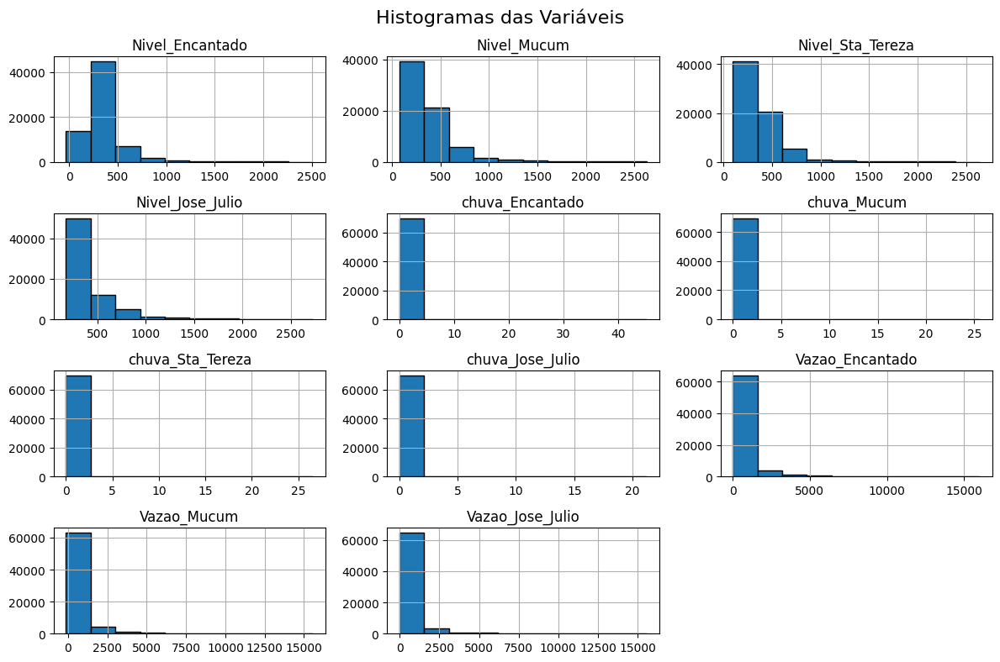

In [260]:
df_geral.hist(figsize=(12, 8), bins=10, edgecolor='black')
plt.suptitle('Histogramas das Variáveis', fontsize=16)
plt.tight_layout()
plt.show()

# Parte 2

### Seleção do intervalo

In [261]:
import matplotlib.pyplot as plt

def plotar_chuva_nivel_vazao(dataset, titulo, labelx, labely1, labely2, labely3, coluna_data, coluna_chuva, coluna_nivel, coluna_vazao, intervalo_data=None, frequencia=None, largura_barras=0.3):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar os dados de chuva pela frequência especificada (D - dia, W - semana, M - mês, H - hora)
    # Se a frequência for 'None', não faz reamostragem (preserva o intervalo original)
    if frequencia is not None:
        dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()
    else:
        dados_chuva_agrupados = dataset[[coluna_data, coluna_chuva]]  # Mantém os dados originais



    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_chuva_agrupados[coluna_data], dados_chuva_agrupados[coluna_chuva], color='g', alpha=0.6, width=largura_barras, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Eixo primário (eixo y à esquerda) para o Vazao da Agua (linha)
    ax3 = ax1.twinx()
    ax3.plot(dataset[coluna_data], dataset[coluna_vazao]/10, color='red', label='Vazao da Agua', linestyle='-')
    ax3.set_xlabel(labelx, fontsize=15)
    ax3.set_ylabel(labely1, color='red', fontsize=15)
    ax3.tick_params(axis='y', labelcolor='red')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)  # Removi o parâmetro `pad`
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")
    ax3.legend(loc="upper right")

    plt.show()



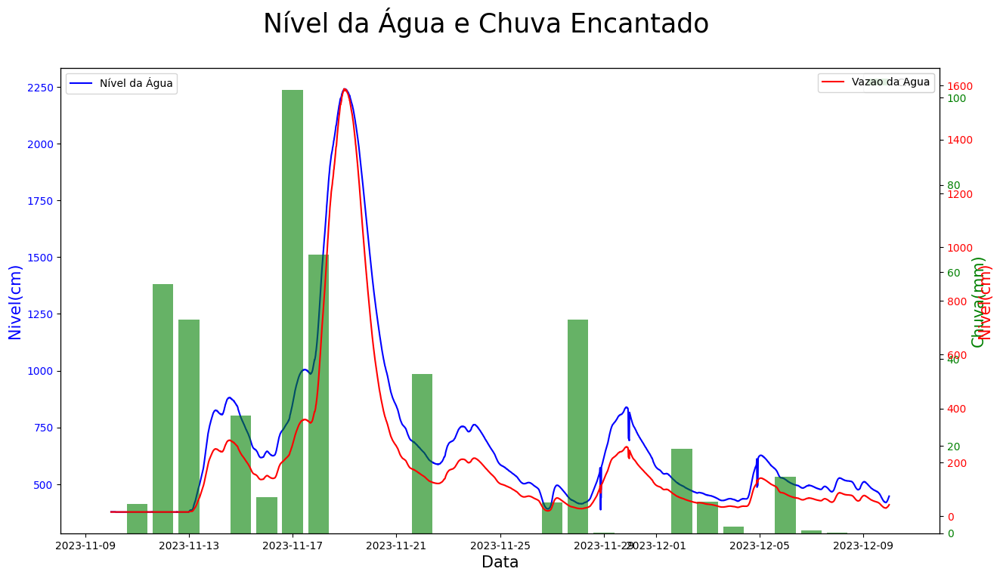

In [262]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' , largura_barras=0.8)

In [263]:
def ajustar_coluna_por_horas(df, coluna_data, horas):

    # Como o intervalo é de 15 minutos, para deslocar por 1 hora, precisamos deslocar 4 unidades
    deslocamento = horas * 4  # 1 hora = 4 intervalos de 15 minutos

    # Gerar o nome da nova coluna com o sufixo '_deslocada'
    nome_coluna_deslocada = f'{coluna_data}_deslocada'

    # Deslocar a coluna de chuva
    df[nome_coluna_deslocada] = df[coluna_data].shift(deslocamento)

    return df


In [264]:
# Exemplo de uso da função com a base de dados já carregada na variável df_Encantado
df_Encantado_unico = ajustar_coluna_por_horas(df_Encantado_unico, 'Chuva(mm)', 32)  # Desloca para frente 2 horas

# Exibir os primeiros registros para verificar
print(df_Encantado_unico.tail())

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
69973 2024-10-23 15:30:00        0.0       98.0       354.34   
69974 2024-10-23 15:45:00        0.0       98.0       354.34   
69975 2024-10-23 16:00:00        0.0       98.0       354.34   
69976 2024-10-23 16:15:00        0.0       97.0       352.04   
69977 2024-10-23 16:30:00        0.0       97.0       352.04   

       Chuva(mm)_deslocada  
69973                  0.0  
69974                  0.0  
69975                  0.0  
69976                  0.0  
69977                  0.0  


<ipython-input-261-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


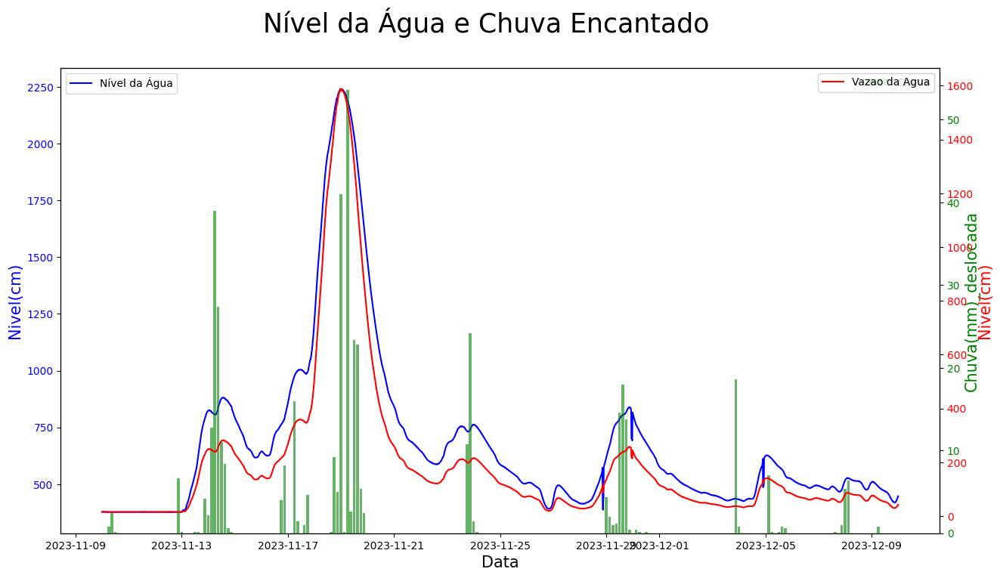

In [265]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_deslocada",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)_deslocada',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

In [266]:
def normalizar_e_suavizar(dataset, coluna_chuva, janela_suavizacao=3):
    # Normalização da coluna de Chuva(mm)
    chuva_normalizada = (dataset[coluna_chuva] - dataset[coluna_chuva].min()) / (dataset[coluna_chuva].max() - dataset[coluna_chuva].min())

    # Suavização usando média móvel
    chuva_suavizada = dataset[coluna_chuva].rolling(window=janela_suavizacao, min_periods=1).mean()

    # Adicionando as colunas normalizada e suavizada ao dataset original
    dataset['Chuva_Normalizada'] = chuva_normalizada
    dataset['Chuva_Suavizada'] = chuva_suavizada

    return dataset

# Exemplo de uso da função com a base de dados já carregada em df_Encantado_unico
df_Encantado_unico = normalizar_e_suavizar(df_Encantado_unico, 'Chuva(mm)', janela_suavizacao=3)

# Exibir as primeiras linhas para verificar se as colunas foram adicionadas corretamente
print(df_Encantado_unico.head())

            Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  Chuva(mm)_deslocada  \
0 2022-10-22 19:15:00        0.0      287.0        177.5                  NaN   
1 2022-10-22 19:30:00        0.0      286.0        174.3                  NaN   
2 2022-10-22 19:45:00        0.0      284.0        167.8                  NaN   
3 2022-10-22 20:00:00        0.0      283.0        164.6                  NaN   
4 2022-10-22 20:15:00        0.0      282.0        161.5                  NaN   

   Chuva_Normalizada  Chuva_Suavizada  
0                0.0              0.0  
1                0.0              0.0  
2                0.0              0.0  
3                0.0              0.0  
4                0.0              0.0  


<ipython-input-261-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


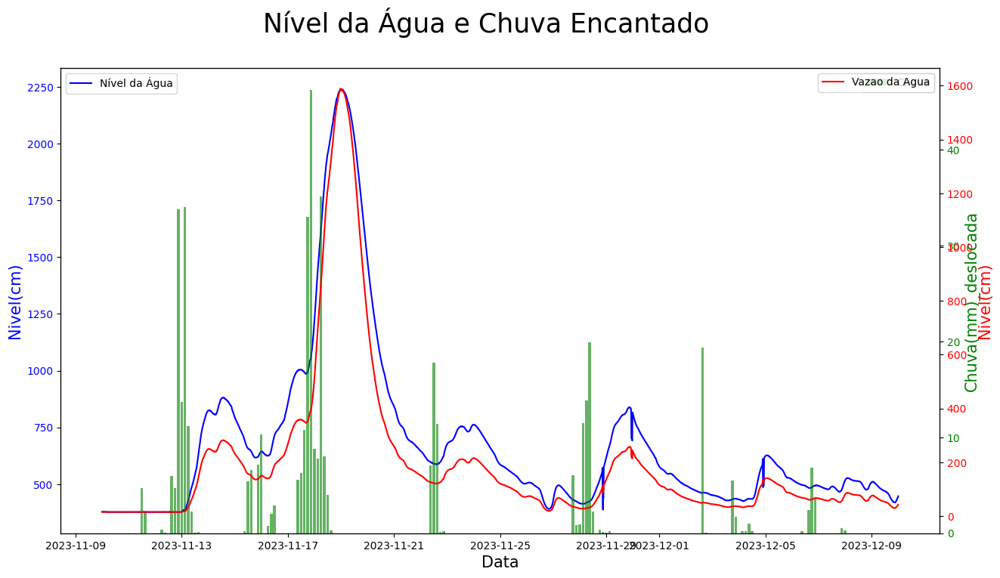

In [267]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_deslocada",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva_Suavizada',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

In [268]:
# Exemplo de uso da função com a base de dados já carregada na variável df_Encantado
df_Encantado_unico = ajustar_coluna_por_horas(df_Encantado_unico, 'Chuva_Suavizada', 32)  # Desloca para frente 2 horas

# Exibir os primeiros registros para verificar
print(df_Encantado_unico.tail())

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
69973 2024-10-23 15:30:00        0.0       98.0       354.34   
69974 2024-10-23 15:45:00        0.0       98.0       354.34   
69975 2024-10-23 16:00:00        0.0       98.0       354.34   
69976 2024-10-23 16:15:00        0.0       97.0       352.04   
69977 2024-10-23 16:30:00        0.0       97.0       352.04   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
69973                  0.0                0.0              0.0   
69974                  0.0                0.0              0.0   
69975                  0.0                0.0              0.0   
69976                  0.0                0.0              0.0   
69977                  0.0                0.0              0.0   

       Chuva_Suavizada_deslocada  
69973                        0.0  
69974                        0.0  
69975                        0.0  
69976                        0.0  
69977                        0.0  


In [269]:
# Exemplo de uso da função com a base de dados já carregada na variável df_Encantado
df_Encantado_unico = ajustar_coluna_por_horas(df_Encantado_unico, 'Chuva_Normalizada', 25)  # Desloca para frente 2 horas

# Exibir os primeiros registros para verificar
print(df_Encantado_unico.tail())

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
69973 2024-10-23 15:30:00        0.0       98.0       354.34   
69974 2024-10-23 15:45:00        0.0       98.0       354.34   
69975 2024-10-23 16:00:00        0.0       98.0       354.34   
69976 2024-10-23 16:15:00        0.0       97.0       352.04   
69977 2024-10-23 16:30:00        0.0       97.0       352.04   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
69973                  0.0                0.0              0.0   
69974                  0.0                0.0              0.0   
69975                  0.0                0.0              0.0   
69976                  0.0                0.0              0.0   
69977                  0.0                0.0              0.0   

       Chuva_Suavizada_deslocada  Chuva_Normalizada_deslocada  
69973                        0.0                          0.0  
69974                        0.0                          0.0  
69975                     

<ipython-input-261-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


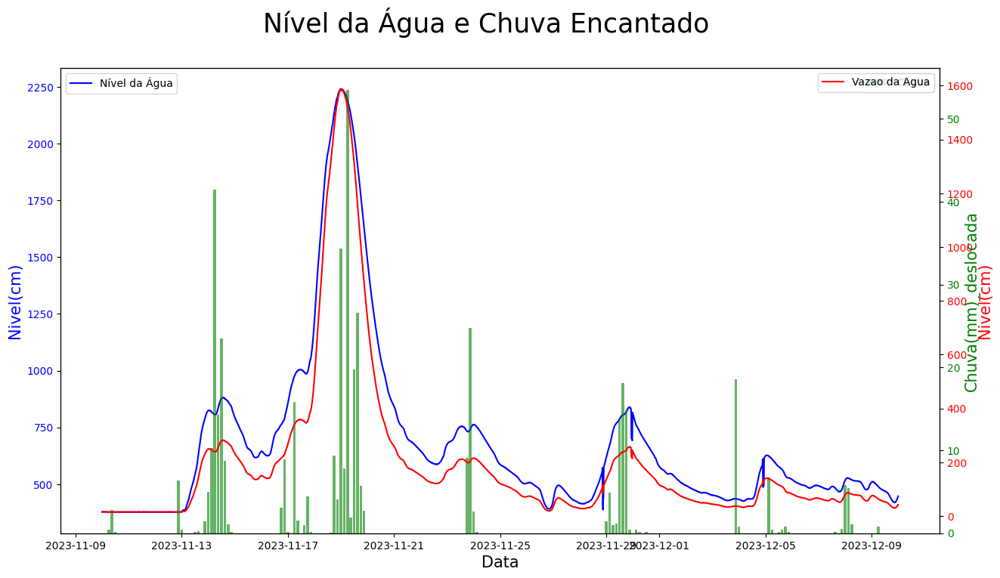

In [270]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_deslocada",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva_Suavizada_deslocada',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

In [271]:
# Lista de DataFrames
databases = [df_Encantado_unico, df_Jose_Julio_unico, df_Sta_Tereza_unico, df_Mucum_unico]

# Combina os DataFrames pela coluna 'Data/Hora'
combined = pd.concat(databases, ignore_index=True)

# Soma de 'Chuva(mm)' para cada 'Data/Hora'
chuva_por_data = combined.groupby('Data/Hora')['Chuva(mm)'].sum().reset_index()

# Adiciona a soma como nova coluna ao primeiro DataFrame (db1)
df_Encantado_unico = df_Encantado_unico.merge(chuva_por_data, on='Data/Hora', suffixes=('', '_Total'))

print(df_Encantado_unico)

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
0     2022-10-22 19:15:00        0.0      287.0       177.50   
1     2022-10-22 19:30:00        0.0      286.0       174.30   
2     2022-10-22 19:45:00        0.0      284.0       167.80   
3     2022-10-22 20:00:00        0.0      283.0       164.60   
4     2022-10-22 20:15:00        0.0      282.0       161.50   
...                   ...        ...        ...          ...   
69973 2024-10-23 15:30:00        0.0       98.0       354.34   
69974 2024-10-23 15:45:00        0.0       98.0       354.34   
69975 2024-10-23 16:00:00        0.0       98.0       354.34   
69976 2024-10-23 16:15:00        0.0       97.0       352.04   
69977 2024-10-23 16:30:00        0.0       97.0       352.04   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
0                      NaN                0.0              0.0   
1                      NaN                0.0              0.0   
2                      NaN       

<ipython-input-261-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


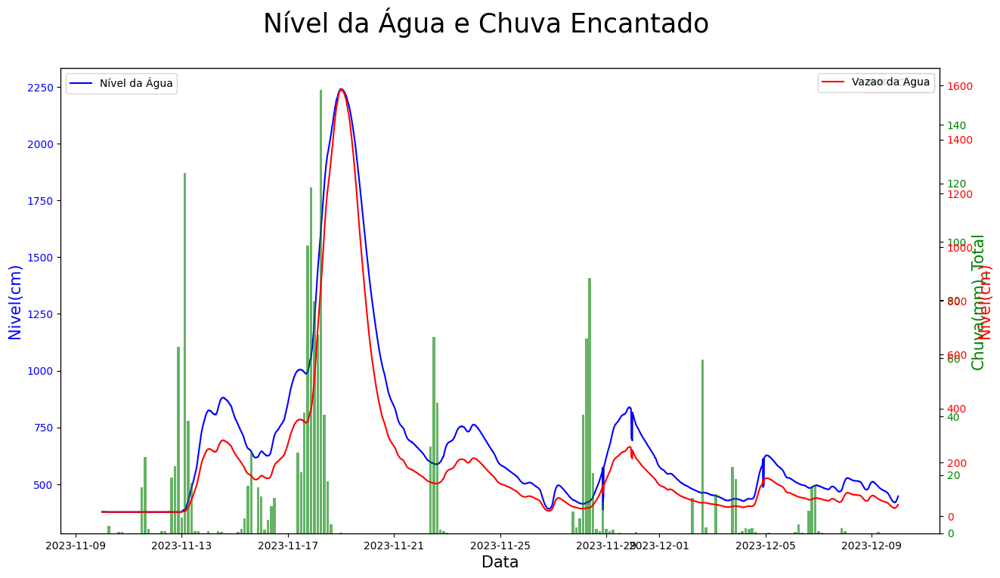

In [272]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_Total",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)_Total',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

In [273]:
# Exemplo de uso da função com a base de dados já carregada na variável df_Encantado
df_Encantado_unico = ajustar_coluna_por_horas(df_Encantado_unico, 'Chuva(mm)_Total', 25)  # Desloca para frente 2 horas

# Exibir os primeiros registros para verificar
print(df_Encantado_unico.tail())

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
69973 2024-10-23 15:30:00        0.0       98.0       354.34   
69974 2024-10-23 15:45:00        0.0       98.0       354.34   
69975 2024-10-23 16:00:00        0.0       98.0       354.34   
69976 2024-10-23 16:15:00        0.0       97.0       352.04   
69977 2024-10-23 16:30:00        0.0       97.0       352.04   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
69973                  0.0                0.0              0.0   
69974                  0.0                0.0              0.0   
69975                  0.0                0.0              0.0   
69976                  0.0                0.0              0.0   
69977                  0.0                0.0              0.0   

       Chuva_Suavizada_deslocada  Chuva_Normalizada_deslocada  \
69973                        0.0                          0.0   
69974                        0.0                          0.0   
69975                  

<ipython-input-261-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


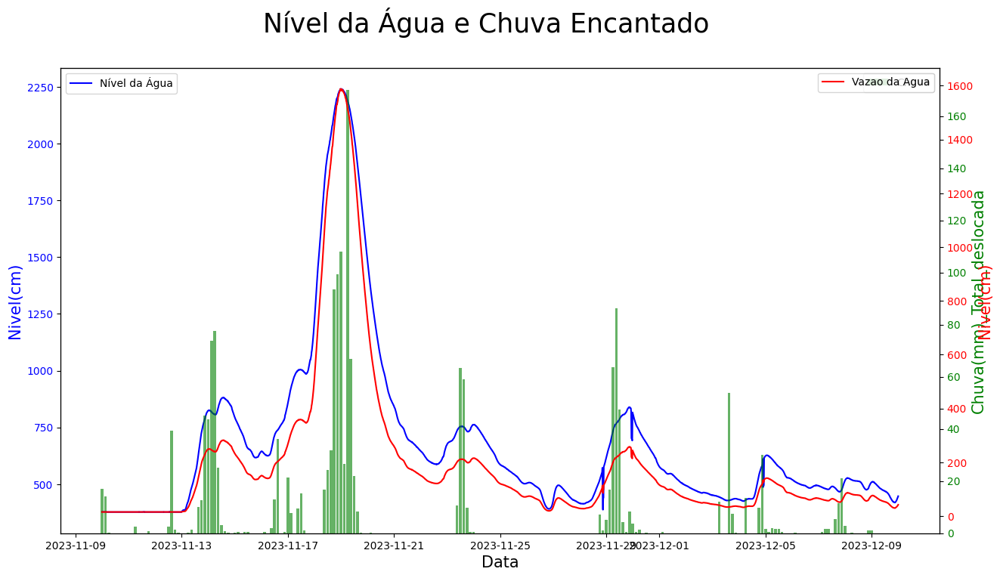

In [274]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_Total_deslocada",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)_Total_deslocada',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

## Calcular correlação

Criamos um dataframe que junta as variáveis de todas as estações, não levando em consideração a coluna Data/Hora

Também calculamos a correlação de cada subgrupo de variáveis e a correlação geral de todas as variáveis do data frame

In [275]:
niveis = [df_Encantado_unico['Nivel(cm)'],df_Mucum_unico['Nivel(cm)'],df_Sta_Tereza_unico['Nivel(cm)'],df_Jose_Julio_unico['Nivel(cm)']]
niveis = pd.concat(niveis, axis=1)
niveis.columns = ['Nivel_Encantado', 'Nivel_Mucum', 'Nivel_Sta_Tereza', 'Nivel_Jose_Julio']


correlacao_niveis = niveis.corr()


chuvas = [df_Encantado_unico['Chuva(mm)_Total_deslocada']]
chuvas = pd.concat(chuvas, axis=1)
chuvas.columns = ['Chuva_Total_deslocada']

correlacao_chuvas= chuvas.corr()

vazoes = [df_Encantado_unico['Vazao(m3/s)'],df_Mucum_unico['Vazao(m3/s)'],df_Jose_Julio_unico['Vazao(m3/s)']]
vazoes = pd.concat(vazoes, axis=1)
vazoes.columns = ['Vazao_Encantado', 'Vazao_Mucum', 'Vazao_Jose_Julio']

correlacao_vazoes = vazoes.corr()

correlacoes = [correlacao_niveis, correlacao_chuvas, correlacao_vazoes]
correlacoes = pd.concat(correlacoes, axis=1)

df_geral = [niveis, chuvas, vazoes]
df_geral = pd.concat(df_geral, axis=1)
df_geral

correlacao_geral = df_geral.corr()
correlacao_geral

,Nivel_Encantado,Nivel_Mucum,Nivel_Sta_Tereza,Nivel_Jose_Julio,Chuva_Total_deslocada,Vazao_Encantado,Vazao_Mucum,Vazao_Jose_Julio
Nivel_Encantado,1.000000,0.955603,0.963815,0.934676,0.364377,0.939215,0.947643,0.934926
Nivel_Mucum,0.955603,1.000000,0.993816,0.980387,0.370279,0.951849,0.968184,0.953961
Nivel_Sta_Tereza,0.963815,0.993816,1.000000,0.983951,0.361968,0.953242,0.968911,0.957567
Nivel_Jose_Julio,0.934676,0.980387,0.983951,1.000000,0.345413,0.933062,0.948694,0.945601
Chuva_Total_deslocada,0.364377,0.370279,0.361968,0.345413,1.000000,0.398643,0.403394,0.397174
Vazao_Encantado,0.939215,0.951849,0.953242,0.933062,0.398643,1.000000,0.986925,0.984770
Vazao_Mucum,0.947643,0.968184,0.968911,0.948694,0.403394,0.986925,1.000000,0.992457
Vazao_Jose_Julio,0.934926,0.953961,0.957567,0.945601,0.397174,0.984770,0.992457,1.000000


Criamos um gráfico que compara a correlação das vaiáveis Nível em relação ao Nível de Encantado.

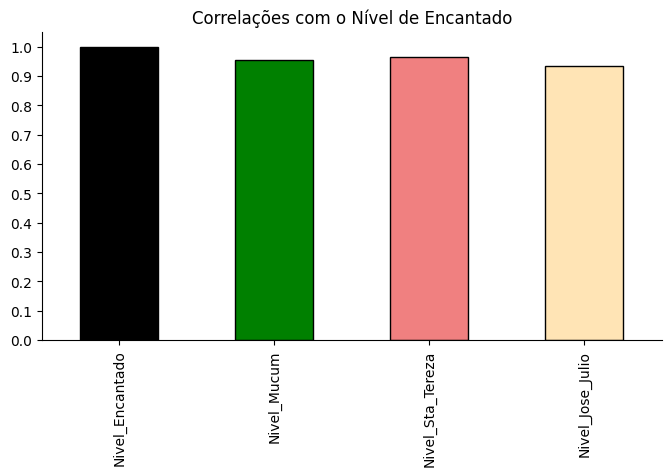

In [276]:
from matplotlib import pyplot as plt
correlacao_niveis['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = ['black','g','lightcoral','moccasin'], edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Criamos o heatmap, o gráfico da Matriz das Correlações, a fim de mais fácilmente visualizar a correlação entre variávies.

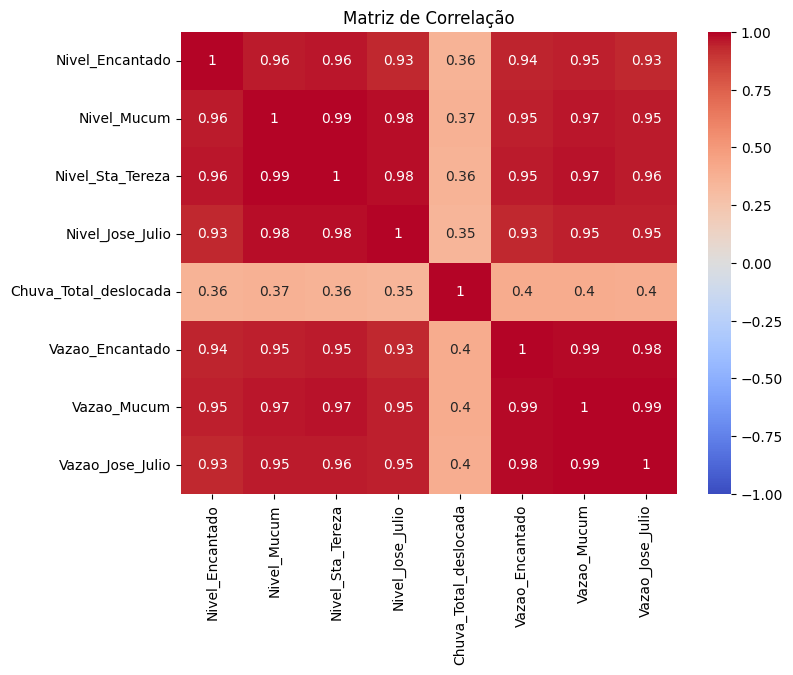

In [277]:
plt.figure(figsize=(8, 6))
sns.heatmap(correlacao_geral, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlação')
plt.show()

Mudamos a visualização dos dados para dar mais destaque da relação das variáveis com o Nível de Encantado, a cidade que buscamos prever o nível no projeto final. Escolhemos um formato de gráfico de barras para facilitar a visualização da correlação, com linhas que indicam a força da correlação.

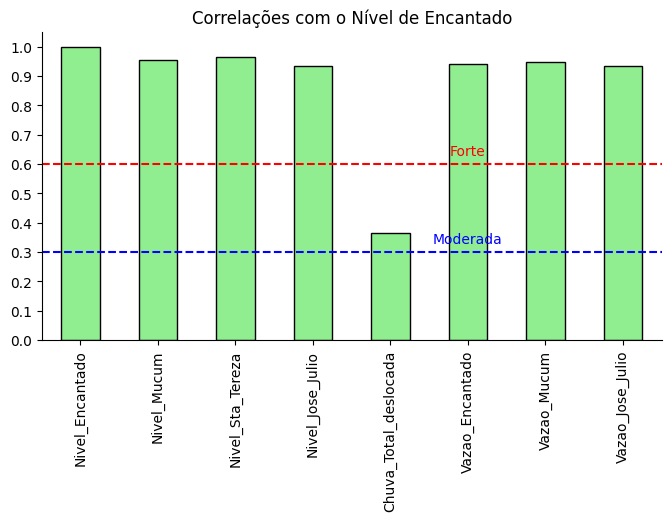

In [278]:
correlacao_geral['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = 'lightgreen', edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
# Adicionar linha horizontal
plt.axhline(y=0.6, color='r', linestyle='--')
plt.axhline(y=0.3, color='b', linestyle='--')
# Adicionar texto acima da linha
plt.text(5, 0.62, 'Forte', color='r', ha='center', va='bottom')
plt.text(5, 0.32, 'Moderada', color='b', ha='center', va='bottom')
plt.show()

## Recorte de 1 mes selecionado

In [279]:
# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Encantado_mes = df_Encantado_unico[(df_Encantado_unico['Data/Hora'] >= data_inicio) & (df_Encantado_unico['Data/Hora'] <= data_fim)]

# Filtra os dados entre as datas sem tratamento
df_Encantado_mes_ST = df_Encantado_sem_trat[(df_Encantado_sem_trat['Data/Hora'] >= data_inicio) & (df_Encantado_sem_trat['Data/Hora'] <= data_fim)]
#print("Base de dados original:")
#print(df_Encantado_unico)

#print("\nBase de dados filtrada:")
#print(df_Encantado_mes)

In [280]:
# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Mucum_mes = df_Mucum_unico[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                                  (df_Mucum_unico['Data/Hora'] <= data_fim)]

# Filtra os dados entre as datas sem tratamento
df_Mucum_mes_ST = df_Mucum_sem_trat[(df_Mucum_sem_trat['Data/Hora'] >= data_inicio) &
                                  (df_Mucum_sem_trat['Data/Hora'] <= data_fim)]

#print("Base de dados original:")
#print(df_Encantado_unico)

#print("\nBase de dados filtrada:")
#print(df_Encantado_mes)

In [281]:
# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Sta_Tereza_mes = df_Sta_Tereza_unico[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicio) &
                                  (df_Sta_Tereza_unico['Data/Hora'] <= data_fim)]

# Filtra os dados entre as datas sem tratamento
df_Sta_Tereza_mes_ST = df_Sta_Tereza_sem_trat[(df_Sta_Tereza_sem_trat['Data/Hora'] >= data_inicio) &
                                  (df_Sta_Tereza_sem_trat['Data/Hora'] <= data_fim)]

#print("Base de dados original:")
#print(df_Encantado_unico)

#print("\nBase de dados filtrada:")
#print(df_Encantado_mes)

In [282]:
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Jose_Julio_mes = df_Jose_Julio_unico[(df_Jose_Julio_unico['Data/Hora'] >= data_inicio) &
                                  (df_Jose_Julio_unico['Data/Hora'] <= data_fim)]

# Filtra os dados entre as datas sem tratamento
df_Jose_Julio_mes_ST = df_Jose_Julio_sem_trat[(df_Jose_Julio_sem_trat['Data/Hora'] >= data_inicio) &
                                  (df_Jose_Julio_sem_trat['Data/Hora'] <= data_fim)]

#print("Base de dados original:")
#print(df_Encantado_unico)

#print("\nBase de dados filtrada:")
#print(df_Encantado_mes)

In [283]:
# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2024-6-10')

# Filtra os dados entre as datas
df_Encantado_7mes = df_Encantado_unico[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                                  (df_Encantado_unico['Data/Hora'] <= data_fim)]
df_Mucum_7mes = df_Mucum_unico[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                                  (df_Mucum_unico['Data/Hora'] <= data_fim)]
df_Sta_Tereza_7mes = df_Sta_Tereza_unico[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicio) &
                                  (df_Sta_Tereza_unico['Data/Hora'] <= data_fim)]
df_Jose_Julio_7mes = df_Jose_Julio_unico[(df_Jose_Julio_unico['Data/Hora'] >= data_inicio) &
                                  (df_Jose_Julio_unico['Data/Hora'] <= data_fim)]

In [284]:
df_Encantado_mes_ST.info()
df_Mucum_mes_ST.info()
df_Sta_Tereza_mes_ST.info()
df_Jose_Julio_mes_ST.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2869 entries, 30500 to 33368
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    2869 non-null   datetime64[ns]
 1   Chuva(mm)    2869 non-null   float64       
 2   Nivel(cm)    2869 non-null   float64       
 3   Vazao(m3/s)  2869 non-null   float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 112.1 KB
<class 'pandas.core.frame.DataFrame'>
Index: 2857 entries, 30526 to 33382
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    2857 non-null   datetime64[ns]
 1   Chuva(mm)    2857 non-null   float64       
 2   Nivel(cm)    2857 non-null   float64       
 3   Vazao(m3/s)  2857 non-null   float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 111.6 KB
<class 'pandas.core.frame.DataFrame'>
Index: 2865 entries, 30302 to 33166
Data

In [285]:
df_Encantado_mes_ST['Chuva(mm)'] = df_Encantado_mes_ST['Chuva(mm)'].interpolate(method='linear')
df_Mucum_mes_ST['Chuva(mm)'] = df_Mucum_mes_ST['Chuva(mm)'].interpolate(method='linear')
df_Sta_Tereza_mes_ST['Chuva(mm)'] = df_Sta_Tereza_mes_ST['Chuva(mm)'].interpolate(method='linear')
df_Jose_Julio_mes_ST['Chuva(mm)'] = df_Jose_Julio_mes_ST['Chuva(mm)'].interpolate(method='linear')

<ipython-input-285-8159651aaa79>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Encantado_mes_ST['Chuva(mm)'] = df_Encantado_mes_ST['Chuva(mm)'].interpolate(method='linear')
<ipython-input-285-8159651aaa79>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Mucum_mes_ST['Chuva(mm)'] = df_Mucum_mes_ST['Chuva(mm)'].interpolate(method='linear')
<ipython-input-285-8159651aaa79>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_ind

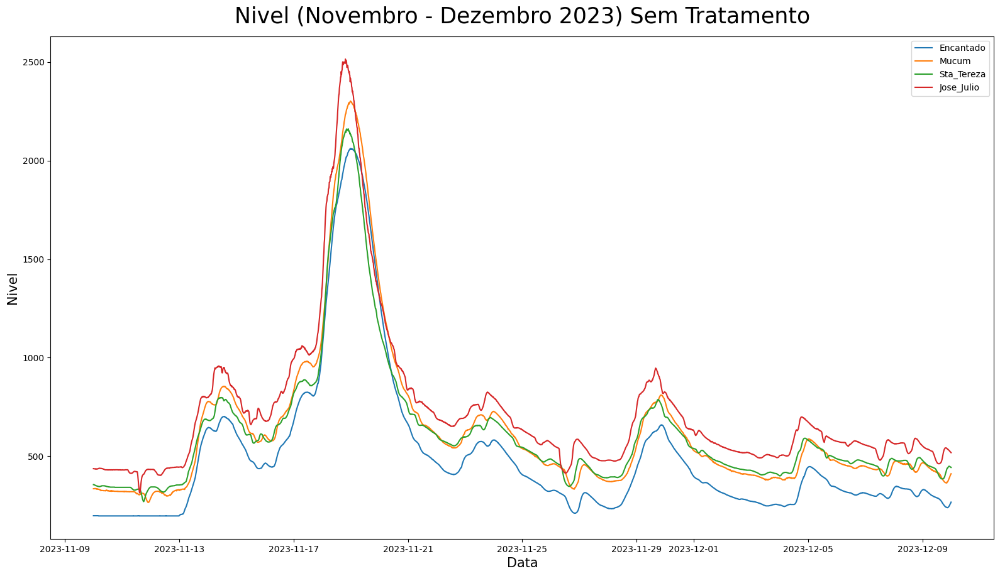

In [286]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (Novembro - Dezembro 2023) Sem Tratamento', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_mes_ST, df_Mucum_mes_ST, df_Sta_Tereza_mes_ST, df_Jose_Julio_mes_ST,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [287]:
df_Encantado_mes.head()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s),Chuva(mm)_deslocada,Chuva_Normalizada,Chuva_Suavizada,Chuva_Suavizada_deslocada,Chuva_Normalizada_deslocada,Chuva(mm)_Total,Chuva(mm)_Total_deslocada
36502,2023-11-10 00:00:00,0.0,378.0,149.1,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
36503,2023-11-10 00:15:00,0.0,378.0,149.1,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
36504,2023-11-10 00:30:00,0.0,378.0,149.1,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
36505,2023-11-10 00:45:00,0.0,378.0,149.1,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
36506,2023-11-10 01:00:00,0.0,378.0,149.1,0.0,0.0,0.0,0.0,0.004425,0.0,1.4


In [288]:
df_Encantado_mes.drop(['Chuva(mm)_deslocada', 'Chuva_Normalizada', 'Chuva_Suavizada', 'Chuva_Suavizada_deslocada', 'Chuva_Normalizada_deslocada'], axis=1, inplace=True)


<ipython-input-288-54f6052b1da0>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Encantado_mes.drop(['Chuva(mm)_deslocada', 'Chuva_Normalizada', 'Chuva_Suavizada', 'Chuva_Suavizada_deslocada', 'Chuva_Normalizada_deslocada'], axis=1, inplace=True)


In [289]:
df_Encantado_mes.head()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s),Chuva(mm)_Total,Chuva(mm)_Total_deslocada
36502,2023-11-10 00:00:00,0.0,378.0,149.1,0.0,0.0
36503,2023-11-10 00:15:00,0.0,378.0,149.1,0.0,0.0
36504,2023-11-10 00:30:00,0.0,378.0,149.1,0.0,0.0
36505,2023-11-10 00:45:00,0.0,378.0,149.1,0.0,0.0
36506,2023-11-10 01:00:00,0.0,378.0,149.1,0.0,1.4


In [290]:
df_Encantado_mes_ST = df_Encantado_mes_ST.sort_values(by='Data/Hora', ascending=True)

In [291]:
df_Encantado_mes_ST = pd.merge(df_Encantado_mes_ST, df_Encantado_mes[['Data/Hora', 'Chuva(mm)_Total', 'Chuva(mm)_Total_deslocada']], on='Data/Hora', how='left')

In [292]:
df_Encantado_mes_ST.head()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s),Chuva(mm)_Total,Chuva(mm)_Total_deslocada
0,2023-11-10 00:00:00,0.0,198.0,149.1,0.0,0.0
1,2023-11-10 00:15:00,0.0,198.0,149.1,0.0,0.0
2,2023-11-10 00:30:00,0.0,198.0,149.1,0.0,0.0
3,2023-11-10 00:45:00,0.0,198.0,149.1,0.0,0.0
4,2023-11-10 01:00:00,0.0,198.0,149.1,0.0,1.4


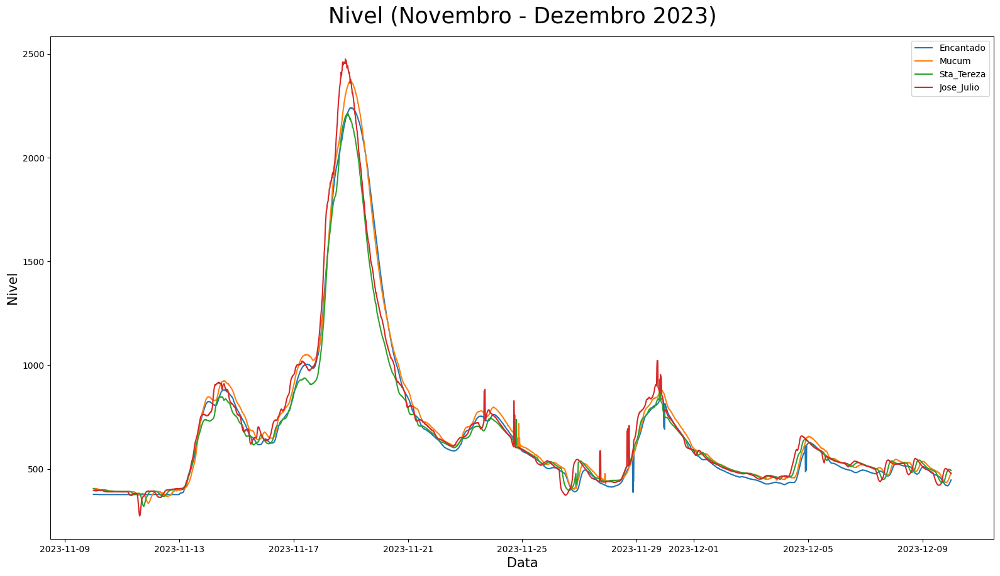

In [293]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (Novembro - Dezembro 2023)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

### Calcular nova correlação

In [294]:
niveis = [df_Encantado_mes['Nivel(cm)'],df_Mucum_mes['Nivel(cm)'],df_Sta_Tereza_mes['Nivel(cm)'],df_Jose_Julio_mes['Nivel(cm)']]
niveis = pd.concat(niveis, axis=1)
niveis.columns = ['Nivel_Encantado', 'Nivel_Mucum', 'Nivel_Sta_Tereza', 'Nivel_Jose_Julio']


correlacao_niveis = niveis.corr()


chuvas = [df_Encantado_mes['Chuva(mm)_Total_deslocada']]
chuvas = pd.concat(chuvas, axis=1)
chuvas.columns = ['Chuva_Total_deslocada']

correlacao_chuvas= chuvas.corr()

vazoes = [df_Encantado_mes['Vazao(m3/s)'],df_Mucum_mes['Vazao(m3/s)'],df_Jose_Julio_mes['Vazao(m3/s)']]
vazoes = pd.concat(vazoes, axis=1)
vazoes.columns = ['Vazao_Encantado', 'Vazao_Mucum', 'Vazao_Jose_Julio']

correlacao_vazoes = vazoes.corr()

correlacoes = [correlacao_niveis, correlacao_chuvas, correlacao_vazoes]
correlacoes = pd.concat(correlacoes, axis=1)

df_geral = [niveis, chuvas, vazoes]
df_geral = pd.concat(df_geral, axis=1)
df_geral

correlacao_geral = df_geral.corr()
correlacao_geral

,Nivel_Encantado,Nivel_Mucum,Nivel_Sta_Tereza,Nivel_Jose_Julio,Chuva_Total_deslocada,Vazao_Encantado,Vazao_Mucum,Vazao_Jose_Julio
Nivel_Encantado,1.000000,0.998494,0.993957,0.992364,0.417664,0.987389,0.992270,0.969421
Nivel_Mucum,0.998494,1.000000,0.997651,0.996368,0.428200,0.988076,0.994330,0.974772
Nivel_Sta_Tereza,0.993957,0.997651,1.000000,0.998644,0.438075,0.989691,0.995457,0.983047
Nivel_Jose_Julio,0.992364,0.996368,0.998644,1.000000,0.440468,0.987616,0.993664,0.982877
Chuva_Total_deslocada,0.417664,0.428200,0.438075,0.440468,1.000000,0.448124,0.444465,0.470216
Vazao_Encantado,0.987389,0.988076,0.989691,0.987616,0.448124,1.000000,0.998340,0.992633
Vazao_Mucum,0.992270,0.994330,0.995457,0.993664,0.444465,0.998340,1.000000,0.991148
Vazao_Jose_Julio,0.969421,0.974772,0.983047,0.982877,0.470216,0.992633,0.991148,1.000000


Criamos um gráfico que compara a correlação das vaiáveis Nível em relação ao Nível de Encantado.

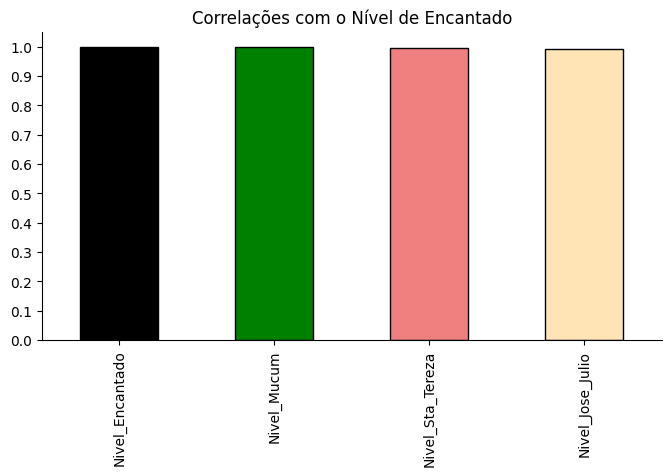

In [295]:
from matplotlib import pyplot as plt
correlacao_niveis['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = ['black','g','lightcoral','moccasin'], edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Criamos o heatmap, o gráfico da Matriz das Correlações, a fim de mais fácilmente visualizar a correlação entre variávies.

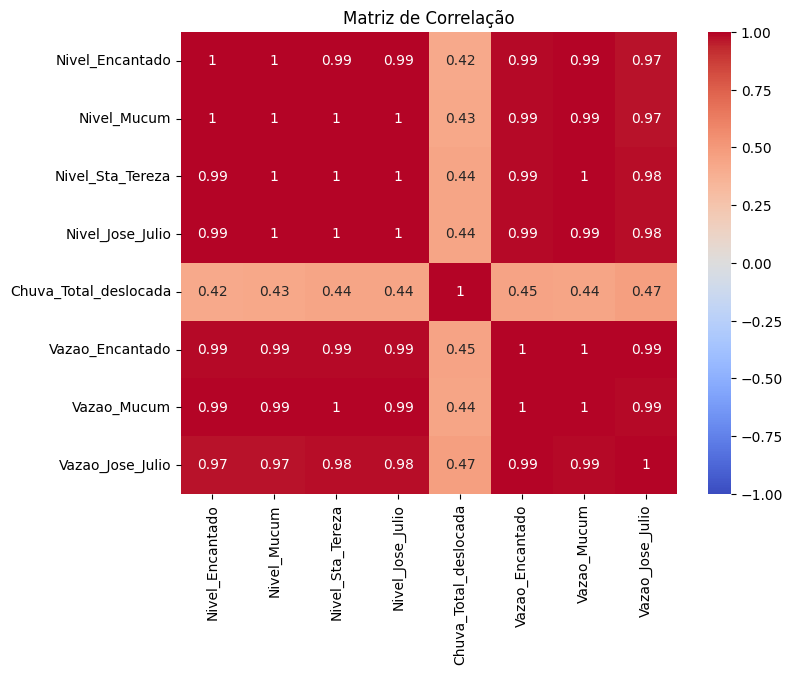

In [296]:
plt.figure(figsize=(8, 6))
sns.heatmap(correlacao_geral, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlação')
plt.show()

Mudamos a visualização dos dados para dar mais destaque da relação das variáveis com o Nível de Encantado, a cidade que buscamos prever o nível no projeto final. Escolhemos um formato de gráfico de barras para facilitar a visualização da correlação, com linhas que indicam a força da correlação.

## Transformando os dados na escala de log

Identificamos que os dados apresentavam uma distribuição longe da normal, e aplicando o logarítmio aos valores das variáveis, a distribuição dos dados passou a se assemelhar mais com a distribuição normal, o que ajuda na acurácia do modelo.

In [297]:
# Criar novo dataframe para log
df_geral_log = df_geral.copy()

df_geral_log['Nivel_Encantado'] = np.log(df_geral['Nivel_Encantado'])
df_geral_log['Nivel_Mucum'] = np.log(df_geral['Nivel_Mucum'])
df_geral_log['Nivel_Sta_Tereza'] = np.log(df_geral['Nivel_Sta_Tereza'])
df_geral_log['Nivel_Jose_Julio'] = np.log(df_geral['Nivel_Jose_Julio'])
df_geral_log['Chuva_Total_deslocada'] = np.log(df_geral['Chuva_Total_deslocada'] + 1)
df_geral_log['Vazao_Encantado'] = np.log(df_geral['Vazao_Encantado'])
df_geral_log['Vazao_Mucum'] = np.log(df_geral['Vazao_Mucum'])
df_geral_log['Vazao_Jose_Julio'] = np.log(df_geral['Vazao_Jose_Julio'])

# Adicionar 'LOG_' na frente de todos os nomes das colunas
df_geral_log.columns = ['LOG_' + col for col in df_geral_log.columns]

# Visualizar o DataFrame atualizado
df_geral_log.info()


<class 'pandas.core.frame.DataFrame'>
Index: 2897 entries, 36502 to 39398
Data columns (total 8 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   LOG_Nivel_Encantado        2881 non-null   float64
 1   LOG_Nivel_Mucum            2881 non-null   float64
 2   LOG_Nivel_Sta_Tereza       2881 non-null   float64
 3   LOG_Nivel_Jose_Julio       2881 non-null   float64
 4   LOG_Chuva_Total_deslocada  2881 non-null   float64
 5   LOG_Vazao_Encantado        2881 non-null   float64
 6   LOG_Vazao_Mucum            2881 non-null   float64
 7   LOG_Vazao_Jose_Julio       2881 non-null   float64
dtypes: float64(8)
memory usage: 268.2 KB


<Axes: >

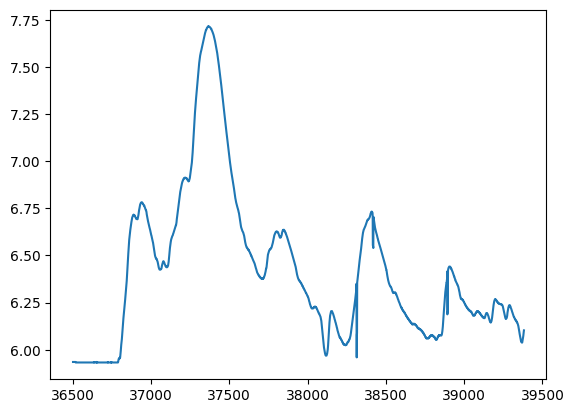

In [298]:
df_geral_log['LOG_Nivel_Encantado'].plot()


<Axes: >

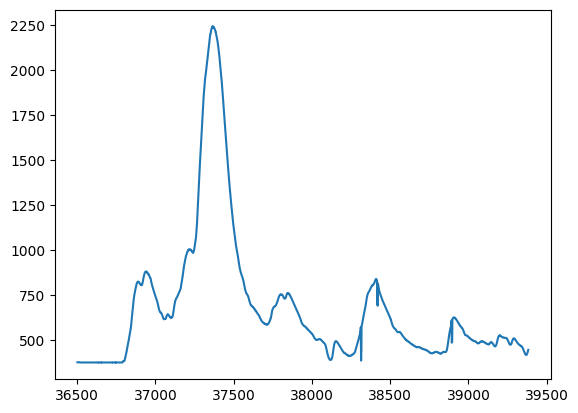

In [299]:
# Gráfico sem ap´licação de LOG para comparação
df_geral['Nivel_Encantado'].plot()

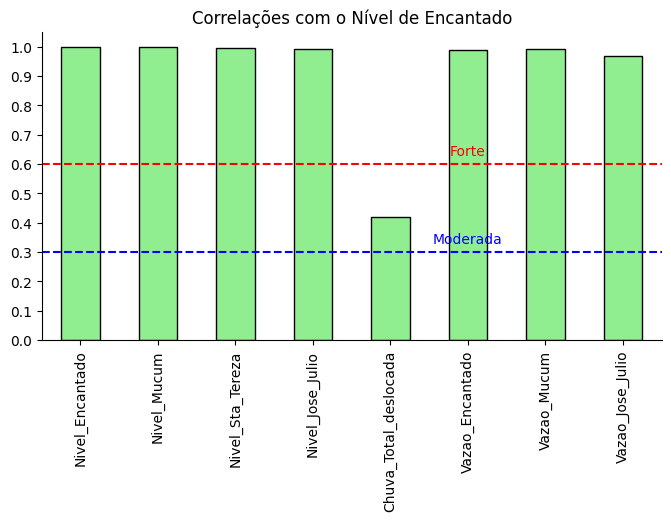

In [300]:
correlacao_geral['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = 'lightgreen', edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
# Adicionar linha horizontal
plt.axhline(y=0.6, color='r', linestyle='--')
plt.axhline(y=0.3, color='b', linestyle='--')
# Adicionar texto acima da linha
plt.text(5, 0.62, 'Forte', color='r', ha='center', va='bottom')
plt.text(5, 0.32, 'Moderada', color='b', ha='center', va='bottom')
plt.show()

### Histograma

Montamos histogramas das variáveis analisadas para entender a distribuição dos dados.

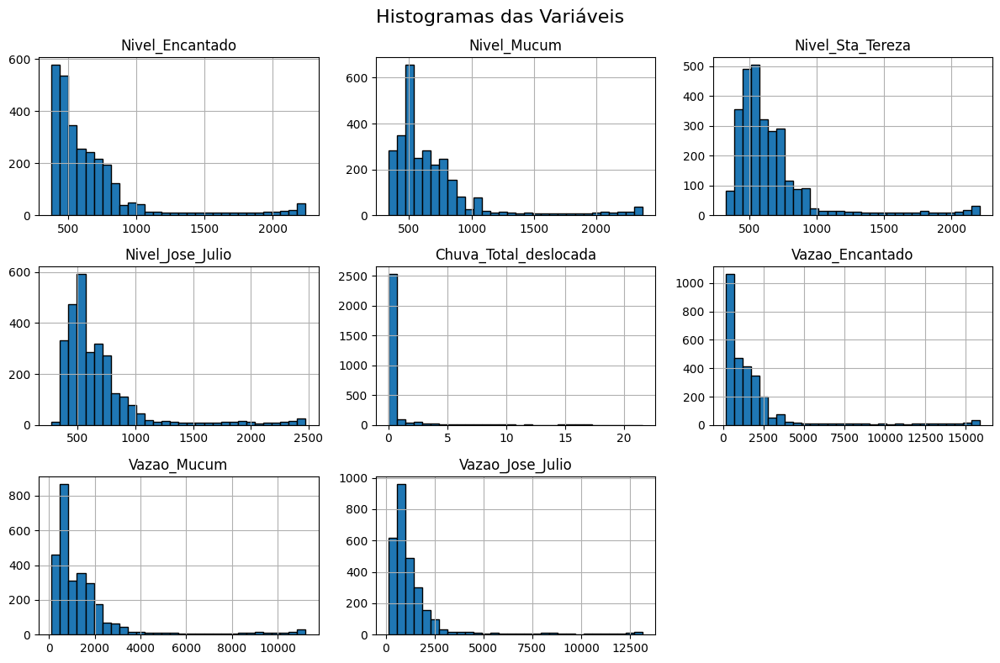

In [301]:
df_geral.hist(figsize=(12, 8), bins=30,edgecolor='black')
plt.suptitle('Histogramas das Variáveis', fontsize=16)
plt.tight_layout()
plt.show()

Histograma com aplicação de log - se aproxima da dist. Normal

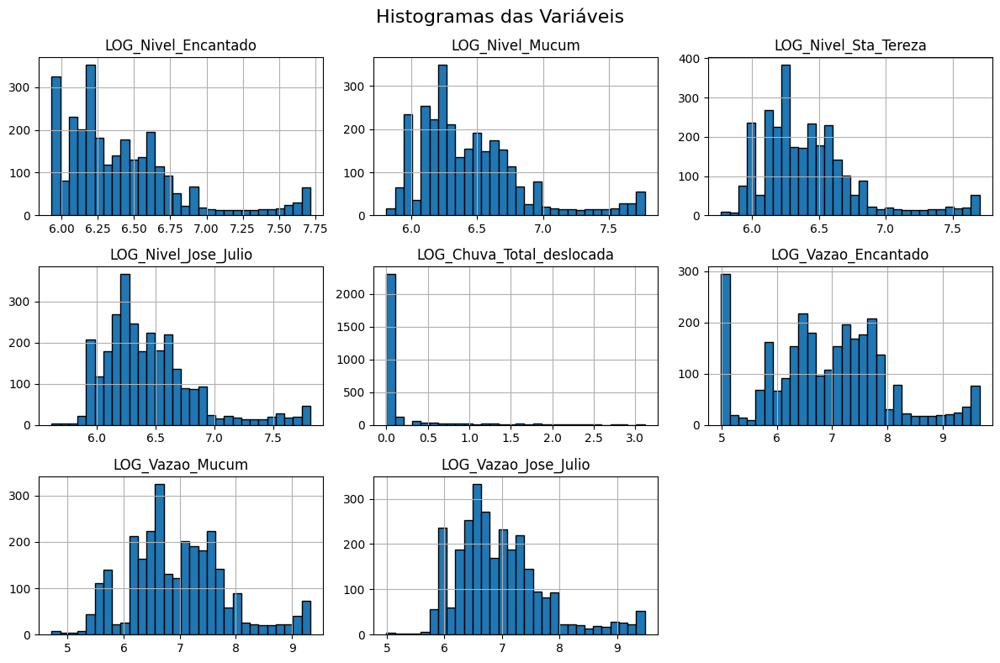

In [302]:
df_geral_log.hist(figsize=(12, 8), bins=30,edgecolor='black')
plt.suptitle('Histogramas das Variáveis', fontsize=16)
plt.tight_layout()
plt.show()

### Comparar distribuições

<ipython-input-303-fdac19560d85>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral.Nivel_Encantado, kde=True, ax=axes[0])
<ipython-input-303-fdac19560d85>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral_log.LOG_Nivel_Encantado, kde=True, ax=axes[1])


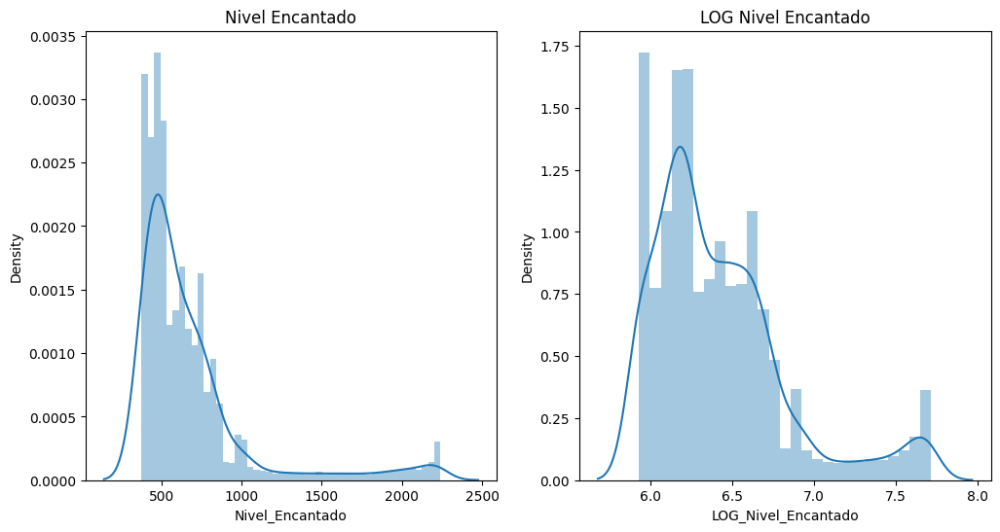

In [303]:
# Encantado Nível

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico do primeiro conjunto de dados
sns.distplot(df_geral.Nivel_Encantado, kde=True, ax=axes[0])
axes[0].set_title('Nivel Encantado')

# Gráfico do segundo conjunto de dados
sns.distplot(df_geral_log.LOG_Nivel_Encantado, kde=True, ax=axes[1])
axes[1].set_title('LOG Nivel Encantado')

# Exibe os gráficos
plt.show()

<ipython-input-304-5de809935be9>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral.Nivel_Mucum, kde=True, ax=axes[0])
<ipython-input-304-5de809935be9>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral_log.LOG_Nivel_Mucum, kde=True, ax=axes[1])


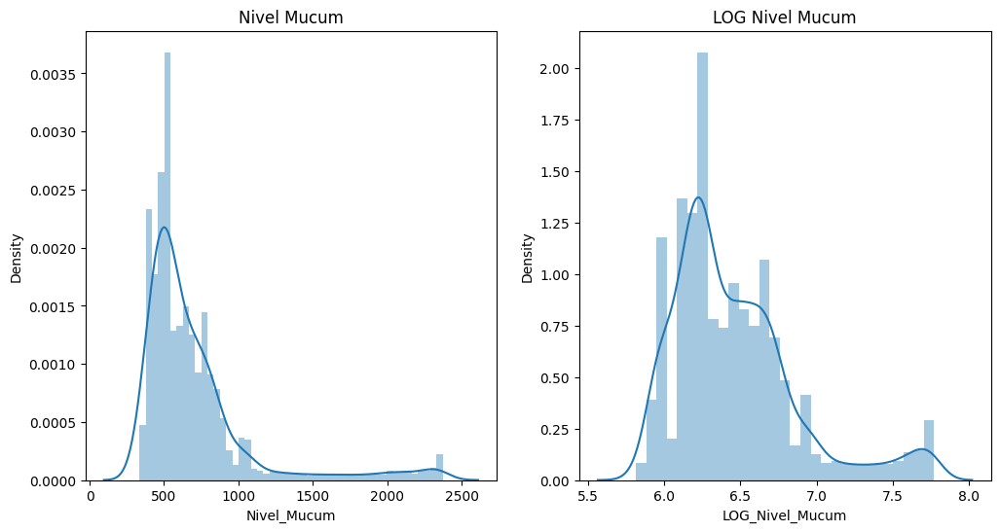

In [304]:
# Muçum  Nível

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico do primeiro conjunto de dados
sns.distplot(df_geral.Nivel_Mucum, kde=True, ax=axes[0])
axes[0].set_title('Nivel Mucum')

# Gráfico do segundo conjunto de dados
sns.distplot(df_geral_log.LOG_Nivel_Mucum, kde=True, ax=axes[1])
axes[1].set_title('LOG Nivel Mucum')

# Exibe os gráficos
plt.show()

<ipython-input-305-b4f502741142>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral.Nivel_Jose_Julio, kde=True, ax=axes[0])
<ipython-input-305-b4f502741142>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral_log.LOG_Nivel_Jose_Julio, kde=True, ax=axes[1])


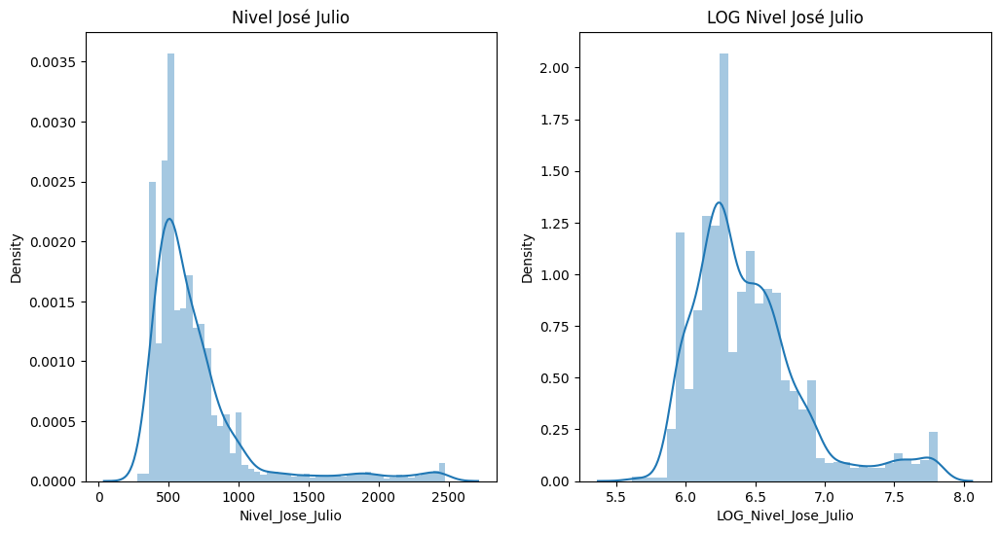

In [305]:
# Jose Julio  Nível

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico do primeiro conjunto de dados
sns.distplot(df_geral.Nivel_Jose_Julio, kde=True, ax=axes[0])
axes[0].set_title('Nivel José Julio')

# Gráfico do segundo conjunto de dados
sns.distplot(df_geral_log.LOG_Nivel_Jose_Julio, kde=True, ax=axes[1])
axes[1].set_title('LOG Nivel José Julio')

# Exibe os gráficos
plt.show()

<ipython-input-306-9b74506a9ca3>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral.Nivel_Sta_Tereza, kde=True, ax=axes[0])
<ipython-input-306-9b74506a9ca3>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral_log.LOG_Nivel_Sta_Tereza, kde=True, ax=axes[1])


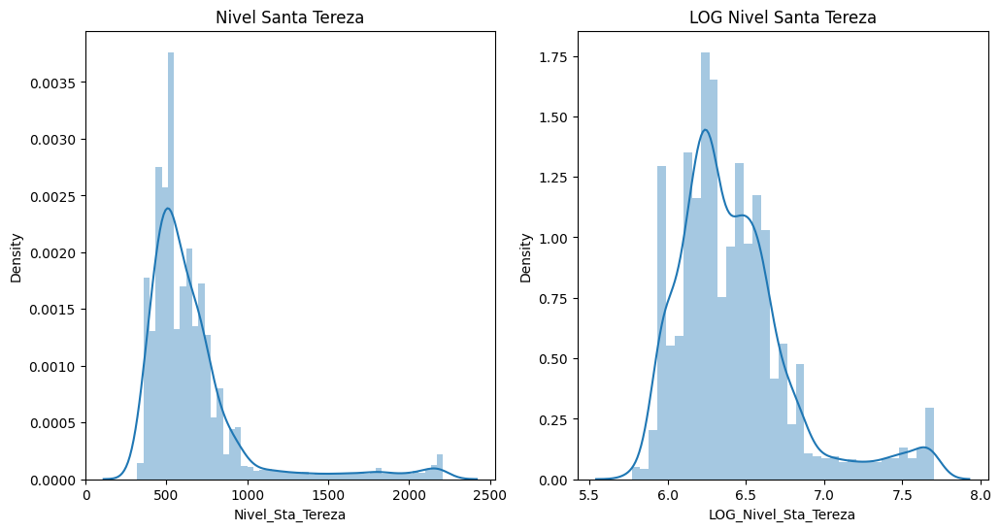

In [306]:
# Santa Tereza Nível

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico do primeiro conjunto de dados
sns.distplot(df_geral.Nivel_Sta_Tereza, kde=True, ax=axes[0])
axes[0].set_title('Nivel Santa Tereza')

# Gráfico do segundo conjunto de dados
sns.distplot(df_geral_log.LOG_Nivel_Sta_Tereza, kde=True, ax=axes[1])
axes[1].set_title('LOG Nivel Santa Tereza')

# Exibe os gráficos
plt.show()

<ipython-input-307-490396816476>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral.Vazao_Encantado, kde=True, ax=axes[0])
<ipython-input-307-490396816476>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral_log.LOG_Vazao_Encantado, kde=True, ax=axes[1])


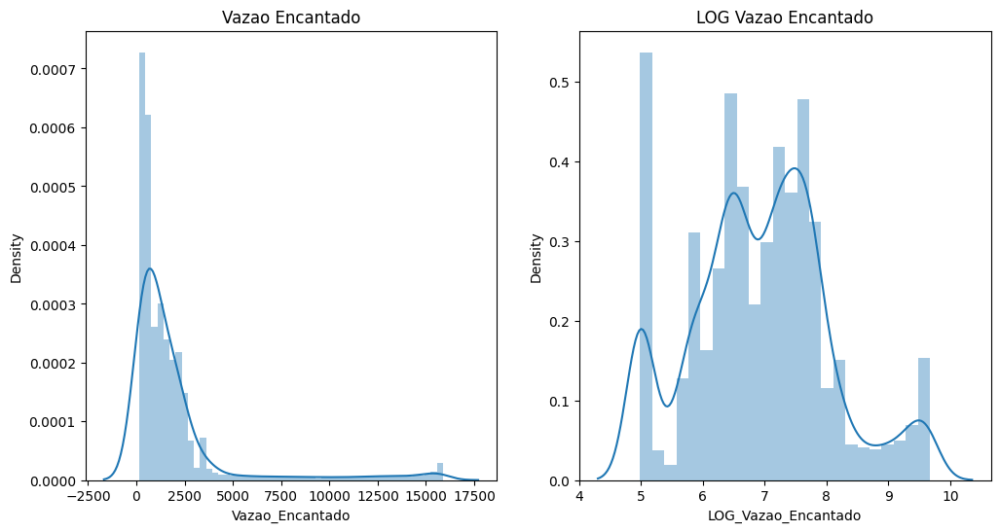

In [307]:
# Encantado Vazão

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico do primeiro conjunto de dados
sns.distplot(df_geral.Vazao_Encantado, kde=True, ax=axes[0])
axes[0].set_title('Vazao Encantado')

# Gráfico do segundo conjunto de dados
sns.distplot(df_geral_log.LOG_Vazao_Encantado, kde=True, ax=axes[1])
axes[1].set_title('LOG Vazao Encantado')

# Exibe os gráficos
plt.show()

<ipython-input-308-2ecd68dd04bc>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral.Vazao_Mucum, kde=True, ax=axes[0])
<ipython-input-308-2ecd68dd04bc>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral_log.LOG_Vazao_Mucum, kde=True, ax=axes[1])


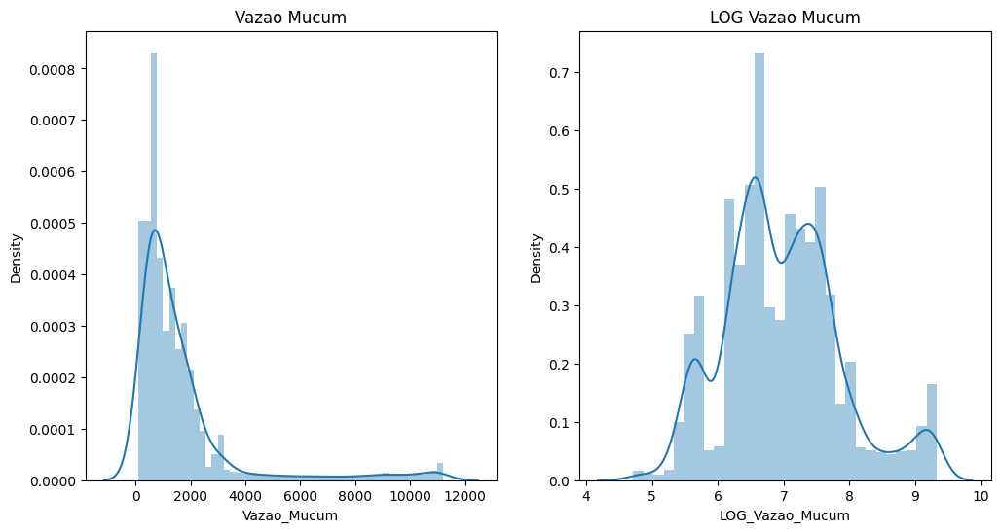

In [308]:
# Muçum Vazão

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico do primeiro conjunto de dados
sns.distplot(df_geral.Vazao_Mucum, kde=True, ax=axes[0])
axes[0].set_title('Vazao Mucum')

# Gráfico do segundo conjunto de dados
sns.distplot(df_geral_log.LOG_Vazao_Mucum, kde=True, ax=axes[1])
axes[1].set_title('LOG Vazao Mucum')

# Exibe os gráficos
plt.show()

<ipython-input-309-c13ba932c97a>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral.Vazao_Jose_Julio, kde=True, ax=axes[0])
<ipython-input-309-c13ba932c97a>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral_log.LOG_Vazao_Jose_Julio, kde=True, ax=axes[1])


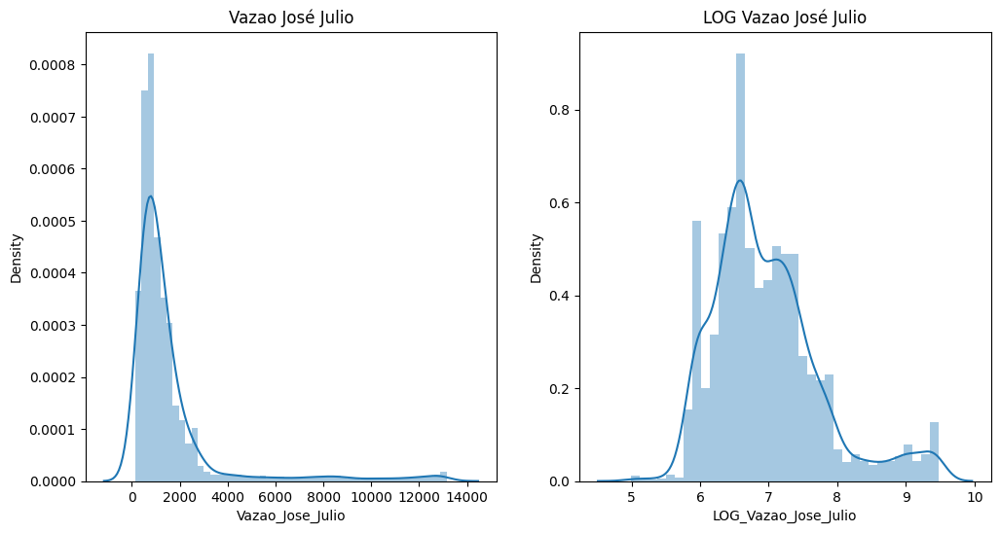

In [309]:
# Jose Julio Vazão

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico do primeiro conjunto de dados
sns.distplot(df_geral.Vazao_Jose_Julio, kde=True, ax=axes[0])
axes[0].set_title('Vazao José Julio')

# Gráfico do segundo conjunto de dados
sns.distplot(df_geral_log.LOG_Vazao_Jose_Julio, kde=True, ax=axes[1])
axes[1].set_title('LOG Vazao José Julio')

# Exibe os gráficos
plt.show()

<ipython-input-310-ed12c027bf43>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral.Chuva_Total_deslocada, kde=True, ax=axes[0])
<ipython-input-310-ed12c027bf43>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_geral_log.LOG_Chuva_Total_deslocada, kde=True, ax=axes[1])


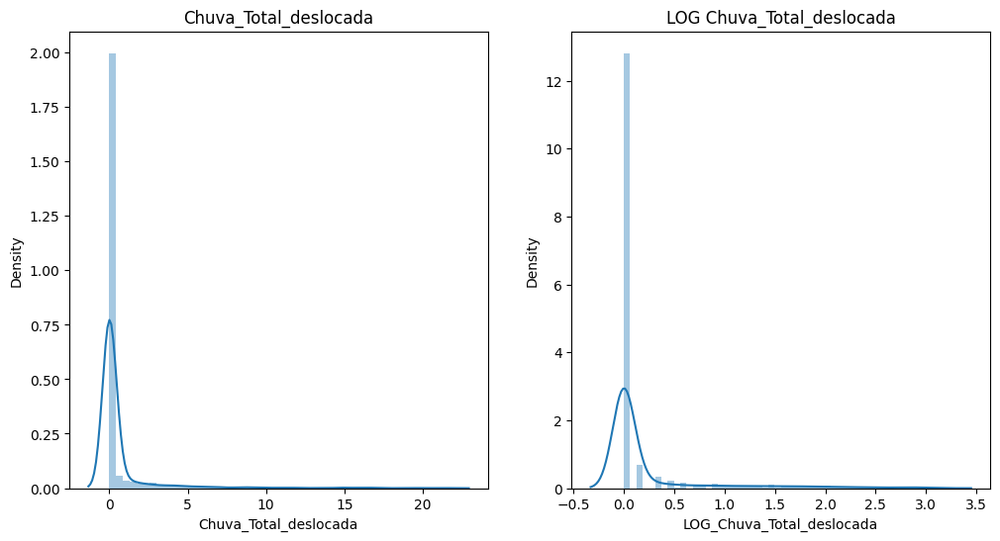

In [310]:
# Chuva Total Deslocada

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico do primeiro conjunto de dados
sns.distplot(df_geral.Chuva_Total_deslocada, kde=True, ax=axes[0])
axes[0].set_title('Chuva_Total_deslocada')

# Gráfico do segundo conjunto de dados
sns.distplot(df_geral_log.LOG_Chuva_Total_deslocada, kde=True, ax=axes[1])
axes[1].set_title('LOG Chuva_Total_deslocada')

# Exibe os gráficos
plt.show()


## Definir previsão do Nível Futuro de Encantado

In [1640]:
# Criar variável de nível futuro de Encantado

# Alterar para definir quantas horas de previsão são desejadas
n_horas_futuras = 3

# Cálculo dos 15 mins
calculo_minutos = int((n_horas_futuras * 60) / 15)

# Criação do df
df_Encantado_futuro = [df_Encantado_unico['Data/Hora'], df_Encantado_unico['Nivel(cm)']]
df_Encantado_futuro = pd.concat(df_Encantado_futuro, axis=1)

df_Encantado_futuro['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'].shift(-calculo_minutos)


# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Encantado_futuro_mes = df_Encantado_futuro[(df_Encantado_futuro['Data/Hora'] >= data_inicio) & (df_Encantado_futuro['Data/Hora'] <= data_fim)]


In [1641]:
calculo_minutos

12

In [1642]:
df_Encantado_futuro_mes

,Data/Hora,Nivel(cm)
36502,2023-11-10 00:00:00,378.0
36503,2023-11-10 00:15:00,378.0
36504,2023-11-10 00:30:00,378.0
36505,2023-11-10 00:45:00,378.0
36506,2023-11-10 01:00:00,378.0
...,...,...
39378,2023-12-09 23:00:00,461.0
39379,2023-12-09 23:15:00,461.0
39380,2023-12-09 23:30:00,461.0
39381,2023-12-09 23:45:00,461.0


In [1643]:
df_Encantado_mes

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s),Chuva(mm)_Total,Chuva(mm)_Total_deslocada
36502,2023-11-10 00:00:00,0.0,378.0,149.1,0.0,0.0
36503,2023-11-10 00:15:00,0.0,378.0,149.1,0.0,0.0
36504,2023-11-10 00:30:00,0.0,378.0,149.1,0.0,0.0
36505,2023-11-10 00:45:00,0.0,378.0,149.1,0.0,0.0
36506,2023-11-10 01:00:00,0.0,378.0,149.1,0.0,1.4
...,...,...,...,...,...,...
39378,2023-12-09 23:00:00,0.0,434.0,358.6,0.0,0.0
39379,2023-12-09 23:15:00,0.0,438.0,376.4,0.0,0.0
39380,2023-12-09 23:30:00,0.0,440.0,385.5,0.0,0.0
39381,2023-12-09 23:45:00,0.0,444.0,403.9,0.0,0.0


In [1644]:
df_Encantado_futuro_comparativo = [df_Encantado_mes['Data/Hora'], df_Encantado_mes['Nivel(cm)'], df_Encantado_futuro_mes['Nivel(cm)']]
df_Encantado_futuro_comparativo = pd.concat(df_Encantado_futuro_comparativo, axis=1)
df_Encantado_futuro_comparativo.columns = ['Data/Hora', 'Nivel_Encantado_Atual', 'Nivel_Encantado_Futuro']
df_Encantado_futuro_comparativo = df_Encantado_futuro_comparativo[(df_Encantado_futuro_comparativo['Data/Hora'] >= '2023-11-10') & (df_Encantado_futuro_comparativo['Data/Hora'] <= '2023-11-20')]
df_Encantado_futuro_comparativo


,Data/Hora,Nivel_Encantado_Atual,Nivel_Encantado_Futuro
36502,2023-11-10 00:00:00,378.0,378.0
36503,2023-11-10 00:15:00,378.0,378.0
36504,2023-11-10 00:30:00,378.0,378.0
36505,2023-11-10 00:45:00,378.0,378.0
36506,2023-11-10 01:00:00,378.0,378.0
...,...,...,...
37458,2023-11-19 23:00:00,1534.0,1397.0
37459,2023-11-19 23:15:00,1522.0,1386.0
37460,2023-11-19 23:30:00,1511.0,1376.0
37461,2023-11-19 23:45:00,1500.0,1366.0


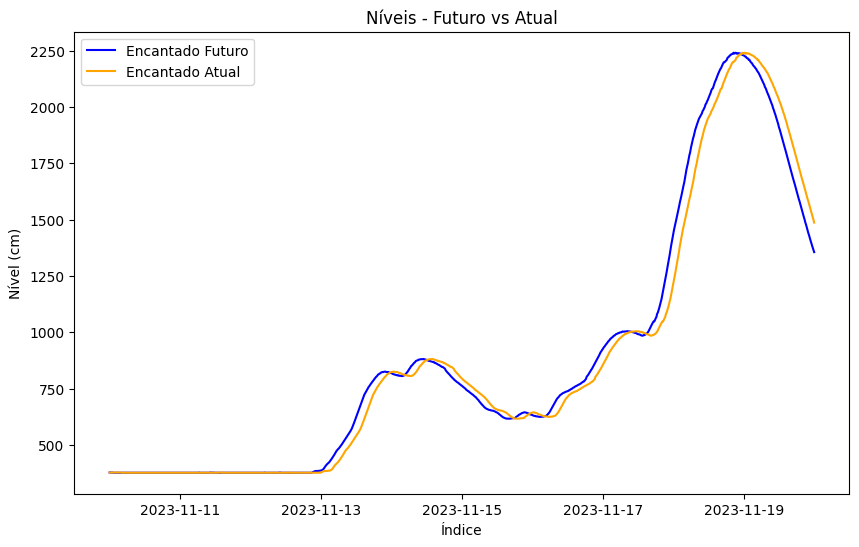

In [1645]:
# Criar a figura
plt.figure(figsize=(10, 6))

# Plotar a primeira série
plt.plot(df_Encantado_futuro_comparativo['Data/Hora'], df_Encantado_futuro_comparativo['Nivel_Encantado_Futuro'], label='Encantado Futuro', color='blue')

# Plotar a segunda série
plt.plot(df_Encantado_futuro_comparativo['Data/Hora'], df_Encantado_futuro_comparativo['Nivel_Encantado_Atual'], label='Encantado Atual', color='orange')

# Adicionar título, legendas e rótulos aos eixos
plt.title('Níveis - Futuro vs Atual')
plt.xlabel('Índice')
plt.ylabel('Nível (cm)')
plt.legend()

# Exibir o gráfico
plt.show()

In [1646]:
# Selecionando as colunas específicas de cada DataFrame
df1_selecionado = df_Encantado_futuro_mes[['Data/Hora', 'Nivel(cm)']].rename(columns={'Nivel(cm)': 'nivel_Encantado_futuro'})
df2_selecionado = df_Jose_Julio_mes[['Data/Hora', 'Nivel(cm)']].rename(columns={'Nivel(cm)': 'nivel_Jose_Julio'})
df3_selecionado = df_Jose_Julio_mes[['Data/Hora', 'Vazao(m3/s)']].rename(columns={'Vazao(m3/s)': 'vazao_Jose_Julio'})
df4_selecionado = df_Encantado_mes[['Data/Hora', 'Chuva(mm)_Total']].rename(columns={'Chuva(mm)_Total': 'chuva_total'})

# Realizando os merges em etapas
df_final = pd.merge(df1_selecionado, df2_selecionado, on='Data/Hora', how='outer')
df_final = pd.merge(df_final, df3_selecionado, on='Data/Hora', how='outer')
df_final = pd.merge(df_final, df4_selecionado, on='Data/Hora', how='outer')

# Visualizando o resultado
print(df_final)

               Data/Hora  nivel_Encantado_futuro  nivel_Jose_Julio  \
0    2023-11-10 00:00:00                   378.0             397.0   
1    2023-11-10 00:15:00                   378.0             397.0   
2    2023-11-10 00:30:00                   378.0             396.0   
3    2023-11-10 00:45:00                   378.0             396.0   
4    2023-11-10 01:00:00                   378.0             396.0   
...                  ...                     ...               ...   
2876 2023-12-09 23:00:00                   461.0             485.0   
2877 2023-12-09 23:15:00                   461.0             483.0   
2878 2023-12-09 23:30:00                   461.0             481.0   
2879 2023-12-09 23:45:00                   461.0             480.0   
2880 2023-12-10 00:00:00                   461.0             478.0   

      vazao_Jose_Julio  chuva_total  
0                403.7          0.0  
1                403.7          0.0  
2                401.3          0.0  
3      

In [1647]:
# Criar uma cópia do DataFrame para armazenar os valores logaritmados
df_final_log = df_final.copy()

# Calculando o logaritmo para as colunas desejadas
df_final_log['nivel_Encantado_futuro'] = np.log(df_final['nivel_Encantado_futuro'])
df_final_log['nivel_Jose_Julio'] = np.log(df_final['nivel_Jose_Julio'])
df_final_log['vazao_Jose_Julio'] = np.log(df_final['vazao_Jose_Julio'])
df_final_log['chuva_total'] = np.log(df_final['chuva_total'] + 1)  # Adicionando 1 para evitar log(0)

# Adicionar 'LOG_' no início dos nomes das colunas
df_final_log.columns = ['LOG_' + col if col not in ['Data/Hora'] else col for col in df_final_log.columns]

# Visualizar o resultado
print(df_final_log)


               Data/Hora  LOG_nivel_Encantado_futuro  LOG_nivel_Jose_Julio  \
0    2023-11-10 00:00:00                    5.934894              5.983936   
1    2023-11-10 00:15:00                    5.934894              5.983936   
2    2023-11-10 00:30:00                    5.934894              5.981414   
3    2023-11-10 00:45:00                    5.934894              5.981414   
4    2023-11-10 01:00:00                    5.934894              5.981414   
...                  ...                         ...                   ...   
2876 2023-12-09 23:00:00                    6.133398              6.184149   
2877 2023-12-09 23:15:00                    6.133398              6.180017   
2878 2023-12-09 23:30:00                    6.133398              6.175867   
2879 2023-12-09 23:45:00                    6.133398              6.173786   
2880 2023-12-10 00:00:00                    6.133398              6.169611   

      LOG_vazao_Jose_Julio  LOG_chuva_total  
0                

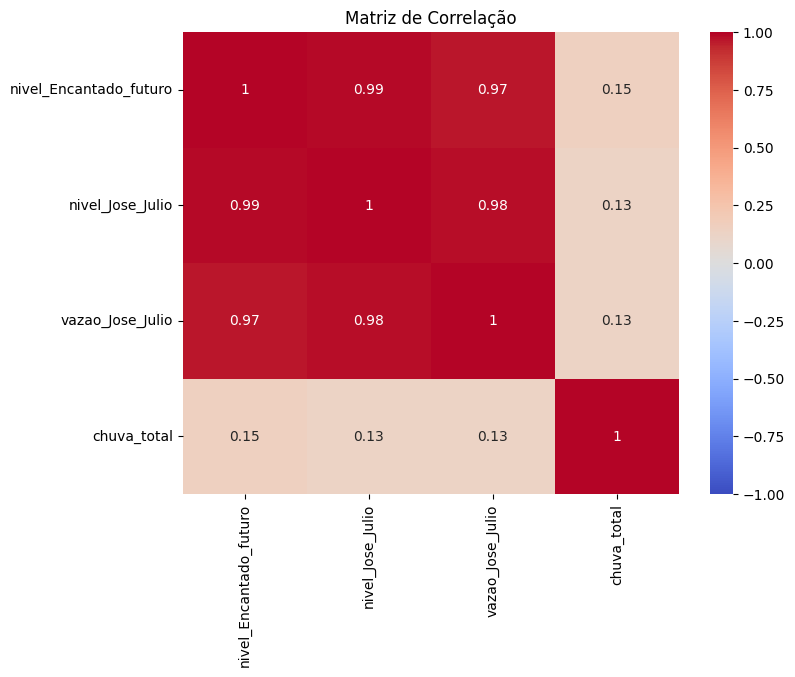

In [1648]:
df_total_sem_data = df_final.drop('Data/Hora', axis=1)
correlacao_total = df_total_sem_data.corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlacao_total, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlação')
plt.show()

## Modelo

In [1649]:
from sklearn.model_selection import train_test_split

In [1650]:
# Criando um df para armazenar as variáveis explicativas

X = df_final_log[['LOG_nivel_Jose_Julio', 'LOG_vazao_Jose_Julio', 'LOG_chuva_total']]

# Criando uma series para armazenar a variavel dependete
y = df_final_log['LOG_nivel_Encantado_futuro']

In [1651]:
# Criando os datasets de treino e de teste

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=305)


In [1652]:
import statsmodels.api as sm

### Modelo preliminar para verificar a significancia dos parametros e outros indicadores

In [1653]:
# Adicionar constante para o modelo "preencher"

X_train_constante = sm.add_constant(X_train)
X_train_constante

,const,LOG_nivel_Jose_Julio,LOG_vazao_Jose_Julio,LOG_chuva_total
1355,1.0,6.603944,7.312153,0.000000
375,1.0,6.634633,7.371615,0.000000
2448,1.0,6.329721,6.761920,0.000000
2148,1.0,6.192362,6.470645,0.000000
2023,1.0,6.336826,6.776621,0.000000
...,...,...,...,...
1022,1.0,6.824374,7.732150,0.000000
606,1.0,6.593045,7.290907,0.000000
1833,1.0,6.647688,7.396826,0.000000
2295,1.0,6.115892,6.302619,0.875469


In [1654]:
modelo_statsmodels = sm.OLS(y_train, X_train_constante, hasconst = True).fit()

In [1655]:
print(modelo_statsmodels.summary())

                                OLS Regression Results                                
Dep. Variable:     LOG_nivel_Encantado_futuro   R-squared:                       0.981
Model:                                    OLS   Adj. R-squared:                  0.981
Method:                         Least Squares   F-statistic:                 3.865e+04
Date:                        Fri, 13 Dec 2024   Prob (F-statistic):               0.00
Time:                                01:58:16   Log-Likelihood:                 3309.1
No. Observations:                        2304   AIC:                            -6610.
Df Residuals:                            2300   BIC:                            -6587.
Df Model:                                   3                                         
Covariance Type:                    nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

### Modelo com dados de treino e teste

In [1656]:
from sklearn.linear_model import LinearRegression
from sklearn import metrics

Estimar o modelo linear utilizando os dados de Treino

In [1657]:
modelo = LinearRegression()

In [1658]:
modelo.fit(X_train, y_train)

LinearRegression()

Obtendo o R²



In [1659]:
r_quadrado = modelo.score(X_train, y_train)
r_quadrado

0.9805509866674702

Gerando previsões para os dados de teste

In [1660]:
y_previsto = modelo.predict(X_test)

Obtendo o R² para as previsões do modelo

In [1661]:
r_quadrado_prev = metrics.r2_score(np.exp(y_test), np.exp(y_previsto))
r_quadrado_prev

0.984029154819464

Gráfico de dispersão entre os dados previstos pelo modelo e os dados de teste

<Axes: title={'center': 'Previsão X Real'}, xlabel='LOG_nivel_Encantado_futuro - Real', ylabel='LOG_nivel_Encantado_futuro - Previsão'>

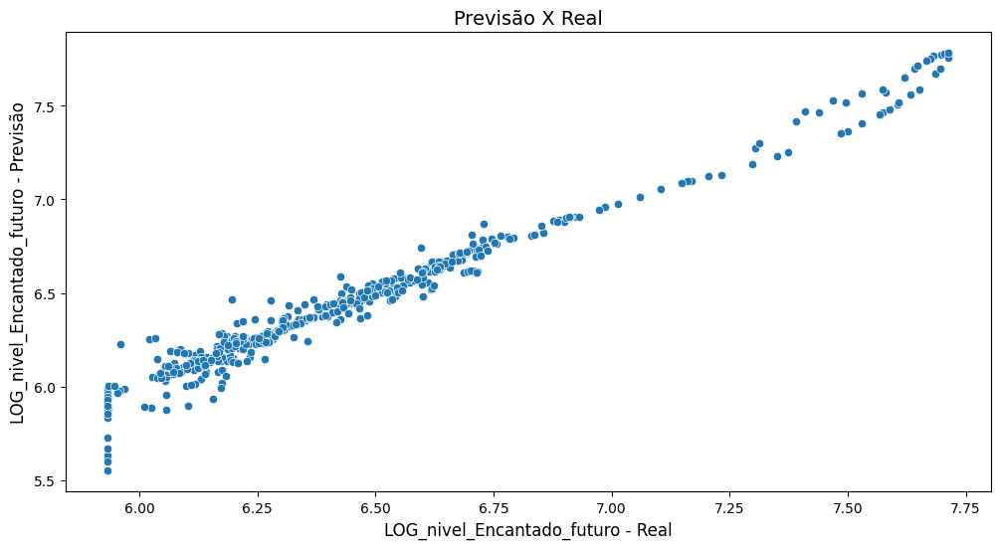

In [1662]:
ax = sns.scatterplot(x=y_test, y=y_previsto)
ax.figure.set_size_inches(12, 6)
ax.set_title('Previsão X Real', fontsize=14)
ax.set_xlabel('LOG_nivel_Encantado_futuro - Real', fontsize=12)
ax.set_ylabel('LOG_nivel_Encantado_futuro - Previsão', fontsize=12)
ax

Obtendo os parametros do modelo

In [1663]:
#Intercepto do modelo
intercepto = modelo.intercept_
intercepto

0.6107841848945936

In [1664]:
# Tirando de log
intercepto_semlog = np.exp(modelo.intercept_)
intercepto_semlog

1.8418752033149624

In [1665]:
# Coeficientes

coeficientes = modelo.coef_
coeficientes

array([0.76156048, 0.12886743, 0.0197639 ])

In [1666]:
colunas_parametros = ['Intercepto', 'LOG_nivel_Jose_Julio', 'LOG_vazao_Jose_Julio', 'LOG_chuva_total']

In [1667]:
parametros_df = pd.DataFrame(data=np.append(intercepto, coeficientes), index=colunas_parametros, columns=['Parâmetros'])
parametros_df

,Parâmetros
Intercepto,0.610784
LOG_nivel_Jose_Julio,0.761560
LOG_vazao_Jose_Julio,0.128867
LOG_chuva_total,0.019764


Calculando resíduos

In [1668]:
residuo = y_test - y_previsto
residuo

,LOG_nivel_Encantado_futuro
2831,0.095910
686,-0.000278
1650,-0.003643
2494,-0.017312
2160,-0.016388
...,...
1637,-0.037492
1640,-0.027671
816,-0.031577
782,-0.061320


In [1669]:
media_residuo = np.mean(residuo)
media_residuo

-0.0008863275332447627

<ipython-input-1670-99b36c7d5900>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(residuo)


<Axes: title={'center': 'Distribuição dos Resíduos'}, xlabel='LOG_nivel_Encantado_futuro', ylabel='Density'>

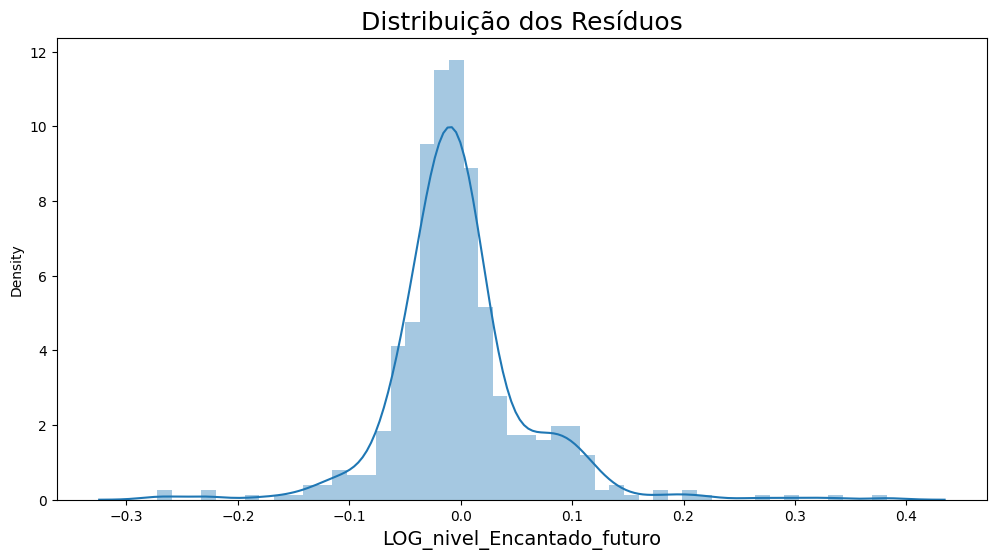

In [1670]:
ax = sns.distplot(residuo)
ax.figure.set_size_inches(12, 6)
ax.set_title('Distribuição dos Resíduos', fontsize=18)
ax.set_xlabel('LOG_nivel_Encantado_futuro', fontsize=14)
ax

Calculando erro absoluto médio

In [1671]:
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error

# Transformando os valores para a escala original
y_test_original = np.exp(y_test)
y_previsto_original = np.exp(y_previsto)

# Calculando MAE e MAPE na escala original
mae = mean_absolute_error(y_test_original, y_previsto_original)
mape = mean_absolute_percentage_error(y_test_original, y_previsto_original)*100

print(f"MAE (em cm): {mae:.4f}")
print(f"MAPE (em %): {mape:.4f}")

MAE (em cm): 28.3870
MAPE (em %): 4.0376


##Gráficos das previsões

In [1672]:
entrada_mes = df_final_log[['LOG_nivel_Jose_Julio', 'LOG_vazao_Jose_Julio', 'LOG_chuva_total']]
entrada_mes

,LOG_nivel_Jose_Julio,LOG_vazao_Jose_Julio,LOG_chuva_total
0,5.983936,6.000672,0.0
1,5.983936,6.000672,0.0
2,5.981414,5.994709,0.0
3,5.981414,5.994709,0.0
4,5.981414,5.994709,0.0
...,...,...,...
2876,6.184149,6.452837,0.0
2877,6.180017,6.443813,0.0
2878,6.175867,6.434707,0.0
2879,6.173786,6.430203,0.0


In [1673]:
y_previsto_mes = modelo.predict(entrada_mes)
y_previsto_mes

array([5.94120477, 5.94120477, 5.93851566, ..., 6.1433048 , 6.14113948,
       6.136791  ])

In [1674]:
#Definição dos níveis de aviso

atencao = 500
alerta = 900
inundacao = 1200

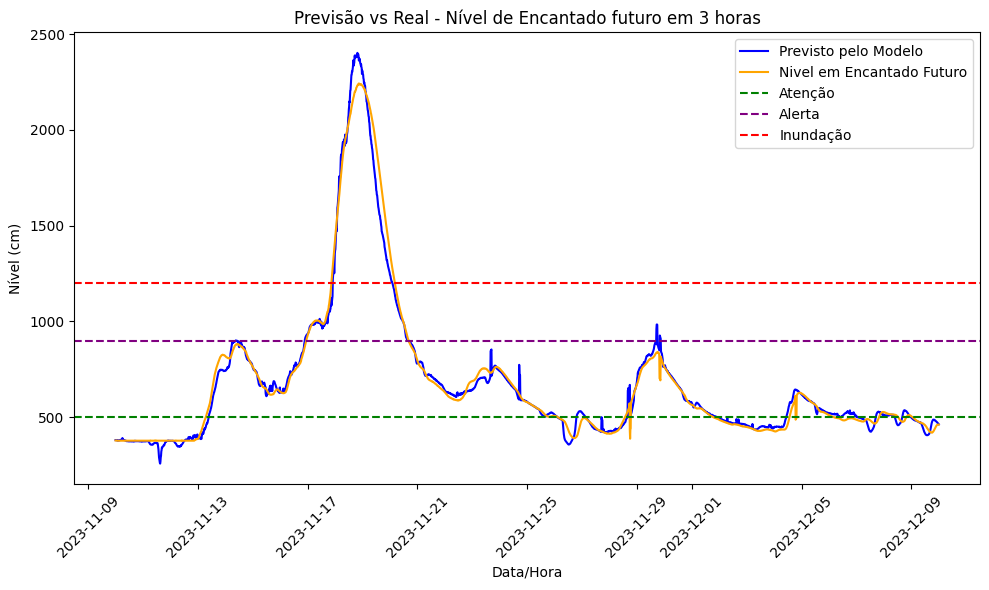

In [1675]:
df_final_log['Data/Hora'] = pd.to_datetime(df_final_log['Data/Hora'])

plt.figure(figsize=(10, 6))
plt.plot(df_final_log['Data/Hora'], np.exp(y_previsto_mes), label='Previsto pelo Modelo', color='blue')
plt.plot(df_final_log['Data/Hora'], np.exp(df_final_log['LOG_nivel_Encantado_futuro']), label='Nivel em Encantado Futuro', color='orange')

plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

plt.title(f'Previsão vs Real - Nível de Encantado futuro em {n_horas_futuras} horas')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

In [1676]:
# Calculando R² das previsões

r_quadrado_prev_mes = metrics.r2_score(np.exp(df_final_log['LOG_nivel_Encantado_futuro']), np.exp(y_previsto_mes))
r_quadrado_prev_mes

0.9847941335566434

In [1677]:
# Selecionando as colunas específicas de cada DataFrame
df21_selecionado = df_Encantado_futuro[['Data/Hora', 'Nivel(cm)']].rename(columns={'Nivel(cm)': 'nivel_Encantado_futuro'})
df22_selecionado = df_Jose_Julio_unico[['Data/Hora', 'Nivel(cm)']].rename(columns={'Nivel(cm)': 'nivel_Jose_Julio'})
df23_selecionado = df_Jose_Julio_unico[['Data/Hora', 'Vazao(m3/s)']].rename(columns={'Vazao(m3/s)': 'vazao_Jose_Julio'})
df24_selecionado = df_Encantado_unico[['Data/Hora', 'Chuva(mm)_Total']].rename(columns={'Chuva(mm)_Total': 'chuva_total'})

# Realizando os merges em etapas
df_all = pd.merge(df21_selecionado, df22_selecionado, on='Data/Hora', how='outer')
df_all = pd.merge(df_all, df23_selecionado, on='Data/Hora', how='outer')
df_all = pd.merge(df_all, df24_selecionado, on='Data/Hora', how='outer')

# Visualizando o resultado
print(df_all)

                Data/Hora  nivel_Encantado_futuro  nivel_Jose_Julio  \
0     2022-10-22 15:15:00                     NaN             435.5   
1     2022-10-22 15:30:00                     NaN             435.5   
2     2022-10-22 15:45:00                     NaN             435.0   
3     2022-10-22 16:00:00                     NaN             436.0   
4     2022-10-22 16:15:00                     NaN             437.0   
...                   ...                     ...               ...   
69989 2024-10-23 15:30:00                     NaN               NaN   
69990 2024-10-23 15:45:00                     NaN               NaN   
69991 2024-10-23 16:00:00                     NaN               NaN   
69992 2024-10-23 16:15:00                     NaN               NaN   
69993 2024-10-23 16:30:00                     NaN               NaN   

       vazao_Jose_Julio  chuva_total  
0                 131.8          NaN  
1                 131.1          NaN  
2                 128.7       

In [1678]:
# Criar uma cópia do DataFrame para armazenar os valores logaritmados
df_all_log = df_all.copy()

# Calculando o logaritmo para as colunas desejadas
df_all_log['nivel_Encantado_futuro'] = np.log(df_all['nivel_Encantado_futuro']).fillna(0)
df_all_log['nivel_Jose_Julio'] = np.log(df_all['nivel_Jose_Julio']).fillna(0)
df_all_log['vazao_Jose_Julio'] = np.log(df_all['vazao_Jose_Julio']).fillna(0)
df_all_log['chuva_total'] = np.log(df_all['chuva_total'] + 1).fillna(0)  # Adicionando 1 para evitar log(0)

# Adicionar 'LOG_' no início dos nomes das colunas
df_all_log.columns = ['LOG_' + col if col not in ['Data/Hora'] else col for col in df_all_log.columns]

# Visualizar o resultado
print(df_all_log)


                Data/Hora  LOG_nivel_Encantado_futuro  LOG_nivel_Jose_Julio  \
0     2022-10-22 15:15:00                         0.0              6.076495   
1     2022-10-22 15:30:00                         0.0              6.076495   
2     2022-10-22 15:45:00                         0.0              6.075346   
3     2022-10-22 16:00:00                         0.0              6.077642   
4     2022-10-22 16:15:00                         0.0              6.079933   
...                   ...                         ...                   ...   
69989 2024-10-23 15:30:00                         0.0              0.000000   
69990 2024-10-23 15:45:00                         0.0              0.000000   
69991 2024-10-23 16:00:00                         0.0              0.000000   
69992 2024-10-23 16:15:00                         0.0              0.000000   
69993 2024-10-23 16:30:00                         0.0              0.000000   

       LOG_vazao_Jose_Julio  LOG_chuva_total  
0   

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [1679]:
entrada_all = df_all_log[['LOG_nivel_Jose_Julio', 'LOG_vazao_Jose_Julio', 'LOG_chuva_total']]

y_previsto_all = modelo.predict(entrada_all)

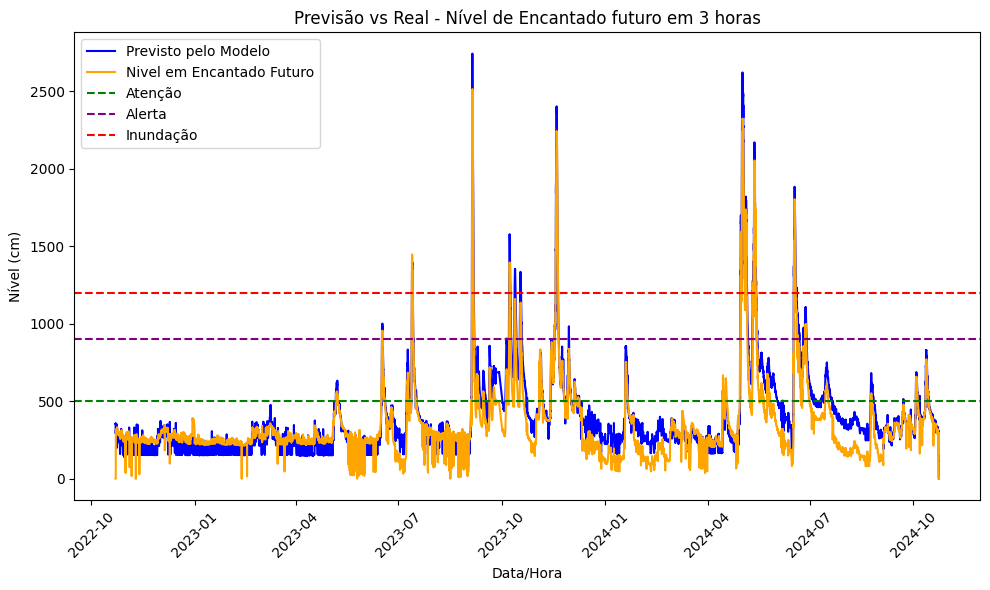

In [1680]:
df_all_log['Data/Hora'] = pd.to_datetime(df_all_log['Data/Hora'])


plt.figure(figsize=(10, 6))
plt.plot(df_all_log['Data/Hora'], np.exp(y_previsto_all), label='Previsto pelo Modelo', color='blue')
plt.plot(df_all_log['Data/Hora'], np.exp(df_all_log['LOG_nivel_Encantado_futuro']), label='Nivel em Encantado Futuro', color='orange')

plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

plt.title(f'Previsão vs Real - Nível de Encantado futuro em {n_horas_futuras} horas')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

In [1681]:
# Calculando R² das previsões

r_quadrado_prev_all = metrics.r2_score(np.exp(df_all_log['LOG_nivel_Encantado_futuro']), np.exp(y_previsto_all))
r_quadrado_prev_all

0.8194544674634853

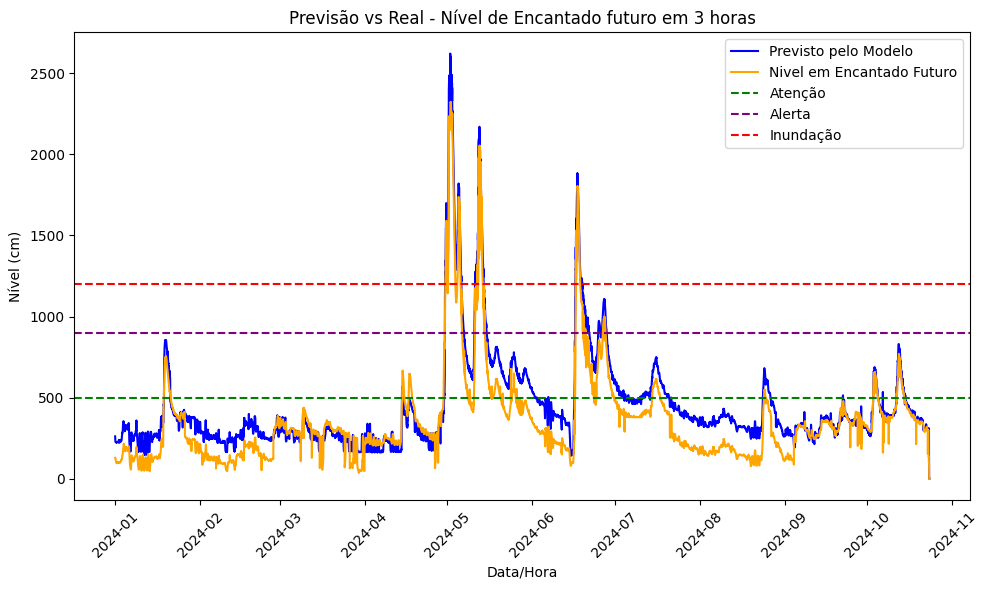

In [1682]:
# Converter a coluna 'Data/Hora' para datetime (se já não tiver sido feito)
df_all_log['Data/Hora'] = pd.to_datetime(df_all_log['Data/Hora'])

# Filtrar os dados para o ano de 2024
df_2024 = df_all_log[df_all_log['Data/Hora'].dt.year == 2024]

# Plotando o gráfico com os dados filtrados
plt.figure(figsize=(10, 6))
plt.plot(df_2024['Data/Hora'], np.exp(y_previsto_all[df_2024.index]), label='Previsto pelo Modelo', color='blue')
plt.plot(df_2024['Data/Hora'], np.exp(df_2024['LOG_nivel_Encantado_futuro']), label='Nivel em Encantado Futuro', color='orange')

plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

plt.title(f'Previsão vs Real - Nível de Encantado futuro em {n_horas_futuras} horas')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

In [1683]:
# Calculando R² das previsões

r_quadrado_prev_24 = metrics.r2_score(np.exp(df_2024['LOG_nivel_Encantado_futuro']), np.exp(y_previsto_all[df_2024.index]))
r_quadrado_prev_24

0.8086594764496667

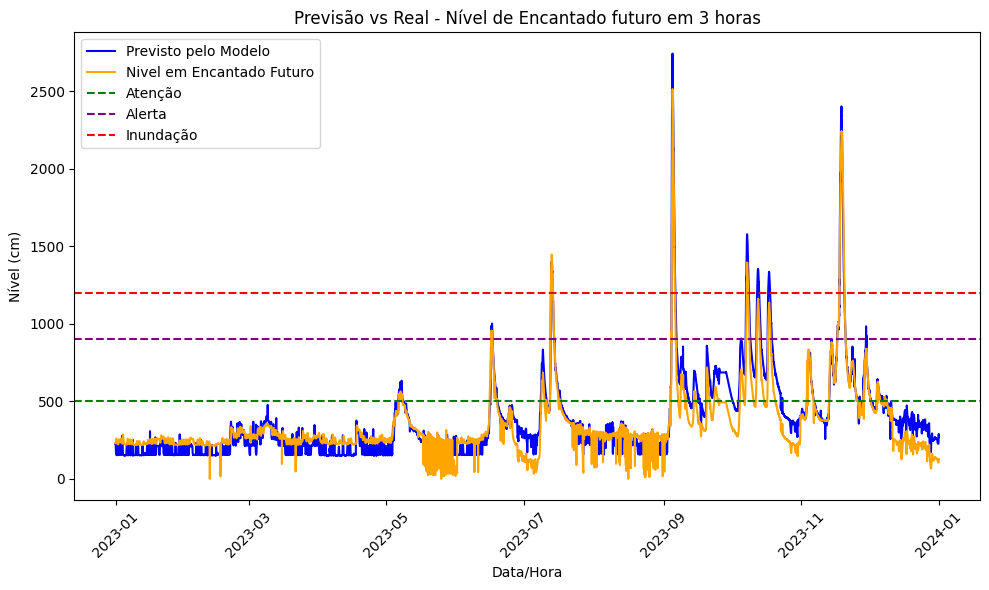

In [1684]:
# Converter a coluna 'Data/Hora' para datetime (se já não tiver sido feito)
df_all_log['Data/Hora'] = pd.to_datetime(df_all_log['Data/Hora'])

# Filtrar os dados para o ano de 2024
df_2024 = df_all_log[df_all_log['Data/Hora'].dt.year == 2023]

# Plotando o gráfico com os dados filtrados
plt.figure(figsize=(10, 6))
plt.plot(df_2024['Data/Hora'], np.exp(y_previsto_all[df_2024.index]), label='Previsto pelo Modelo', color='blue')
plt.plot(df_2024['Data/Hora'], np.exp(df_2024['LOG_nivel_Encantado_futuro']), label='Nivel em Encantado Futuro', color='orange')

plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

plt.title(f'Previsão vs Real - Nível de Encantado futuro em {n_horas_futuras} horas')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

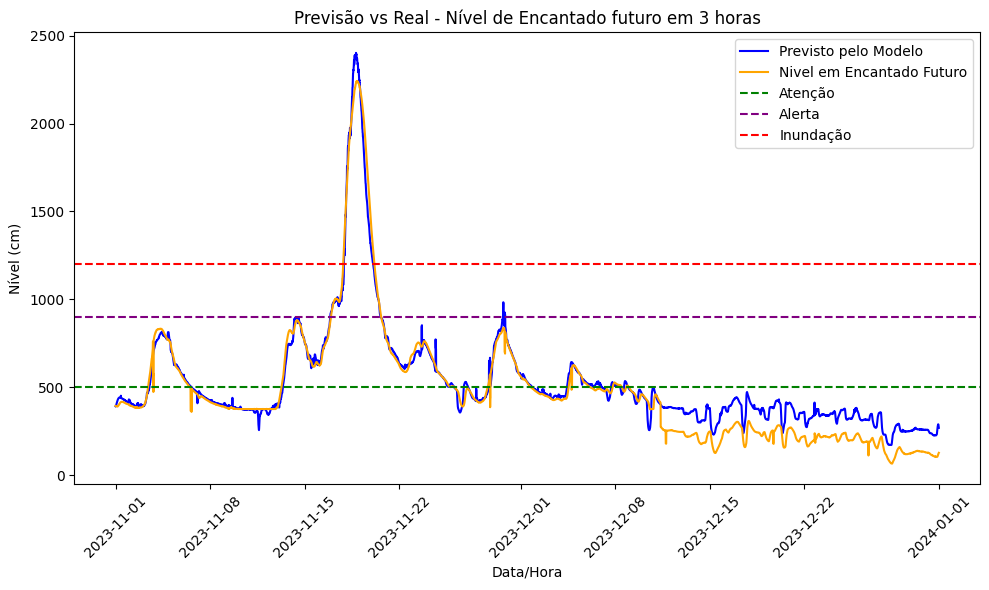

In [1685]:
# Converter a coluna 'Data/Hora' para datetime (se já não tiver sido feito)
df_all_log['Data/Hora'] = pd.to_datetime(df_all_log['Data/Hora'])

# Filtrar os dados para o ano de 2023
df_2023_nd = df_all_log[
    (df_all_log['Data/Hora'].dt.year == 2023) &
    (df_all_log['Data/Hora'].dt.month.isin([11, 12]))
]

# Plotando o gráfico com os dados filtrados
plt.figure(figsize=(10, 6))
plt.plot(df_2023_nd['Data/Hora'], np.exp(y_previsto_all[df_2023_nd.index]), label='Previsto pelo Modelo', color='blue')
plt.plot(df_2023_nd['Data/Hora'], np.exp(df_2023_nd['LOG_nivel_Encantado_futuro']), label='Nivel em Encantado Futuro', color='orange')

plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

plt.title(f'Previsão vs Real - Nível de Encantado futuro em {n_horas_futuras} horas')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

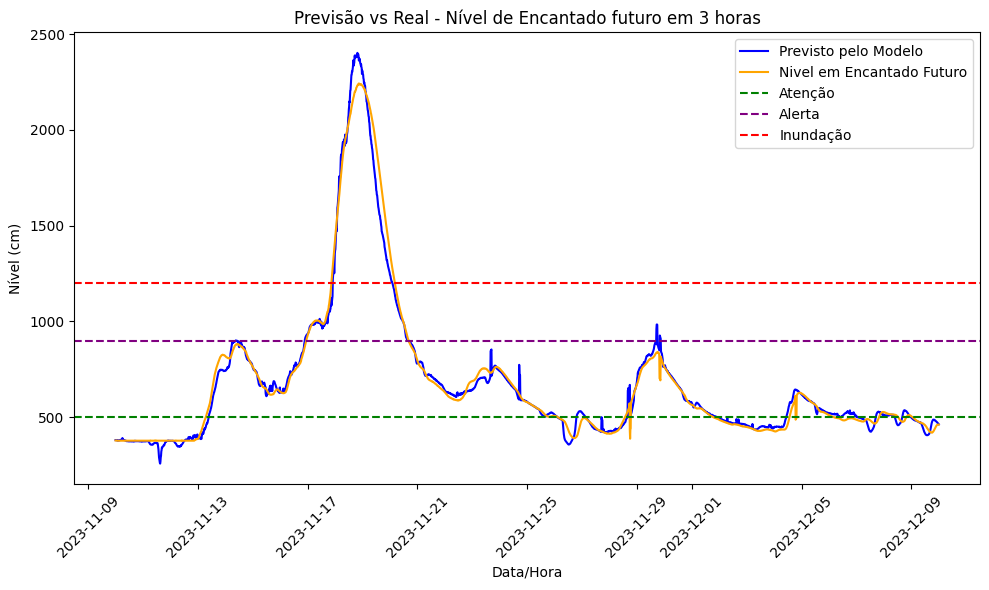

In [1686]:
# Converter a coluna 'Data/Hora' para datetime (se já não tiver sido feito)
df_all_log['Data/Hora'] = pd.to_datetime(df_all_log['Data/Hora'])

# Definir as datas de início e fim do intervalo
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Filtrar os dados dentro do intervalo de datas
df_2023_nd = df_all_log[
    (df_all_log['Data/Hora'] >= data_inicio) &
    (df_all_log['Data/Hora'] <= data_fim)
]

# Plotando o gráfico com os dados filtrados
plt.figure(figsize=(10, 6))
plt.plot(df_2023_nd['Data/Hora'], np.exp(y_previsto_all[df_2023_nd.index]), label='Previsto pelo Modelo', color='blue')
plt.plot(df_2023_nd['Data/Hora'], np.exp(df_2023_nd['LOG_nivel_Encantado_futuro']), label='Nivel em Encantado Futuro', color='orange')

plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

plt.title(f'Previsão vs Real - Nível de Encantado futuro em {n_horas_futuras} horas')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

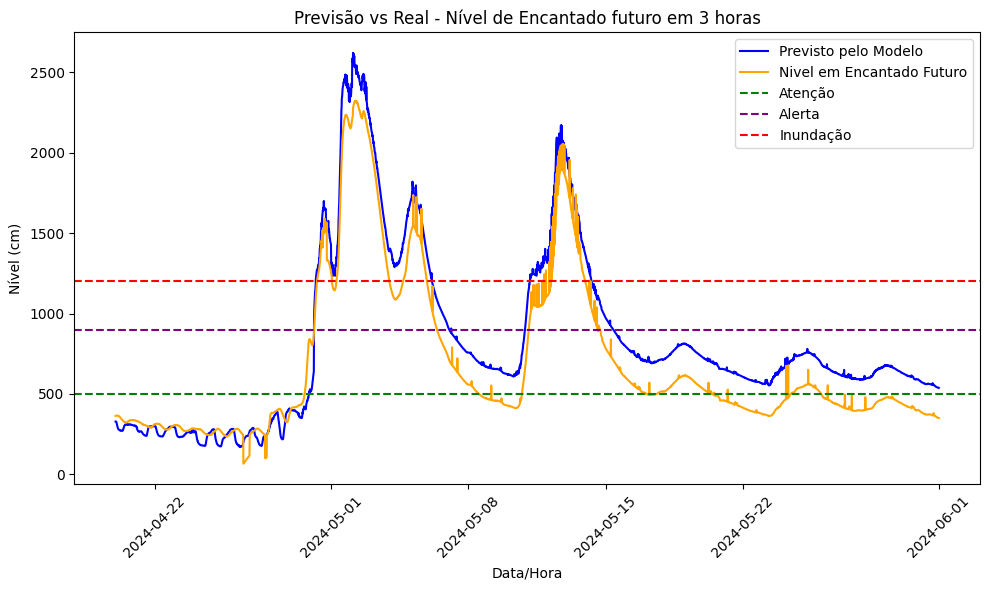

In [1687]:
# Converter a coluna 'Data/Hora' para datetime (se já não tiver sido feito)
df_all_log['Data/Hora'] = pd.to_datetime(df_all_log['Data/Hora'])

# Definir as datas de início e fim do intervalo
data_inicio = pd.to_datetime('2024-04-20')
data_fim = pd.to_datetime('2024-06-01')

# Filtrar os dados dentro do intervalo de datas
df_2023_nd = df_all_log[
    (df_all_log['Data/Hora'] >= data_inicio) &
    (df_all_log['Data/Hora'] <= data_fim)
]

# Plotando o gráfico com os dados filtrados
plt.figure(figsize=(10, 6))
plt.plot(df_2023_nd['Data/Hora'], np.exp(y_previsto_all[df_2023_nd.index]), label='Previsto pelo Modelo', color='blue')
plt.plot(df_2023_nd['Data/Hora'], np.exp(df_2023_nd['LOG_nivel_Encantado_futuro']), label='Nivel em Encantado Futuro', color='orange')

plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

plt.title(f'Previsão vs Real - Nível de Encantado futuro em {n_horas_futuras} horas')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

## Comparação Histórico vs previsto

In [1688]:
df_all_log

,Data/Hora,LOG_nivel_Encantado_futuro,LOG_nivel_Jose_Julio,LOG_vazao_Jose_Julio,LOG_chuva_total
0,2022-10-22 15:15:00,0.0,6.076495,4.881286,0.0
1,2022-10-22 15:30:00,0.0,6.076495,4.875960,0.0
2,2022-10-22 15:45:00,0.0,6.075346,4.857484,0.0
3,2022-10-22 16:00:00,0.0,6.077642,4.865995,0.0
4,2022-10-22 16:15:00,0.0,6.079933,4.875197,0.0
...,...,...,...,...,...
69989,2024-10-23 15:30:00,0.0,0.000000,0.000000,0.0
69990,2024-10-23 15:45:00,0.0,0.000000,0.000000,0.0
69991,2024-10-23 16:00:00,0.0,0.000000,0.000000,0.0
69992,2024-10-23 16:15:00,0.0,0.000000,0.000000,0.0


In [1689]:
nivel_previsto = pd.DataFrame(np.exp(y_previsto_all))
nivel_previsto.columns = ['nivel_previsto_Encantado']
nivel_previsto = [df_all_log['Data/Hora'], nivel_previsto['nivel_previsto_Encantado']]
nivel_previsto = pd.concat(nivel_previsto , axis=1)
nivel_previsto

,Data/Hora,nivel_previsto_Encantado
0,2022-10-22 15:15:00,353.343698
1,2022-10-22 15:30:00,353.101299
2,2022-10-22 15:45:00,351.953526
3,2022-10-22 16:00:00,352.956420
4,2022-10-22 16:15:00,353.992313
...,...,...
69989,2024-10-23 15:30:00,1.841875
69990,2024-10-23 15:45:00,1.841875
69991,2024-10-23 16:00:00,1.841875
69992,2024-10-23 16:15:00,1.841875


In [1690]:
df_all_analise = [df_Encantado_unico['Data/Hora'], df_Encantado_unico['Nivel(cm)']]
df_all_analise = pd.concat(df_all_analise , axis=1)
df_all_analise.columns = ['Data/Hora', 'nivel_Encantado_historico_presente']

df_all_analise = pd.merge(df_all_analise, nivel_previsto, on='Data/Hora', how='outer')

#df_all_analise['nivel_previsto_Encantado'] = df_all_analise['nivel_previsto_Encantado'].shift(-calculo_minutos)
#df_all_analise.columns = ['Data/Hora', 'nivel_previsto_Encantado', 'nivel_Encantado_historico_presente']
df_all_analise['Data/Hora'] = pd.to_datetime(df_all_analise['Data/Hora'])

df_all_analise

,Data/Hora,nivel_Encantado_historico_presente,nivel_previsto_Encantado
0,2022-10-22 15:15:00,NaN,353.343698
1,2022-10-22 15:30:00,NaN,353.101299
2,2022-10-22 15:45:00,NaN,351.953526
3,2022-10-22 16:00:00,NaN,352.956420
4,2022-10-22 16:15:00,NaN,353.992313
...,...,...,...
69989,2024-10-23 15:30:00,98.0,1.841875
69990,2024-10-23 15:45:00,98.0,1.841875
69991,2024-10-23 16:00:00,98.0,1.841875
69992,2024-10-23 16:15:00,97.0,1.841875


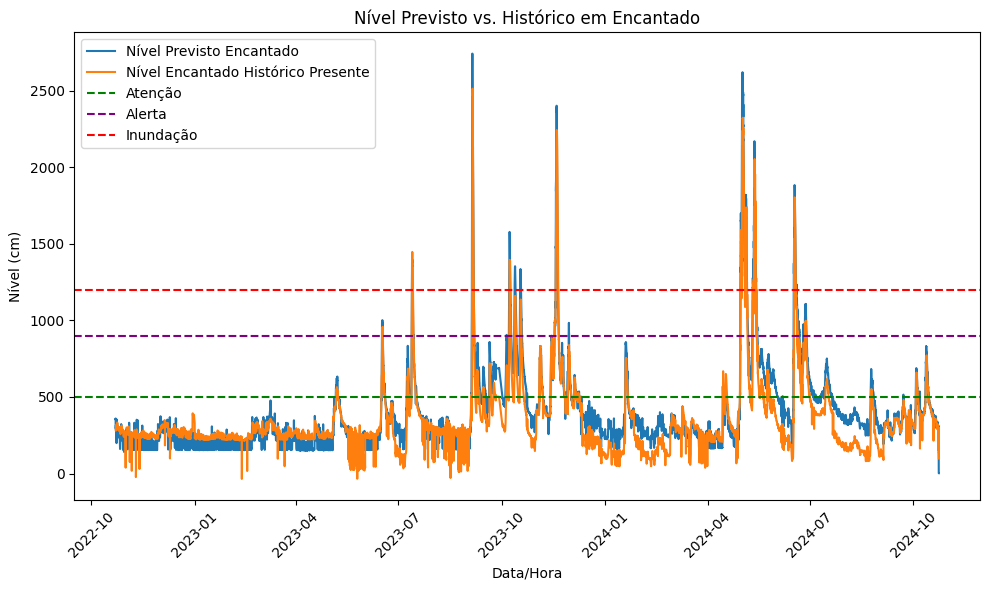

In [1691]:
# Create the plot
plt.figure(figsize=(10, 6))
plt.plot(df_all_analise['Data/Hora'], df_all_analise['nivel_previsto_Encantado'], label='Nível Previsto Encantado')
plt.plot(df_all_analise['Data/Hora'], df_all_analise['nivel_Encantado_historico_presente'], label='Nível Encantado Histórico Presente')

plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

# Customize the plot
plt.title('Nível Previsto vs. Histórico em Encantado')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.legend()
plt.tight_layout()  # Adjust layout to prevent labels from overlapping
plt.show()

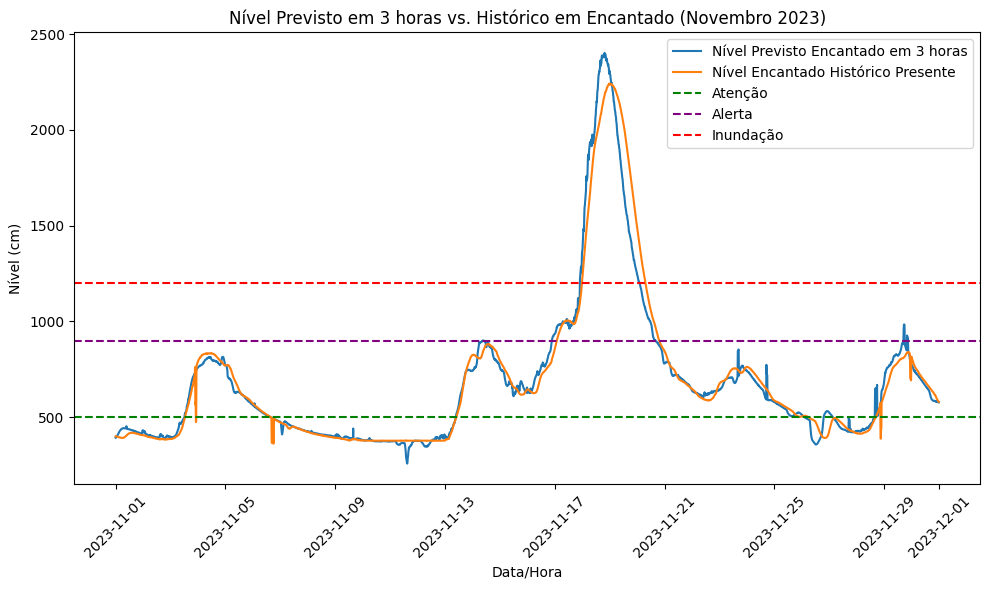

In [1692]:
# Filter data for October to December 2023
df_filtered = df_all_analise[
    (df_all_analise['Data/Hora'].dt.year == 2023) &
    (df_all_analise['Data/Hora'].dt.month.isin([11]))
]

# Create the plot with filtered data
plt.figure(figsize=(10, 6))
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_previsto_Encantado'], label=f'Nível Previsto Encantado em {n_horas_futuras} horas')
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_Encantado_historico_presente'], label='Nível Encantado Histórico Presente')
plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

# Customize the plot
plt.title(f'Nível Previsto em {n_horas_futuras} horas vs. Histórico em Encantado (Novembro 2023)')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

### Criando colunas no df para verificar se a previsão e o realizado atingiram níveis de Atenção, Alerta e Inundação

In [1693]:
# Ajustar os limites
limites = {'atingiu_atencao': atencao, 'atingiu_alerta': alerta, 'atingiu_inundacao': inundacao}

# Inicializar as colunas com 0
for col in ['atingiu_atencao_hist', 'atingiu_alerta_hist', 'atingiu_inundacao_hist',
            'atingiu_atencao_prev', 'atingiu_alerta_prev', 'atingiu_inundacao_prev']:
    df_all_analise[col] = 0

# Loop para analisar os valores linha a linha
for i in range(1, len(df_all_analise)):
    # Histórico
  for limite, valor_limite in limites.items():
      if (df_all_analise.loc[i, 'nivel_Encantado_historico_presente'] >= valor_limite and
          df_all_analise.loc[i-1, 'nivel_Encantado_historico_presente'] <= valor_limite and
          df_all_analise.loc[i-4, 'nivel_Encantado_historico_presente'] <= valor_limite and
          df_all_analise.loc[i+1, 'nivel_Encantado_historico_presente'] >= valor_limite and
          df_all_analise.loc[i+4, 'nivel_Encantado_historico_presente'] >= valor_limite
          ):
          df_all_analise.loc[i, f'{limite}_hist'] = 1

    # Previsto
  for limite, valor_limite in limites.items():
      if (df_all_analise.loc[i, 'nivel_previsto_Encantado'] >= valor_limite and
          df_all_analise.loc[i-1, 'nivel_previsto_Encantado'] <= valor_limite and
          df_all_analise.loc[i-4, 'nivel_previsto_Encantado'] <= valor_limite and
          df_all_analise.loc[i+1, 'nivel_previsto_Encantado'] >= valor_limite and
          df_all_analise.loc[i+4, 'nivel_previsto_Encantado'] >= valor_limite
          ):
          df_all_analise.loc[i, f'{limite}_prev'] = 1

In [1694]:
print(df_all_analise['atingiu_inundacao_prev'].value_counts())
print(df_all_analise['atingiu_inundacao_hist'].value_counts())

print(df_all_analise['atingiu_alerta_prev'].value_counts())
print(df_all_analise['atingiu_alerta_hist'].value_counts())

print(df_all_analise['atingiu_atencao_prev'].value_counts())
print(df_all_analise['atingiu_atencao_hist'].value_counts())

atingiu_inundacao_prev
0    69984
1       10
Name: count, dtype: int64
atingiu_inundacao_hist
0    69986
1        8
Name: count, dtype: int64
atingiu_alerta_prev
0    69979
1       15
Name: count, dtype: int64
atingiu_alerta_hist
0    69980
1       14
Name: count, dtype: int64
atingiu_atencao_prev
0    69956
1       38
Name: count, dtype: int64
atingiu_atencao_hist
0    69952
1       42
Name: count, dtype: int64


In [1695]:

# Encontrar quando Nível Previsto é igual a Nível Histórico
df_match = df_all_analise[df_all_analise['nivel_previsto_Encantado'] == df_all_analise['nivel_Encantado_historico_presente']].copy()

# Calcular diferença de tempo em minutos entre os pares
df_match['Diferença (minutos)'] = df_match['Data/Hora'].diff().dt.total_seconds() / 60

In [1696]:
df_match

,Data/Hora,nivel_Encantado_historico_presente,nivel_previsto_Encantado,atingiu_atencao_hist,atingiu_alerta_hist,atingiu_inundacao_hist,atingiu_atencao_prev,atingiu_alerta_prev,atingiu_inundacao_prev,Diferença (minutos)


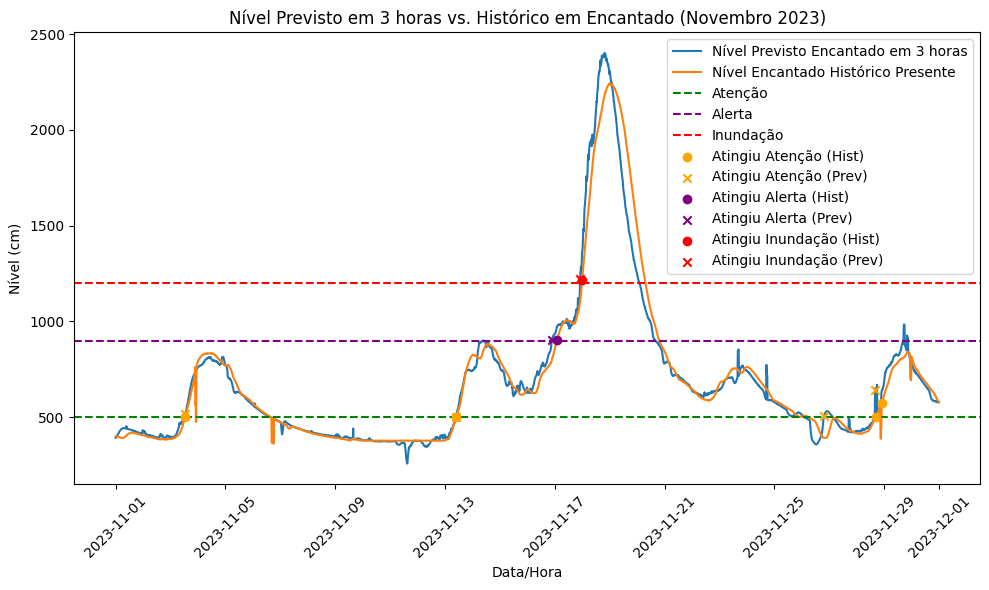

In [1697]:
# Filter data for October to December 2023
df_filtered = df_all_analise[
    (df_all_analise['Data/Hora'].dt.year == 2023) &
    (df_all_analise['Data/Hora'].dt.month.isin([11]))
]

# Create the plot with filtered data
plt.figure(figsize=(10, 6))
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_previsto_Encantado'], label=f'Nível Previsto Encantado em {n_horas_futuras} horas')
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_Encantado_historico_presente'], label='Nível Encantado Histórico Presente')
plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

# Plot pontos para os alertas
pontos_limite = {
    'Atenção': {'col_hist': 'atingiu_atencao_hist', 'col_prev': 'atingiu_atencao_prev', 'color': 'orange'},
    'Alerta': {'col_hist': 'atingiu_alerta_hist', 'col_prev': 'atingiu_alerta_prev', 'color': 'purple'},
    'Inundação': {'col_hist': 'atingiu_inundacao_hist', 'col_prev': 'atingiu_inundacao_prev', 'color': 'red'}
}

# Loop para criar os scatters de todos os alertas
for ponto, info in pontos_limite.items():
    # Histórico
    pontos_hist = df_filtered[df_filtered[info['col_hist']] == 1]
    plt.scatter(pontos_hist['Data/Hora'], pontos_hist['nivel_Encantado_historico_presente'],
                color=info['color'], label=f'Atingiu {ponto} (Hist)', zorder=5, marker='o')

    # Previsto
    pontos_prev = df_filtered[df_filtered[info['col_prev']] == 1]
    plt.scatter(pontos_prev['Data/Hora'], pontos_prev['nivel_previsto_Encantado'],
                color=info['color'], label=f'Atingiu {ponto} (Prev)', zorder=5, marker='x')

# Customize the plot
plt.title(f'Nível Previsto em {n_horas_futuras} horas vs. Histórico em Encantado (Novembro 2023)')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

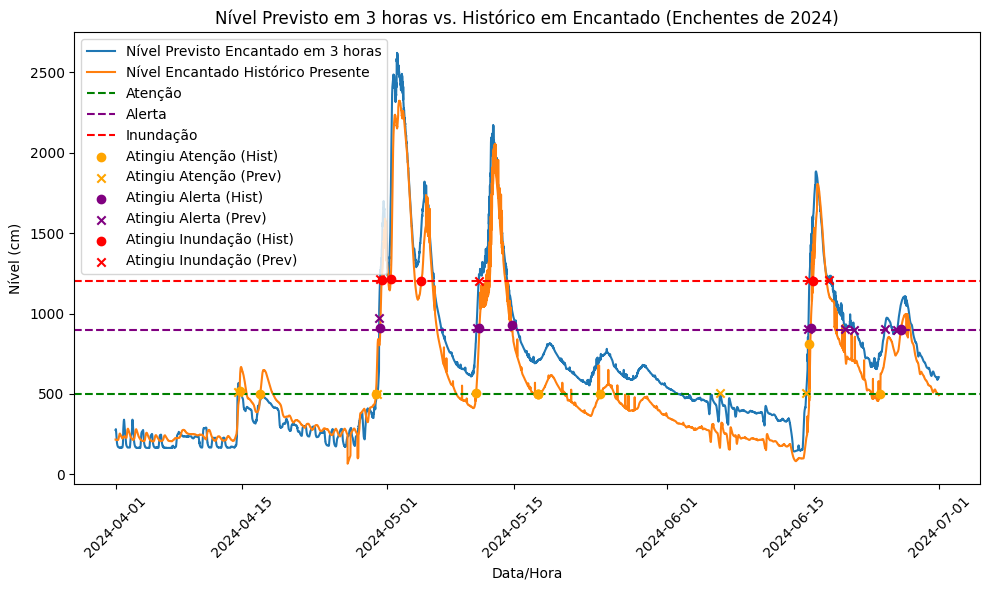

In [1698]:
df_filtered = df_all_analise[
    (df_all_analise['Data/Hora'].dt.year == 2024) &
    (df_all_analise['Data/Hora'].dt.month.isin([4, 5, 6]))
]

# Create the plot with filtered data
plt.figure(figsize=(10, 6))
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_previsto_Encantado'], label=f'Nível Previsto Encantado em {n_horas_futuras} horas')
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_Encantado_historico_presente'], label='Nível Encantado Histórico Presente')
plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')


# Plot pontos para os alertas
pontos_limite = {
    'Atenção': {'col_hist': 'atingiu_atencao_hist', 'col_prev': 'atingiu_atencao_prev', 'color': 'orange'},
    'Alerta': {'col_hist': 'atingiu_alerta_hist', 'col_prev': 'atingiu_alerta_prev', 'color': 'purple'},
    'Inundação': {'col_hist': 'atingiu_inundacao_hist', 'col_prev': 'atingiu_inundacao_prev', 'color': 'red'}
}

# Loop para criar os scatters de todos os alertas
for ponto, info in pontos_limite.items():
    # Histórico
    pontos_hist = df_filtered[df_filtered[info['col_hist']] == 1]
    plt.scatter(pontos_hist['Data/Hora'], pontos_hist['nivel_Encantado_historico_presente'],
                color=info['color'], label=f'Atingiu {ponto} (Hist)', zorder=5, marker='o')

    # Previsto
    pontos_prev = df_filtered[df_filtered[info['col_prev']] == 1]
    plt.scatter(pontos_prev['Data/Hora'], pontos_prev['nivel_previsto_Encantado'],
                color=info['color'], label=f'Atingiu {ponto} (Prev)', zorder=5, marker='x')

# Customize the plot
plt.title(f'Nível Previsto em {n_horas_futuras} horas vs. Histórico em Encantado (Enchentes de 2024)')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

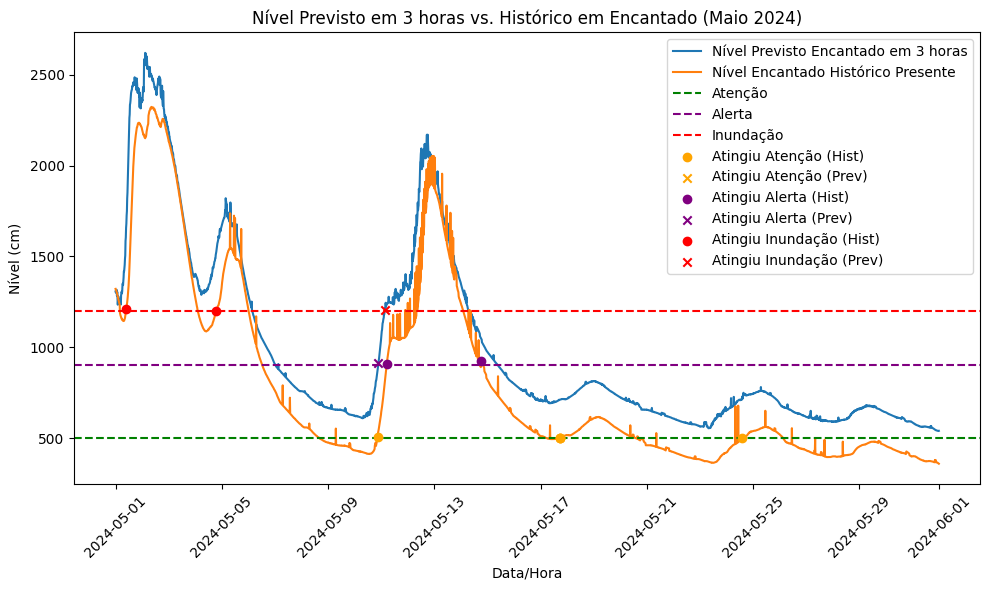

In [1699]:
df_filtered = df_all_analise[
    (df_all_analise['Data/Hora'].dt.year == 2024) &
    (df_all_analise['Data/Hora'].dt.month.isin([5]))
]

# Create the plot with filtered data
plt.figure(figsize=(10, 6))
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_previsto_Encantado'], label=f'Nível Previsto Encantado em {n_horas_futuras} horas')
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_Encantado_historico_presente'], label='Nível Encantado Histórico Presente')
plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')


# Plot pontos para os alertas
pontos_limite = {
    'Atenção': {'col_hist': 'atingiu_atencao_hist', 'col_prev': 'atingiu_atencao_prev', 'color': 'orange'},
    'Alerta': {'col_hist': 'atingiu_alerta_hist', 'col_prev': 'atingiu_alerta_prev', 'color': 'purple'},
    'Inundação': {'col_hist': 'atingiu_inundacao_hist', 'col_prev': 'atingiu_inundacao_prev', 'color': 'red'}
}

# Loop para criar os scatters de todos os alertas
for ponto, info in pontos_limite.items():
    # Histórico
    pontos_hist = df_filtered[df_filtered[info['col_hist']] == 1]
    plt.scatter(pontos_hist['Data/Hora'], pontos_hist['nivel_Encantado_historico_presente'],
                color=info['color'], label=f'Atingiu {ponto} (Hist)', zorder=5, marker='o')

    # Previsto
    pontos_prev = df_filtered[df_filtered[info['col_prev']] == 1]
    plt.scatter(pontos_prev['Data/Hora'], pontos_prev['nivel_previsto_Encantado'],
                color=info['color'], label=f'Atingiu {ponto} (Prev)', zorder=5, marker='x')

# Customize the plot
plt.title(f'Nível Previsto em {n_horas_futuras} horas vs. Histórico em Encantado (Maio 2024)')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

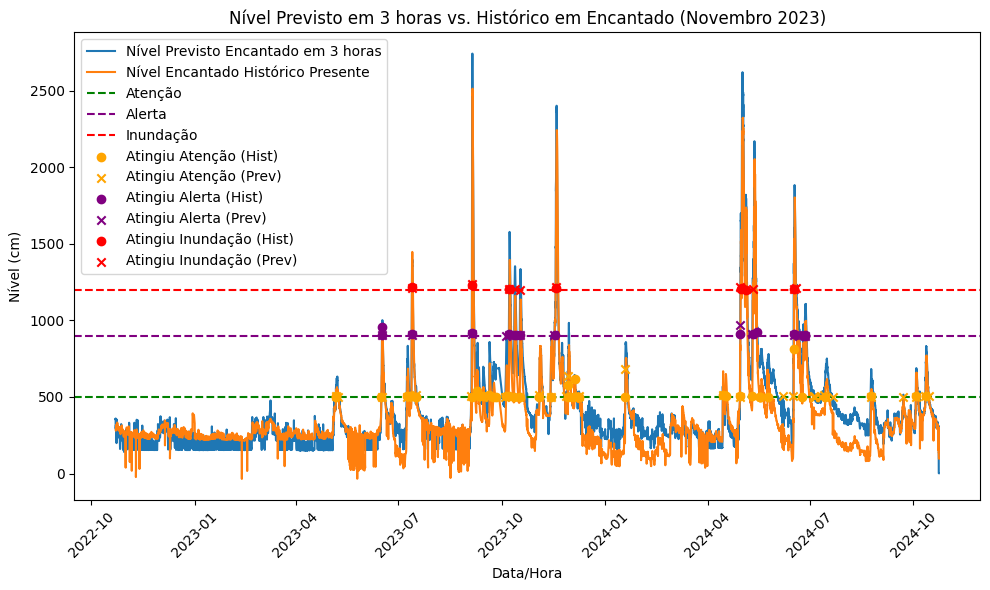

In [1700]:
df_filtered = df_all_analise[
    (df_all_analise['Data/Hora'].dt.year.isin([2022, 2023, 2024])) &
    (df_all_analise['Data/Hora'].dt.month.isin([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]))
]

# Create the plot with filtered data
plt.figure(figsize=(10, 6))
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_previsto_Encantado'], label=f'Nível Previsto Encantado em {n_horas_futuras} horas')
plt.plot(df_filtered['Data/Hora'], df_filtered['nivel_Encantado_historico_presente'], label='Nível Encantado Histórico Presente')
plt.axhline(y=atencao, color='green', linestyle='--', label='Atenção')
plt.axhline(y=alerta, color='purple', linestyle='--', label='Alerta')
plt.axhline(y=inundacao, color='red', linestyle='--', label='Inundação')

# Plot pontos para os alertas
pontos_limite = {
    'Atenção': {'col_hist': 'atingiu_atencao_hist', 'col_prev': 'atingiu_atencao_prev', 'color': 'orange'},
    'Alerta': {'col_hist': 'atingiu_alerta_hist', 'col_prev': 'atingiu_alerta_prev', 'color': 'purple'},
    'Inundação': {'col_hist': 'atingiu_inundacao_hist', 'col_prev': 'atingiu_inundacao_prev', 'color': 'red'}
}

# Loop para criar os scatters de todos os alertas
for ponto, info in pontos_limite.items():
    # Histórico
    pontos_hist = df_filtered[df_filtered[info['col_hist']] == 1]
    plt.scatter(pontos_hist['Data/Hora'], pontos_hist['nivel_Encantado_historico_presente'],
                color=info['color'], label=f'Atingiu {ponto} (Hist)', zorder=5, marker='o')

    # Previsto
    pontos_prev = df_filtered[df_filtered[info['col_prev']] == 1]
    plt.scatter(pontos_prev['Data/Hora'], pontos_prev['nivel_previsto_Encantado'],
                color=info['color'], label=f'Atingiu {ponto} (Prev)', zorder=5, marker='x')

# Customize the plot
plt.title(f'Nível Previsto em {n_horas_futuras} horas vs. Histórico em Encantado (Novembro 2023)')
plt.xlabel('Data/Hora')
plt.ylabel('Nível (cm)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

### Tentativa de calcular a diferença de tempo entre o evento previsto e o histórico médio do modelo

In [1701]:
# Função ajustada para usar diferença de tempo em minutos
def calcular_diferenca_tempo(col_prev, col_hist):
    diferenca_tempo = []
    for i in range(len(df_all_analise)):
        if df_all_analise.loc[i, col_prev] == 1:  # Verificar se o evento previsto ocorreu
            # Procurar o próximo evento histórico correspondente
            indices_hist = df_all_analise.index[df_all_analise[col_hist] == 1].tolist()
            if indices_hist:
                # Calcular a diferença de tempo (em minutos)
                diferenca_minima = min(indices_hist, key=lambda x: abs(x - i))  # Índice mais próximo
                tempo_diferenca = (
                    df_all_analise.loc[diferenca_minima, 'Data/Hora'] - df_all_analise.loc[i, 'Data/Hora']
                ).total_seconds() / 60  # Converter para minutos
                diferenca_tempo.append(tempo_diferenca)
            else:
                diferenca_tempo.append(0)  # Nenhum evento histórico correspondente
        else:
            diferenca_tempo.append(0)  # Nenhum evento previsto correspondente
    return diferenca_tempo

In [1702]:
# Criar novas colunas de diferença de tempo
df_all_analise['dif_tempo_inundacao'] = calcular_diferenca_tempo('atingiu_inundacao_prev', 'atingiu_inundacao_hist')
df_all_analise['dif_tempo_alerta'] = calcular_diferenca_tempo('atingiu_alerta_prev', 'atingiu_alerta_hist')
df_all_analise['dif_tempo_atencao'] = calcular_diferenca_tempo('atingiu_atencao_prev', 'atingiu_atencao_hist')

In [1703]:
df_all_analise_23 = df_all_analise[
    (df_all_analise['Data/Hora'].dt.year == 2023) &
    (df_all_analise['Data/Hora'].dt.month.isin([11]))
]

print(df_all_analise['dif_tempo_inundacao'].value_counts())
print(df_all_analise['dif_tempo_alerta'].value_counts())
print(df_all_analise['dif_tempo_atencao'].value_counts())

dif_tempo_inundacao
 0.0        69984
 180.0          1
 210.0          1
 525.0          1
-6525.0         1
-13575.0        1
 120.0          1
 270.0          1
-9135.0         1
 570.0          1
-2625.0         1
Name: count, dtype: int64
dif_tempo_alerta
 0.0       69979
 330.0         1
 135.0         1
 165.0         1
 3435.0        1
 420.0         1
 480.0         1
 405.0         1
 270.0         1
 195.0         1
 450.0         1
 375.0         1
-5430.0        1
-6945.0        1
 2595.0        1
 570.0         1
Name: count, dtype: int64
dif_tempo_atencao
 0.0        69956
 390.0          2
 330.0          2
 16230.0        1
 780.0          1
-9690.0         1
 1080.0         1
 5160.0         1
 5760.0         1
 300.0          1
 255.0          1
 12870.0        1
 13125.0        1
 14580.0        1
 14625.0        1
 495.0          1
 14235.0        1
-150.0          1
 6450.0         1
 345.0          1
 60.0           1
 675.0          1
-2490.0         1
-405.0   

In [1704]:
df_all_analise['dif_tempo_inundacao'].value_counts()

,count
dif_tempo_inundacao,
0.0,69984
180.0,1
210.0,1
525.0,1
-6525.0,1
-13575.0,1
120.0,1
270.0,1
-9135.0,1
